In [ ]:
import os
data_dir = '/Users/omerorhan/Desktop/UCSC/Deep Learning/DeepLearningUCSC/venv/homework/Assignments'
fname = os.path.join(data_dir, 'jena_climate_2009_2016.csv')
f = open(fname)
data = f.read()
f.close()
lines = data.split('\n')
header = lines[0].split(',')
lines = lines[1:]
print(header)
print(len(lines))




# Listing 6.29 Parsing the data

In [2]:
import numpy as np
float_data = np.zeros((len(lines), len(header) - 1))
for i, line in enumerate(lines):
    values = [float(x) for x in line.split(',')[1:]]
    float_data[i, :] = values

# Listing 6.30 Plotting the temperature 

In [3]:

from matplotlib import pyplot as plt
temp = float_data[:, 1] 
plt.plot(range(len(temp)), temp)
plt.show()

<Figure size 640x480 with 1 Axes>

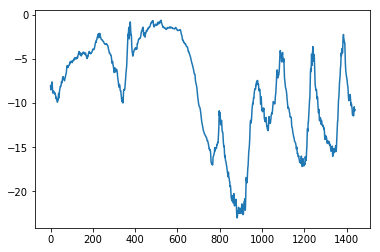

In [4]:
plt.plot(range(1440), temp[:1440])
plt.show()

# Listing 6.32 Normalizing the data

In [4]:
#mean = float_data[:200000].mean(axis=0)
#float_data -= mean
#std = float_data[:200000].std(axis=0)
#float_data /= std
#
print((float_data.shape))



(420551, 14)


# Listing 6.33 Generator yielding timeseries samples and their targets

In [5]:
def generator(data, lookback, delay, min_index, max_index,
              shuffle=False, batch_size=128, step=6):
    if max_index is None:
        max_index = len(data) - delay - 1
    i = min_index + lookback
    while 1:
        if shuffle:
            rows = np.random.randint(
                min_index + lookback, max_index, size=batch_size)
        else:
            if i + batch_size >= max_index:
                i = min_index + lookback
            rows = np.arange(i, min(i + batch_size, max_index))
            i += len(rows)
        samples = np.zeros((len(rows),
                           lookback // step,
                           data.shape[-1]))
        targets = np.zeros((len(rows),))
        for j, row in enumerate(rows):
            indices = range(rows[j] - lookback, rows[j], step)
            samples[j] = data[indices]
            targets[j] = data[rows[j] + delay][1]
        yield samples, targets


# Listing 6.34 Preparing the training, validation, and test generators

In [14]:
lookback = 1440
step = 6
delay = 144
batch_size = 128

train_gen = generator(float_data,
                      lookback=lookback,
                      delay=delay,
                      min_index=0,
                      max_index=200000,
                      shuffle=True,
                      step=step,
                      batch_size=batch_size)
val_gen = generator(float_data,
                    lookback=lookback,
                    delay=delay,
                    min_index=200001,
                    max_index=300000,
                    step=step,
                    batch_size=batch_size)
test_gen = generator(float_data,
                     lookback=lookback,
                     delay=delay,
                     min_index=300001,
                     max_index=None,
                     step=step,
                     batch_size=batch_size)


val_steps = (300000 - 200001 - lookback)

test_steps = (len(float_data) - 300001 - lookback)

print(float_data.shape)

(420551, 14)


# Listing 6.35 Computing the common-sense baseline MAE


In [4]:
def evaluate_naive_method():
    batch_maes = []
    count = 0 

    for step in range(val_steps):
        count = count +1
        samples, targets = next(val_gen)
        preds = samples[:, -1, 1]
        mae = np.mean(np.abs(preds - targets))
        batch_maes.append(mae)
        if count % 5000==0:
            print(count)
evaluate_naive_method()


NameError: name 'val_steps' is not defined

# Listing 6.36 Converting the MAE back to a Celsius error


In [ ]:
celsius_mae = 0.29 * std[1]

for row in train_gen:
    print(row)


(array([[[-1.78367747,  1.66423638,  1.79752617, ...,  0.00585443,
         -0.15854183, -1.03698977],
        [-1.72235985,  1.57838492,  1.70705615, ...,  0.24012808,
         -0.10705455, -0.82916933],
        [-1.66222142,  1.40103387,  1.52499919, ..., -0.43015486,
         -0.4846279 , -1.0773993 ],
        ...,
        [-0.1752692 ,  0.72212954,  0.72975651, ..., -0.41063206,
         -0.53611517, -1.72903185],
        [-0.23540763,  0.78538851,  0.79677134, ..., -1.00933138,
         -1.06815035,  1.51804714],
        [-0.36747635,  0.75940714,  0.78225146, ..., -0.53427648,
         -0.79355155,  0.48471771]],

       [[-0.07150092,  0.30642771,  0.30867998, ..., -0.93774777,
         -1.11963762, -1.4274613 ],
        [-0.04791722,  0.24316874,  0.24389898, ..., -0.73601213,
         -0.77638912,  0.58862793],
        [-0.06442581,  0.17765052,  0.18023489, ..., -0.97679338,
         -0.93085095, -1.55146083],
        ...,
        [-0.51251609,  0.78877738,  0.82246036, ..., 

(array([[[-9.68860669e-01,  2.46557614e-01,  3.19849122e-01, ...,
         -8.14103343e-01, -9.30850946e-01, -1.57305106e+00],
        [-9.95981923e-01,  3.47094196e-01,  4.22605198e-01, ...,
         -6.83951315e-01, -5.70440023e-01,  4.00434973e-01],
        [-9.61785560e-01,  5.27834119e-01,  5.99077590e-01, ...,
         -7.75057734e-01, -7.59226697e-01, -1.80307715e-01],
        ...,
        [-1.05494117e+00, -1.55152741e-02,  6.63096742e-02, ...,
         -1.00282378e+00, -9.65175796e-01, -1.49177018e+00],
        [-1.10800449e+00, -1.77745232e-02,  6.85435019e-02, ...,
         -1.13948341e+00, -1.17112489e+00,  7.60041676e-02],
        [-1.12215471e+00, -4.94040096e-02,  3.83868274e-02, ...,
         -1.56835602e-01, -3.30166075e-01, -1.82555290e+00]],

       [[-7.24769385e-01,  8.59943727e-01,  9.10696559e-01, ...,
         -5.73322091e-01, -6.04764873e-01, -2.53044870e-01],
        [-7.95520482e-01,  1.11636849e+00,  1.17093749e+00, ...,
          9.04532516e-02,  6.30929719

(array([[[ 2.60289054e+00,  2.94001844e-01,  8.97648654e-02, ...,
          1.42514063e-01,  3.73493346e-01,  2.02258900e+00],
        [ 2.53803537e+00,  3.97927299e-01,  1.96988597e-01, ...,
         -3.19525637e-01, -5.55672765e-02, -1.98545919e+00],
        [ 2.46374672e+00,  4.11482793e-01,  2.17093046e-01, ...,
          1.49021664e-01,  9.88945476e-02, -1.42376671e+00],
        ...,
        [ 5.53467100e-01,  7.76351512e-01,  7.25288857e-01, ...,
          7.80259000e-01,  5.45117595e-01, -2.81908821e-01],
        [ 4.90970298e-01,  9.27721198e-01,  8.80539885e-01, ...,
          1.07310106e+00,  1.04282792e+00, -2.50577827e-03],
        [ 3.91918762e-01,  1.08360938e+00,  1.04249240e+00, ...,
          6.76137378e-01,  9.39853368e-01,  4.78944919e-01]],

       [[ 4.49698825e-01, -5.06901939e-01, -5.37940729e-01, ...,
          1.62036867e-01,  2.87681221e-01,  1.75296158e-01],
        [ 3.57722399e-01, -5.30624054e-01, -5.54694437e-01, ...,
          3.83924404e-02, -8.13109139

(array([[[ 0.2008908 ,  0.54590811,  0.52536127, ...,  0.40932572,
          0.03024485,  0.79644838],
        [ 0.20442836,  0.46005665,  0.43935891, ..., -0.70998172,
         -0.67341457,  0.85994907],
        [ 0.2008908 ,  0.35048307,  0.33101826, ...,  0.2986965 ,
         -0.1413794 ,  0.86918553],
        ...,
        [-0.14578957,  0.71535179,  0.7208212 , ...,  0.11648366,
         -0.31300365,  0.83454879],
        [-0.065605  ,  0.5685006 ,  0.56892092, ...,  0.82581221,
          0.21903152,  0.81376675],
        [-0.04555885,  0.52670449,  0.52536127, ...,  0.65661457,
          0.04740727,  0.69022904]],

       [[-0.95942719, -0.17479233, -0.10011049, ...,  0.94294903,
          0.34774971,  0.24110597],
        [-0.94763534, -0.13073697, -0.05655085, ...,  1.93861205,
          1.25306762,  0.34847986],
        [-0.87688424, -0.0719965 , -0.0040559 , ...,  1.7043384 ,
          1.66496582,  0.39119851],
        ...,
        [-0.66345177, -1.52695288, -1.46609615, ..., 

(array([[[ 2.10645368, -0.49899457, -0.65521669, ..., -1.22408223,
         -1.32558672, -0.25535399],
        [ 2.13829167, -0.63793838, -0.793714  , ..., -1.13297581,
         -1.01666307, -1.37527527],
        [ 2.159517  , -0.70119736, -0.8573781 , ..., -1.0744074 ,
         -1.13680005,  0.44892641],
        ...,
        [-0.17880675,  0.81024025,  0.81687579, ...,  0.57201576,
          0.37349335,  0.47317213],
        [-0.14578957,  0.73681465,  0.74204256, ..., -0.33254084,
         -0.58760245,  0.67406523],
        [-0.06796337,  0.56172285,  0.56221943, ...,  0.59804616,
          0.49363032,  0.68676536]],

       [[-0.28965014,  2.35669621,  2.36156768, ...,  0.51344734,
          0.49363032,  0.42583525],
        [-0.24719948,  2.42786256,  2.42858251, ...,  1.46355715,
          1.74648734,  0.73063857],
        [-0.18824023,  2.22340052,  2.22083653, ..., -0.07874438,
          0.0645697 ,  0.80337573],
        ...,
        [-0.22833252,  1.66084751,  1.66573033, ..., 

(array([[[ 0.03934246,  1.01131341,  0.99893275, ..., -0.88568696,
         -1.0338255 ,  0.49164506],
        [ 0.01811713,  0.89157321,  0.88277371, ..., -1.12646821,
         -1.15396247,  0.42006246],
        [ 0.01222121,  0.78087001,  0.77331615, ..., -0.96377818,
         -0.99950065,  0.40158953],
        ...,
        [ 0.08533068,  1.04181327,  1.02573869, ..., -0.46269287,
         -0.2786788 ,  0.65674686],
        [ 0.09358497,  0.94805444,  0.93191792, ..., -0.52126128,
         -0.77638912,  0.54937296],
        [ 0.08297231,  0.84638823,  0.83251259, ..., -0.73601213,
         -0.70773942,  0.1741416 ]],

       [[ 0.16433607,  1.85740218,  1.82879976, ..., -0.43015486,
         -0.45030305, -1.76135948],
        [ 0.20442836,  1.67779188,  1.6467428 , ..., -1.0678998 ,
         -1.17970611, -1.00119847],
        [ 0.22683287,  1.48801496,  1.45686744, ..., -1.20455943,
         -1.23119338, -1.74865934],
        ...,
        [-0.66698932,  2.17143779,  2.20855047, ..., 

(array([[[-7.26801079e-02,  1.69134737e+00,  1.68248404e+00, ...,
          6.17568965e-01,  4.42143046e-01, -1.65964292e+00],
        [-4.08421143e-02,  1.53884806e+00,  1.52946684e+00, ...,
          8.45335014e-01,  6.13767295e-01, -1.71217531e+00],
        [ 5.14609873e-03,  1.43492261e+00,  1.42224311e+00, ...,
         -2.86987630e-01, -4.67465474e-01, -1.54868989e+00],
        ...,
        [ 2.75506128e-02,  1.54675543e+00,  1.53170067e+00, ...,
          8.64857818e-01,  7.93972756e-01, -1.63862996e+00],
        [ 2.78772883e-03,  1.57273680e+00,  1.55962352e+00, ...,
          7.21690587e-01,  6.30929719e-01, -1.35564779e+00],
        [-1.01833056e-02,  1.57838492e+00,  1.56632500e+00, ...,
          1.48307995e+00,  1.42469187e+00, -1.25127574e+00]],

       [[ 9.54389983e-01,  3.82112556e-01,  3.04212328e-01, ...,
         -8.14103343e-01, -5.87602448e-01,  1.91459970e-01],
        [ 9.34343839e-01,  2.98520342e-01,  2.22677616e-01, ...,
         -5.60306888e-01, -7.24901848

(array([[[-0.75424901,  1.58064417,  1.62887218, ...,  0.51995494,
          1.67783764,  0.50896343],
        [-0.82853766,  1.70829174,  1.76178493, ..., -0.29349523,
          0.09889455, -0.04984266],
        [-0.90872224,  1.85175405,  1.91145139, ...,  0.18806727,
          0.54511759, -0.27498147],
        ...,
        [-0.59152149,  0.79103663,  0.83139567, ...,  1.07310106,
          1.2401958 , -1.79691987],
        [-0.6375097 ,  0.99775792,  1.04025857, ...,  1.45054194,
          1.07715277, -1.77498326],
        [-0.70708161,  1.1626831 ,  1.21002948, ...,  1.78893722,
          1.41611066, -1.65756471]],

       [[ 0.93316465, -1.0028071 , -1.06512408, ..., -0.32603324,
         -0.39881577,  0.16375058],
        [ 0.95203161, -1.07397345, -1.13772348, ..., -0.1438204 ,
         -0.24435395,  0.82993056],
        [ 0.96736102, -1.12367693, -1.1879846 , ..., -0.69696652,
         -0.87936367,  0.45816287],
        ...,
        [ 2.29748164, -2.9378539 , -3.07445213, ..., 

(array([[[-0.48657403, -0.18834783, -0.1492547 , ...,  1.45054194,
          1.18441792, -1.77994786],
        [-0.50072424, -0.31373615, -0.27323214, ...,  0.61106136,
          1.25306762, -1.84875952],
        [-0.47714055, -0.40975423, -0.37040365, ..., -0.93774777,
         -0.51895275, -1.349875  ],
        ...,
        [ 0.92373117,  0.77070339,  0.69066453, ..., -0.92473257,
         -0.58760245,  0.11295002],
        [ 0.93788139,  0.61029671,  0.53094584, ..., -0.44967766,
         -0.68199579,  0.56900045],
        [ 0.90722258,  0.39905692,  0.32431678, ..., -0.91171736,
         -0.6219273 ,  0.32077047]],

       [[ 2.4024291 , -2.32672704, -2.47913703, ..., -1.00933138,
         -1.05956913, -1.96155984],
        [ 2.41657932, -2.43743024, -2.58971151, ..., -1.19154422,
         -1.32558672, -1.40875746],
        [ 2.40478747, -2.51763358, -2.66789548, ..., -1.0744074 ,
         -1.11963762,  0.46970846],
        ...,
        [-0.47124462, -0.75090083, -0.70994546, ..., 

(array([[[-1.72589741, -0.79608582, -0.65856743, ...,  0.41583332,
          0.93556276,  0.98695045],
        [-1.65042957, -0.78027107, -0.6485152 , ...,  0.3377421 ,
          0.77681033,  1.12896109],
        [-1.6091581 , -0.80738206, -0.67867188, ...,  0.16854447,
          1.04282792,  1.57346593],
        ...,
        [ 1.34705857, -1.62635984, -1.71293412, ..., -0.38460165,
         -0.35161911,  0.26304257],
        [ 1.3682839 , -1.51678626, -1.60571039, ..., -0.33254084,
         -0.29584123,  1.25018968],
        [ 1.38833004, -1.37784244, -1.4694469 , ..., -0.69696652,
         -0.24435395,  1.92329701]],

       [[-2.2046465 , -0.73621572, -0.56139592, ...,  0.59153856,
          0.9613064 ,  0.9442318 ],
        [-1.99710995, -0.7633267 , -0.60495556, ...,  0.59804616,
          1.01279367,  0.91652241],
        [-1.81079872, -0.7814007 , -0.63734606, ...,  0.54598535,
          0.84116942,  0.89112214],
        ...,
        [-1.03843258, -0.66279012, -0.57814963, ..., 

(array([[[-0.43233152,  1.09942412,  1.12514402, ..., -0.64490571,
         -0.53611517,  0.57361868],
        [-0.37690982,  1.05762802,  1.07823364, ...,  0.05140764,
          0.21903152,  0.86225818],
        [-0.34389265,  1.21916432,  1.23683541, ...,  0.37678771,
          0.52795517,  0.80222117],
        ...,
        [ 0.41196491, -0.21771806, -0.24866004, ..., -0.75553493,
         -0.65625215,  0.14874132],
        [ 0.4591323 ,  0.00707722, -0.028628  , ..., -0.87917936,
         -0.94801337,  0.04944933],
        [ 0.47917845,  0.31094621,  0.27070491, ..., -0.76204253,
         -0.87936367,  0.23879685]],

       [[-1.73297252, -0.7678452 , -0.62952767, ...,  0.58503096,
          1.04282792,  1.17629797],
        [-1.66222142, -0.75090083, -0.61835853, ...,  0.61756897,
          1.36462338,  0.9938778 ],
        [-1.58321603, -0.64923463, -0.52342085, ...,  0.7932742 ,
          1.25735823,  1.14858858],
        ...,
        [ 0.33178033, -0.71814172, -0.73786831, ..., 

(array([[[ 9.59433398e-02,  6.87111175e-01,  6.73910819e-01, ...,
         -1.01583899e+00, -1.06815035e+00,  1.00249886e-01],
        [ 1.67873622e-01,  6.66777934e-01,  6.47104886e-01, ...,
         -8.53148951e-01, -8.96526097e-01,  4.11980554e-01],
        [ 2.42162274e-01,  6.13685582e-01,  5.89025365e-01, ...,
         -1.05488459e+00, -1.08531277e+00, -8.61496951e-01],
        ...,
        [-3.34459167e-01,  2.65604671e+00,  2.66201751e+00, ...,
         -9.70285776e-01, -8.02132760e-01,  1.55499300e+00],
        [-3.14413023e-01,  2.53291764e+00,  2.53804007e+00, ...,
         -1.02885419e+00, -1.05098792e+00,  7.23711221e-01],
        [-2.77858289e-01,  2.29682611e+00,  2.30125433e+00, ...,
         -5.86337294e-01, -8.45038822e-01,  7.74511775e-01]],

       [[-4.55588541e-02,  2.19446625e-01,  2.20443788e-01, ...,
         -1.09393020e+00, -9.95210040e-01,  8.17230422e-01],
        [-5.26339638e-02,  3.10946211e-01,  3.12030725e-01, ...,
         -1.13948341e+00, -1.10247520

(array([[[ 2.27389794, -1.56874899, -1.72186943, ...,  1.13166948,
          0.65238275, -1.90902745],
        [ 2.27979387, -1.541638  , -1.6950635 , ...,  1.32038992,
          1.15009307, -1.75016027],
        [ 2.25738935, -1.42528667, -1.58002137, ...,  0.7932742 ,
          0.54082699, -1.77302051],
        ...,
        [ 0.05467187, -1.09430669, -1.08969618, ..., -0.70998172,
         -0.8965261 ,  0.30922489],
        [ 0.01929632, -1.08188082, -1.0751763 , ..., -0.92473257,
         -0.94801337,  0.40620776],
        [-0.01607923, -1.15756566, -1.1477757 , ..., -0.91171736,
         -0.81071397,  0.11179547]],

       [[-0.1434312 , -0.4730132 , -0.45863984, ...,  0.96247184,
          0.7553573 ,  0.95924106],
        [-0.0891887 , -0.50916119, -0.49884874, ...,  0.75422859,
          0.60089548,  0.86572186],
        [-0.00900412, -0.55999429, -0.55581135, ...,  1.11214667,
          0.63522033,  0.84724893],
        ...,
        [-0.44058581, -0.27758816, -0.24195855, ..., 

(array([[[ 0.35654321,  0.71083329,  0.67614465, ...,  0.10346845,
         -0.29584123,  0.76642987],
        [ 0.38248528,  0.74133315,  0.70406749, ..., -1.15249862,
         -1.1024752 ,  0.22956039],
        [ 0.40253143,  0.92659157,  0.88612445, ..., -0.87267176,
         -0.67341457,  0.64520128],
        ...,
        [ 0.76100365,  0.36742744,  0.30421233, ...,  0.05791524,
         -0.24435395,  0.46624478],
        [ 0.77987061,  0.35839044,  0.2941601 , ..., -1.0744074 ,
         -1.1024752 , -0.05677001],
        [ 0.77869143,  0.37194594,  0.30756307, ..., -1.11996061,
         -1.20974035,  1.26866261]],

       [[-1.26601528,  1.093776  ,  1.18657428, ...,  2.76507743,
          2.42011252,  0.3831166 ],
        [-1.26247772,  1.12088699,  1.21338022, ...,  1.7303688 ,
          1.50621339,  0.16375058],
        [-1.22710217,  0.85655485,  0.94755472, ...,  0.16854447,
          0.42498062,  0.36002544],
        ...,
        [ 0.24216227,  1.30049729,  1.27034282, ..., 

(array([[[ 2.43341458e-01,  1.64051427e+00,  1.60653390e+00, ...,
         -4.49677665e-01,  7.74415164e-02, -1.53749068e+00],
        [ 2.50416568e-01,  1.60549591e+00,  1.57190957e+00, ...,
         -5.73322091e-01, -2.95841225e-01,  1.84363251e+00],
        [ 2.43341458e-01,  1.55805168e+00,  1.52499919e+00, ...,
         -4.62692867e-01, -3.51619106e-01, -1.84795133e+00],
        ...,
        [ 4.15502461e-01,  2.08150380e-01,  1.73533406e-01, ...,
         -2.60957224e-01, -1.88576069e-01, -5.05893078e-01],
        [ 3.62439138e-01,  2.58983484e-01,  2.28262185e-01, ...,
         -4.10632056e-01, -4.03106381e-01, -3.83509928e-01],
        [ 2.65745973e-01,  2.58983484e-01,  2.36080582e-01, ...,
         -7.87443847e-02,  1.84706672e-01, -6.30585346e-01]],

       [[-1.89687922e+00, -1.10447331e+00, -9.52315774e-01, ...,
         -8.66164154e-01, -1.05098792e+00, -1.69497239e+00],
        [-1.89334167e+00, -1.08978819e+00, -9.37795894e-01, ...,
         -1.20455943e+00, -1.28268066

(array([[[-2.21879672e+00, -3.37458261e-01, -1.62657669e-01, ...,
          1.18373029e+00,  9.09819124e-01,  3.42707072e-01],
        [-2.27539759e+00, -3.30680514e-01, -1.51488530e-01, ...,
         -5.01738476e-01, -7.07739423e-01,  1.18722815e-01],
        [-2.46878392e+00, -3.63439625e-01, -1.68242238e-01, ...,
          1.75052070e-01, -1.24216976e-01,  3.13843121e-01],
        ...,
        [-1.51364412e+00, -4.51550338e-01, -3.32428577e-01, ...,
          7.60736196e-01,  1.32171732e+00,  5.04345196e-01],
        [-1.43817628e+00, -4.45902215e-01, -3.31311663e-01, ...,
          1.05357826e+00,  1.15009307e+00,  4.08516880e-01],
        [-1.38629214e+00, -4.32346721e-01, -3.22376352e-01, ...,
          2.32256053e+00,  2.21416342e+00,  3.73880139e-01]],

       [[-1.92901097e-03,  3.87067027e-02,  3.83868274e-02, ...,
         -6.90458916e-01, -8.27876397e-01,  2.63581724e-02],
        [-5.73507036e-02,  4.32252008e-02,  4.62052245e-02, ...,
         -1.95881210e-01, -3.13003650

(array([[[-0.36747635,  0.26576123,  0.29192628, ...,  1.54164836,
          1.79368401,  0.84724893],
        [-0.35332613,  0.20702076,  0.23272984, ...,  0.65010697,
          1.5791537 ,  1.05506938],
        [-0.40521026,  0.33127945,  0.36005802, ...,  0.62407657,
          0.99134064,  0.87611288],
        ...,
        [ 0.4284735 ,  1.16155347,  1.11732562, ..., -0.55379929,
         -0.40310638, -0.13412539],
        [ 0.34593055,  1.37618213,  1.33624074, ...,  0.40281812,
          1.20587095,  0.73641136],
        [ 0.28107538,  1.52303332,  1.48702412, ...,  0.53297015,
          0.50650214,  0.91883153]],

       [[-0.01961679,  1.16381272,  1.1553007 , ..., -0.50824608,
          0.09031334,  1.36680004],
        [-0.04673804,  1.17962746,  1.17317132, ..., -0.11778999,
          0.78539154,  1.08855156],
        [-0.07150092,  1.16494235,  1.16088527, ..., -0.48221567,
         -0.10705455,  1.11395183],
        ...,
        [-1.16106782,  1.05649839,  1.14078082, ..., 

(array([[[-2.4157206 , -0.93615926, -0.74456979, ..., -0.82711855,
         -0.88794488, -0.35002774],
        [-2.30487722, -0.94858513, -0.76579116, ..., -1.20455943,
         -1.31700551, -0.39621007],
        [-2.19403383, -0.98586273, -0.81158463, ..., -0.76855013,
         -0.832167  , -0.42738313],
        ...,
        [-1.92753803, -0.7633267 , -0.61054013, ..., -1.18503662,
         -1.15396247, -1.48137916],
        [-1.91338781, -0.91243714, -0.75908968, ..., -1.34121906,
         -1.36849278, -0.5162841 ],
        [-1.8909833 , -1.03556621, -0.88418403, ..., -0.26746483,
         -0.45888426,  0.61287365]],

       [[ 0.96028591, -1.45465691, -1.51412345, ...,  0.3117117 ,
          0.56657063, -1.30045991],
        [ 0.96618183, -1.47386053, -1.53311099, ...,  0.89739583,
          0.44643365, -1.6453264 ],
        [ 0.97089857, -1.50323076, -1.56326766, ...,  1.15119228,
          1.11576822, -1.70155337],
        ...,
        [ 0.79402083, -0.56564241, -0.62170927, ..., 

(array([[[-0.46181114,  0.09631755,  0.13109068, ..., -0.03969878,
         -0.02982364,  0.96732297],
        [-0.44058581,  0.16070615,  0.19363786, ..., -0.52776888,
         -0.29584123,  0.89112214],
        [-0.45119848,  0.20589113,  0.23943132, ..., -0.44967766,
         -0.18857607,  0.77566633],
        ...,
        [-0.28847095,  0.15731728,  0.17800106, ..., -0.46920047,
         -0.39023456,  0.76412075],
        [-0.34978857,  0.26576123,  0.29080936, ..., -0.70998172,
         -0.33016607,  0.40736232],
        [-0.40403108,  0.29174259,  0.32096604, ..., -0.26095722,
         -0.17570425,  0.70292918]],

       [[ 0.07471801,  1.0429429 ,  1.02797252, ...,  0.3312345 ,
          0.45501486, -1.58286481],
        [ 0.04877594,  1.2089977 ,  1.19439268, ...,  0.61106136,
          0.45501486, -1.71910265],
        [ 0.06528453,  1.20109033,  1.18545737, ...,  0.63058417,
          0.82829761, -1.62350525],
        ...,
        [-1.05729954,  0.53122299,  0.61024673, ..., 

(array([[[ 1.14423876e+00, -1.85002549e+00, -1.91844627e+00, ...,
         -7.94580539e-01, -7.93551547e-01,  5.53991191e-01],
        [ 1.12065506e+00, -1.82630337e+00, -1.89387417e+00, ...,
         -6.12367700e-01, -7.07739423e-01,  1.91459970e-01],
        [ 1.12773017e+00, -1.86132173e+00, -1.92849850e+00, ...,
          5.14076432e-02, -3.13003650e-01,  7.06392851e-01],
        ...,
        [-5.85298885e-02, -6.30031011e-01, -6.20592355e-01, ...,
          2.92188895e-01,  4.80758502e-01,  3.26543260e-01],
        [-1.13951581e-01, -6.75215992e-01, -6.61918168e-01, ...,
          4.48371329e-01,  5.15083351e-01, -2.65745009e-01],
        [-1.98852897e-01, -6.60530873e-01, -6.40696805e-01, ...,
         -3.58571245e-01, -2.87260013e-01, -3.94516352e-02]],

       [[-1.34737904e+00, -7.47511961e-01, -6.39579891e-01, ...,
         -3.19525637e-01, -6.56252148e-01,  4.06207764e-01],
        [-1.27191120e+00, -7.57678582e-01, -6.55216685e-01, ...,
          3.83924404e-02,  8.17321227

(array([[[-2.48378665e-01,  9.62739558e-01,  9.74360650e-01, ...,
          7.02167783e-01,  9.74178217e-01,  3.87734835e-01],
        [-3.25025687e-01,  1.08473901e+00,  1.10168883e+00, ...,
          1.17071508e+00,  1.35175157e+00,  4.07362322e-01],
        [-4.21718853e-01,  1.34116377e+00,  1.36416359e+00, ...,
          8.77873021e-01,  1.19728974e+00,  5.55145749e-01],
        ...,
        [ 2.03249170e-01,  1.08699825e+00,  1.06147993e+00, ...,
         -3.84601651e-01,  4.85049108e-01,  1.07354230e+00],
        [ 1.77307101e-01,  1.24288644e+00,  1.21784787e+00, ...,
         -4.49677665e-01, -5.55672765e-02,  1.12549742e+00],
        [ 1.27781333e-01,  1.31857128e+00,  1.29714876e+00, ...,
         -4.43170063e-01,  1.41800610e-01, -1.72141177e+00]],

       [[ 5.77050799e-01,  8.26054991e-01,  7.73316153e-01, ...,
         -6.38398105e-01, -5.10371536e-01,  1.14974313e+00],
        [ 5.66438135e-01,  7.39073903e-01,  6.87313785e-01, ...,
         -4.69200469e-01, -2.95841225

       -0.0810335 ,  2.51371402,  0.58318572]))
(array([[[ 0.78930409, -1.23438013, -1.28403919, ..., -0.87267176,
         -0.69915821,  0.12911384],
        [ 0.80581268, -0.9982886 , -1.05060419, ..., -1.20455943,
         -1.22261217,  0.02058538],
        [ 0.76925795, -0.93502963, -0.98582319, ..., -0.80759574,
         -0.86220125,  0.13604119],
        ...,
        [ 0.25985005, -0.64584575, -0.66191817, ...,  0.05140764,
         -0.17570425,  0.50549975],
        [ 0.27871701, -0.58936453, -0.60718939, ..., -0.72299692,
         -0.72490185,  0.41313511],
        [ 0.27753782, -0.657142  , -0.67308731, ..., -0.08525199,
         -0.02982364,  0.19723276]],

       [[-0.70354406,  1.63147727,  1.67578256, ..., -0.48221567,
         -0.5532776 , -1.83963851],
        [-0.68231873,  1.49705195,  1.53951907, ...,  0.05140764,
         -0.12421698, -1.99411838],
        [-0.69646895,  1.38183025,  1.42671077, ..., -0.27397243,
         -0.51895275, -2.03152606],
        ...,
     

(array([[[-0.10098055, -1.76078515, -1.73974005, ..., -0.95727057,
         -1.02524428, -1.92380579],
        [-0.08800951, -1.7720814 , -1.7520261 , ..., -0.74902733,
         -0.81071397, -2.02875512],
        [-0.04791722, -1.79015539, -1.77213055, ..., -0.1373128 ,
         -0.22719153, -1.68192589],
        ...,
        [ 0.44498208, -1.43771254, -1.46051158, ...,  1.30086711,
          1.0299561 , -1.70975073],
        [ 0.51573318, -1.50210114, -1.52864333, ...,  1.45054194,
          0.92698155, -1.68908415],
        [ 0.56290058, -1.53824912, -1.56773532, ...,  0.98199464,
          0.84116942, -1.69889789]],

       [[ 1.12773017, -0.03133002, -0.11798111, ...,  0.60455376,
         -0.02124243,  0.21916936],
        [ 1.11475914, -0.16575533, -0.25089386, ...,  0.71518299,
          0.4807585 , -0.12142526],
        [ 1.10886321, -0.25273642, -0.33577932, ..., -0.36507885,
         -0.24435395,  0.102559  ],
        ...,
        [ 0.0912266 ,  0.32450171,  0.31426455, ..., 

(array([[[-1.12451308,  0.69614817,  0.78001764, ..., -0.35206364,
          0.32200607, -0.38812816],
        [-1.11861716,  0.63175957,  0.71523663, ..., -0.46920047,
         -0.6219273 ,  0.23302406],
        [-1.06555384,  0.51088975,  0.59014228, ..., -0.19588121,
         -0.22719153,  0.23764229],
        ...,
        [ 2.61114484,  0.27592785,  0.07189424, ..., -0.50173848,
          0.09889455,  1.28020819],
        [ 2.56633581,  0.32789058,  0.12662302, ...,  0.2986965 ,
          0.97417822, -1.72718456],
        [ 2.49086797,  0.39679767,  0.20033934, ...,  0.47440173,
          0.44214305, -1.76897956]],

       [[ 0.90368503,  0.07824356,  0.00711324, ...,  0.35726491,
         -0.08131091, -1.70951982],
        [ 0.9532108 ,  0.08276206,  0.00823015, ..., -0.50173848,
         -0.40310638, -1.18015497],
        [ 0.98269042,  0.16183578,  0.0841803 , ..., -0.91171736,
         -0.93943216, -1.52871604],
        ...,
        [-0.32266732,  0.25785386,  0.28075714, ..., 

(array([[[-8.82780168e-01,  6.20463329e-01,  6.85079958e-01, ...,
         -9.50762972e-01, -9.99500646e-01,  1.74780419e+00],
        [-8.99288757e-01,  7.52629397e-01,  8.17992708e-01, ...,
         -8.53148951e-01, -9.65175796e-01,  2.64197126e-01],
        [-9.11080607e-01,  8.96091711e-01,  9.60957683e-01, ...,
         -6.44905707e-01, -5.87602448e-01,  1.06022676e-01],
        ...,
        [ 1.05815826e+00,  1.77650518e-01,  9.31156070e-02, ...,
         -1.03536179e+00, -9.99500646e-01,  9.21679800e-02],
        [ 1.08763788e+00,  3.09816587e-01,  2.21560702e-01, ...,
         -1.01583899e+00, -1.15396247e+00, -3.29245700e-01],
        [ 1.08999625e+00,  5.85444969e-01,  4.94087686e-01, ...,
         -5.47291686e-01, -5.01790324e-01, -4.62019873e-01]],

       [[-1.03253666e+00,  5.33918214e-02,  1.33324506e-01, ...,
          2.62191020e+00,  2.16267614e+00,  2.81515497e-01],
        [-1.12805064e+00,  2.09280005e-01,  2.95277017e-01, ...,
          2.18590090e+00,  2.54024949

(array([[[-0.60213415,  1.04407252,  1.08381821, ...,  1.97765766,
          1.50621339,  0.36348912],
        [-0.58916312,  1.02825778,  1.0670645 , ...,  2.06225648,
          2.51879646,  0.17183248],
        [-0.56793779,  1.06553539,  1.10168883, ...,  2.50477337,
          3.21816527,  0.21108746],
        ...,
        [-0.69293139,  1.31066391,  1.35522828, ...,  2.84967625,
          2.69471131,  0.41198055],
        [-0.70354406,  1.35697851,  1.40213866, ...,  1.710846  ,
          1.45472611,  0.42237158],
        [-0.74835308,  1.52529257,  1.57302648, ...,  1.00151745,
          1.69500006,  0.50319064]],

       [[-0.26842481,  1.24627531,  1.25693986, ..., -1.23058983,
         -1.27409944, -1.19400966],
        [-0.27549992,  1.0339059 ,  1.04696005, ..., -1.19805183,
         -1.26551823, -1.5071258 ],
        [-0.32974243,  0.95822106,  0.97659448, ..., -1.13297581,
         -1.23977459,  0.6775289 ],
        ...,
        [-0.02315434,  1.51173707,  1.50042708, ..., 

(array([[[-4.41764997e-01,  8.47517857e-01,  8.74955315e-01, ...,
         -6.51413308e-01, -6.90576998e-01, -9.52707035e-01],
        [-4.34689887e-01,  9.44665565e-01,  9.71009908e-01, ...,
         -1.08742260e+00, -1.17112489e+00, -1.96444624e+00],
        [-4.51198477e-01,  1.16833122e+00,  1.19439268e+00, ...,
         -2.08896413e-01, -3.47328500e-01, -1.44374056e+00],
        ...,
        [ 7.47180107e-02,  5.25574870e-01,  5.15309050e-01, ...,
         -1.06789980e+00, -1.15396247e+00, -9.04215598e-01],
        [ 9.00474151e-02,  8.79147343e-01,  8.63786177e-01, ...,
         -1.00933138e+00, -9.13688521e-01, -7.97996260e-01],
        [ 8.29723054e-02,  1.15816460e+00,  1.14189773e+00, ...,
         -9.50762972e-01, -7.42064272e-01,  4.32762598e-01]],

       [[ 2.85792117e-01,  1.28355292e+00,  1.24912146e+00, ...,
         -1.39978747e+00, -1.53153582e+00, -2.03452791e+00],
        [ 3.65976693e-01,  1.04972065e+00,  1.01121881e+00, ...,
         -1.25662024e+00, -1.26122763

(array([[[ 4.74461709e-01, -1.78181205e-01, -2.14035707e-01, ...,
         -1.37312797e-01,  1.33219397e-01,  9.78868546e-01],
        [ 5.14553997e-01, -2.58384545e-01, -2.96687333e-01, ...,
         -6.44905707e-01, -5.70440023e-01, -1.34125393e-01],
        [ 5.44033621e-01, -3.72476622e-01, -4.11729462e-01, ...,
         -6.83951315e-01,  1.84706672e-01,  1.39566399e+00],
        ...,
        [ 4.82716003e-01,  1.24558166e-01,  8.52972099e-02, ...,
         -6.25382902e-01, -8.62201247e-01,  4.80099477e-01],
        [ 4.85074373e-01, -9.79778639e-02, -1.34734822e-01, ...,
         -5.66814490e-01, -4.15978199e-01,  4.32762598e-01],
        [ 4.65028229e-01, -3.36328637e-01, -3.69286735e-01, ...,
         -7.03474119e-01, -9.65175796e-01,  5.72464120e-01]],

       [[-4.43920197e+00, -7.41863839e-01, -3.91625012e-01, ...,
          2.77809263e+00,  3.00363496e+00,  4.59856589e-02],
        [-4.81182442e+00, -6.30031011e-01, -2.49776951e-01, ...,
          3.11648790e+00,  2.88349799

(array([[[-0.1905986 ,  0.15279878,  0.16571501, ..., -0.28698763,
          0.03024485,  1.13357932],
        [-0.13399773,  0.15957653,  0.16794884, ..., -0.93124017,
         -0.94801337,  1.14743402],
        [-0.02315434,  0.05452145,  0.05514054, ..., -0.74902733,
         -0.6219273 ,  1.29521745],
        ...,
        [-1.49831471, -0.06408913,  0.05290671, ...,  3.36377676,
          2.55741191,  0.40851688],
        [-1.57849929,  0.06920656,  0.19140403, ...,  3.02538148,
          2.74619859,  0.5043452 ],
        [-1.60444136,  0.13698404,  0.2617696 , ...,  2.53731138,
          2.33430039,  0.37157102]],

       [[ 0.07825557, -0.05053363, -0.05655085, ..., -0.72950452,
         -0.77638912,  0.57708235],
        [ 0.13485644, -0.13073697, -0.14031939, ..., -0.88568696,
         -0.8965261 ,  0.26881536],
        [ 0.106556  , -0.07538537, -0.08335678, ..., -0.20889641,
         -0.4159782 ,  0.33347061],
        ...,
        [ 0.85651763, -0.25047717, -0.31455796, ..., 

(array([[[ 0.10066008,  1.26773818,  1.24912146, ..., -0.35206364,
          0.50650214,  1.90136041],
        [ 0.03108817,  1.43266336,  1.41777546, ..., -0.87267176,
         -0.72490185,  1.56192035],
        [-0.01725842,  1.42475599,  1.41442471, ...,  0.22711288,
          0.02595424, -1.78352699],
        ...,
        [-0.1905986 ,  0.52670449,  0.53653041, ..., -0.66442851,
         -0.40310638,  2.03067091],
        [-0.1988529 ,  0.513149  ,  0.52424436, ..., -0.57982969,
         -0.24435395,  1.43607352],
        [-0.23187008,  0.59787084,  0.61024673, ..., -0.67744371,
         -0.51037154, -2.02205868]],

       [[-0.50544098, -0.25951417, -0.21850336, ..., -0.42364726,
         -0.4846279 , -1.63666721],
        [-0.53609979, -0.27532891, -0.23302324, ..., -0.85314895,
         -0.81071397, -1.86619335],
        [-0.5667586 , -0.28888441, -0.24307547, ..., -1.03536179,
         -0.99950065, -1.71967993],
        ...,
        [ 0.30230071,  0.96499881,  0.93303484, ..., 

(array([[[ 0.26574597, -0.13525547, -0.15483927, ...,  1.59370917,
          1.3732046 , -1.7409238 ],
        [ 0.24923738, -0.14542209, -0.16377458, ...,  1.86052083,
          1.59631612, -1.75939673],
        [ 0.25985005, -0.15897759, -0.17829446, ...,  0.82581221,
          0.49792093, -1.62962441],
        ...,
        [-0.63515133, -0.16123684, -0.11127963, ...,  0.3117117 ,
          0.39065577, -1.80269266],
        [-0.63868888, -0.10701486, -0.05766777, ..., -0.18286601,
         -0.21861031, -1.80523268],
        [-0.62218029, -0.076515  , -0.028628  , ..., -0.56681449,
         -0.57044002, -1.81504643]],

       [[-0.41228537, -0.57129054, -0.5357069 , ...,  1.52863316,
          1.63064097,  0.14412309],
        [-0.44294418, -0.5927534 , -0.55469444, ...,  1.710846  ,
          1.94814583,  0.04598566],
        [-0.4653487 , -0.68425299, -0.64404755, ...,  1.710846  ,
          1.42469187,  0.152205  ],
        ...,
        [ 0.45677393, -1.30102797, -1.32424809, ..., 

(array([[[ 9.63823462e-01, -1.45126804e+00, -1.51077271e+00, ...,
          1.37895833e+00,  7.38194875e-01, -1.73896105e+00],
        [ 9.93303086e-01, -1.43432367e+00, -1.49625283e+00, ...,
          9.62471839e-01,  1.68212824e+00, -1.26259041e+00],
        [ 1.02749945e+00, -1.40495343e+00, -1.47056381e+00, ...,
          1.56767877e+00,  1.21874277e+00, -1.41822483e+00],
        ...,
        [ 8.68309482e-01, -8.08511685e-01, -8.67430320e-01, ...,
         -6.64428511e-01, -6.81995785e-01,  6.24419231e-01],
        [ 8.77742961e-01, -8.84196528e-01, -9.43380463e-01, ...,
         -1.03536179e+00, -1.05098792e+00, -1.81462273e-01],
        [ 8.52980077e-01, -9.09048267e-01, -9.66835655e-01, ...,
         -6.64428511e-01, -7.93551547e-01,  1.36580341e-02]],

       [[ 1.71260591e+00,  5.26704494e-01,  3.87980868e-01, ...,
          1.97115006e+00,  1.54053824e+00, -1.52998605e+00],
        [ 1.69255976e+00,  4.40853031e-01,  3.05329242e-01, ...,
          1.24880630e+00,  9.14109730

(array([[[-0.85801728,  0.22848362,  0.29304319, ..., -0.97679338,
         -1.05098792, -1.37088795],
        [-0.94881453,  0.16974315,  0.24166515, ..., -0.88568696,
         -0.99091943,  0.79529382],
        [-1.08324161,  0.15166915,  0.23496367, ..., -1.04837699,
         -1.11105641,  1.00657794],
        ...,
        [-0.31087547,  0.70066667,  0.71858737, ...,  0.16854447,
         -0.2100291 ,  0.09909533],
        [-0.35450531,  0.6283707 ,  0.65045563, ..., -0.35857124,
         -0.50179032,  0.16952337],
        [-0.41228537,  0.61594483,  0.64263723, ..., -0.50824608,
         -0.29584123, -0.27729059]],

       [[-0.3321008 ,  0.94466557,  0.96319151, ..., -0.52776888,
         -0.67341457, -0.29114529],
        [-0.30144199,  1.11975737,  1.13407933, ..., -1.0613922 ,
         -1.15396247,  0.50549975],
        [-0.32148813,  1.27225668,  1.28709653, ..., -0.91171736,
         -0.88794488, -1.17900041],
        ...,
        [-0.39223923,  0.60013009,  0.62588352, ..., 

(array([[[ 1.65246747e+00, -7.28308344e-01, -8.46208957e-01, ...,
          1.39848113e+00,  8.84075487e-01, -1.55873454e+00],
        [ 1.69491813e+00, -7.65585953e-01, -8.87534770e-01, ...,
          1.14468468e+00,  7.72519725e-01, -1.49534931e+00],
        [ 1.73736879e+00, -8.01733938e-01, -9.26626755e-01, ...,
          7.08675385e-01,  4.29271227e-01, -1.47883913e+00],
        ...,
        [-1.06319547e+00,  5.57204356e-01,  6.37052661e-01, ...,
         -6.44905707e-01, -5.96183661e-01,  2.60733452e-01],
        [-1.09503346e+00,  6.56611313e-01,  7.37574909e-01, ...,
         -7.68550133e-01, -7.59226697e-01, -1.11780883e+00],
        [-1.12451308e+00,  6.96148172e-01,  7.80017636e-01, ...,
         -3.52063644e-01,  3.22006071e-01, -3.88128160e-01]],

       [[ 1.59822497e+00, -2.32403181e-01, -3.53649941e-01, ...,
          5.00432140e-01,  1.76794037e+00,  1.17052518e+00],
        [ 1.56167023e+00, -3.12606522e-01, -4.29600084e-01, ...,
          3.18219301e-01,  2.70518797

(array([[[ 7.16194623e-01,  4.67964019e-01,  4.06968404e-01, ...,
          9.68979441e-01,  8.84075487e-01, -1.95440158e+00],
        [ 6.90252554e-01,  4.40853031e-01,  3.82396299e-01, ...,
          3.44249706e-01,  2.59542418e-02,  2.05029840e+00],
        [ 6.07709608e-01,  3.70816311e-01,  3.19849122e-01, ...,
         -1.12646821e+00, -1.04669731e+00, -1.78699067e+00],
        ...,
        [-1.04518102e-01,  8.56554853e-01,  8.57084693e-01, ...,
         -1.17852902e+00, -1.26122763e+00,  7.62966194e-01],
        [-1.32818540e-01,  6.91629674e-01,  6.96249096e-01, ...,
         -1.00933138e+00, -9.39432159e-01,  2.06992588e+00],
        [-1.35176910e-01,  4.77001015e-01,  4.82918547e-01, ...,
         -1.39978747e+00, -1.47575794e+00, -9.43470571e-01]],

       [[ 3.01121521e-01,  1.54449618e+00,  1.50712857e+00, ...,
         -6.51413308e-01, -5.10371536e-01, -1.10857237e+00],
        [ 2.64566788e-01,  1.66197713e+00,  1.62663835e+00, ...,
          4.35356126e-01,  5.62280020

(array([[[ 0.20324917,  0.54929698,  0.52871202, ...,  0.01236203,
          0.16754425,  0.57592779],
        [ 0.24569983,  0.67807418,  0.65268946, ..., -0.54729169,
         -0.08989213,  0.86918553],
        [ 0.27871701,  0.72325916,  0.69513218, ..., -0.17635841,
         -0.19286668,  0.62326467],
        ...,
        [ 0.11245193,  1.03164665,  1.01345264, ..., -1.1004378 ,
         -1.15396247,  0.32423414],
        [ 0.09948089,  0.96499881,  0.94867163, ..., -1.30868105,
         -1.37707399,  1.82515958],
        [ 0.10066008,  0.96160993,  0.94532089, ..., -0.82061094,
         -1.04240671,  0.32307959]],

       [[-0.49954506,  1.58516267,  1.61211847, ...,  1.17722269,
          1.21445217, -1.36315241],
        [-0.409927  ,  1.50608895,  1.52723301, ..., -0.35857124,
         -0.14996061, -1.27563692],
        [-0.2141823 ,  1.2824233 ,  1.28821345, ...,  0.51344734,
          0.0645697 , -1.95694161],
        ...,
        [-0.88867609,  0.88479547,  0.94867163, ..., 

(array([[[-1.8756539 , -1.10899181, -0.95901726, ..., -1.10694541,
         -1.15396247,  0.49972696],
        [-1.8756539 , -1.09317706, -0.94226355, ..., -1.13948341,
         -1.15396247, -0.92730676],
        [-1.92164211, -1.12819542, -0.97465405, ...,  0.07093045,
         -0.20144789, -1.76805591],
        ...,
        [ 0.13957318, -1.07510307, -1.07741013, ...,  0.20108248,
          0.25764698,  0.9222952 ],
        [ 0.14428992, -1.0717142 , -1.0751763 , ...,  0.19457487,
          0.66954518,  1.03313277],
        [ 0.14782748, -1.06380683, -1.06624099, ...,  0.40932572,
          0.65238275,  0.95577738]],

       [[ 0.50983726, -1.4173793 , -1.44375788, ...,  0.3117117 ,
          0.44643365, -1.50758762],
        [ 0.5062997 , -1.43545329, -1.4616285 , ..., -0.150328  ,
         -0.3473285 , -1.66518479],
        [ 0.4673866 , -1.46708278, -1.49066826, ...,  0.48741694,
          0.51508335, -1.31258277],
        ...,
        [ 2.16069619, -0.87290028, -1.027149  , ..., 

(array([[[-1.05965791e+00,  6.62259436e-01,  7.40925651e-01, ...,
          5.79152446e-02,  2.59542418e-02,  3.47325304e-01],
        [-1.04432851e+00,  5.97870839e-01,  6.75027733e-01, ...,
          9.88502245e-01,  9.35562761e-01,  4.62781107e-01],
        [-1.05258280e+00,  5.27834119e-01,  6.06895987e-01, ...,
          1.11214667e+00,  1.36462338e+00,  5.12427102e-01],
        ...,
        [-1.60792304e-02,  1.36984036e-01,  1.36675248e-01, ...,
         -4.43170063e-01, -4.03106381e-01,  6.62519646e-01],
        [ 5.58510515e-02,  1.22298917e-01,  1.16570798e-01, ...,
         -9.50762972e-01, -8.87944884e-01,  5.77082352e-01],
        [ 8.65098602e-02,  1.06484174e-01,  9.87001764e-02, ...,
         -4.17139658e-01, -5.66149417e-01,  7.95293819e-01]],

       [[ 4.29358930e-04,  1.32873790e+00,  1.31725321e+00, ...,
         -6.96966518e-01, -5.66149417e-01, -2.00231574e+00],
        [-3.02294497e-02,  1.31631203e+00,  1.30720098e+00, ...,
          4.61386531e-01,  5.62280020

(array([[[-0.79552048,  1.25644193,  1.31055172, ...,  1.91258164,
          1.76794037, -1.76493861],
        [-0.83207522,  1.33212677,  1.3887357 , ...,  1.34642032,
          1.59202551, -1.68227225],
        [-0.88985528,  1.31179353,  1.3730989 , ...,  0.89739583,
          0.71674184, -1.70686434],
        ...,
        [ 0.51573318,  1.56257018,  1.50712857, ..., -0.81410334,
         -0.72490185, -1.2265682 ],
        [ 0.47446171,  1.66649563,  1.6143523 , ..., -0.20889641,
         -0.29584123, -1.54037707],
        [ 0.44616127,  1.78736546,  1.73609591, ..., -0.1308052 ,
         -0.08989213, -1.70674888]],

       [[ 0.80109594,  0.27705748,  0.21150848, ..., -0.31952564,
         -0.58760245,  0.36118   ],
        [ 0.78458735,  0.23977987,  0.17576723, ..., -0.1568356 ,
         -0.39881577,  0.45700832],
        [ 0.74803262,  0.10874342,  0.04955597, ..., -0.54078408,
         -0.46746547, -0.64097637],
        ...,
        [-0.08800951,  0.64418544,  0.64487106, ..., 

(array([[[ 1.31404139e+00, -1.57213786e+00, -1.65597151e+00, ...,
          1.81559671e-01,  1.84706672e-01,  9.33840782e-01],
        [ 1.36592553e+00, -1.60941547e+00, -1.69618041e+00, ...,
          8.39456502e-02, -1.88576069e-01,  8.93431251e-01],
        [ 1.36238798e+00, -1.69639656e+00, -1.78218278e+00, ...,
         -2.28419217e-01, -5.66149417e-01,  9.52313711e-01],
        ...,
        [ 1.32819161e+00, -1.02426997e+00, -1.11538520e+00, ...,
         -5.92844895e-01, -8.32167003e-01,  7.17938431e-01],
        [ 1.35767124e+00, -1.02088109e+00, -1.11426829e+00, ...,
         -7.81565336e-01, -9.95210040e-01,  4.85872268e-01],
        [ 1.39422597e+00, -1.02878847e+00, -1.12432051e+00, ...,
         -7.88072937e-01, -9.95210040e-01,  5.94400722e-01]],

       [[ 4.16681646e-01, -6.97808482e-01, -7.24465345e-01, ...,
          2.38112894e+00,  2.02537674e+00, -1.71829446e+00],
        [ 4.04889797e-01, -7.11363977e-01, -7.36751398e-01, ...,
          1.95813485e+00,  1.64780339

(array([[[-0.5750129 ,  0.79103663,  0.83027876, ..., -0.37158645,
          0.57944244,  0.36810735],
        [-0.57147534,  0.77070339,  0.8090574 , ...,  1.32038992,
          1.59202551,  0.77451177],
        [-0.56793779,  0.70066667,  0.73980874, ...,  0.45487893,
          0.73390427,  0.71216564],
        ...,
        [-0.87452587,  1.41910786,  1.4780888 , ...,  0.09696085,
          1.34317035,  0.70754741],
        [-0.86509239,  1.397645  ,  1.45575053, ...,  1.83449043,
          2.63893343,  0.61287365],
        [-0.85330054,  1.38070063,  1.43787991, ...,  0.85184262,
          0.97417822,  0.65790141]],

       [[ 0.79873757, -0.1228296 , -0.18387903, ..., -0.00716077,
         -0.26151638, -0.3788917 ],
        [ 0.76100365,  0.14940991,  0.08864795, ..., -0.20238881,
         -0.26151638, -0.2576631 ],
        [ 0.70440277,  0.31094621,  0.25283429, ...,  1.07960866,
          0.83687882, -0.11334335],
        ...,
        [ 0.890714  , -1.14626942, -1.20362139, ..., 

(array([[[-1.52071923e+00, -5.15938935e-01, -3.94975754e-01, ...,
         -8.46641350e-01, -9.48013371e-01,  4.48311009e-02],
        [-1.47001427e+00, -4.63976207e-01, -3.48065371e-01, ...,
          7.09304474e-02,  3.02448480e-02,  2.60733452e-01],
        [-1.42874280e+00, -3.98457985e-01, -2.85518195e-01, ...,
         -8.52519861e-02, -4.15978199e-01,  5.58609423e-01],
        ...,
        [-2.58991330e-01, -1.66448986e-02,  2.64558362e-03, ...,
          3.50757308e-01, -1.07054551e-01, -3.13697290e-02],
        [-2.92008508e-01, -9.86715155e-03,  1.26978084e-02, ...,
         -3.45556042e-01, -5.87602448e-01,  4.71402169e-02],
        [-3.37996721e-01, -5.05336342e-02, -2.41603492e-02, ...,
         -3.31911749e-02, -3.47328500e-01,  3.90583107e-02]],

       [[ 4.75640893e-01,  3.05298089e-01,  2.65120343e-01, ...,
          1.03468454e-01,  5.59884853e-02, -2.01824864e+00],
        [ 4.59132304e-01,  2.17187376e-01,  1.79117975e-01, ...,
         -6.18875301e-01, -5.87602448

(array([[[-7.82549447e-01, -1.92345108e+00, -1.85143144e+00, ...,
         -1.19805183e+00, -1.20544974e+00,  7.58347962e-01],
        [-8.23820921e-01, -1.92119183e+00, -1.84584687e+00, ...,
         -1.37312797e-01, -4.84627899e-01,  7.05238293e-01],
        [-8.30896030e-01, -1.88278460e+00, -1.80675488e+00, ...,
         -7.94580539e-01, -9.13688521e-01,  5.64382213e-01],
        ...,
        [-8.70988319e-01, -1.03669584e+00, -9.62367999e-01, ...,
          5.98046161e-01,  1.73730293e-02,  5.40136495e-01],
        [-8.60375654e-01, -1.03104771e+00, -9.59017258e-01, ...,
         -7.29504525e-01, -7.76389122e-01,  5.86857972e-02],
        [-8.93392833e-01, -1.11125106e+00, -1.03608431e+00, ...,
         -5.01738476e-01, -3.21584862e-01, -1.49134648e-01]],

       [[ 6.24218197e-01, -4.49291089e-01, -4.93264174e-01, ...,
          2.33620482e-01,  2.01869097e-01,  8.91122135e-01],
        [ 7.23269733e-01, -4.48161464e-01, -4.99965657e-01, ...,
          5.26462545e-01,  6.69545175

(array([[[-9.01647127e-01, -6.44716130e-01, -5.71448145e-01, ...,
          1.75639921e+00,  1.52766642e+00, -1.68146406e+00],
        [-9.01647127e-01, -6.60530873e-01, -5.87084939e-01, ...,
          1.06659346e+00,  5.32245776e-01, -1.72833912e+00],
        [-9.16976532e-01, -6.83123364e-01, -6.08306303e-01, ...,
          1.50260276e+00,  9.95631249e-01, -1.75477850e+00],
        ...,
        [ 7.56286911e-01, -8.78112432e-02, -1.45903961e-01, ...,
          1.86052083e+00,  1.38178581e+00,  3.99280415e-01],
        [ 7.81049795e-01, -1.00237113e-01, -1.60423841e-01, ...,
          5.52492951e-01,  4.63596077e-01,  3.26543260e-01],
        [ 8.63592742e-01, -1.95977993e-03, -6.88369040e-02, ...,
          5.00432140e-01,  6.18057901e-01,  1.18722815e-01]],

       [[-2.40124371e-01,  8.73499221e-01,  8.85007540e-01, ...,
          2.47223536e+00,  3.02079739e+00,  4.33917156e-01],
        [-2.67245625e-01,  9.00610209e-01,  9.14047301e-01, ...,
          7.86766601e-01,  1.69929067

(array([[[ 1.26097807e+00,  9.39017443e-01,  8.30278761e-01, ...,
         -3.45556042e-01, -2.44353950e-01, -1.61784792e+00],
        [ 1.24918622e+00,  9.63869182e-01,  8.55967780e-01, ...,
         -1.43820399e-01, -8.13109139e-02, -1.52860058e+00],
        [ 1.25154459e+00,  9.06258332e-01,  7.99005172e-01, ...,
         -3.65078846e-01, -3.51619106e-01, -1.47572182e+00],
        ...,
        [-2.36586816e-01,  9.85332048e-01,  9.95582013e-01, ...,
          3.70280112e-01,  1.33219397e-01,  4.67399339e-01],
        [-2.62528885e-01,  1.00453566e+00,  1.01680338e+00, ...,
          6.04553762e-01,  5.62280020e-01,  3.75034697e-01],
        [-2.77858289e-01,  1.02035041e+00,  1.03355708e+00, ...,
          1.19674549e+00,  9.91340642e-01,  4.81254035e-01]],

       [[ 1.09825055e+00,  9.03999083e-01,  8.09057397e-01, ...,
         -3.96987763e-02, -2.98236392e-02, -1.94539603e+00],
        [ 1.14070120e+00,  8.03462501e-01,  7.06301321e-01, ...,
         -5.34276483e-01, -7.24901848

(array([[[-0.5195912 ,  1.12766474,  1.15976835, ...,  0.08394565,
          0.2705188 ,  0.92691343],
        [-0.48539484,  1.34681189,  1.37421581, ...,  0.61756897,
          0.99134064,  0.99849603],
        [-0.40167271,  1.43379298,  1.45463361, ...,  0.45487893,
          1.19728974,  1.0516057 ],
        ...,
        [ 0.9685402 ,  0.94127669,  0.85596778, ...,  0.36377251,
          0.81971639,  1.25942615],
        [ 0.99094472,  1.06553539,  0.97771139, ...,  0.53297015,
          0.70816063,  0.9003586 ],
        [ 1.00273657,  1.02486891,  0.93638558, ..., -0.1373128 ,
          0.29626243,  1.41067325]],

       [[ 0.95910672,  0.3843718 ,  0.30532924, ..., -1.16551382,
         -1.25693702, -1.03237154],
        [ 0.9767945 ,  0.35839044,  0.27852331, ..., -1.10694541,
         -1.17970611, -0.18030771],
        [ 0.96736102,  0.46796402,  0.38798087, ..., -1.01583899,
         -1.05098792, -0.27267236],
        ...,
        [-0.48657403,  1.07909088,  1.10839031, ..., 

(array([[[-0.60803007, -1.08865857, -1.03385049, ...,  1.15119228,
          0.65238275, -1.85268502],
        [-0.61864274, -0.99038123, -0.93667898, ..., -0.71648932,
         -0.78497033,  2.10225351],
        [-0.68113954, -0.90340014, -0.84509204, ..., -0.84013375,
         -0.79355155, -2.02055776],
        ...,
        [-0.80141641, -2.28493093, -2.20884388, ...,  1.76941441,
          1.45043551, -1.50031391],
        [-0.8721675 , -2.24991257, -2.16863498, ...,  2.55683418,
          2.47159979, -1.51555407],
        [-1.03607421, -2.1776166 , -2.08486644, ...,  2.04924127,
          1.68212824, -1.56797101]],

       [[ 0.57822998,  1.71055099,  1.64897663, ..., -0.20889641,
          0.04740727,  1.55730212],
        [ 0.55228792,  1.58290342,  1.52499919, ..., -0.65792091,
         -0.4159782 ,  1.21324383],
        [ 0.53695851,  1.49253346,  1.43676299, ..., -0.87917936,
         -0.87936367,  1.18207076],
        ...,
        [ 1.47205218,  0.12794704,  0.01269781, ..., 

(array([[[ 0.95438998, -0.80173394, -0.86743032, ..., -0.82061094,
         -0.8278764 ,  0.35425265],
        [ 0.97207776, -0.86725216, -0.93444515, ..., -1.0678998 ,
         -1.20544974,  0.14527765],
        [ 1.00863249, -0.91808526, -0.9869401 , ..., -1.00933138,
         -1.08531277,  0.27920638],
        ...,
        [ 0.22565368, -0.18044045, -0.197282  , ..., -0.84013375,
         -0.93085095, -0.51859322],
        [ 0.22329531, -0.28323628, -0.29892116, ..., -1.23058983,
         -1.30842429,  0.73756592],
        [ 0.23037042, -0.43799484, -0.45305527, ..., -1.0874226 ,
         -1.17112489, -0.27267236]],

       [[-0.52548713, -0.89436315, -0.84732587, ...,  2.23145411,
          2.02537674,  0.41544423],
        [-0.61746355, -0.86273366, -0.8093508 , ...,  1.52863316,
          1.32171732,  0.35540721],
        [-0.76132412, -0.91243714, -0.84844278, ...,  2.48525057,
          2.47159979,  0.3473253 ],
        ...,
        [ 0.82821719, -0.951974  , -1.00704455, ..., 

(array([[[-0.15404387,  0.03079933,  0.04173757, ...,  0.21409768,
          1.13293065,  0.68791992],
        [-0.03612537, -0.04375589, -0.04091406, ..., -0.31952564,
         -0.18428546,  0.54360017],
        [ 0.0523135 , -0.08668162, -0.09117518, ..., -0.79458054,
         -0.6219273 ,  0.58631882],
        ...,
        [-1.52661515,  0.14828028,  0.26623726, ..., -0.63839811,
         -0.36449092, -0.19416241],
        [-1.61741239,  0.06129919,  0.18693637, ..., -1.02234659,
         -1.11963762, -1.87981713],
        [-1.67873001, -0.02003377,  0.11098623, ..., -1.00282378,
         -1.1024752 ,  0.08639519]],

       [[-0.14578957,  0.51879712,  0.52536127, ..., -0.09175959,
          0.10747576,  0.64289216],
        [-0.1752692 ,  0.50750088,  0.51642596, ...,  0.34424971,
          0.08173212,  0.43968995],
        [-0.17762757,  0.57188947,  0.58120697, ...,  0.12299126,
         -0.0727297 ,  0.39812586],
        ...,
        [ 0.55700465,  0.39453843,  0.34665506, ..., 

(array([[[-5.95059040e-01,  7.01796294e-01,  7.43159479e-01, ...,
          1.75052070e-01,  7.31509102e-02, -2.77290589e-01],
        [-6.08030075e-01,  7.08574041e-01,  7.50977876e-01, ...,
         -3.31911749e-02, -1.15635764e-01, -1.67607576e-01],
        [-6.24538664e-01,  7.05185168e-01,  7.48744048e-01, ...,
         -2.02388811e-01, -1.75704251e-01,  4.94493330e-02],
        ...,
        [-6.56049982e-02,  1.29146029e+00,  1.28597962e+00, ...,
         -2.21911616e-01, -4.67465474e-01,  9.04976832e-01],
        [-7.38592929e-02,  1.58742192e+00,  1.57972797e+00, ...,
          1.22991259e-01,  1.16056972e-01,  1.39681855e+00],
        [-1.16309951e-01,  1.62695877e+00,  1.62217069e+00, ...,
          1.55529266e-01,  3.39168496e-01,  1.74664963e+00]],

       [[-1.18668321e-01, -8.16419057e-01, -8.01532402e-01, ...,
          3.70280112e-01,  5.06502139e-01,  4.83563152e-01],
        [-1.03338917e-01, -8.19807930e-01, -8.06000058e-01, ...,
         -1.27614304e+00, -1.20974035

(array([[[ 3.97814687e-01,  1.72002396e-01,  1.38909076e-01, ...,
         -1.12646821e+00, -1.18828732e+00,  2.36487734e-01],
        [ 4.17860831e-01,  9.97064266e-02,  6.63096742e-02, ...,
         -3.26033238e-01, -5.01790324e-01,  3.27697818e-01],
        [ 4.44982085e-01,  1.26817415e-01,  9.08817793e-02, ...,
          2.53772376e-02, -4.15978199e-01,  2.54960662e-01],
        ...,
        [-7.49826019e-04,  7.18740662e-01,  7.11885890e-01, ...,
         -1.01583899e+00, -1.08531277e+00,  1.07585142e+00],
        [-4.28738087e-03,  7.16481413e-01,  7.10768977e-01, ...,
         -6.31890504e-01, -7.93551547e-01,  7.73357217e-01],
        [-5.26339638e-02,  6.21592953e-01,  6.20298953e-01, ...,
         -8.79179357e-01, -9.99500646e-01,  4.05053206e-01]],

       [[ 4.75967569e-02, -4.37558871e-02, -4.76155405e-02, ...,
         -7.22367833e-02, -1.07054551e-01,  8.26466886e-01],
        [ 1.14810299e-01, -8.55519942e-02, -9.45259230e-02, ...,
          5.52492951e-01,  2.19031522

(array([[[ 0.21268265,  0.59787084,  0.5756224 , ..., -0.23492682,
         -0.24435395, -0.15837111],
        [ 0.14311074,  0.6193337 ,  0.60242833, ...,  1.28134431,
          1.26593944,  0.27920638],
        [ 0.09476415,  0.61481521,  0.60131142, ...,  1.03405545,
          0.83687882,  0.35656177],
        ...,
        [ 0.64662271,  0.78538851,  0.72752268, ..., -1.01583899,
         -0.51895275,  0.60710086],
        [ 0.62185983,  0.77635151,  0.7208212 , ..., -0.95727057,
         -1.08531277, -1.34248583],
        [ 0.61006798,  0.53461187,  0.48180163, ..., -0.85965655,
         -0.63908972,  0.35656177]],

       [[ 0.23272879,  1.11184999,  1.08381821, ...,  0.09696085,
          0.45501486,  1.28944466],
        [ 0.22211613,  1.17962746,  1.15194995, ...,  0.36377251,
          0.72103245,  1.33909065],
        [ 0.23154961,  1.1672016 ,  1.13854699, ...,  0.39631052,
          1.20587095,  1.11741551],
        ...,
        [-0.71297754,  0.73455541,  0.78448529, ..., 

(array([[[-1.97470543, -0.942937  , -0.78589561, ..., -0.17635841,
         -0.2786788 ,  1.08162421],
        [-1.90749189, -0.96891837, -0.81605228, ...,  0.73470579,
          0.9613064 ,  0.91305874],
        [-1.79429013, -1.02201072, -0.87859946, ..., -0.43015486,
          0.02166364,  0.96963208],
        ...,
        [-0.05852989, -1.57326748, -1.55656618, ..., -0.39110925,
         -0.05127667,  0.94654092],
        [-0.02905026, -1.59134148, -1.57667063, ..., -0.58633729,
         -0.43314062,  1.0158144 ],
        [-0.07268011, -1.61619321, -1.5990089 , ..., -0.6253829 ,
         -0.51895275,  0.6555923 ]],

       [[-0.82146255,  0.45553815,  0.51642596, ...,  0.62407657,
          0.44214305, -0.00596945],
        [-0.88985528,  0.51088975,  0.57673931, ...,  0.12299126,
         -0.05556728, -0.05907912],
        [-0.89221365,  0.57640797,  0.64152032, ..., -0.41063206,
         -0.63908972,  0.2457242 ],
        ...,
        [ 0.07235964,  1.79527283,  1.77407098, ..., 

(array([[[ 0.83411312,  0.38663105,  0.31761529, ...,  0.20759008,
          0.2705188 , -0.8106964 ],
        [ 0.85062171,  0.19685414,  0.12885685, ..., -0.93124017,
         -0.94801337,  0.1602869 ],
        [ 0.86595111,  0.05565107, -0.0118743 , ..., -0.150328  ,
         -0.39881577,  0.36118   ],
        ...,
        [ 0.54403362,  0.0522622 ,  0.00934707, ...,  0.42234092,
          0.56228002,  1.27212628],
        [ 0.52516666,  0.09292868,  0.05067288, ..., -0.30000283,
          0.03024485,  1.34370888],
        [ 0.55582547,  0.00933647, -0.03421257, ...,  0.10997606,
          0.2705188 , -1.76563134]],

       [[ 1.31875813, -0.04940401, -0.15148853, ..., -1.27614304,
         -1.15396247, -0.18377139],
        [ 1.30696628, -0.12621848, -0.22632176, ..., -1.30868105,
         -1.31700551, -0.17107125],
        [ 1.30814547, -0.21545881, -0.31455796, ..., -1.30868105,
         -1.15396247, -0.35695509],
        ...,
        [-0.39813515,  0.58883384,  0.61471438, ..., 

(array([[[ 5.78229984e-01,  7.52629397e-01,  6.99599838e-01, ...,
         -1.95881210e-01,  3.56330921e-01, -1.76459224e+00],
        [ 5.60542210e-01,  9.86461672e-01,  9.33034837e-01, ...,
         -4.62692867e-01, -1.07054551e-01,  1.81361400e+00],
        [ 5.62900580e-01,  8.78017719e-01,  8.25811105e-01, ...,
          7.28198189e-01,  6.82416994e-01, -1.67522945e+00],
        ...,
        [ 1.59619327e-01, -1.07014860e-01, -1.19098028e-01, ...,
         -2.66835736e-02, -3.30166075e-01, -1.55677180e+00],
        [ 1.93815691e-01, -1.19440730e-01, -1.33617908e-01, ...,
          6.04553762e-01,  3.56330921e-01, -1.66599299e+00],
        [ 2.44520643e-01, -1.17181481e-01, -1.35851736e-01, ...,
          4.87416937e-01,  1.84706672e-01, -1.72429817e+00]],

       [[-3.45929928e+00, -4.76402077e-01, -2.02866568e-01, ...,
          5.94729451e+00,  5.76249476e+00,  4.08516880e-01],
        [-3.36024775e+00, -5.67901663e-01, -3.02271903e-01, ...,
          4.06659771e+00,  4.15351743

(array([[[-0.01607923, -0.04827439, -0.04761554, ...,  1.56767877,
          1.52766642, -1.46948721],
        [ 0.00396691, -0.02342265, -0.02416035, ..., -0.31301804,
          0.01308242, -1.75604851],
        [ 0.04995513, -0.12508885, -0.12803334, ..., -0.65141331,
         -0.60476487,  1.85055986],
        ...,
        [ 0.68199826,  0.82153649,  0.75991319, ...,  0.06442285,
          0.51079275,  1.43260985],
        [ 0.60299287,  0.90738796,  0.85150012, ...,  0.13600646,
          0.18470667,  1.47648306],
        [ 0.55464629,  0.9695173 ,  0.91739804, ...,  0.03188484,
          0.39065577,  1.1809162 ]],

       [[-1.08206242, -1.60376735, -1.51077271, ..., -0.73601213,
         -0.9651758 , -1.80280811],
        [-1.0525828 , -1.68397069, -1.59342434, ..., -1.18503662,
         -1.28268066, -1.80915818],
        [-1.0136697 , -1.71898905, -1.63028249, ..., -1.20455943,
         -1.32558672,  0.8645673 ],
        ...,
        [-1.27426957, -1.40608305, -1.29967599, ..., 

(array([[[ 2.26564365e+00, -2.69950313e+00, -2.83766639e+00, ...,
         -7.22996923e-01, -8.96526097e-01, -1.88616720e+00],
        [ 2.33049882e+00, -2.76841022e+00, -2.90914887e+00, ...,
         -5.40784084e-01, -7.24901848e-01, -1.74635022e+00],
        [ 2.35408252e+00, -2.84748394e+00, -2.98956667e+00, ...,
         -9.83300979e-01, -1.11963762e+00,  1.64273941e+00],
        ...,
        [ 6.76102335e-01, -5.27235180e-01, -5.74798887e-01, ...,
          1.62036867e-01,  6.18057901e-01,  9.56931943e-01],
        [ 6.73743965e-01, -5.47568422e-01, -5.94903336e-01, ...,
         -3.31911749e-02,  6.86707600e-01,  9.74250313e-01],
        [ 6.33651677e-01, -5.50957295e-01, -5.96020250e-01, ...,
         -7.03474119e-01, -6.73414573e-01,  9.43077247e-01]],

       [[ 4.61490674e-01, -2.23366185e-01, -2.57595348e-01, ...,
          1.07310106e+00,  6.35220326e-01,  6.47510391e-01],
        [ 4.75640893e-01, -2.39180928e-01, -2.74349056e-01, ...,
          2.07590077e-01,  8.17321227

(array([[[-1.74004763, -1.14175092, -1.00145998, ...,  1.00802505,
          0.51508335, -1.83825304],
        [-1.74712274, -1.14175092, -1.00145998, ...,  0.2986965 ,
         -0.01695182, -1.85880418],
        [-1.74830192, -1.13384355, -0.99364159, ..., -0.23492682,
         -0.33016607, -1.86480788],
        ...,
        [-1.52661515, -1.02878847, -0.90540539, ...,  2.51778857,
          1.90523977,  0.41544423],
        [-1.53958618, -1.02878847, -0.90428848, ...,  1.37245073,
          1.20158035,  0.27805182],
        [-1.49831471, -1.06832532, -0.94673121, ...,  0.14902166,
         -0.2100291 ,  0.01250348]],

       [[-1.66693816, -1.15869529, -1.02379826, ..., -0.64490571,
         -0.87936367,  0.42583525],
        [-1.68934267, -1.17902853, -1.0427858 , ..., -0.24143442,
         -0.50179032,  0.25957889],
        [-1.72825578, -1.20726914, -1.06847482, ..., -0.38460165,
         -0.63908972,  0.33462517],
        ...,
        [ 0.30465908, -1.86584023, -1.87376972, ..., 

(array([[[ 1.02749945, -0.72491947, -0.79706475, ..., -0.74251973,
         -0.40739699,  0.02058538],
        [ 1.00863249, -0.84578929, -0.91545762, ..., -1.04837699,
         -1.17112489, -0.23341738],
        [ 1.03339537, -0.84353005, -0.91545762, ..., -0.98980858,
         -1.05098792,  0.14065942],
        ...,
        [ 0.70440277, -0.27419929, -0.32572709, ..., -0.03319117,
         -0.42455941,  0.7491115 ],
        [ 0.72091136, -0.31938427, -0.37263748, ..., -0.77505773,
         -0.9651758 ,  0.3473253 ],
        [ 0.74567425, -0.32955089, -0.38492353, ..., -1.00933138,
         -1.14538126, -1.63516629]],

       [[-0.27549992, -0.82432643, -0.79818166, ...,  0.01886964,
          0.39494638,  0.74680238],
        [-0.33681754, -0.77575257, -0.74456979, ...,  0.25965089,
          0.32629668,  0.81723042],
        [-0.28965014, -0.77010445, -0.74233597, ..., -0.44317006,
          0.00879182,  0.89343125],
        ...,
        [-0.98772763, -1.85680324, -1.76989673, ..., 

(array([[[ 9.20193619e-01,  5.30093368e-01,  4.52761873e-01, ...,
         -7.09981720e-01, -6.73414573e-01,  8.99204042e-01],
        [ 9.23731174e-01,  4.90556509e-01,  4.13669887e-01, ...,
         -2.86987630e-01, -4.50303049e-01,  8.78421997e-01],
        [ 9.23731174e-01,  4.80389889e-01,  4.03617663e-01, ...,
         -5.99352497e-01, -5.18952749e-01,  7.11011083e-01],
        ...,
        [ 5.75871614e-01,  1.54675543e+00,  1.48702412e+00, ...,
         -6.96966518e-01, -6.90576998e-01,  4.72017571e-01],
        [ 4.83895188e-01,  1.48349646e+00,  1.43117842e+00, ...,
         -1.10694541e+00, -1.23119338e+00, -9.30770433e-01],
        [ 5.02762147e-01,  1.34681189e+00,  1.29491493e+00, ...,
         -1.03536179e+00, -1.08531277e+00,  5.60918539e-01]],

       [[ 9.52031613e-01,  8.92702838e-01,  8.09057397e-01, ...,
         -3.31911749e-02, -4.84627899e-01,  1.77897726e+00],
        [ 9.31985469e-01,  8.49777106e-01,  7.68848498e-01, ...,
         -4.56185266e-01, -5.70440023

(array([[[ 1.03221619, -0.90791864, -0.97800479, ...,  0.16203687,
          0.25335637,  0.96963208],
        [ 1.12655099, -0.89775202, -0.97577097, ...,  0.07743805,
          0.15038182,  0.94192269],
        [ 1.21616904, -0.92938151, -1.01374604, ..., -0.6058601 ,
         -0.5532776 ,  0.99041413],
        ...,
        [ 1.02160352,  0.19346526,  0.11210314, ..., -0.86616415,
         -0.9651758 ,  1.15551592],
        [ 1.04047048,  0.15505803,  0.07301116, ..., -1.11996061,
         -0.99950065, -0.51051131],
        [ 1.05815826,  0.11778042,  0.03391917, ..., -1.00282378,
         -1.08531277, -0.7252591 ]],

       [[-0.79080374,  0.69840742,  0.75544553, ...,  0.51344734,
          0.41639941,  0.08639519],
        [-0.79669967,  0.68711118,  0.74427639, ..., -0.1373128 ,
         -0.24435395,  0.09101342],
        [-0.7943413 ,  0.70857404,  0.76549776, ...,  1.15769988,
          0.92269094,  0.08985886],
        ...,
        [ 0.12424378,  0.37646443,  0.36340876, ..., 

(array([[[-0.42643559, -0.90001127, -0.86184575, ..., -0.58633729,
         -0.50179032,  0.12103193],
        [-0.55496675, -0.76671558, -0.71888078, ...,  0.01236203,
          0.18899728, -0.1641439 ],
        [-0.62689703, -0.54756842, -0.495498  , ...,  2.1793933 ,
          1.84517128,  0.21916936],
        ...,
        [ 0.52044992, -0.71927135, -0.75350511, ..., -0.65141331,
         -0.63908972,  0.28036094],
        [ 0.47564089, -0.77462295, -0.80488314, ..., -0.72299692,
         -0.60476487,  0.35540721],
        [ 0.4048898 , -0.71588247, -0.74121905, ..., -0.150328  ,
         -0.0727297 , -0.32116379]],

       [[-1.27662794, -0.98473311, -0.88083329, ..., -0.31952564,
          0.03453545,  0.96385929],
        [-1.28606142, -0.99038123, -0.88641786, ...,  0.09696085,
          0.39494638,  0.85533084],
        [-1.27544876, -0.99715898, -0.89423625, ...,  0.19457487,
          0.18899728,  0.91536785],
        ...,
        [ 0.36361832, -0.48430945, -0.50890097, ..., 

(array([[[ 7.69257946e-01,  8.79147343e-01,  8.10174311e-01, ...,
         -6.53167952e-04,  3.04843646e-01,  9.86950452e-01],
        [ 7.44495062e-01,  1.07344276e+00,  1.00451732e+00, ...,
          1.62036867e-01,  6.82416994e-01,  1.51111980e+00],
        [ 7.61003651e-01,  1.07005389e+00,  1.00004967e+00, ...,
         -4.23647259e-01, -5.55672765e-02,  1.00542338e+00],
        ...,
        [ 1.93815691e-01,  1.66649563e+00,  1.63669057e+00, ...,
         -1.04774790e-01, -5.55672765e-02, -2.69208683e-01],
        [ 1.44289923e-01,  1.79753208e+00,  1.77072024e+00, ...,
          7.34705790e-01,  5.27955170e-01, -4.83956476e-01],
        [ 8.41514903e-02,  2.09914182e+00,  2.07452081e+00, ...,
          9.88502245e-01,  1.26593944e+00, -2.67514969e-02]],

       [[ 7.23596408e-02,  1.53545919e+00,  1.51606388e+00, ...,
         -1.10694541e+00, -1.02524428e+00, -8.17623746e-01],
        [ 1.00660080e-01,  1.83593931e+00,  1.81204605e+00, ...,
         -1.07440740e+00, -8.96526097

(array([[[ 9.67361017e-01,  1.42909362e-03, -7.33045595e-02, ...,
         -6.53167952e-04,  1.33219397e-01, -1.67927040e+00],
        [ 9.39060579e-01,  5.79103195e-02, -1.52250383e-02, ...,
          3.89802916e-01,  9.88945476e-02, -1.13166353e+00],
        [ 8.87176441e-01,  1.70872771e-01,  9.98170902e-02, ...,
          1.34642032e+00,  9.74178217e-01, -1.34156218e+00],
        ...,
        [ 6.56056191e-01, -1.13045467e+00, -1.17123089e+00, ...,
         -3.96987763e-02, -2.27191525e-01,  2.19169363e-01],
        [ 6.93790109e-01, -1.11463993e+00, -1.15894484e+00, ...,
         -3.97616853e-01, -3.98815774e-01,  1.33732069e-01],
        [ 6.93790109e-01, -1.00280710e+00, -1.04725345e+00, ...,
         -3.13018035e-01, -4.15978199e-01, -1.54907438e-01]],

       [[ 1.40752368e-01,  2.36390993e-01,  2.22677616e-01, ...,
         -3.32540839e-01, -5.70440023e-01,  9.73095755e-01],
        [ 1.60798512e-01,  1.76520894e-01,  1.62364267e-01, ...,
          6.82644979e-01,  1.84706672

(array([[[-1.13866330e+00, -6.37938383e-01, -5.45759126e-01, ...,
         -1.17202142e+00, -1.21403096e+00,  2.17399403e-02],
        [-1.19880173e+00, -6.49234628e-01, -5.52460609e-01, ...,
         -1.17852902e+00, -1.22261217e+00, -4.14682994e-01],
        [-1.20705603e+00, -7.07975103e-01, -6.11657044e-01, ...,
         -6.70936112e-01, -9.22269734e-01,  6.29037463e-01],
        ...,
        [-1.52071923e+00, -4.52679962e-01, -3.32428577e-01, ...,
         -2.34926818e-01, -1.75704251e-01,  6.90229039e-01],
        [-1.52189841e+00, -4.28957847e-01, -3.08973386e-01, ...,
         -6.05860098e-01, -6.21927298e-01,  1.90305412e-01],
        [-1.50656901e+00, -4.39124468e-01, -3.20142525e-01, ...,
          1.29498860e-01, -3.81653350e-01,  7.66429868e-01]],

       [[-1.30492838e+00,  3.39186824e-01,  4.39358906e-01, ...,
          1.16420748e+00,  4.12108802e-01,  4.38535388e-01],
        [-1.34855822e+00,  3.14335085e-01,  4.18137543e-01, ...,
          2.17288570e+00,  1.25306762

(array([[[-1.85881863e-01,  1.26817415e-01,  1.40025990e-01, ...,
          1.09976056e-01, -1.07054551e-01,  9.04976832e-01],
        [-1.05697287e-01,  3.53178291e-02,  4.28544829e-02, ...,
         -6.53167952e-04, -1.58541826e-01,  8.11457631e-01],
        [-2.19751551e-02,  7.93731853e-02,  7.97126406e-02, ...,
         -5.92215805e-02, -1.41379401e-01,  8.13766748e-01],
        ...,
        [ 2.44520643e-01, -2.14329189e-01, -2.31906329e-01, ...,
         -3.45556042e-01, -1.24216976e-01,  4.82947750e-02],
        [ 2.07965910e-01, -2.69680790e-01, -2.84401281e-01, ...,
         -8.40133748e-01, -8.62201247e-01,  9.57895809e-04],
        [ 1.33677258e-01, -3.11476898e-01, -3.20142525e-01, ...,
         -1.09393020e+00, -1.07673156e+00, -6.53676506e-01]],

       [[ 1.41663048e+00, -1.98514446e-01, -3.05622644e-01, ...,
         -1.10694541e+00, -1.04669731e+00,  1.21324383e+00],
        [ 1.36946308e+00, -1.18311105e-01, -2.22971018e-01, ...,
         -5.99352497e-01, -7.24901848

(array([[[-6.36330514e-01,  1.50157045e+00,  1.54063598e+00, ...,
          1.29498860e-01,  6.13767295e-01, -1.48611284e+00],
        [-7.15335905e-01,  1.59645891e+00,  1.64115823e+00, ...,
         -5.27139791e-02, -1.92866676e-01,  4.40844504e-01],
        [-7.44815529e-01,  1.64051427e+00,  1.68806861e+00, ...,
         -7.22367833e-02, -3.84048516e-02, -9.07679272e-01],
        ...,
        [ 4.75967569e-02, -3.57791503e-01, -3.59234510e-01, ...,
          1.52212556e+00,  2.59173676e+00,  1.12896109e+00],
        [ 2.04755031e-02, -3.06958400e-01, -3.06739558e-01, ...,
          1.08611627e+00,  2.33430039e+00,  1.18322532e+00],
        [ 4.29358930e-04, -1.91736699e-01, -1.90580516e-01, ...,
          1.53514076e+00,  1.88807734e+00,  1.57462049e+00]],

       [[-5.29024683e-01,  1.89467978e+00,  1.92262052e+00, ...,
          1.18373029e+00,  1.31313611e+00, -2.63435893e-01],
        [-5.77371266e-01,  1.97940162e+00,  2.01085672e+00, ...,
          6.95660182e-01,  6.69545175

(array([[[-0.87098832, -0.04827439,  0.01939929, ...,  0.27917369,
          0.34774971,  1.00311426],
        [-0.88867609, -0.04375589,  0.02498386, ..., -0.38460165,
         -0.02982364,  0.88881302],
        [-0.87688424, -0.11153336, -0.04314789, ..., -0.35857124,
          0.1332194 ,  1.89443306],
        ...,
        [-0.16819409,  0.74698127,  0.7532117 , ...,  0.37028011,
          0.07744152,  0.46970846],
        [-0.1752692 ,  0.82492537,  0.83139567, ...,  1.2618215 ,
          1.31313611,  0.73756592],
        [-0.19531534,  0.87349922,  0.8816568 , ...,  1.04707066,
          0.93556276,  0.63134658]],

       [[-1.32969126,  1.82916156,  1.92373744, ...,  1.2292835 ,
          0.83687882, -0.2218718 ],
        [-8.2998535 ,  1.8076987 ,  2.50564956, ...,  1.2357911 ,
          1.27452065,  0.03905831],
        [-1.39100888,  1.80543945,  1.9047499 , ...,  1.28785191,
          1.33458914, -0.04522443],
        ...,
        [-0.25545378,  1.52077407,  1.52834993, ..., 

(array([[[ 4.94507853e-01, -5.61123916e-01, -5.93786422e-01, ...,
         -1.13297581e+00, -1.15396247e+00, -4.29153093e-02],
        [ 4.90970298e-01, -6.10827395e-01, -6.44047547e-01, ...,
         -1.17202142e+00, -1.17112489e+00,  5.75927794e-01],
        [ 5.09837257e-01, -5.04642690e-01, -5.40174557e-01, ...,
         -9.83300979e-01, -9.65175796e-01,  1.08331792e-01],
        ...,
        [ 9.12266000e-02,  1.27253388e-02,  4.87941136e-03, ...,
         -6.57291819e-02,  1.30824231e-02, -6.71610278e-02],
        [ 5.82094214e-02,  4.81796718e-03, -7.05157986e-04, ...,
         -7.75057734e-01, -4.50303049e-01,  9.10134220e-02],
        [ 3.34465375e-02, -1.09967761e-02, -1.41081244e-02, ...,
         -5.73322091e-01, -5.87602448e-01,  1.94923645e-01]],

       [[-1.32025778e+00, -1.08978819e+00, -9.82472449e-01, ...,
          7.09304474e-02, -2.01447888e-01, -1.74323292e+00],
        [-1.34266230e+00, -1.05476983e+00, -9.45614291e-01, ...,
         -4.04124455e-01, -5.18952749

(array([[[-0.1127724 , -0.06182988, -0.05320011, ..., -1.15900622,
         -1.1024752 ,  1.50072877],
        [-0.19413616, -0.11379261, -0.09899358, ..., -1.33471145,
         -1.31700551, -0.00481489],
        [-0.19767371, -0.13525547, -0.11909803, ..., -0.84013375,
         -0.99521004,  2.02605268],
        ...,
        [ 0.39073958,  0.4069643 ,  0.37234407, ..., -0.44967766,
         -0.40310638, -1.84079307],
        [ 0.48035763,  0.41148279,  0.37011025, ..., -1.13297581,
         -1.20974035, -1.87773893],
        [ 0.39073958,  0.30190922,  0.26847108, ...,  0.21409768,
          0.34774971,  2.02605268]],

       [[ 0.56761732,  0.96612843,  0.91293039, ..., -0.58633729,
         -0.02982364,  0.4546992 ],
        [ 0.63365168,  0.9232027 ,  0.86490309, ..., -0.18937361,
          0.07744152,  0.78605735],
        [ 0.6784607 ,  0.8633326 ,  0.80235591, ..., -0.22191162,
         -0.18857607,  0.74564782],
        ...,
        [ 0.57587161,  1.29936766,  1.24241998, ..., 

(array([[[-0.36511798,  1.35584889,  1.37421581, ..., -0.05271398,
         -0.13708879,  0.33693428],
        [-0.40521026,  1.24175681,  1.26364134, ...,  0.36377251,
         -0.13708879,  0.45931743],
        [-0.43468989,  1.13444248,  1.15976835, ..., -0.77505773,
         -0.67341457,  0.16952337],
        ...,
        [ 0.24334146, -0.4820502 , -0.49661492, ..., -0.66442851,
         -0.53611517,  0.74680238],
        [ 0.27753782, -0.46284658, -0.48097812, ..., -0.65141331,
         -0.45030305,  1.05622393],
        [ 0.31645093, -0.51932781, -0.54017456, ..., -0.39761685,
         -0.17570425,  0.94192269]],

       [[ 0.3341387 ,  0.77183301,  0.73869182, ...,  0.93644143,
          1.31313611,  0.6775289 ],
        [ 0.38248528,  0.84186973,  0.80458974, ...,  1.06008586,
          1.47188854,  0.96847752],
        [ 0.39073958,  0.89722134,  0.85820161, ...,  1.2227759 ,
          2.22274463,  0.84724893],
        ...,
        [ 0.46620741,  0.29061297,  0.25171738, ..., 

(array([[[ 0.55110873,  0.96838768,  0.91628113, ..., -0.29349523,
          0.0645697 , -1.95994346],
        [ 0.53342096,  1.00453566,  0.95313929, ..., -0.22841922,
         -0.29584123,  1.29752656],
        [ 0.51101644,  1.10959074,  1.0592461 , ..., -0.1633432 ,
          0.45072426,  1.54229286],
        ...,
        [-0.10687647,  0.38098293,  0.38574704, ..., -0.24794202,
         -0.3473285 , -1.63170261],
        [-0.07503848,  0.4577974 ,  0.45946336, ..., -0.39110925,
         -0.36449092, -1.29353257],
        [-0.03258782,  0.65887056,  0.6560402 , ...,  0.67613738,
          0.64809214, -1.78121788]],

       [[ 0.18909895,  0.80233288,  0.78001764, ..., -0.97679338,
         -1.01666307, -1.94470329],
        [ 0.2244745 ,  0.75375902,  0.72975651, ..., -1.0939302 ,
         -1.11963762, -1.41776301],
        [ 0.22919124,  0.69050005,  0.66609242, ..., -1.14599101,
         -1.17112489, -1.4802246 ],
        ...,
        [ 0.26102923,  1.05197989,  1.02238795, ..., 

(array([[[ 0.19145732,  0.1674839 ,  0.15007821, ..., -0.97028578,
         -1.08531277,  0.81607586],
        [ 0.27046271,  0.14037291,  0.11768771, ..., -0.50824608,
         -0.77638912,  1.00657794],
        [ 0.31291337,  0.12229892,  0.09646635, ..., -0.81410334,
         -0.86220125, -1.81550825],
        ...,
        [ 1.88712528,  0.58770422,  0.43489125, ..., -0.01366837,
          0.12463818,  1.18553443],
        [ 1.80811989,  0.58883384,  0.44159273, ..., -0.02017597,
          0.74248548, -1.98188006],
        [ 1.73501042,  0.54816736,  0.40808532, ..., -0.56030689,
         -0.45030305,  1.19361634]],

       [[ 0.02401306, -1.25923187, -1.25164869, ..., -0.46269287,
         -0.58760245, -0.2715178 ],
        [ 0.01340039, -1.26939849, -1.260584  , ..., -0.57982969,
         -0.690577  , -0.22418092],
        [ 0.06292616, -1.29876873, -1.2929745 , ..., -0.87267176,
         -0.87078246, -0.50473852],
        ...,
        [-0.50779935, -2.3436714 , -2.28926168, ..., 

(array([[[-1.64689202e+00, -3.53273005e-01, -2.22971018e-01, ...,
          8.19304608e-01,  4.97920926e-01,  2.29560385e-01],
        [-1.59736625e+00, -4.69624330e-01, -3.43597716e-01, ...,
         -9.82671889e-02, -2.78678800e-01,  1.81068948e-01],
        [-1.55373640e+00, -4.32346721e-01, -3.08973386e-01, ...,
          7.02167783e-01,  3.56330921e-01,  1.23341047e-01],
        ...,
        [-1.63477349e-01,  1.56187652e-01,  1.66831922e-01, ...,
          5.98046161e-01,  2.01869097e-01,  3.21309626e-02],
        [-1.85881863e-01,  6.01695685e-02,  7.30111574e-02, ...,
          5.14076432e-02, -3.64490925e-01,  9.44770961e-02],
        [-2.57812145e-01,  1.83734614e-02,  3.72699136e-02, ...,
          6.69629776e-01,  3.22006071e-01,  2.22633037e-01]],

       [[-1.22120625e+00, -6.06308897e-01, -5.08900968e-01, ...,
          5.00432140e-01,  9.91340642e-01, -1.17784585e+00],
        [-1.30964512e+00, -7.01197356e-01, -5.96020250e-01, ...,
          4.02818119e-01,  6.69545175

(array([[[-0.19531534,  0.70857404,  0.71747046, ...,  3.93644568,
          3.12377194,  0.43738083],
        [-0.15050631,  0.78312926,  0.78783603, ...,  2.59587979,
          2.37720645,  0.32423414],
        [-0.15404387,  0.84638823,  0.85150012, ...,  3.1164879 ,
          2.72903616,  0.34501619],
        ...,
        [-0.84268788,  0.48490839,  0.54658264, ...,  2.85618385,
          2.21416342,  0.40043497],
        [-0.80495396,  0.56285248,  0.62141587, ...,  1.02754785,
          2.08544523,  0.48818138],
        [-0.79198293,  0.59674121,  0.65380637, ...,  1.79544482,
          2.07686402,  0.43853539]],

       [[-0.87806343, -0.88984465, -0.8171692 , ...,  0.13600646,
          0.39494638,  1.03428733],
        [-0.7625033 , -0.89323352, -0.82833833, ...,  0.22060528,
          0.99563125,  1.02851454],
        [-0.70118569, -0.87741878, -0.81828611, ...,  0.61756897,
          1.11576822,  0.95346827],
        ...,
        [-1.15988863, -1.19484327, -1.09751458, ..., 

(array([[[ 0.12188541,  2.18273404,  2.15493861, ..., -0.56681449,
         -0.15854183, -1.54349438],
        [ 0.106556  ,  2.24825226,  2.22083653, ...,  0.58503096,
          0.71674184, -1.77856239],
        [ 0.05938861,  2.30021499,  2.27556531, ...,  0.40932572,
          0.63092972, -1.55434722],
        ...,
        [-0.43704826,  0.81136987,  0.83921407, ..., -1.04837699,
         -0.9651758 , -0.08909763],
        [-0.441765  ,  0.84751786,  0.87495532, ..., -0.65141331,
         -0.690577  , -0.95270704],
        [-0.43468989,  0.94466557,  0.97100991, ..., -1.0874226 ,
         -1.17112489, -1.96444624]],

       [[-0.35332613,  0.1629654 ,  0.1891702 , ..., -1.02234659,
         -0.99521004,  0.05175845],
        [-0.36747635, -0.04488551, -0.01634195, ..., -1.10694541,
         -1.15396247, -0.23110827],
        [-0.40049352, -0.10588524, -0.07442147, ..., -1.26312784,
         -1.26122763,  0.02058538],
        ...,
        [-1.32851208,  0.71196291,  0.81129122, ..., 

(array([[[ 4.00173057e-01, -3.13736147e-01, -3.42480802e-01, ...,
         -7.55534930e-01, -8.96526097e-01,  6.09409977e-01],
        [ 4.37906975e-01, -5.44179548e-01, -5.74798887e-01, ...,
         -1.14599101e+00, -1.17112489e+00, -1.23107098e+00],
        [ 4.61490674e-01, -5.83716406e-01, -6.15007786e-01, ...,
         -1.18503662e+00, -1.22261217e+00, -7.06786175e-01],
        ...,
        [-6.18642739e-01, -1.31866599e-01, -8.33567843e-02, ...,
         -5.66814490e-01, -7.76389122e-01,  4.09671438e-01],
        [-5.96238225e-01, -2.14329189e-01, -1.67125324e-01, ...,
          2.20605280e-01, -1.58541826e-01,  4.10825996e-01],
        [-5.51429197e-01, -2.42569802e-01, -1.98398913e-01, ...,
          2.53772376e-02, -1.75704251e-01,  3.66952791e-01]],

       [[-1.82259057e+00,  1.90371678e+00,  2.03877957e+00, ...,
          1.02104025e+00,  9.57015792e-01, -4.26228575e-01],
        [-1.82848650e+00,  1.85740218e+00,  1.99298610e+00, ...,
          3.63772510e-01,  2.36193947

(array([[[ 2.28451061e+00, -1.54459090e-01, -3.27960922e-01, ...,
         -7.42519727e-01, -6.56252148e-01,  2.11245384e-03],
        [ 2.29748164e+00, -1.64625710e-01, -3.39130060e-01, ...,
         -6.44905707e-01, -7.07739423e-01,  2.53806104e-01],
        [ 2.32814045e+00, -2.07551442e-01, -3.83806615e-01, ...,
          2.53772376e-02,  3.90655771e-01, -1.57216554e-01],
        ...,
        [-3.72461590e+00, -6.71827119e-01, -3.78222046e-01, ...,
          8.77873021e-01,  1.93098341e+00,  4.45462737e-01],
        [-3.69277790e+00, -5.74679410e-01, -2.83284367e-01, ...,
          1.56767877e+00,  4.05054288e+00,  8.17230422e-01],
        [-3.62674354e+00, -5.90494153e-01, -3.04505730e-01, ...,
          1.09262387e+00,  1.56199127e+00,  8.83040229e-01]],

       [[ 1.28692014e+00, -7.73493325e-01, -8.64079579e-01, ...,
         -4.62692867e-01, -7.59226697e-01,  7.01774619e-01],
        [ 1.28692014e+00, -7.88178444e-01, -8.79716373e-01, ...,
         -6.12367700e-01, -7.93551547

(array([[[ 1.49799424,  0.68937042,  0.56557017, ..., -0.97028578,
         -1.14538126, -1.5638146 ],
        [ 1.56520779,  0.52896374,  0.40138383, ..., -1.17852902,
         -1.07673156, -1.18361864],
        [ 1.60647926,  0.32789058,  0.20033934, ..., -1.15249862,
         -1.23977459, -1.71067438],
        ...,
        [-0.27078318,  2.18273404,  2.18732911, ...,  0.58503096,
          0.59660487, -1.23199462],
        [-0.30497954,  2.08332708,  2.09127452, ...,  0.18155967,
         -0.00408   , -1.14667278],
        [-0.27903747,  1.88790204,  1.89469768, ..., -0.70347412,
         -0.24435395, -1.08894488]],

       [[ 0.5687965 ,  0.19120601,  0.14449364, ..., -1.39978747,
         -1.53153582, -2.03452791],
        [ 0.6006345 ,  0.12907666,  0.08082955, ..., -1.39978747,
         -1.53153582, -2.03452791],
        [ 0.60653042,  0.07372506,  0.02498386, ..., -1.39978747,
         -1.53153582, -2.03452791],
        ...,
        [-0.40403108, -0.11040373, -0.07888913, ..., 

(array([[[ 1.20706224e-01, -6.10827395e-01, -6.15007786e-01, ...,
         -1.69850804e-01, -2.44353950e-01,  7.99912051e-01],
        [ 1.57260957e-01, -6.48105004e-01, -6.56333599e-01, ...,
          5.79152446e-02, -2.98236392e-02,  8.77267439e-01],
        [ 1.43110738e-01, -6.66178996e-01, -6.71970393e-01, ...,
          4.61386531e-01,  2.59542418e-02,  8.64567301e-01],
        ...,
        [-1.61118979e-01, -4.30087472e-01, -4.15080203e-01, ...,
          1.03468454e-01,  7.74415164e-02,  5.75927794e-01],
        [-1.85881863e-01, -3.70217372e-01, -3.53649941e-01, ...,
          1.23620348e-02,  1.84706672e-01,  8.23003212e-01],
        [-1.48147945e-01, -3.46495258e-01, -3.33545491e-01, ...,
          8.12797007e-01,  8.84075487e-01,  9.33840782e-01]],

       [[ 1.12773017e+00, -4.26698598e-01, -5.08900968e-01, ...,
          1.71084600e+00,  1.28739247e+00,  1.72987042e-01],
        [ 1.02514108e+00, -3.84902491e-01, -4.60873672e-01, ...,
          1.24880630e+00,  1.64780339

(array([[[-0.10923484, -0.65940125, -0.64628137, ...,  0.42234092,
          0.35633092,  0.90151316],
        [-0.12692262, -0.63793838, -0.6239431 , ..., -0.52126128,
         -0.4846279 ,  0.81607586],
        [-0.06914255, -0.61647552, -0.60718939, ..., -0.11778999,
         -0.10705455,  0.90151316],
        ...,
        [ 0.38956039,  0.14489141,  0.11322006, ..., -0.1633432 ,
         -0.24435395,  1.13242476],
        [ 0.40135224,  0.15957653,  0.12662302, ..., -0.28698763,
         -0.1413794 ,  0.99965059],
        [ 0.42729431,  0.16070615,  0.12550611, ..., -0.17635841,
         -0.31300365,  0.95693194]],

       [[ 0.11716867, -0.076515  , -0.08559061, ..., -0.80108814,
         -0.81071397,  0.12103193],
        [ 0.1855614 , -0.04714476, -0.06213542, ..., -1.02885419,
         -0.99091943, -0.72179543],
        [ 0.23272879,  0.01498459, -0.0040559 , ..., -0.82061094,
         -0.67341457, -1.18939143],
        ...,
        [ 0.35536403,  0.95596181,  0.91963187, ..., 

(array([[[ 0.2716419 ,  1.23046057,  1.19774342, ...,  0.53297015,
          0.1332194 ,  0.32654326],
        [ 0.24098309,  1.05197989,  1.02350486, ...,  0.42234092,
          0.07744152,  0.97655943],
        [ 0.29286723,  0.88027697,  0.8492663 , ...,  0.3182193 ,
          0.1332194 ,  1.02389631],
        ...,
        [ 0.38248528,  0.76505527,  0.72752268, ...,  0.92342623,
          1.0986058 , -1.31974103],
        [ 0.32824277,  0.73003691,  0.69736601, ...,  1.43101914,
          1.42040126, -1.48172552],
        [ 0.27989619,  0.73794428,  0.70965206, ..., -0.33254084,
         -0.24435395, -1.18939143]],

       [[ 0.56407976,  0.97064693,  0.91739804, ...,  0.70216778,
          1.36462338,  1.42683706],
        [ 0.54167525,  1.08360938,  1.03132326, ...,  0.3117117 ,
          0.50650214,  1.00888705],
        [ 0.52516666,  1.14234986,  1.09051969, ...,  0.23362048,
          0.66954518,  1.50188333],
        ...,
        [ 0.85415926,  0.45214928,  0.38127939, ..., 

(array([[[-4.58273586e-01,  1.02599853e+00,  1.05366153e+00, ...,
         -4.04124455e-01, -4.33140624e-01,  6.63674204e-01],
        [-4.15822928e-01,  1.08247976e+00,  1.10615649e+00, ...,
          1.49021664e-01, -2.12424267e-02,  7.61811636e-01],
        [-3.50967756e-01,  1.08812788e+00,  1.10727340e+00, ...,
          1.03468454e-01,  7.51066694e-01,  8.51867162e-01],
        ...,
        [ 3.87202022e-01, -1.89477450e-01, -2.18503362e-01, ...,
         -7.49027329e-01, -7.42064272e-01,  5.40675651e-02],
        [ 4.20219201e-01, -2.09810691e-01, -2.40841640e-01, ...,
         -1.17789993e-01, -2.87260013e-01,  1.69523368e-01],
        [ 4.67386599e-01,  7.14658137e-02,  3.39191720e-02, ...,
         -7.22996923e-01, -8.79363672e-01,  3.40397956e-01]],

       [[-7.61324118e-01, -3.98457985e-01, -3.36896233e-01, ...,
         -6.51413308e-01, -7.93551547e-01,  5.28590915e-01],
        [-7.68399228e-01, -4.42513342e-01, -3.80455873e-01, ...,
         -7.75057734e-01, -9.30850946

(array([[[ 1.53690735, -1.75513703, -1.85254835, ...,  0.92342623,
          0.69528881, -1.76944138],
        [ 1.53690735, -1.72915567, -1.82685933, ...,  1.28134431,
          0.73819488, -1.73572829],
        [ 1.52157794, -1.74158154, -1.83802847, ...,  1.17071508,
          0.57515184, -1.72152723],
        ...,
        [ 2.60760728, -2.14598711, -2.31495069, ...,  0.53947775,
          0.25764698, -1.55977365],
        [ 2.6217575 , -2.14824636, -2.31830144, ...,  0.69566018,
          0.3434591 , -1.53725976],
        [ 2.63119098, -2.14372786, -2.31495069, ...,  0.99500985,
          0.97846882, -1.58067115]],

       [[ 0.2008908 , -0.95423325, -0.962368  , ..., -0.72950452,
         -0.87936367,  0.16259602],
        [ 0.12896052, -1.00619598, -1.00927838, ..., -0.82711855,
         -0.9651758 , -0.20801711],
        [ 0.1148103 , -1.09769556, -1.09751458, ..., -0.82711855,
         -0.84503882, -0.05907912],
        ...,
        [ 1.41309293, -0.34536563, -0.45082145, ..., 

(array([[[-1.88390819, -0.55660542, -0.40726181, ...,  0.24012808,
          0.6180579 ,  0.93037711],
        [-1.8756539 , -0.61308664, -0.46422441, ..., -0.29349523,
         -0.38165335,  0.54590929],
        [-1.84853264, -0.56451279, -0.41843095, ...,  0.25314329,
          0.90981912,  0.76065708],
        ...,
        [ 1.37653819, -2.0533579 , -2.13624448, ...,  0.87787302,
          1.25306762, -1.73873014],
        [ 1.46026033, -2.09289476, -2.18203794, ...,  1.14468468,
          1.69929067, -1.74842843],
        [ 1.49917343, -2.15615373, -2.24681895, ...,  0.94945664,
          0.90981912, -1.79622713]],

       [[-0.12574343, -0.75993783, -0.74456979, ..., -0.28698763,
         -0.22719153,  0.89343125],
        [-0.07857603, -0.75993783, -0.74903745, ..., -0.20889641,
         -0.24435395,  0.86803097],
        [-0.04437967, -0.78817844, -0.77919412, ..., -0.17635841,
         -0.22719153,  0.87495832],
        ...,
        [-0.2849334 , -0.79043769, -0.76355733, ..., 

(array([[[-2.73292135, -0.51593894, -0.30115499, ..., -0.30000283,
         -0.51037154,  0.40158953],
        [-2.72466706, -0.31034727, -0.09675975, ...,  1.56767877,
          1.20587095,  0.43622627],
        [-2.71995032, -0.29227328, -0.07888913, ...,  1.54815597,
          1.63493158,  0.46393567],
        ...,
        [ 1.15838898, -1.25697262, -1.3331834 , ..., -0.30651043,
          0.18470667, -1.07855386],
        [ 1.17136001, -1.24793562, -1.32536501, ..., -0.57982969,
         -0.35161911, -1.24076926],
        [ 1.17725594, -1.24567637, -1.32313118, ..., -0.1438204 ,
          0.39923698, -1.03583521]],

       [[ 1.08999625,  0.9322397 ,  0.83809716, ...,  0.56550815,
          0.45501486, -1.80246174],
        [ 1.13598447,  0.81024025,  0.7130028 , ..., -0.58633729,
         -0.832167  , -2.01963411],
        [ 1.18433105,  0.70744442,  0.6080129 , ..., -1.17202142,
         -1.15396247, -1.33059388],
        ...,
        [ 0.76689958,  0.55494511,  0.48962003, ..., 

(array([[[-0.89810957, -0.29227328, -0.22073719, ..., -0.5993525 ,
         -0.79355155, -0.01520592],
        [-0.86509239, -0.28888441, -0.22073719, ..., -0.6253829 ,
         -0.71632064, -0.24149929],
        [-0.83089603, -0.21884769, -0.15372236, ..., -0.65141331,
         -0.7592267 , -0.62943079],
        ...,
        [ 1.11475914, -0.56338316, -0.64293063, ...,  0.70867538,
          0.92698155,  0.9580865 ],
        [ 1.13480528, -0.648105  , -0.728933  , ...,  0.81279701,
          0.7553573 ,  0.98464134],
        [ 1.16900164, -0.63454951, -0.71888078, ...,  1.31388231,
          1.0299561 ,  0.94076813]],

       [[-1.18111396, -1.12028805, -1.02268135, ...,  0.10997606,
          0.29197183, -0.06369735],
        [-1.29077816, -1.06380683, -0.95790034, ...,  1.02754785,
          0.66954518,  0.00557613],
        [-1.39100888, -0.82545605, -0.71329621, ...,  1.74989161,
          1.36462338,  0.37041646],
        ...,
        [ 0.19145732, -0.34423601, -0.35700068, ..., 

(array([[[-0.21536149, -1.51904551, -1.49066826, ...,  0.16854447,
         -0.0684391 , -1.66610844],
        [-0.15993979, -1.51904551, -1.49513591, ...,  0.10346845,
         -0.0684391 , -1.57986296],
        [-0.12928099, -1.51226776, -1.49066826, ...,  0.92993383,
          0.63522033, -1.50481668],
        ...,
        [ 0.47092415, -1.21178764, -1.23824572, ...,  0.50693974,
          0.4121088 ,  0.9938778 ],
        [ 0.51691237, -1.23212088, -1.26170092, ...,  0.37678771,
          0.53224578,  0.98348678],
        [ 0.58530509, -1.27504661, -1.30972821, ..., -0.24794202,
          0.49792093,  1.08855156]],

       [[ 0.06174698,  1.95567951,  1.93378966, ...,  0.16203687,
          0.16754425,  0.9222952 ],
        [ 0.0676429 ,  1.57612567,  1.55738969, ...,  0.70867538,
          0.89694731, -1.29688078],
        [ 0.03580491,  1.70038437,  1.68360096, ...,  0.20108248,
          0.35633092, -1.87831621],
        ...,
        [-0.06678418,  1.64051427,  1.63222292, ..., 

(array([[[ 0.62893494,  0.29287222,  0.24054824, ...,  0.41583332,
         -0.1413794 ,  0.58631882],
        [ 0.62068064,  0.12907666,  0.07971264, ..., -1.080915  ,
         -0.9651758 ,  0.78605735],
        [ 0.57940917,  0.01159571, -0.03421257, ..., -0.67093611,
         -0.79355155,  0.54129105],
        ...,
        [-0.79905804,  0.13585441,  0.1969886 , ...,  1.2553139 ,
          1.52337581,  0.7491115 ],
        [-0.83561277,  0.19007639,  0.2539512 , ...,  1.13817708,
          1.28739247,  0.63481025],
        [-0.82971685,  0.13020629,  0.19363786, ..., -0.09175959,
          0.37349335,  0.39235307]],

       [[-0.25073704, -0.17592196, -0.15595619, ..., -1.13297581,
         -1.23977459,  0.12795928],
        [-0.25191622, -0.2516068 , -0.23078942, ..., -0.99631618,
         -1.05098792,  0.34617075],
        [-0.24012437, -0.24144018, -0.2218541 , ..., -0.69696652,
         -0.7592267 ,  1.01812352],
        ...,
        [ 1.15603061,  0.34031645,  0.24724972, ..., 

(array([[[ 6.20680642e-01,  4.81796718e-03, -4.42647989e-02, ...,
          1.75052070e-01,  1.16056972e-01,  8.89967577e-01],
        [ 6.63131300e-01, -5.50521322e-02, -1.06811976e-01, ...,
          3.44249706e-01, -1.24216976e-01,  8.39167024e-01],
        [ 6.80819075e-01, -4.48855116e-02, -9.78766646e-02, ...,
          6.11061364e-01,  3.13424859e-01,  8.98049484e-01],
        ...,
        [ 6.17469763e-02,  6.70166808e-01,  6.59390939e-01, ...,
         -3.52063644e-01, -3.13003650e-01,  1.04467835e+00],
        [ 2.02069985e-01,  4.69093644e-01,  4.48294217e-01, ...,
         -1.02885419e+00, -9.48013371e-01,  1.00080515e+00],
        [ 3.12913370e-01,  3.41446073e-01,  3.13147639e-01, ...,
         -9.82671889e-02, -2.78678800e-01,  8.72649207e-01]],

       [[ 1.43078070e+00, -9.91510857e-01, -1.09081309e+00, ...,
         -7.68550133e-01, -5.10371536e-01,  6.91383597e-01],
        [ 1.46497707e+00, -1.00280710e+00, -1.10421606e+00, ...,
         -1.13297581e+00, -1.15396247

(array([[[ 0.60299287,  0.227354  ,  0.17800106, ..., -0.1698508 ,
         -0.02124243, -1.76551589],
        [ 0.59120102,  0.54816736,  0.49632151, ..., -0.48872327,
         -0.4159782 , -0.99542568],
        [ 0.57115487,  0.77409226,  0.72193812, ..., -0.09826719,
          0.03024485, -1.47549091],
        ...,
        [ 0.09004742, -0.13751472, -0.14367013, ...,  0.14902166,
         -0.12421698, -1.74600386],
        [ 0.1537234 , -0.11040373, -0.12244877, ..., -0.53427648,
         -0.79355155, -1.63724449],
        [ 0.16551525, -0.08894087, -0.10122741, ...,  0.44186373,
          0.21903152, -1.55411631]],

       [[ 0.27400027, -0.5927534 , -0.60942322, ..., -1.21757463,
         -1.27409944, -0.78645068],
        [ 0.30701745, -0.47075395, -0.49103035, ..., -1.14599101,
         -1.17112489, -0.28075426],
        [ 0.31763011, -0.38377287, -0.40502798, ..., -0.6188753 ,
         -0.69915821, -0.50589308],
        ...,
        [-0.41464374,  0.20363188,  0.23384675, ..., 

(array([[[ 0.80817105,  1.42927448,  1.35187754, ..., -0.12429759,
         -0.0727297 , -1.87531436],
        [ 0.90958095,  1.30049729,  1.21673096, ...,  0.21409768,
          0.21903152, -1.81608553],
        [ 0.96500265,  1.17736822,  1.09051969, ..., -0.23492682,
          0.03024485, -1.93211861],
        ...,
        [-0.20474882,  0.56511173,  0.5756224 , ..., -1.02234659,
         -0.93085095, -1.73711376],
        [-0.20356964,  0.4487604 ,  0.46058027, ..., -0.27397243,
         -0.53611517,  2.08378058],
        [-0.1905986 ,  0.35500157,  0.3667595 , ..., -0.41713966,
         -0.7592267 ,  2.02489812]],

       [[-0.4181813 ,  0.72890728,  0.75544553, ...,  0.65010697,
          0.51079275, -0.14567097],
        [-0.47478218,  0.70292592,  0.73422417, ...,  0.54598535,
          0.51079275,  0.52512724],
        [-0.49836587,  0.68259268,  0.71635355, ...,  0.92342623,
          0.39065577,  0.55283663],
        ...,
        [ 0.36479751,  0.89157321,  0.85485087, ..., 

(array([[[ 8.70667851e-01, -9.64399868e-01, -1.02268135e+00, ...,
          2.42668215e+00,  2.64322404e+00,  2.43415082e-01],
        [ 7.85766535e-01, -9.37288880e-01, -9.89173932e-01, ...,
          3.24013233e+00,  2.29997554e+00,  3.62334559e-01],
        [ 6.92610924e-01, -9.07918643e-01, -9.53432688e-01, ...,
          2.76507743e+00,  1.99105189e+00,  3.25388702e-01],
        ...,
        [-5.04261799e-01, -8.88715026e-01, -8.43975129e-01, ...,
         -2.28419217e-01, -4.84627899e-01, -3.22318352e-01],
        [-4.87753210e-01, -9.05659394e-01, -8.61845751e-01, ...,
         -4.56185266e-01, -5.70440023e-01, -1.56061996e-01],
        [-5.01903429e-01, -9.65529493e-01, -9.19925272e-01, ...,
         -4.62692867e-01, -6.56252148e-01,  7.71587257e-02]],

       [[ 9.55569168e-01, -9.92640481e-01, -1.05730568e+00, ...,
         -1.17202142e+00, -1.20974035e+00,  2.69969916e-01],
        [ 9.60285908e-01, -1.10899181e+00, -1.17234781e+00, ...,
         -9.44255371e-01, -8.87944884

(array([[[ 8.38829858e-01,  1.64842164e+00,  1.56632500e+00, ...,
         -4.04124455e-01, -7.80679728e-01,  1.77666814e+00],
        [ 8.95430735e-01,  1.26096043e+00,  1.17875589e+00, ...,
         -1.31518865e+00, -1.20974035e+00, -1.02313508e+00],
        [ 9.41418948e-01,  1.01131341e+00,  9.27450267e-01, ...,
         -1.29566585e+00, -1.26122763e+00, -7.87066081e-02],
        ...,
        [ 2.51922429e-02,  1.56934792e+00,  1.55403895e+00, ...,
         -5.14753679e-01, -3.51619106e-01, -9.37697781e-01],
        [ 1.22212084e-02,  1.47784834e+00,  1.46468584e+00, ...,
          2.53772376e-02, -8.13109139e-02, -1.65075282e+00],
        [ 4.05216472e-02,  1.36488589e+00,  1.34964371e+00, ...,
         -3.91109252e-01, -4.58884262e-01, -1.52144232e+00]],

       [[-4.80678100e-01, -7.53160084e-01, -7.11062379e-01, ...,
         -5.60306888e-01, -2.95841225e-01, -9.60249785e-02],
        [-4.93649135e-01, -7.73493325e-01, -7.31166828e-01, ...,
         -3.13018035e-01, -3.47328500

(array([[[-0.30262117,  0.11326192,  0.13555833, ...,  0.00585443,
         -0.24435395,  0.48125404],
        [-0.27549992,  0.26463161,  0.28299096, ..., -0.1308052 ,
         -0.29584123,  0.03328552],
        [-0.23658682,  0.4442419 ,  0.45834644, ...,  1.2488063 ,
          1.79368401,  0.17760527],
        ...,
        [ 0.52044992,  0.34031645,  0.29639393, ...,  0.73470579,
          0.18470667,  0.87726744],
        [ 0.54521281,  0.23865024,  0.19363786, ...,  0.51995494,
          0.02595424,  0.85533084],
        [ 0.55582547,  0.15166915,  0.10651857, ...,  0.20108248,
         -0.13708879,  0.75142061]],

       [[ 0.43554861,  0.49507501,  0.45611261, ...,  0.44186373,
          0.4078182 , -1.57940113],
        [ 0.38838121,  0.62950033,  0.59349302, ...,  1.56117117,
          1.12864004, -1.42411308],
        [ 0.38956039,  0.78764776,  0.74986096, ...,  2.04273367,
          1.75077794, -1.52987059],
        ...,
        [ 0.50983726,  0.10422492,  0.06295893, ..., 

(array([[[-1.04314932, -2.63285528, -2.53721655, ...,  0.64359937,
          0.80684457, -1.76701681],
        [-1.05729954, -2.63285528, -2.53609964, ...,  0.70867538,
          0.37778395, -1.58401937],
        [-1.07262894, -2.63059603, -2.5327489 , ...,  0.780259  ,
          0.36062153, -1.55804181],
        ...,
        [-1.26601528, -0.69780848, -0.59602025, ..., -0.38460165,
         -0.57044002,  1.09547891],
        [-1.21295195, -0.73960459, -0.64181372, ...,  0.10346845,
          0.2705188 ,  0.9719412 ],
        [-1.14573841, -0.76558595, -0.67308731, ..., -0.31301804,
          0.09889455,  0.9719412 ]],

       [[ 1.48620239,  0.34822382,  0.2293791 , ..., -1.01583899,
         -1.13680005, -1.56520007],
        [ 1.53336979,  0.27027973,  0.1489613 , ..., -1.0939302 ,
         -1.19686853,  0.70408373],
        [ 1.57699964,  0.36855706,  0.24278207, ..., -1.00282378,
         -0.87936367,  0.33116149],
        ...,
        [ 0.15726096,  0.77635151,  0.75656245, ..., 

(array([[[-1.64335446e+00,  4.06964295e-01,  5.33179671e-01, ...,
         -6.53167952e-04, -1.24216976e-01,  1.04868118e-01],
        [-1.65986305e+00,  2.72538978e-01,  4.00266921e-01, ...,
         -3.91109252e-01, -5.70440023e-01,  2.80360939e-01],
        [-1.65632549e+00,  2.38650242e-01,  3.66759505e-01, ...,
         -6.12367700e-01, -7.59226697e-01,  2.06469225e-01],
        ...,
        [-1.86975797e+00, -8.77418781e-01, -7.27816087e-01, ...,
          4.87416937e-01,  8.24007000e-01,  7.77975449e-01],
        [-1.85560775e+00, -9.33900006e-01, -7.85895608e-01, ...,
          1.16483657e-01,  8.06844575e-01,  1.00080515e+00],
        [-1.83438242e+00, -9.84733110e-01, -8.38390560e-01, ...,
         -7.87443847e-02,  4.80758502e-01,  1.02620542e+00]],

       [[-4.41764997e-01,  1.98730899e+00,  2.00750598e+00, ...,
         -2.02388811e-01, -3.64490925e-01, -1.82243560e+00],
        [-4.80678100e-01,  2.06977158e+00,  2.09239143e+00, ...,
          3.70280112e-01,  8.36878818

(array([[[-0.40874782, -0.63567913, -0.60048791, ...,  0.08394565,
         -0.05556728, -0.43546504],
        [-0.4181813 , -0.63003101, -0.59378642, ...,  0.27266609,
          0.15038182, -0.21148078],
        [-0.441765  , -0.62212364, -0.58485111, ...,  0.00585443,
         -0.19286668,  0.04598566],
        ...,
        [ 0.05113431, -1.29199098, -1.28627302, ...,  1.18373029,
          0.63522033, -1.61646245],
        [ 0.0440592 , -1.30780572, -1.3007929 , ...,  1.06008586,
          0.49792093, -1.66276022],
        [-0.04320048, -1.32362046, -1.30972821, ...,  1.57418637,
          0.99563125, -1.73214916]],

       [[ 0.38602284, -0.68199374, -0.70659472, ...,  2.53080378,
          1.87091492, -1.76297586],
        [ 0.40253143, -0.71588247, -0.74121905, ...,  2.70000141,
          2.04253917, -1.77036503],
        [ 0.42375676, -0.74186384, -0.76802499, ...,  2.69349381,
          1.88807734, -1.73018641],
        ...,
        [ 0.19027814, -0.91130752, -0.91880836, ..., 

(array([[[-4.50019292e-01, -5.74679410e-01, -5.35706901e-01, ...,
         -9.31240168e-01, -8.45038822e-01,  2.11033541e+00],
        [-4.06389449e-01, -5.47568422e-01, -5.13368624e-01, ...,
          2.85681294e-01,  2.87681221e-01, -1.78156424e+00],
        [-3.81626565e-01, -4.17661602e-01, -3.86040443e-01, ...,
          1.46355715e+00,  1.16725550e+00, -1.69693514e+00],
        ...,
        [ 8.38829858e-01,  2.34131744e-01,  1.66831922e-01, ...,
         -1.07440740e+00, -1.22261217e+00,  6.33040293e-02],
        [ 8.02275124e-01,  1.58446901e-01,  9.42325209e-02, ...,
         -1.06139220e+00, -1.11963762e+00,  5.75312392e-02],
        [ 7.44495062e-01,  5.22621969e-02, -6.28972733e-03, ...,
         -9.63778175e-01, -8.45038822e-01, -4.20455784e-01]],

       [[-9.39381046e-01, -1.32560251e-02,  5.96081909e-02, ...,
         -4.17139658e-01, -2.27191525e-01, -8.75351647e-01],
        [-9.32305936e-01, -4.71447606e-02,  2.49838610e-02, ...,
         -3.06510434e-01, -3.64490925

(array([[[-0.42171885,  1.25418268,  1.27704431, ..., -0.56030689,
         -0.4159782 ,  1.18322532],
        [-0.35450531,  1.11072037,  1.12961168, ...,  0.65010697,
          1.00850307,  0.96732297],
        [-0.28611258,  0.82605499,  0.8414479 , ...,  0.14251406,
          0.46788668,  1.08624244],
        ...,
        [ 0.56643813,  0.77635151,  0.72417194, ..., -0.67093611,
         -0.52753396,  1.60925723],
        [ 0.57469243,  0.9740358 ,  0.91963187, ..., -0.17635841,
          0.0645697 ,  1.77204991],
        [ 0.63601005,  0.7390739 ,  0.68172922, ...,  0.85835022,
          0.85404124, -1.77198141]],

       [[-0.04437967,  0.95257294,  0.94755472, ...,  1.40498873,
          0.99134064,  0.80106661],
        [-0.0573507 ,  0.96273956,  0.95872386, ...,  0.7997818 ,
          0.78539154,  0.83570335],
        [-0.05970907,  0.94692481,  0.94308706, ...,  0.18806727,
          0.33058728,  0.87957656],
        ...,
        [ 0.03462572,  1.63034765,  1.61323538, ..., 

(array([[[-0.82735848, -0.21545881, -0.15037162, ..., -0.54729169,
         -0.690577  , -0.88689723],
        [-0.80259559, -0.17253308, -0.1090458 , ..., -0.71648932,
         -0.690577  , -0.78414156],
        [-0.78372863, -0.12508885, -0.06436925, ..., -1.0874226 ,
         -1.12821883, -0.58093935],
        ...,
        [ 1.19730208, -0.63680876, -0.72334843, ...,  1.00802505,
          0.72103245,  0.92344976],
        [ 1.27748666, -0.60517927, -0.6965425 , ...,  0.40932572,
          0.77251972,  0.9361499 ],
        [ 1.32701243, -0.53514255, -0.63176149, ...,  0.26615849,
          0.28768122,  1.04121468]],

       [[ 0.62185983, -1.15982491, -1.19803683, ...,  1.37895833,
          0.92698155, -1.76701681],
        [ 0.59355939, -1.22534313, -1.25946709, ...,  1.2683291 ,
          1.04711852, -1.73145643],
        [ 0.51337481, -1.28408361, -1.31307895, ...,  1.19674549,
          0.84116942, -1.78595156],
        ...,
        [-0.54199572,  0.58318572,  0.62029895, ..., 

(array([[[ 0.48625356,  2.2685855 ,  2.20966739, ..., -0.21540401,
         -0.0727297 , -1.29410984],
        [ 0.47328252,  2.24034489,  2.18286146, ...,  0.14902166,
          0.63092972, -1.68077133],
        [ 0.44616127,  2.10366032,  2.04883179, ...,  1.00802505,
          0.88836609, -1.62084977],
        ...,
        [ 1.31404139,  1.46768172,  1.34964371, ..., -0.46920047,
         -0.1413794 ,  1.43376441],
        [ 1.27041155,  1.47107059,  1.35634519, ...,  1.37895833,
          1.55770066, -1.7717505 ],
        [ 1.25508214,  1.55127393,  1.43676299, ..., -0.49523087,
         -0.44172184, -1.47583728]],

       [[ 0.14193155,  2.41430706,  2.38278904, ...,  0.27266609,
          0.52795517, -0.95039792],
        [ 0.09240578,  2.60860248,  2.57936588, ...,  0.63058417,
          0.64809214, -0.33963672],
        [ 0.06056779,  2.72156493,  2.69440801, ...,  1.03405545,
          0.75106669,  0.36926191],
        ...,
        [-0.55496675,  1.18753484,  1.22231553, ..., 

(array([[[-0.10923484, -0.06634838, -0.05766777, ..., -0.84664135,
         -0.98233822,  0.69831094],
        [-0.03730456, -0.04375589, -0.04091406, ..., -0.69696652,
         -0.72490185,  1.96601566],
        [-0.065605  ,  0.03079933,  0.03503609, ..., -0.94425537,
         -1.04240671,  0.84609437],
        ...,
        [ 0.84000904,  0.19459489,  0.12773994, ..., -1.00933138,
         -0.690577  , -1.96363804],
        [ 0.84000904, -0.02229302, -0.08782444, ..., -1.14599101,
         -1.01666307,  1.17283429],
        [ 0.82232127, -0.11040373, -0.17382681, ..., -1.1004378 ,
         -1.17112489,  0.86225818]],

       [[-0.61746355, -0.59049415, -0.53905764, ..., -0.67744371,
         -0.50179032,  0.32423414],
        [-0.7625033 , -0.53966105, -0.47762738, ...,  1.87353604,
          1.4418543 ,  0.36233456],
        [-0.75542819, -0.45380959, -0.39274193, ..., -0.69045892,
         -0.43314062,  0.73641136],
        ...,
        [ 1.53926572, -1.73028529, -1.82909316, ..., 

(array([[[-1.43463872,  1.30614541,  1.41219089, ...,  1.56117117,
          1.83659007, -0.17915316],
        [-1.60326217,  1.33664527,  1.45575053, ...,  2.03622607,
          1.84946189,  0.05060389],
        [-1.73768926,  1.45412622,  1.58419562, ...,  2.58937219,
          2.20987281,  0.09794077],
        ...,
        [ 1.03221619, -0.1826997 , -0.26094609, ...,  0.59153856,
          1.90523977,  1.10471537],
        [ 1.10414647, -0.19286632, -0.27658288, ...,  0.53297015,
          0.70387003,  1.08508788],
        [ 1.14188039, -0.16914421, -0.25536152, ...,  0.45487893,
          0.72103245,  1.33909065]],

       [[ 0.47092415,  1.27564555,  1.22678318, ...,  1.65227759,
          1.25735823, -0.07639749],
        [ 0.52870422,  1.24062719,  1.1876912 , ..., -0.1698508 ,
         -0.29584123,  0.25726978],
        [ 0.57940917,  1.3422934 ,  1.28374579, ...,  0.55900055,
          0.50650214, -0.08101572],
        ...,
        [ 0.69143174,  0.49620463,  0.43712508, ..., 

(array([[[ 0.00750447,  0.56285248,  0.55663486, ...,  1.28134431,
          0.88836609,  0.22147848],
        [-0.04320048,  0.64079657,  0.63816958, ...,  1.11214667,
          0.78539154,  0.26996992],
        [-0.07503848,  0.61707446,  0.61694821, ...,  2.57635699,
          2.26565069,  0.42814437],
        ...,
        [ 0.38012691,  1.11636849,  1.07599981, ...,  2.81713824,
          2.86633556,  0.34386163],
        [ 0.23508716,  1.18301634,  1.15418378, ...,  3.29870074,
          3.22674649,  0.37272558],
        [ 0.19617406,  1.24740494,  1.22119861, ...,  3.01887388,
          3.26107134,  0.43391716]],

       [[ 0.42493594, -1.09204744, -1.1153852 , ..., -0.150328  ,
         -0.27009759, -1.59487221],
        [ 0.38366447, -1.20049139, -1.21925819, ...,  0.41583332,
          0.1332194 , -1.74785115],
        [ 0.40371061, -1.34734258, -1.36780773, ...,  0.12299126,
         -0.1413794 , -1.71332986],
        ...,
        [ 0.67610233, -0.19851445, -0.24977695, ..., 

(array([[[-1.36270844e+00, -6.58271624e-01, -5.50226782e-01, ...,
         -6.44905707e-01, -7.24901848e-01,  2.88442845e-01],
        [-1.35445415e+00, -6.92160360e-01, -5.83734198e-01, ...,
         -1.19154422e+00, -1.20974035e+00,  1.75704066e+00],
        [-1.29903246e+00, -7.48641586e-01, -6.44047547e-01, ...,
         -2.02388811e-01, -1.88576069e-01,  9.99650590e-01],
        ...,
        [ 1.83759951e+00, -8.70641034e-01, -1.00145998e+00, ...,
         -8.85686958e-01, -8.32167003e-01, -1.19978245e+00],
        [ 1.83877869e+00, -9.42937003e-01, -1.07294247e+00, ...,
         -8.53148951e-01, -1.04669731e+00,  7.30638570e-01],
        [ 1.81991174e+00, -9.33900006e-01, -1.06289025e+00, ...,
         -1.09393020e+00, -1.04669731e+00, -8.44178581e-01]],

       [[-2.75499919e-01, -1.77745232e-02,  2.64558362e-03, ...,
          2.33620482e-01, -8.98921263e-02,  3.32855206e-02],
        [-3.02621173e-01, -1.32560251e-02,  9.34706684e-03, ...,
         -4.82215672e-01, -6.73414573

(array([[[ 4.96866223e-01,  6.29500325e-01,  5.84557709e-01, ...,
         -4.75708070e-01, -2.27191525e-01,  6.98310945e-01],
        [ 4.15502461e-01,  6.38537321e-01,  6.00194504e-01, ...,
         -5.79829693e-01, -2.95841225e-01,  8.01066609e-01],
        [ 3.68335063e-01,  6.61129812e-01,  6.25883523e-01, ...,
         -2.67464825e-01, -4.33140624e-01,  2.38796850e-01],
        ...,
        [-7.48353084e-01,  1.60323666e+00,  1.65121045e+00, ...,
          2.79173692e-01,  4.42143046e-01, -1.76020492e+00],
        [-8.02595591e-01,  1.51286670e+00,  1.56520809e+00, ...,
         -3.19525637e-01, -4.15978199e-01, -1.95093791e+00],
        [-8.39150325e-01,  1.46881134e+00,  1.52499919e+00, ...,
         -1.04774790e-01, -4.07396987e-01,  4.85872268e-01]],

       [[-1.52425678e+00, -1.01410335e+00, -8.90885512e-01, ...,
          1.27483671e+00,  1.07286216e+00,  3.46170746e-01],
        [-1.52661515e+00, -1.02878847e+00, -9.05405392e-01, ...,
          2.51778857e+00,  1.90523977

(array([[[-1.65514631,  0.30303884,  0.4304236 , ..., -1.28915825,
         -1.26122763,  0.25726978],
        [-1.73297252,  0.24203912,  0.37569482, ..., -1.15249862,
         -1.1024752 , -0.97464364],
        [-1.78013991,  0.22961325,  0.36787642, ..., -1.04186939,
         -1.04669731, -0.26459045],
        ...,
        [ 0.08297231,  0.36742744,  0.35782419, ..., -1.13297581,
         -1.1024752 , -1.40783381],
        [ 0.06056779,  0.27253898,  0.26512034, ..., -1.39978747,
         -1.47575794, -0.39043728],
        [ 0.04170083,  0.20137263,  0.19587168, ..., -0.45618527,
         -0.51037154,  0.39812586]],

       [[-0.27785829,  0.84864748,  0.86378618, ...,  0.10346845,
          0.01308242,  0.12218649],
        [-0.28965014,  0.74924052,  0.76549776, ...,  1.2422987 ,
          1.19299913,  0.32769782],
        [-0.29908362,  0.72551841,  0.74315948, ...,  0.42234092,
         -0.00408   ,  0.23071494],
        ...,
        [-0.50544098,  0.57414872,  0.60912981, ..., 

(array([[[ 1.01217005e+00, -7.53853735e-02, -1.53722358e-01, ...,
         -1.13297581e+00, -9.95210040e-01,  2.23787595e-01],
        [ 9.88586346e-01, -1.17181481e-01, -1.92814343e-01, ...,
         -1.37375706e+00, -1.36849278e+00, -2.69208683e-01],
        [ 9.65002647e-01, -2.41440178e-01, -3.13441041e-01, ...,
         -1.08742260e+00, -1.20974035e+00,  8.06223997e-02],
        ...,
        [-7.79011893e-01,  8.56554853e-01,  9.11813473e-01, ...,
         -5.40784084e-01, -5.66149417e-01,  2.87288287e-01],
        [-9.12259792e-01,  1.01922078e+00,  1.08381821e+00, ...,
          1.32689752e+00,  1.42040126e+00,  1.31422953e-01],
        [-9.49993710e-01,  1.38860800e+00,  1.45463361e+00, ...,
          1.54815597e+00,  1.79368401e+00,  2.24942153e-01]],

       [[-1.04904525e+00,  8.70110347e-01,  9.46437803e-01, ...,
          3.35076155e+00,  2.54024949e+00,  3.01142983e-01],
        [-1.18936825e+00,  9.14165703e-01,  1.00116658e+00, ...,
          2.96030547e+00,  3.73303802

(array([[[-7.38919604e-01,  1.44960772e+00,  1.49707634e+00, ...,
          1.07310106e+00,  1.09431519e+00,  1.67214252e-01],
        [-7.87266187e-01,  1.38408950e+00,  1.43676299e+00, ...,
          6.95660182e-01,  6.82416994e-01,  1.57977788e-01],
        [-8.28537660e-01,  1.47558909e+00,  1.53058376e+00, ...,
          1.15119228e+00,  1.18012732e+00, -2.21332648e-02],
        ...,
        [ 2.81075377e-01,  1.05085027e+00,  1.01903720e+00, ...,
         -1.76358406e-01, -1.92866676e-01, -1.29053071e+00],
        [ 2.46879013e-01,  1.04859102e+00,  1.02015412e+00, ...,
          5.85443345e-03,  6.45696978e-02, -1.55769544e+00],
        [ 2.24474499e-01,  1.05649839e+00,  1.02908943e+00, ...,
          1.35292792e+00,  1.00850307e+00, -1.60941964e+00]],

       [[-6.96468946e-01, -3.98457985e-01, -3.42480802e-01, ...,
         -8.01088140e-01, -7.42064272e-01, -1.48772923e+00],
        [-6.98827316e-01, -4.31217096e-01, -3.74871304e-01, ...,
         -8.07595741e-01, -8.36457609

(array([[[-5.77371266e-01,  9.43535941e-01,  9.81062133e-01, ...,
          1.01453265e+00,  1.47188854e+00, -9.22688527e-01],
        [-6.21001109e-01,  9.46924814e-01,  9.88880530e-01, ...,
          9.88502245e-01,  1.63493158e+00, -9.45779687e-01],
        [-6.38688884e-01,  9.35628569e-01,  9.78828305e-01, ...,
          7.21690587e-01,  1.15009307e+00, -9.03061040e-01],
        ...,
        [ 2.05607540e-01,  1.57951454e+00,  1.54957129e+00, ...,
         -5.53799287e-01, -2.95841225e-01,  1.39104576e+00],
        [ 2.17399390e-01,  1.59419966e+00,  1.56297426e+00, ...,
          2.53772376e-02,  2.59542418e-02,  1.95331552e+00],
        [ 2.19757759e-01,  1.65519939e+00,  1.62328761e+00, ...,
          5.79152446e-02,  4.55014864e-01,  1.79283196e+00]],

       [[-2.96725248e-01,  8.07980999e-01,  8.24694191e-01, ...,
          4.67894133e-01, -1.88576069e-01,  4.95108732e-01],
        [-3.14413023e-01,  7.43592401e-01,  7.62147015e-01, ...,
          5.19954944e-01, -8.13109139

(array([[[ 1.28809932e+00, -2.00365442e+00, -2.08151570e+00, ...,
          4.35356126e-01,  8.60227289e-02, -1.71021256e+00],
        [ 1.23031926e+00, -1.89295122e+00, -1.96759048e+00, ...,
          1.35943552e+00,  9.61306399e-01, -1.67107304e+00],
        [ 1.20673556e+00, -1.85567361e+00, -1.92849850e+00, ...,
          2.45922016e+00,  1.68212824e+00, -1.74115471e+00],
        ...,
        [ 2.70783800e+00, -2.50407809e+00, -2.67459696e+00, ...,
          6.11061364e-01,  3.26296677e-01, -1.64359456e+00],
        [ 2.74793029e+00, -2.50294846e+00, -2.67683079e+00, ...,
         -1.56835602e-01, -3.98815774e-01, -1.65779562e+00],
        [ 2.77740991e+00, -2.44985611e+00, -2.62656966e+00, ...,
          4.22340923e-01,  2.10604406e-04, -1.60757235e+00]],

       [[-6.38688884e-01,  3.61779315e-01,  4.08085318e-01, ...,
         -3.52063644e-01,  2.01869097e-01,  5.77082352e-01],
        [-6.11567630e-01,  3.82112556e-01,  4.27072854e-01, ...,
          3.83924404e-02,  4.59305470

(array([[[ 0.9213728 , -0.95310362, -1.01486295, ..., -0.73601213,
         -0.88794488, -0.34540951],
        [ 0.85651763, -1.0581587 , -1.11426829, ..., -0.76204253,
         -0.832167  , -0.02559694],
        [ 0.80817105, -1.12141768, -1.17346472, ..., -1.02885419,
         -0.832167  , -0.09602498],
        ...,
        [ 0.7810498 , -0.14429247, -0.20398348, ..., -1.02885419,
         -1.04669731, -1.7448493 ],
        [ 0.76218284, -0.25273642, -0.3100903 , ..., -0.92473257,
         -0.72490185, -1.0554627 ],
        [ 0.72680729, -0.43799484, -0.48991343, ..., -1.23058983,
         -1.26122763, -1.42261215]],

       [[ 0.57587161,  0.33240908,  0.28410788, ..., -0.68395131,
         -0.57902124,  0.44199906],
        [ 0.55700465,  0.31433508,  0.26735417, ..., -0.31952564,
         -0.3473285 ,  0.09794077],
        [ 0.54167525,  0.28496485,  0.23943132, ..., -0.44967766,
         -0.37307214,  0.23995141],
        ...,
        [ 1.90717142, -0.60743852, -0.74680362, ..., 

(array([[[-0.9275892 , -0.29001403, -0.21626953, ..., -0.6123677 ,
         -0.7592267 ,  0.17760527],
        [-0.9275892 , -0.2979214 , -0.22520485, ..., -0.58633729,
         -0.77638912, -0.04406987],
        [-0.90990142, -0.2979214 , -0.22632176, ..., -0.24794202,
         -0.53611517, -0.09602498],
        ...,
        [ 1.08763788, -1.10560293, -1.17904929, ..., -0.82711855,
         -0.63908972, -0.34887319],
        [ 1.07348766, -0.67069749, -0.74792054, ...,  0.45487893,
          0.56657063,  0.81376675],
        [ 1.09707136, -0.57129054, -0.65074903, ...,  0.85184262,
          0.8926567 ,  0.84609437]],

       [[-2.09144474, -1.18015815, -1.01374604, ..., -0.93124017,
         -0.94801337,  1.98564315],
        [-2.09144474, -1.11238068, -0.94561429, ..., -0.5928449 ,
         -0.8278764 , -1.75801126],
        [-2.09262393, -1.11012143, -0.94338046, ..., -0.65141331,
         -0.84503882,  0.60825542],
        ...,
        [ 0.18791977, -1.60602659, -1.6068273 , ..., 

(array([[[-3.60401236e-01, -1.05928833e+00, -1.02379826e+00, ...,
         -2.34926818e-01, -1.67123038e-01,  5.97864396e-01],
        [-3.01441988e-01, -1.13271392e+00, -1.10198223e+00, ...,
          1.88067273e-01,  1.84706672e-01,  8.14921306e-01],
        [-1.94136158e-01, -1.14852866e+00, -1.12543742e+00, ...,
         -3.52063644e-01, -4.15978199e-01,  4.87026826e-01],
        ...,
        [-2.03569637e-01, -1.30780572e+00, -1.28292228e+00, ...,
         -3.97616853e-01, -1.41379401e-01,  1.17976164e+00],
        [-1.97673713e-01, -1.48741602e+00, -1.46162850e+00, ...,
         -3.52063644e-01, -5.96183661e-01,  6.77528900e-01],
        [-1.70552459e-01, -1.54954537e+00, -1.52529259e+00, ...,
         -2.86987630e-01, -6.04764873e-01,  1.07585142e+00]],

       [[-7.84907817e-01,  6.29500325e-01,  6.86196871e-01, ...,
          3.31234503e-01, -1.41379401e-01,  1.22186489e-01],
        [-6.98827316e-01,  5.62852479e-01,  6.13597470e-01, ...,
          1.09913147e+00,  1.25306762

(array([[[ 2.40007073, -0.76897483, -0.94226355, ...,  0.63058417,
          0.87549427, -0.53937526],
        [ 2.34582822, -0.666179  , -0.83727365, ...,  0.7607362 ,
          0.85833185, -0.6594493 ],
        [ 2.26328528, -0.57919791, -0.74568671, ...,  0.60455376,
          1.06428095, -0.64444004],
        ...,
        [-1.34855822, -0.41879123, -0.31232413, ...,  0.46789413,
          0.4807585 , -1.77556054],
        [-1.33322882, -0.44703184, -0.34136389, ..., -0.78156534,
         -0.44172184,  2.01104342],
        [-1.32025778, -0.47866133, -0.3748713 , ..., -0.47570807,
         -0.24435395, -1.58690576]],

       [[ 0.47446171, -0.5927534 , -0.6239431 , ...,  0.89088822,
          0.62663911,  0.21570569],
        [ 0.40371061, -0.59614228, -0.62282618, ...,  0.46789413,
          0.46359608,  0.16375058],
        [ 0.43554861, -0.59614228, -0.62506001, ..., -0.20889641,
          0.09889455,  0.50780887],
        ...,
        [-0.56911697, -0.54530917, -0.49773183, ..., 

(array([[[ 1.77307101e-01,  8.32832738e-01,  8.11291225e-01, ...,
         -1.26963544e+00, -1.37707399e+00,  1.21208927e+00],
        [ 2.18578575e-01,  7.46981275e-01,  7.23055029e-01, ...,
         -9.50762972e-01, -1.12821883e+00,  6.77528900e-01],
        [ 2.29191239e-01,  7.16481413e-01,  6.91781441e-01, ...,
         -1.07440740e+00, -1.10247520e+00, -1.36904066e+00],
        ...,
        [ 2.42162274e-01,  1.12653511e+00,  1.09722118e+00, ...,
         -1.63343203e-01, -2.61516375e-01,  1.02851454e+00],
        [ 3.12913370e-01,  9.66128431e-01,  9.33034837e-01, ...,
         -1.30805196e-01, -3.64490925e-01,  9.34995340e-01],
        [ 4.23756756e-01,  8.18147619e-01,  7.77783809e-01, ...,
          5.14076432e-02, -1.92866676e-01,  6.63674204e-01]],

       [[-2.47199480e-01,  1.30275654e+00,  1.31166864e+00, ...,
          1.16483657e-01,  3.39168496e-01,  8.32239676e-01],
        [-2.53095405e-01,  1.28129367e+00,  1.29044727e+00, ...,
          1.62036867e-01,  2.87681221

(array([[[ 1.00155738, -0.77349333, -0.84285822, ..., -1.01583899,
         -1.15396247, -1.56496916],
        [ 0.99330309, -0.75090083, -0.82051994, ..., -0.91171736,
         -1.1024752 , -1.93154133],
        [ 0.97325694, -0.7215306 , -0.78924635, ..., -0.79458054,
         -0.98233822,  1.93253348],
        ...,
        [ 0.91665606, -1.00845522, -1.06959173, ...,  0.35075731,
          0.03024485,  0.3750347 ],
        [ 0.90958095, -1.03556621, -1.09528075, ...,  0.10346845,
         -0.1413794 ,  0.31499768],
        [ 0.86830948, -1.05251058, -1.10868372, ...,  0.25314329,
         -0.12421698,  0.31961591]],

       [[ 1.13244691, -0.62777176, -0.70882855, ...,  0.48090934,
          0.21903152, -1.35622507],
        [ 1.15249305, -0.666179  , -0.74903745, ...,  0.66962978,
          0.35633092, -1.50031391],
        [ 1.13834283, -0.68312336, -0.76467424, ...,  0.14902166,
          0.09889455, -1.32920841],
        ...,
        [ 0.72091136, -0.43234672, -0.48432886, ..., 

(array([[[ 0.33531788, -0.25273642, -0.27658288, ..., -0.22841922,
         -0.19286668,  0.03213096],
        [ 0.29640478, -0.08442237, -0.10681198, ...,  0.7867666 ,
          0.51508335,  0.13257751],
        [ 0.2398039 , -0.03584852, -0.05431702, ...,  1.67830799,
          1.88807734,  0.02982185],
        ...,
        [ 1.33998346, -0.95084437, -1.04390271, ..., -0.09826719,
          0.09889455, -1.09471767],
        [ 1.42252641, -0.99602935, -1.09416384, ...,  0.09045325,
         -0.08989213, -0.38812816],
        [ 1.49799424, -1.05476983, -1.15894484, ...,  0.12299126,
          0.04740727, -1.05661726]],

       [[-3.85432624, -0.78704882, -0.48432886, ..., -0.22841922,
         -0.46746547, -1.45239975],
        [-3.91800223, -0.81077093, -0.50219949, ..., -0.06572918,
         -0.33016607, -1.43923779],
        [-3.94158593, -0.82545605, -0.51560245, ..., -0.6188753 ,
         -0.65625215, -0.24727208],
        ...,
        [-0.49482832, -0.60969777, -0.56698049, ..., 

(array([[[-0.38752249,  0.798944  ,  0.82246036, ...,  0.38329531,
          1.07715277,  0.72486578],
        [-0.34389265,  0.84525861,  0.86490309, ...,  0.7932742 ,
          1.53195703,  0.6994655 ],
        [-0.34153428,  0.84525861,  0.86490309, ...,  0.22060528,
          1.02566549,  0.619801  ],
        ...,
        [ 0.94023976, -0.2425698 , -0.31344104, ...,  0.05140764,
          0.16754425,  0.98810501],
        [ 0.92373117, -0.14316284, -0.21403571, ...,  0.74772099,
          1.35604217,  0.65790141],
        [ 0.96971939, -0.31260652, -0.38492353, ...,  1.15119228,
          1.61347854,  0.8865039 ]],

       [[-1.07262894, -2.63059603, -2.5327489 , ...,  0.780259  ,
          0.36062153, -1.55804181],
        [-1.05729954, -2.68029951, -2.58412694, ...,  1.06008586,
          0.59231426, -1.59902862],
        [-1.06909139, -2.71983637, -2.62210201, ...,  0.73470579,
          0.46359608, -1.56750919],
        ...,
        [-1.14573841, -0.76558595, -0.67308731, ..., 

(array([[[ 0.45559475, -0.14429247, -0.17829446, ..., -1.19154422,
         -1.20974035, -0.07639749],
        [ 0.4048898 ,  0.08163243,  0.04843905, ..., -0.85314895,
         -0.88794488,  0.22725127],
        [ 0.37423099,  0.37985331,  0.34665506, ..., -1.19805183,
         -1.26122763, -0.65136739],
        ...,
        [-0.61982192, -0.37812474, -0.32907784, ..., -1.32820385,
         -1.26122763, -0.42969225],
        [-0.63161377, -0.22675506, -0.17717755, ..., -1.25011264,
         -1.26122763, -0.68023134],
        [-0.6846771 ,  0.07711394,  0.12885685, ..., -1.18503662,
         -1.15396247, -1.00697126]],

       [[ 0.0051461 ,  0.65096319,  0.64487106, ..., -0.43666246,
         -0.22719153,  1.19938913],
        [-0.01961679,  0.73568503,  0.73087343, ...,  0.45487893,
          0.69957942,  0.86918553],
        [-0.01607923,  0.64079657,  0.63593575, ...,  0.19457487,
          0.4764679 ,  0.81376675],
        ...,
        [-0.29436688,  0.81024025,  0.82692802, ..., 

(array([[[ 0.82350045, -0.91469639, -0.9701864 , ..., -0.26746483,
          0.08173212,  1.34370888],
        [ 0.82703801, -0.89436315, -0.94896503, ..., -0.58633729,
         -0.26151638,  0.98925957],
        [ 0.83647149, -0.90791864, -0.96460183, ..., -0.41063206,
         -0.28726001,  0.828776  ],
        ...,
        [-0.07621766,  0.28157597,  0.28410788, ...,  0.65010697,
          0.2018691 , -0.09487042],
        [-0.06914255,  0.40922354,  0.41031915, ...,  0.12299126,
         -0.2786788 , -0.42161034],
        [-0.06442581,  0.42164941,  0.4226052 , ..., -0.80759574,
         -0.87936367,  0.13950486]],

       [[ 0.21386183, -1.32249084, -1.32871575, ..., -0.52126128,
         -0.6219273 ,  0.29075196],
        [ 0.23154961, -1.37671282, -1.38344453, ..., -0.42364726,
         -0.5532776 ,  0.23071494],
        [ 0.26928353, -1.38800906, -1.39684749, ..., -0.21540401,
         -0.45030305,  0.49972696],
        ...,
        [-0.62100111, -0.70571585, -0.65298286, ..., 

(array([[[ 1.45790196, -0.21884769, -0.32907784, ..., -0.28048003,
          0.03024485,  1.12549742],
        [ 1.38950923, -0.22788468, -0.33242858, ..., -0.18937361,
          0.39065577,  0.86803097],
        [ 1.34116265, -0.21997731, -0.32125944, ..., -0.28698763,
          0.0645697 ,  0.95000459],
        ...,
        [ 2.22790973,  0.01159571, -0.16042384, ..., -0.28048003,
         -0.6219273 , -1.98684466],
        [ 2.2220138 , -0.11718148, -0.28663511, ..., -0.87917936,
         -1.05098792, -1.55815727],
        [ 2.23144728, -0.2516068 , -0.41954786, ..., -0.95727057,
         -1.05098792,  0.56091854]],

       [[ 1.40365945, -1.03217734, -1.12878817, ..., -1.19154422,
         -1.1024752 , -0.99427112],
        [ 1.41780967, -1.08301044, -1.1801662 , ..., -0.94425537,
         -0.93943216,  0.35656177],
        [ 1.44846848, -1.14062129, -1.23936264, ..., -0.78156534,
         -0.832167  ,  0.42698981],
        ...,
        [-2.16691258, -0.6526235 , -0.48097812, ..., 

(array([[[ 0.05585105, -0.5419203 , -0.54240838, ..., -0.90520976,
         -0.79355155, -1.50135301],
        [ 0.08650986, -0.52497593, -0.5278885 , ..., -0.50824608,
         -0.53611517, -1.79818988],
        [ 0.11245193, -0.55773504, -0.56251283, ...,  0.14902166,
          0.09889455, -1.84875952],
        ...,
        [ 0.96736102, -0.52271668, -0.59266951, ..., -1.16551382,
         -1.11963762, -0.14798009],
        [ 0.99566146, -0.62438289, -0.69542558, ..., -1.0744074 ,
         -1.22261217, -0.24727208],
        [ 1.02278271, -0.63906801, -0.71217929, ..., -1.16551382,
         -1.22261217, -0.33155482]],

       [[ 0.48153682,  0.58092647,  0.53764733, ..., -1.20455943,
         -1.15396247,  0.62788291],
        [ 0.514554  ,  0.55494511,  0.50972448, ..., -0.41063206,
          0.07744152, -1.99896752],
        [ 0.46620741,  0.46683439,  0.42595594, ..., -0.90520976,
         -0.88794488,  0.4685539 ],
        ...,
        [ 0.07471801,  0.39453843,  0.38463013, ..., 

(array([[[ 0.23037042, -0.15897759, -0.17606064, ..., -0.79458054,
         -0.832167  ,  0.25265155],
        [ 0.23390798,  0.17426164,  0.15454587, ..., -0.35206364,
         -0.29584123,  0.04367654],
        [ 0.25867086,  0.61255596,  0.58679154, ..., -0.82711855,
         -0.72490185, -0.17453492],
        ...,
        [-0.79905804, -0.38038399, -0.31679178, ..., -1.18503662,
         -1.26122763,  0.23071494],
        [-0.78372863, -0.42556897, -0.36258525, ..., -1.080915  ,
         -1.1024752 , -0.02097871],
        [-0.75660738, -0.25386605, -0.19393126, ..., -1.21757463,
         -1.26122763, -0.07408838]],

       [[ 0.95438998,  0.77070339,  0.6884307 , ..., -0.70347412,
         -0.56614942, -0.65136739],
        [ 0.85651763,  0.98194317,  0.90511199, ..., -0.03969878,
         -0.02982364, -1.04507168],
        [ 0.74213669,  1.12653511,  1.05701228, ...,  0.40281812,
          0.56228002, -0.24496296],
        ...,
        [ 0.56761732, -0.22901431, -0.27099831, ..., 

(array([[[-3.88701674e-01,  4.22779038e-01,  4.49411131e-01, ...,
         -9.37747769e-01, -8.32167003e-01, -8.90976304e-02],
        [-3.45071831e-01,  5.85444969e-01,  6.06895987e-01, ...,
          8.51842615e-01,  1.31313611e+00,  1.01581440e+00],
        [-3.23846502e-01,  6.45315068e-01,  6.64975508e-01, ...,
          8.71365420e-01,  7.76810331e-01,  6.39428485e-01],
        ...,
        [-2.05928007e-01,  4.32945659e-01,  4.44943476e-01, ...,
         -4.75708070e-01, -6.17636692e-01,  5.14736218e-01],
        [-2.09465562e-01,  3.56131192e-01,  3.68993333e-01, ...,
         -3.26033238e-01, -4.03106381e-01,  4.97417848e-01],
        [-1.84702678e-01,  3.41446073e-01,  3.52239625e-01, ...,
         -4.62063777e-02,  2.59542418e-02,  4.47771853e-01]],

       [[-3.14413023e-01,  1.86079105e+00,  1.87124249e+00, ...,
          1.60021678e+00,  1.25735823e+00, -1.45424704e+00],
        [-2.84933399e-01,  1.70151399e+00,  1.71040689e+00, ...,
          8.12797007e-01,  8.71203668

(array([[[-0.4960075 ,  0.24881686,  0.28522479, ..., -0.79458054,
         -0.8965261 ,  0.10024989],
        [-0.45473603,  0.26576123,  0.29862776, ..., -1.12646821,
         -1.08531277,  0.53320915],
        [-0.37926819,  0.30868696,  0.33548592, ..., -1.02885419,
         -1.01666307,  0.57939147],
        ...,
        [-0.66816851,  0.02966971,  0.08082955, ...,  0.24012808,
         -0.1413794 ,  0.39004395],
        [-0.66227258, -0.00647828,  0.0439714 , ..., -0.21540401,
         -0.29584123,  0.27574271],
        [-0.64104725, -0.03020039,  0.01939929, ..., -0.91171736,
         -0.9651758 ,  0.36464367]],

       [[ 0.33060114,  1.51173707,  1.47250424, ...,  0.70216778,
          0.42498062, -1.56000456],
        [ 0.3730518 ,  1.69021775,  1.64562588, ...,  1.14468468,
          0.90552852, -1.57339743],
        [ 0.40606898,  1.85740218,  1.80869531, ...,  1.43752674,
          1.96530826, -1.54487985],
        ...,
        [ 0.08415149,  0.07711394,  0.06966042, ..., 

(array([[[-1.36356095e-01,  1.13331286e+00,  1.13407933e+00, ...,
          3.44249706e-01,  6.30929719e-01,  9.09595064e-01],
        [-1.78806753e-01,  1.26434930e+00,  1.26810900e+00, ...,
         -2.08896413e-01, -1.07054551e-01,  7.13320199e-01],
        [-2.11823932e-01,  1.32534903e+00,  1.33065617e+00, ...,
          2.46635685e-01,  7.51066694e-01,  1.19015266e+00],
        ...,
        [-4.31152332e-01,  1.16946084e+00,  1.19439268e+00, ...,
          8.97395825e-01,  7.85391544e-01, -3.60418767e-01],
        [-4.86574025e-01,  1.19544221e+00,  1.22454936e+00, ...,
          5.14076432e-02, -2.12424267e-02,  1.48741323e-01],
        [-5.38458163e-01,  1.31631203e+00,  1.34852680e+00, ...,
          1.11865427e+00,  1.05999034e+00,  4.81254035e-01]],

       [[-7.37740419e-01,  7.54888646e-01,  8.06823569e-01, ...,
         -1.43820399e-01, -8.98921263e-02, -1.01797769e-01],
        [-7.96699667e-01,  7.79740386e-01,  8.35863330e-01, ...,
         -4.95230874e-01, -5.01790324

(array([[[ 9.42598133e-01,  9.97757918e-01,  9.14047301e-01, ...,
         -6.70936112e-01, -5.18952749e-01, -5.62466422e-01],
        [ 9.10760140e-01,  1.21464582e+00,  1.13072859e+00, ...,
          4.67894133e-01,  6.13767295e-01,  3.80807487e-01],
        [ 8.97789105e-01,  1.25418268e+00,  1.17093749e+00, ...,
          7.47720993e-01,  9.05528518e-01,  5.35518263e-01],
        ...,
        [ 3.45930549e-01,  6.63389061e-01,  6.30351178e-01, ...,
         -9.89808581e-01, -1.03382550e+00,  1.99141594e+00],
        [ 3.55364029e-01,  7.32296156e-01,  6.97366010e-01, ...,
         -6.51413308e-01, -6.39089723e-01, -1.50516305e+00],
        [ 3.84843652e-01,  7.94425505e-01,  7.56562445e-01, ...,
         -8.27118546e-01, -9.48013371e-01, -1.76828683e+00]],

       [[-2.07959702e-02, -2.54995672e-01, -2.52010779e-01, ...,
          2.92188895e-01,  5.59884853e-02,  3.90583107e-02],
        [ 9.86283852e-03, -3.14865771e-01, -3.13441041e-01, ...,
          5.19954944e-01,  3.22006071

(array([[[ 1.37182145e+00, -1.76191478e+00, -1.84808070e+00, ...,
          1.27483671e+00,  9.18400336e-01, -1.79056980e+00],
        [ 1.36120879e+00, -1.83082187e+00, -1.91509553e+00, ...,
          9.42949035e-01,  5.66570626e-01, -1.79276346e+00],
        [ 1.36592553e+00, -1.91554371e+00, -1.99998098e+00, ...,
          5.45985350e-01, -5.12766703e-02, -1.93327317e+00],
        ...,
        [ 1.72321857e+00, -1.62635984e+00, -1.73862314e+00, ...,
          1.89956644e+00,  1.76794037e+00, -1.75881945e+00],
        [ 1.80104478e+00, -1.63765608e+00, -1.75649376e+00, ...,
         -6.53167952e-04,  5.66570626e-01, -1.69670423e+00],
        [ 1.93547186e+00, -1.60715622e+00, -1.73527240e+00, ...,
          1.20976069e+00,  9.95631249e-01, -1.75847308e+00]],

       [[-1.49713553e+00, -2.04162568e-01, -8.67075259e-02, ...,
          5.72015755e-01,  8.58331849e-01,  9.90953282e-02],
        [-1.54076537e+00, -1.80440454e-01, -5.99015930e-02, ...,
          1.17071508e+00,  7.72519725

(array([[[-3.02621173e-01,  8.05028098e-02,  1.03167832e-01, ...,
         -9.89808581e-01, -8.45038822e-01,  1.58154784e+00],
        [-2.25974151e-01,  1.17780419e-01,  1.33324506e-01, ...,
         -6.83951315e-01, -2.95841225e-01, -7.87066081e-02],
        [-1.65835719e-01,  1.51669154e-01,  1.62364267e-01, ...,
         -7.68550133e-01, -5.53277599e-01,  1.07354230e+00],
        ...,
        [ 8.56517632e-01, -1.42033220e-01, -2.07334224e-01, ...,
         -5.08246077e-01, -8.27876397e-01,  4.90490500e-01],
        [ 8.81280516e-01, -1.95977993e-03, -7.10707317e-02, ...,
         -7.03474119e-01, -8.62201247e-01,  3.86580277e-01],
        [ 8.95430735e-01,  2.57853859e-01,  1.85819458e-01, ...,
          3.18848390e-02,  8.17321227e-02, -2.89990727e-01]],

       [[ 6.94969294e-01, -1.51565663e+00, -1.55544926e+00, ...,
         -5.14753679e-01, -7.42064272e-01, -1.81462273e-01],
        [ 6.37189232e-01, -1.53147138e+00, -1.56661840e+00, ...,
         -1.10694541e+00, -1.05098792

(array([[[-2.76679104e-01,  3.80982931e-01,  3.99150007e-01, ...,
         -1.30868105e+00, -1.31700551e+00,  3.24234144e-01],
        [-3.56863681e-01,  4.19390165e-01,  4.43826562e-01, ...,
         -8.66164154e-01, -9.95210040e-01,  5.74773236e-01],
        [-4.55915216e-01,  3.91149552e-01,  4.23722112e-01, ...,
         -9.63778175e-01, -8.87944884e-01,  1.53359556e-01],
        ...,
        [ 4.69744969e-01,  5.05241628e-01,  4.63931012e-01, ...,
         -2.47942021e-01, -3.51619106e-01,  8.53021720e-01],
        [ 5.16912367e-01,  3.95668050e-01,  3.51122711e-01, ...,
         -5.99352497e-01, -5.66149417e-01,  8.92276693e-01],
        [ 5.55825470e-01,  3.26760955e-01,  2.79640223e-01, ...,
         -3.91109252e-01, -6.17636692e-01,  8.35703350e-01]],

       [[-1.26011935e+00, -1.99644070e-01, -1.01227406e-01, ...,
         -6.38398105e-01,  2.59542418e-02,  9.67862121e-02],
        [-1.25776098e+00, -1.70273833e-01, -7.21876456e-02, ...,
         -4.10632056e-01, -2.44353950

(array([[[ 0.14428992, -0.07425575, -0.08559061, ..., -0.99631618,
         -0.99521004, -0.03945164],
        [ 0.0440592 , -0.09458899, -0.09787666, ..., -1.27614304,
         -1.26122763, -0.14336186],
        [-0.08683033, -0.12621848, -0.11909803, ..., -0.53427648,
         -0.56614942,  0.03905831],
        ...,
        [-0.92876838,  0.76618489,  0.8336295 , ...,  0.74772099,
          0.39923698, -0.16529846],
        [-0.92169327,  0.54364886,  0.61136364, ...,  0.74772099,
          1.20587095, -0.12373437],
        [-0.90282631,  0.46909364,  0.53653041, ..., -0.07223678,
         -0.18857607, -0.01751503]],

       [[ 0.3966355 , -0.0076079 , -0.03868023, ..., -0.70347412,
         -0.84503882,  0.06561315],
        [ 0.38956039, -0.06070025, -0.09117518, ..., -0.63839811,
         -0.84503882,  0.1960782 ],
        [ 0.3813061 , -0.10588524, -0.13473482, ..., -0.73601213,
         -0.79355155,  0.07600417],
        ...,
        [ 0.36008077,  0.10874342,  0.07971264, ..., 

(array([[[ 7.64541206e-01, -9.00704923e-02, -1.49254703e-01, ...,
         -1.43820399e-01, -3.98815774e-01,  8.87043059e-02],
        [ 7.78691425e-01,  1.04660898e-02, -4.98493682e-02, ...,
         -8.01088140e-01, -8.87944884e-01,  1.49895881e-01],
        [ 7.68078761e-01,  4.00186548e-01,  3.36602830e-01, ...,
         -8.01088140e-01, -6.39089723e-01, -3.94516352e-02],
        ...,
        [ 4.26115126e-01, -3.74735871e-01, -4.05027979e-01, ...,
         -1.10694541e+00, -1.10247520e+00, -1.93007853e-01],
        [ 4.47340455e-01, -4.30087472e-01, -4.61990586e-01, ...,
         -8.07595741e-01, -8.87944884e-01,  2.35333175e-01],
        [ 4.93328668e-01, -3.96198736e-01, -4.31833911e-01, ...,
         -4.49677665e-01, -4.93209111e-01, -5.79245636e-02]],

       [[ 1.46648293e-01,  1.04068365e+00,  1.02015412e+00, ...,
          3.63772510e-01,  3.73493346e-01, -1.37412072e+00],
        [ 1.30139703e-01,  8.93832462e-01,  8.76072229e-01, ...,
          3.83924404e-02, -2.12424267

(array([[[-8.41508695e-01, -6.09697770e-01, -5.41291471e-01, ...,
          4.67894133e-01,  8.92656699e-01,  9.61550175e-01],
        [-8.07312331e-01, -6.15345893e-01, -5.49109868e-01, ...,
          3.18848390e-02,  6.45696978e-02,  9.77713987e-01],
        [-7.70757598e-01, -5.84846031e-01, -5.22303935e-01, ...,
         -6.96966518e-01, -5.01790324e-01,  6.08255419e-01],
        ...,
        [ 8.24679638e-01, -1.49645302e+00, -1.54539704e+00, ...,
          6.69629776e-01,  3.60621527e-01, -1.54349438e+00],
        [ 8.23500453e-01, -1.49080489e+00, -1.53981247e+00, ...,
          4.22340923e-01,  6.02790916e-02, -1.64013089e+00],
        [ 7.98737570e-01, -1.45691616e+00, -1.50407123e+00, ...,
          1.42514063e-01, -1.58541826e-01, -1.61022783e+00]],

       [[ 1.31522058e+00, -2.68551166e-01, -3.67052907e-01, ...,
         -1.23709743e+00, -1.20974035e+00,  3.31161492e-01],
        [ 1.31993732e+00, -3.95069112e-01, -4.93264174e-01, ...,
         -1.02234659e+00, -1.10247520

(array([[[ 0.30701745, -0.72943797, -0.74792054, ..., -0.87267176,
         -0.58760245,  1.087397  ],
        [ 0.29050886, -0.75090083, -0.76690807, ..., -0.91822497,
         -0.53611517,  0.41659879],
        [ 0.2162202 , -0.70119736, -0.71217929, ..., -0.43666246,
          0.65238275,  0.21455113],
        ...,
        [ 1.31168302, -1.08752894, -1.17681546, ..., -1.23058983,
         -1.25693702, -1.42261215],
        [ 1.34352102, -1.12367693, -1.21479053, ..., -0.91822497,
         -0.79355155,  0.52166357],
        [ 1.31050384, -1.07510307, -1.16452941, ..., -0.24143442,
         -0.30442244,  0.67406523]],

       [[ 1.3211165 ,  0.79781438,  0.68619687, ..., -0.96377818,
         -1.17112489,  0.57361868],
        [ 1.32229569,  0.59561159,  0.48626929, ..., -0.45618527,
         -0.67341457,  0.46739934],
        [ 1.34352102,  0.43407528,  0.32543369, ..., -1.0939302 ,
         -1.18828732, -1.12358162],
        ...,
        [-0.18588186,  0.43633453,  0.4471773 , ..., 

(array([[[-2.73645891, -0.7170121 , -0.50108257, ..., -0.70347412,
         -0.51037154, -0.15952567],
        [-2.82489778, -0.78591919, -0.56251283, ..., -0.72950452,
         -0.832167  ,  0.2538061 ],
        [-2.81310593, -0.87515953, -0.65409977, ..., -0.24794202,
         -0.13708879, -0.13758907],
        ...,
        [ 0.21739939, -0.81867831, -0.82833833, ...,  0.22060528,
          0.50650214,  0.96963208],
        [ 0.21739939, -0.84691892, -0.8573781 , ..., -0.29349523,
          0.07744152,  0.92344976],
        [ 0.17848629, -0.84917817, -0.8573781 , ..., -0.30651043,
         -0.02982364,  0.92691343]],

       [[ 0.03698409,  0.24655761,  0.24054824, ...,  0.70867538,
          0.60518608, -0.00366034],
        [ 0.05820942,  0.29400184,  0.28634171, ...,  0.57201576,
          0.74248548, -0.22879915],
        [ 0.0440592 ,  0.33014983,  0.32319986, ...,  0.3182193 ,
          0.42498062, -0.15028921],
        ...,
        [ 0.34593055, -0.69780848, -0.71888078, ..., 

(array([[[-0.33563835, -0.76671558, -0.73563448, ..., -0.25444962,
         -0.43314062, -1.59106217],
        [-0.41110619, -0.76219708, -0.72558226, ...,  0.51344734,
          0.30913425, -1.53598975],
        [-0.47124462, -0.76558595, -0.72446535, ...,  0.08394565,
          0.06027909, -1.68827595],
        ...,
        [-1.05376199, -1.62861908, -1.53869556, ..., -0.80759574,
         -0.9651758 ,  0.55399119],
        [-1.03489503, -1.55971199, -1.47056381, ..., -0.97679338,
         -1.01666307, -0.19762609],
        [-1.05847873, -1.51113813, -1.4214196 , ..., -0.85314895,
         -0.87936367, -0.53244791]],

       [[ 0.21739939,  1.42701523,  1.39767101, ...,  1.56767877,
          1.43756369, -1.47907004],
        [ 0.22565368,  1.34907114,  1.31948704, ...,  0.80628941,
          0.90552852, -1.70282339],
        [ 0.28107538,  1.13783136,  1.10503957, ..., -0.47570807,
         -0.4846279 ,  2.04798928],
        ...,
        [ 0.0676429 ,  1.57612567,  1.55738969, ..., 

(array([[[-0.62100111,  0.13698404,  0.18358563, ..., -0.58633729,
         -0.40310638,  1.2744354 ],
        [-0.64458481,  0.21605775,  0.26400343, ...,  0.3312345 ,
          0.50650214,  2.05145295],
        [-0.6528391 ,  0.31207584,  0.36005802, ..., -0.45618527,
         -0.40310638,  1.74664963],
        ...,
        [ 0.11245193,  1.27225668,  1.2524722 , ..., -0.5928449 ,
         -0.18857607, -1.75697216],
        [ 0.05938861,  1.40442274,  1.38761878, ..., -0.6188753 ,
         -0.18857607,  0.35656177],
        [ 0.01811713,  1.41233012,  1.39878792, ..., -0.31301804,
         -0.08131091,  2.01104342]],

       [[ 0.41432328, -1.28408361, -1.30414364, ...,  1.45704955,
          1.04282792, -1.6453264 ],
        [ 0.50865807, -1.25358374, -1.28180537, ...,  1.28134431,
          1.15009307, -1.81758645],
        [ 0.59709694, -1.32136122, -1.35552168, ...,  1.76941441,
          1.68641885, -1.90856563],
        ...,
        [-0.02551271, -0.49221682, -0.48656269, ..., 

(array([[[ 2.40130579e-02, -1.17181481e-01, -1.19098028e-01, ...,
         -4.04124455e-01, -8.98921263e-02, -2.54199428e-01],
        [ 8.68365357e-03, -1.48810967e-01, -1.49254703e-01, ...,
          8.77873021e-01,  8.02553968e-01,  5.11272544e-01],
        [-3.37670046e-02, -4.32346721e-01, -4.26249342e-01, ...,
          2.62841780e+00,  2.22274463e+00,  4.26989808e-01],
        ...,
        [ 5.29883401e-01, -1.75626665e+00, -1.78106587e+00, ...,
          1.93861205e+00,  1.63064097e+00, -1.34606496e+00],
        [ 5.33420956e-01, -1.74610003e+00, -1.77213055e+00, ...,
          1.17071508e+00,  1.11576822e+00, -1.16514571e+00],
        [ 4.85074373e-01, -1.77434065e+00, -1.79558575e+00, ...,
          9.36441434e-01,  1.06428095e+00, -8.66115183e-01]],

       [[-1.93579233e+00, -4.14966380e-02,  1.09869315e-01, ...,
          4.35356126e-01,  3.39168496e-01,  3.99280415e-01],
        [-1.88744574e+00, -1.49940592e-01, -1.82207185e-03, ...,
          7.73751399e-01,  4.29271227

(array([[[-0.51015772, -1.1914544 , -1.14330805, ..., -0.69696652,
         -0.93943216,  0.4904905 ],
        [-0.61864274, -1.1225473 , -1.0673579 , ..., -0.85965655,
         -0.87078246, -0.18492595],
        [-0.7625033 , -0.87402991, -0.8093508 , ...,  0.18155967,
          0.1332194 , -0.13412539],
        ...,
        [ 1.91778409, -1.28747248, -1.41918577, ..., -0.67093611,
         -0.26151638, -1.65871927],
        [ 1.95433882, -1.3066761 , -1.44152405, ..., -0.48221567,
         -0.43314062, -1.82081922],
        [ 1.98263926, -1.29425023, -1.43035491, ..., -0.43666246,
         -0.4159782 , -1.82509108]],

       [[-0.66345177,  0.82718462,  0.87272149, ..., -0.94425537,
         -0.70773942,  1.0654604 ],
        [-0.61864274,  0.63966695,  0.68284613, ...,  0.3312345 ,
         -0.17570425,  0.85994907],
        [-0.58680475,  0.48716764,  0.52871202, ..., -0.81410334,
         -0.8965261 ,  0.24918787],
        ...,
        [-0.78372863, -0.01890415,  0.04173757, ..., 

(array([[[ 0.98269042, -0.79495619, -0.86296266, ..., -0.46920047,
         -0.36449092, -0.02559694],
        [ 0.91429769, -0.85030779, -0.91322379, ..., -0.69045892,
         -0.3473285 ,  0.01250348],
        [ 0.82467964, -0.81980793, -0.87636563, ...,  0.81279701,
          1.84517128,  0.30114298],
        ...,
        [ 1.37771738, -1.30893535, -1.40019824, ...,  0.55900055,
          0.15467243, -1.76909502],
        [ 1.40365945, -1.34282408, -1.43593948, ...,  0.41583332,
          0.22332213, -1.80962   ],
        [ 1.4626187 , -1.36767582, -1.46497924, ...,  0.48741694,
          0.12034758, -1.67546036]],

       [[ 0.07000127,  0.54477849,  0.53429659, ..., -0.64490571,
         -0.51037154,  0.88881302],
        [ 0.0912266 ,  0.68711118,  0.67391082, ..., -0.67093611,
         -0.24435395, -1.59741224],
        [ 0.17966547,  0.63401882,  0.61359747, ..., -0.00716077,
         -0.29584123, -1.70455522],
        ...,
        [ 0.42729431,  0.29852034,  0.2617696 , ..., 

(array([[[-0.33327998,  1.31518241,  1.33065617, ...,  1.53514076,
          1.64351279,  0.87264921],
        [-0.36158042,  1.28016405,  1.29826567, ...,  2.55032658,
          2.23132584,  0.49857241],
        [-0.42171885,  1.37053401,  1.39320335, ...,  2.34208334,
          2.07686402,  0.41659879],
        ...,
        [ 1.53336979,  0.48377876,  0.36005802, ..., -1.13948341,
         -1.16254368, -0.74142292],
        [ 1.55223675,  0.59109309,  0.46393101, ..., -0.6123677 ,
         -0.79355155, -0.37658258],
        [ 1.56049105,  1.02035041,  0.88724137, ..., -0.95076297,
         -0.98233822, -0.8684243 ]],

       [[-0.30615873, -0.2979214 , -0.27211523, ..., -0.24143442,
         -0.57044002,  0.828776  ],
        [-0.29318769, -0.31486577, -0.29110276, ..., -0.89219456,
         -0.91368852,  1.16821606],
        [-0.32030895, -0.40071723, -0.37375439, ..., -0.37809405,
         -0.36449092,  1.05968761],
        ...,
        [ 0.9685402 , -0.36118038, -0.43295083, ..., 

(array([[[-0.39223923,  0.51088975,  0.53764733, ...,  0.38329531,
         -0.05556728,  0.42006246],
        [-0.38162656,  0.49055651,  0.51642596, ..., -0.46920047,
         -0.45030305,  0.86803097],
        [-0.3238465 ,  0.42051979,  0.44159273, ...,  0.28568129,
         -0.10705455,  0.7491115 ],
        ...,
        [ 0.39545632,  0.23300212,  0.19922242, ..., -0.55379929,
         -0.7592267 ,  0.16836881],
        [ 0.33649707,  0.09179905,  0.06407585, ..., -0.48221567,
         -0.6219273 ,  0.12218649],
        [ 0.33767625,  0.00820684, -0.01857578, ..., -0.48872327,
         -0.58760245,  0.05637668]],

       [[ 0.1148103 , -1.01297372, -1.01486295, ...,  1.6978308 ,
          1.69929067,  0.41428967],
        [-0.01254168, -1.01297372, -1.00481073, ...,  1.41149634,
          1.35604217,  0.32654326],
        [-0.11041403, -0.95423325, -0.93779589, ...,  0.49392454,
          0.30055304,  0.57477324],
        ...,
        [-0.79316211, -1.6568597 , -1.58560594, ..., 

(array([[[-1.65986305e+00, -5.57735042e-01, -4.26249342e-01, ...,
         -4.62692867e-01, -6.17636692e-01,  2.49187872e-01],
        [-1.65278794e+00, -6.18734766e-01, -4.87679605e-01, ...,
          4.49000418e-02, -3.51619106e-01,  4.10825996e-01],
        [-1.63745854e+00, -4.96735318e-01, -3.67052907e-01, ...,
         -3.84601651e-01, -6.73414573e-01,  4.18907902e-01],
        ...,
        [-3.29742427e-01,  9.92109795e-01,  1.01010189e+00, ...,
         -1.63343203e-01,  1.33219397e-01, -1.12704530e+00],
        [-3.35638352e-01,  8.55425228e-01,  8.74955315e-01, ...,
          5.98046161e-01,  1.33219397e-01, -1.68284953e+00],
        [-3.17950577e-01,  7.57147895e-01,  7.75549981e-01, ...,
          9.04532516e-02, -2.95841225e-01, -1.93107951e+00]],

       [[ 7.07940328e-01, -6.27771762e-01, -6.76438049e-01, ...,
         -9.44255371e-01, -9.13688521e-01, -4.06601088e-01],
        [ 7.25628103e-01, -5.97271900e-01, -6.48515202e-01, ...,
         -7.94580539e-01, -8.10713972

(array([[[ 0.06174698,  0.97968393,  0.96654225, ..., -1.17202142,
         -1.27409944,  0.83916702],
        [ 0.0676429 ,  0.92885082,  0.91516421, ..., -1.02885419,
         -1.08531277,  0.48933594],
        [ 0.07825557,  1.00227642,  0.98776362, ..., -0.76855013,
         -0.81071397, -1.44385602],
        ...,
        [ 0.2716419 ,  0.58657459,  0.5599856 , ..., -1.24360504,
         -1.20544974, -1.62246615],
        [ 0.28225456,  0.45214928,  0.42595594, ..., -1.17202142,
         -1.25693702, -1.71702445],
        [ 0.25985005,  0.33579795,  0.31203073, ..., -1.13948341,
         -1.22261217,  1.54806565]],

       [[-0.07503848,  1.00792454,  1.00563424, ..., -0.67093611,
         -0.67341457,  1.13588844],
        [-0.03140863,  0.77296264,  0.7688485 , ..., -0.35206364,
         -0.58760245,  0.81492131],
        [ 0.01340039,  0.74020353,  0.73310725, ...,  0.14902166,
         -0.24435395,  0.87034009],
        ...,
        [-0.73066531,  0.78312926,  0.83474642, ..., 

(array([[[-5.87983931e-01, -5.57735042e-01, -5.08900968e-01, ...,
          8.19304608e-01,  4.97920926e-01, -1.65156101e+00],
        [-6.09209260e-01, -5.17068560e-01, -4.67575155e-01, ...,
          9.36441434e-01,  7.38194875e-01, -1.66449206e+00],
        [-6.85856282e-01, -5.17068560e-01, -4.60873672e-01, ...,
          1.36594313e+00,  1.11576822e+00, -1.80442449e+00],
        ...,
        [-3.14086347e-02, -4.78661326e-01, -4.73159725e-01, ...,
         -1.76358406e-01,  1.33219397e-01,  9.90414126e-01],
        [-3.73045594e-02, -4.15402353e-01, -4.09495634e-01, ...,
          1.29498860e-01,  6.86707600e-01,  1.09663346e+00],
        [-3.14086347e-02, -4.05235732e-01, -4.00560323e-01, ...,
          3.31234503e-01,  7.89682150e-01,  1.14743402e+00]],

       [[ 1.20706224e-01,  1.11862774e+00,  1.09945500e+00, ...,
          2.79173692e-01,  3.04843646e-01,  2.18014805e-01],
        [ 8.68365357e-03,  1.46881134e+00,  1.45575053e+00, ...,
          1.89305884e+00,  1.80226522

(array([[[ 0.53106259, -0.49673532, -0.53347307, ..., -0.71648932,
         -0.50179032,  0.43507171],
        [ 0.61714309, -0.4865687 , -0.53012233, ...,  0.01886964,
          0.3391685 ,  0.68099257],
        [ 0.6631313 , -0.52949443, -0.57703271, ..., -1.02234659,
         -1.01666307,  0.55630031],
        ...,
        [ 0.85651763,  0.09292868,  0.02498386, ..., -0.54729169,
         -0.7592267 ,  0.35194354],
        [ 0.83765067,  0.03983633, -0.02527726, ...,  0.18155967,
          0.25335637,  0.31153401],
        [ 0.79991675, -0.11831111, -0.17941138, ...,  0.03188484,
          0.23619395,  0.07254049]],

       [[ 0.40253143, -0.43347635, -0.46087367, ..., -0.95727057,
         -0.63908972,  0.37157102],
        [ 0.44262371, -0.44590222, -0.47762738, ..., -0.44967766,
         -0.2786788 ,  0.87726744],
        [ 0.43083187, -0.47188358, -0.50219949, ..., -0.35857124,
          0.73819488,  0.91536785],
        ...,
        [ 1.33290835, -0.45493921, -0.55357752, ..., 

(array([[[-1.81787383, -0.82997455, -0.68537336, ...,  0.7997818 ,
          1.49334157,  1.27789907],
        [-1.76127296, -0.75541933, -0.61500779, ...,  0.55900055,
          1.20158035,  1.20747104],
        [-1.71174719, -0.65601238, -0.52007011, ...,  0.45487893,
          1.47617915,  1.29406289],
        ...,
        [ 0.85651763, -0.48769832, -0.55022678, ..., -0.6318905 ,
         -0.53611517,  0.96270473],
        [ 0.82350045, -0.55547579, -0.61389087, ..., -0.08525199,
         -0.26151638,  0.89227669],
        [ 0.88128052, -0.64245688, -0.7043609 , ...,  0.35726491,
         -0.0727297 ,  0.83685791]],

       [[ 1.17018083,  1.05988727,  0.95760694, ...,  0.86485782,
          1.05999034, -1.5985668 ],
        [ 1.11475914,  1.16042385,  1.06147993, ...,  0.65010697,
          0.51079275, -1.1847732 ],
        [ 1.06523337,  1.17059047,  1.0748829 , ...,  1.05357826,
          0.81971639, -1.4543625 ],
        ...,
        [-0.34625102,  0.37872368,  0.40250075, ..., 

(array([[[-0.85801728,  0.9875913 ,  1.04807697, ...,  0.35726491,
          0.21903152,  0.8068394 ],
        [-0.84386706,  1.25079381,  1.3083179 , ...,  0.16854447,
          2.29997554,  1.5688477 ],
        [-0.79080374,  1.02825778,  1.08270129, ...,  0.16854447,
          0.28768122,  0.85533084],
        ...,
        [ 0.21386183,  1.0474614 ,  1.02127103, ...,  3.05141189,
          2.52308706, -1.68400409],
        [ 0.2162202 ,  1.08473901,  1.05812919, ...,  2.29653013,
          2.74619859, -1.74635022],
        [ 0.22683287,  1.12201661,  1.09387043, ...,  2.1859009 ,
          2.62606161, -1.76620862]],

       [[ 0.13249807,  1.01696153,  0.99781584, ...,  1.62624718,
          1.74648734,  0.78374824],
        [ 0.12660215,  1.07118351,  1.05142771, ...,  1.91908924,
          1.84946189,  0.73756592],
        [ 0.10066008,  1.09264638,  1.0748829 , ...,  0.21409768,
          0.93985337,  0.88304023],
        ...,
        [ 0.54049607,  0.24542799,  0.20033934, ..., 

(array([[[-1.82612813e+00, -1.68397069e+00, -1.53534481e+00, ...,
         -8.66164154e-01, -9.90919433e-01, -2.91145285e-01],
        [-1.76598970e+00, -1.75513703e+00, -1.61017804e+00, ...,
         -1.17789993e-01, -4.50303049e-01,  7.64120752e-01],
        [-1.72707659e+00, -1.80597013e+00, -1.66490682e+00, ...,
          4.28848524e-01,  1.73730293e-02,  7.49111498e-01],
        ...,
        [-1.21766869e+00, -1.79693314e+00, -1.69282967e+00, ...,
         -7.88072937e-01, -9.82338221e-01,  5.17045334e-01],
        [-1.22592299e+00, -1.82404413e+00, -1.71963560e+00, ...,
         -3.45556042e-01, -4.15978199e-01,  4.52390085e-01],
        [-1.23181891e+00, -1.82517375e+00, -1.72075252e+00, ...,
         -7.09981720e-01, -7.76389122e-01,  2.50342430e-01]],

       [[-1.65278794e+00,  8.97221336e-01,  1.02238795e+00, ...,
          1.16420748e+00,  9.57015792e-01,  2.75127305e-02],
        [-1.67755082e+00,  9.77424676e-01,  1.10392266e+00, ...,
          5.19954944e-01,  3.56330921

(array([[[-0.46652788,  0.78764776,  0.81799271, ...,  1.01453265,
          1.07715277,  0.84609437],
        [-0.54199572,  0.54590811,  0.5834408 , ..., -0.37809405,
         -0.31300365,  0.91998609],
        [-0.52430794,  0.45553815,  0.49297077, ..., -0.91171736,
         -0.81071397,  1.47417394],
        ...,
        [ 0.01104202,  0.07033619,  0.0685435 , ...,  0.16203687,
          0.95701579,  0.96385929],
        [ 0.04759676,  0.00707722,  0.00264558, ...,  0.08394565,
          0.63092972,  1.20747104],
        [ 0.09476415, -0.04375589, -0.05096628, ..., -0.23492682,
          0.1332194 ,  1.37372739]],

       [[ 0.70794033, -1.02991809, -1.0751763 , ..., -0.70347412,
         -0.65625215,  0.07254049],
        [ 0.69379011, -1.01523297, -1.05953951, ..., -0.97679338,
         -0.87078246, -0.03714252],
        [ 0.67963989, -0.9982886 , -1.04166888, ..., -0.88568696,
         -0.9651758 ,  0.05522212],
        ...,
        [-2.41454142, -1.1270658 , -0.93556207, ..., 

(array([[[-0.7707576 , -0.41879123, -0.35700068, ..., -0.71648932,
         -0.79355155,  0.77797545],
        [-0.8568381 , -0.40749498, -0.33913006, ..., -1.17202142,
         -1.09389398, -1.98061005],
        [-0.96414393, -0.43347635, -0.35700068, ...,  0.10997606,
         -0.33016607, -1.8543014 ],
        ...,
        [ 0.34593055, -0.77914145, -0.80041549, ...,  0.70867538,
          0.58373305, -1.74000015],
        [ 0.30347989, -0.79382657, -0.81158463, ...,  0.98199464,
          0.90981912, -1.78075605],
        [ 0.24687901, -0.79721544, -0.81046771, ...,  0.27266609,
          0.25764698, -1.64855916]],

       [[-1.07262894, -2.77857684, -2.68018153, ..., -0.67093611,
         -0.4846279 , -1.91780209],
        [-1.05847873, -2.81698408, -2.71927352, ..., -0.81410334,
         -0.80213276, -1.62431344],
        [-0.99834029, -2.83957657, -2.74607945, ..., -1.02885419,
         -0.81071397,  1.7558861 ],
        ...,
        [-1.00659459, -1.39704606, -1.31084513, ..., 

(array([[[-1.49477716, -0.72040097, -0.60160482, ..., -0.27397243,
          0.18470667,  0.85879451],
        [-1.45940161, -0.70119736, -0.58485111, ...,  0.90390343,
          1.20158035,  0.85994907],
        [-1.4287428 , -0.71588247, -0.60160482, ...,  0.39631052,
          1.06428095,  0.85879451],
        ...,
        [ 2.25267261, -0.23353281, -0.40391106, ..., -0.76204253,
         -0.79355155,  0.17875983],
        [ 2.24205995, -0.21432919, -0.38380662, ..., -0.31301804,
         -0.46746547,  0.6775289 ],
        [ 2.23970158, -0.21094032, -0.38045587, ..., -0.1438204 ,
         -0.52753396,  0.72832945]],

       [[-0.57619208,  0.75375902,  0.7934206 , ...,  0.43535613,
          0.17612546,  0.85186716],
        [-0.59623823,  0.67807418,  0.71970429, ...,  0.65661457,
          0.08173212,  0.58631882],
        [-0.59623823,  0.71874066,  0.75991319, ...,  0.92993383,
          0.49792093,  0.48125404],
        ...,
        [ 0.56643813,  0.55268586,  0.503023  , ..., 

(array([[[-0.52077039,  0.46344552,  0.49967226, ..., -0.50173848,
         -0.46746547, -0.106416  ],
        [-0.48657403,  0.42616791,  0.46058027, ..., -0.93124017,
         -0.92226973,  0.29306108],
        [-0.41700211,  0.3888903 ,  0.41813754, ..., -0.41063206,
         -0.58760245,  0.45816287],
        ...,
        [ 0.06646372,  0.09970643,  0.09311561, ..., -0.90520976,
         -0.88794488,  0.87149465],
        [ 0.09712252,  0.1121323 ,  0.10316783, ..., -1.13297581,
         -1.20544974,  0.79991205],
        [ 0.02755061,  0.02402158,  0.02163312, ..., -0.1698508 ,
         -0.53611517,  0.76296619]],

       [[ 0.96618183, -1.78563689, -1.84137921, ..., -0.46269287,
         -0.53611517,  0.11525914],
        [ 0.95674835, -1.99461743, -2.04800828, ..., -0.41713966,
         -0.50179032, -0.00596945],
        [ 0.94141895, -2.15954261, -2.20996079, ..., -0.48221567,
         -0.6219273 ,  0.02404906],
        ...,
        [-0.32856324, -0.58597566, -0.55692826, ..., 

(array([[[ 6.21859827e-01, -7.19965000e-02, -1.20214942e-01, ...,
          1.37895833e+00,  1.59631612e+00,  4.41999063e-01],
        [ 6.12426348e-01, -4.94040096e-02, -9.67597507e-02, ...,
          1.50260276e+00,  1.99105189e+00,  4.99726964e-01],
        [ 5.94738573e-01, -3.24596419e-02, -7.88891288e-02, ...,
          1.51561796e+00,  1.95672704e+00,  4.78944919e-01],
        ...,
        [-1.57732010e+00, -9.29381508e-01, -8.02649316e-01, ...,
          1.81496762e+00,  1.35604217e+00,  6.56131454e-02],
        [-1.53840700e+00, -9.31640757e-01, -8.08233885e-01, ...,
          1.87353604e+00,  1.61347854e+00, -3.36788450e-02],
        [-1.56788662e+00, -9.46325876e-01, -8.20519938e-01, ...,
          1.07960866e+00,  9.95631249e-01, -1.98241487e-02]],

       [[-2.47199480e-01, -8.78112432e-02, -6.88369040e-02, ...,
          7.99781804e-01,  2.04253917e+00,  1.27674452e+00],
        [-3.06158728e-01,  3.75770782e-02,  6.07251048e-02, ...,
          1.00802505e+00,  1.64780339

(array([[[ 1.33526672e+00,  4.32252008e-02, -6.10185069e-02, ...,
         -1.15249862e+00, -9.39432159e-01,  2.73433590e-01],
        [ 1.31875813e+00, -4.94040096e-02, -1.51488530e-01, ...,
         -1.27614304e+00, -1.15396247e+00, -1.83771389e-01],
        [ 1.30696628e+00, -1.26218477e-01, -2.26321760e-01, ...,
         -1.30868105e+00, -1.31700551e+00, -1.71071250e-01],
        ...,
        [-3.66297160e-01,  5.95611590e-01,  6.19182039e-01, ...,
         -3.91109252e-01, -5.10371536e-01,  3.16152237e-01],
        [-3.98135154e-01,  5.88833842e-01,  6.14714384e-01, ...,
          9.04532516e-02, -2.44353950e-01,  3.76189255e-01],
        [-4.37048257e-01,  6.13685582e-01,  6.42637231e-01, ...,
         -4.62063777e-02, -1.37088795e-01,  6.67677034e-02]],

       [[ 2.97583966e-01,  1.43605223e+00,  1.39990483e+00, ...,
         -2.21911616e-01,  2.70518797e-01,  2.02951635e+00],
        [ 2.52774938e-01,  1.49818158e+00,  1.46468584e+00, ...,
          7.93274203e-01,  1.43756369

(array([[[ 5.60542210e-01, -2.66291917e-01, -3.07856472e-01, ...,
         -1.27614304e+00, -1.37707399e+00, -1.80269266e+00],
        [ 5.16912367e-01, -3.34069388e-01, -3.71520563e-01, ...,
         -8.66164154e-01, -9.13688521e-01,  2.05314667e-01],
        [ 4.80357633e-01, -3.39717511e-01, -3.74871304e-01, ...,
         -1.00933138e+00, -9.48013371e-01, -8.28014768e-01],
        ...,
        [ 1.22212084e-02, -1.00237113e-01, -1.01227406e-01, ...,
          9.62471839e-01,  2.53356372e-01,  9.43077247e-01],
        [ 4.05216472e-02, -1.34125848e-01, -1.36968650e-01, ...,
          3.96310517e-01, -2.12424267e-02,  8.85349345e-01],
        [ 5.58510515e-02, -3.66828499e-01, -3.69286735e-01, ...,
         -4.69200469e-01, -4.67465474e-01,  3.05761215e-01]],

       [[ 6.07709608e-01, -1.17789890e+00, -1.21479053e+00, ...,
         -1.11996061e+00, -1.15396247e+00,  1.60286904e-01],
        [ 6.20680642e-01, -6.46975379e-01, -6.89841015e-01, ...,
         -1.13948341e+00, -1.15396247

(array([[[-0.033767  , -0.58597566, -0.57926654, ..., -0.50824608,
         -0.50179032, -0.09602498],
        [-0.13871447, -0.32842127, -0.31567487, ...,  1.14468468,
          1.54482885, -0.41699211],
        [-0.23540763, -0.28210666, -0.262063  , ...,  0.52646255,
          0.22761273,  0.30922489],
        ...,
        [-0.0184376 ,  0.04096595,  0.04173757, ..., -0.91822497,
         -0.9651758 ,  0.42929892],
        [ 0.00278773,  0.12681742,  0.12550611, ..., -0.93124017,
         -0.690577  , -0.0267515 ],
        [ 0.05467187,  0.42503829,  0.41702063, ..., -0.82061094,
         -0.87936367, -0.56246642]],

       [[ 0.41314409, -1.71560017, -1.73303857, ..., -0.22841922,
         -0.28726001, -1.82105013],
        [ 0.37894773, -1.73028529, -1.74420771, ..., -0.45618527,
         -0.53611517, -1.80038354],
        [ 0.36951425, -1.74158154, -1.75537685, ..., -0.04620638,
         -0.22719153, -1.78341154],
        ...,
        [-0.56557942, -1.46030503, -1.40689972, ..., 

(array([[[-3.71013900e-01, -4.41383717e-01, -4.09495634e-01, ...,
          1.70433840e+00,  2.81484829e+00,  6.30192021e-01],
        [-2.90829324e-01, -3.51013756e-01, -3.26844008e-01, ...,
          9.16918629e-01,  1.57915370e+00,  9.73095755e-01],
        [-2.20078227e-01, -4.10883855e-01, -3.90508098e-01, ...,
          1.15119228e+00,  1.87091492e+00,  8.69185533e-01],
        ...,
        [ 8.11708604e-01, -8.95492773e-01, -9.50081947e-01, ...,
          3.24726902e-01,  4.12108802e-01,  1.06661496e+00],
        [ 8.73026221e-01, -8.18678306e-01, -8.77482545e-01, ...,
          4.28848524e-01,  8.92656699e-01,  1.10702449e+00],
        [ 8.81280516e-01, -7.57678582e-01, -8.18286110e-01, ...,
          3.96310517e-01,  5.32245776e-01,  1.27097173e+00]],

       [[ 2.39803904e-01, -2.94532530e-01, -3.11207214e-01, ...,
         -9.31240168e-01, -7.93551547e-01, -6.71610278e-02],
        [ 2.30370424e-01, -7.76446226e-02, -9.56428369e-02, ...,
         -8.14103343e-01, -7.59226697

(array([[[ 0.77515387, -1.50774926, -1.55321544, ..., -0.1698508 ,
         -0.2786788 , -0.15837111],
        [ 0.70911951, -1.45578653, -1.49625283, ..., -0.54078408,
         -0.43314062,  0.03444008],
        [ 0.69496929, -1.31571309, -1.35663859, ..., -0.71648932,
         -0.6219273 , -0.33617305],
        ...,
        [-1.59029114, -0.96778874, -0.84062439, ...,  0.86485782,
          0.65238275,  0.12103193],
        [-1.60444136, -0.92147414, -0.79259709, ...,  2.95379787,
          3.70300378,  0.3034521 ],
        [-1.5619907 , -0.86951141, -0.74456979, ...,  1.65878519,
          1.38178581,  0.24803331]],

       [[-1.62094995, -1.44449029, -1.31196204, ...,  0.25314329,
         -0.2100291 , -1.75223847],
        [-1.59854543, -1.46595315, -1.33541723, ...,  0.14902166,
         -0.08560152, -1.83386572],
        [-1.59029114, -1.47499015, -1.34435254, ..., -0.43666246,
         -0.45030305, -1.53033242],
        ...,
        [-2.41807897, -1.58230448, -1.3890291 , ..., 

(array([[[-1.22828136e+00, -1.50210114e+00, -1.39908132e+00, ...,
         -2.86987630e-01, -4.41721837e-01, -1.98823013e+00],
        [-1.24125239e+00, -1.46595315e+00, -1.36222316e+00, ...,
         -1.30805196e-01, -3.55909712e-01, -1.52779239e+00],
        [-1.19054744e+00, -1.44900879e+00, -1.34882020e+00, ...,
         -4.30154860e-01, -5.36115174e-01, -1.71032801e+00],
        ...,
        [-1.98531810e+00, -2.08385776e+00, -1.92179701e+00, ...,
         -4.43170063e-01, -3.81653350e-01, -5.09972155e-02],
        [-1.95583847e+00, -2.08611701e+00, -1.92626467e+00, ...,
         -4.69200469e-01, -3.30166075e-01, -4.86265592e-01],
        [-1.95583847e+00, -2.11096875e+00, -1.95083677e+00, ...,
         -6.64428511e-01, -7.93551547e-01,  5.19354450e-01]],

       [[ 3.04659076e-01,  1.17284972e+00,  1.13854699e+00, ...,
         -8.92194560e-01, -9.95210040e-01,  1.04814203e+00],
        [ 3.53005659e-01,  9.13036079e-01,  8.77189143e-01, ...,
         -1.33471145e+00, -1.36849278

(array([[[-6.25717849e-01,  3.93408801e-01,  4.39358906e-01, ...,
         -2.60957224e-01, -2.12424267e-02,  8.06839399e-01],
        [-5.82088006e-01,  4.08093920e-01,  4.50528045e-01, ...,
         -9.11717364e-01, -8.27876397e-01,  3.48479862e-01],
        [-5.24307943e-01,  2.99649966e-01,  3.37719744e-01, ...,
         -3.65078846e-01, -2.95841225e-01,  7.37565918e-01],
        ...,
        [-9.87727629e-01,  7.06314792e-01,  7.78900723e-01, ...,
          2.61540259e+00,  2.36862524e+00,  4.03898648e-01],
        [-8.92213648e-01,  4.95075008e-01,  5.61102518e-01, ...,
          3.96310517e-01, -5.55672765e-02,  4.66244781e-01],
        [-8.87496908e-01,  3.79853307e-01,  4.46060390e-01, ...,
          1.34642032e+00,  1.11147762e+00,  5.51682075e-01]],

       [[ 2.30219838e+00, -8.76289156e-01, -1.04166888e+00, ...,
         -1.17852902e+00, -1.25693702e+00, -5.85557582e-01],
        [ 2.29512327e+00, -9.42937003e-01, -1.10644989e+00, ...,
         -1.07440740e+00, -9.13688521

(array([[[-0.41700211, -1.33378709, -1.2929745 , ...,  0.86485782,
          0.99134064, -1.55746453],
        [-0.48421566, -1.3529907 , -1.30637747, ...,  1.50260276,
          1.36462338, -1.42503672],
        [-0.50779935, -1.32926859, -1.28180537, ...,  1.710846  ,
          1.84946189, -1.50296939],
        ...,
        [-0.99362355, -0.96214062, -0.87971637, ...,  0.40932572,
          0.93556276,  1.08970612],
        [-0.90872224, -0.82432643, -0.75015436, ...,  0.24012808,
          0.72103245,  1.06892407],
        [-0.87806343, -0.85369667, -0.78142795, ...,  0.39631052,
          0.99134064,  0.89804948]],

       [[-0.36275961, -0.63003101, -0.59825408, ...,  0.26615849,
          0.66954518,  1.05506938],
        [-0.28375421, -0.65940125, -0.63287841, ..., -0.20889641,
          0.07744152,  0.9800231 ],
        [-0.20356964, -0.65036425, -0.63064458, ..., -0.07223678,
          0.1332194 ,  1.08162421],
        ...,
        [-1.59736625, -0.54869805, -0.4228986 , ..., 

(array([[[ 0.21268265, -0.02342265, -0.03979714, ...,  1.21626829,
          0.90981912, -1.69935971],
        [ 0.23744553, -0.07877425, -0.09675975, ...,  1.30086711,
          1.0299561 , -1.6662239 ],
        [ 0.28225456, -0.11266298, -0.13361791, ...,  1.89956644,
          1.80226522, -1.69554967],
        ...,
        [ 0.21386183,  1.0892575 ,  1.06259685, ...,  1.67180039,
          1.4418543 , -1.32482109],
        [ 0.21150346,  1.10846112,  1.08158438, ...,  2.51778857,
          2.90066041, -1.50851127],
        [ 0.20796591,  1.10394262,  1.07823364, ...,  2.1663781 ,
          2.19700099, -1.49142381]],

       [[-0.54435409, -0.09345937, -0.05096628, ..., -0.89870216,
         -0.8278764 , -0.1422073 ],
        [-0.48421566, -0.13412585, -0.09564284, ..., -0.52776888,
         -0.57044002,  0.14527765],
        [-0.36158042, -0.23353281, -0.20398348, ..., -0.18937361,
         -0.45030305,  0.33347061],
        ...,
        [-0.81438744, -0.64019763, -0.57368197, ..., 

(array([[[-1.60792304e-02,  4.54844498e-02,  4.62052245e-02, ...,
          2.53143287e-01,  1.04282792e+00,  6.01328070e-01],
        [ 1.22212084e-02,  3.64474537e-02,  3.50360858e-02, ...,
          2.98696496e-01,  4.55014864e-01,  9.23449760e-01],
        [ 7.50446863e-03,  8.72805569e-02,  8.52972099e-02, ...,
          9.68979441e-01,  1.42040126e+00,  8.21848654e-01],
        ...,
        [-1.20233929e+00, -2.75328913e-01, -1.80528291e-01, ...,
         -4.30154860e-01, -5.01790324e-01,  9.63859291e-01],
        [-1.03843258e+00, -2.80977036e-01, -1.98398913e-01, ...,
          6.17568965e-01,  6.69545175e-01,  9.80023104e-01],
        [-8.50942174e-01, -2.24495810e-01, -1.57073100e-01, ...,
          2.07590077e-01,  6.45696978e-02,  9.44231805e-01]],

       [[-1.72589741e+00, -3.84902491e-01, -2.48660037e-01, ...,
          2.64794060e+00,  2.36862524e+00,  1.66059694e-01],
        [-1.97470543e+00, -3.48754507e-01, -1.93931257e-01, ...,
          2.82364584e+00,  3.14093436

(array([[[ 0.70086522,  0.52331562,  0.46393101, ..., -0.98330098,
         -1.11963762, -1.34929772],
        [ 0.69850685,  0.43407528,  0.37569482, ..., -1.23058983,
         -1.25693702,  1.72586759],
        [ 0.65841456,  0.3843718 ,  0.32878443, ..., -1.0744074 ,
         -1.17112489,  0.51704533],
        ...,
        [-0.25545378,  2.26180775,  2.26439617, ...,  0.09696085,
         -0.24435395, -1.76563134],
        [-0.28729177,  2.13190093,  2.1381849 , ..., -0.85314895,
         -0.93085095,  0.57246412],
        [-0.28729177,  1.99747562,  2.00415524, ..., -1.11996061,
         -1.21403096, -0.69177692]],

       [[-1.59382869,  0.16522465,  0.28857553, ...,  1.28134431,
          0.88407549, -1.75720307],
        [-1.61859158,  0.07937319,  0.20480699, ...,  0.17505207,
          0.1332194 , -1.9488597 ],
        [-1.68108838, -0.05053363,  0.08082955, ...,  1.86052083,
          1.52766642, -1.65086827],
        ...,
        [ 0.40371061,  0.48038989,  0.44382656, ..., 

(array([[[-6.54018288e-01,  5.65111728e-01,  6.11363642e-01, ...,
          5.65508154e-01,  7.33904269e-01, -3.95055508e-01],
        [-6.65810137e-01,  4.84908387e-01,  5.33179671e-01, ...,
         -2.15404014e-01, -2.12424267e-02, -1.53752880e-01],
        [-6.97648131e-01,  4.54408525e-01,  5.05256825e-01, ...,
          1.03468454e-01, -3.84048516e-02, -7.21795430e-01],
        ...,
        [-3.33279982e-01,  5.34611866e-01,  5.55517949e-01, ...,
         -1.17789993e-01,  1.41800610e-01,  6.22110115e-01],
        [-2.88470954e-01,  3.67427437e-01,  3.86863955e-01, ...,
         -3.97616853e-01, -6.39089723e-01,  9.91568684e-01],
        [-2.35407631e-01,  2.68020480e-01,  2.84107879e-01, ...,
         -6.18875301e-01, -5.18952749e-01,  9.40768131e-01]],

       [[ 2.13861835e-01,  1.21351620e+00,  1.18545737e+00, ...,
         -7.22367833e-02,  8.36878818e-01,  1.11279728e+00],
        [ 3.04659076e-01,  1.02712816e+00,  9.93348185e-01, ...,
         -3.97616853e-01,  6.82416994

(array([[[-4.18181298e-01, -6.14216268e-01, -5.78149628e-01, ...,
         -1.15900622e+00, -1.20544974e+00, -1.44516416e-01],
        [-4.06389449e-01, -7.78011823e-01, -7.42335967e-01, ...,
         -1.00282378e+00, -1.13680005e+00,  2.27251269e-01],
        [-3.91060044e-01, -7.09104728e-01, -6.74204221e-01, ...,
         -1.13297581e+00, -1.13680005e+00, -1.74138562e+00],
        ...,
        [ 1.13716365e+00, -1.37219432e+00, -1.44487479e+00, ...,
         -5.47291686e-01, -6.73414573e-01, -9.60788942e-01],
        [ 1.11593832e+00, -1.38236094e+00, -1.45492702e+00, ...,
          7.09304474e-02, -1.58541826e-01, -1.50470123e+00],
        [ 1.12183425e+00, -1.37219432e+00, -1.44487479e+00, ...,
         -5.34276483e-01, -5.53277599e-01, -9.08833830e-01]],

       [[ 9.56748353e-01,  4.46501153e-01,  3.67876419e-01, ...,
         -7.29504525e-01, -8.87944884e-01,  4.70863013e-01],
        [ 9.68540202e-01,  3.14335085e-01,  2.36080582e-01, ...,
         -1.28265064e+00, -9.39432159

(array([[[-2.92008508e-01, -5.10290813e-01, -4.84328863e-01, ...,
         -6.83951315e-01, -2.10029101e-01,  8.62258185e-01],
        [-2.50737035e-01, -5.80327533e-01, -5.56928265e-01, ...,
         -6.44905707e-01, -6.39089723e-01,  1.33216330e+00],
        [-1.97673713e-01, -5.84846031e-01, -5.65863576e-01, ...,
         -2.67464825e-01,  1.50381822e-01,  1.14166123e+00],
        ...,
        [ 1.00981168e+00, -6.00660774e-01, -6.73087307e-01, ...,
         -1.06789980e+00, -1.01666307e+00,  5.29130071e-02],
        [ 1.03811211e+00, -6.07438521e-01, -6.80905704e-01, ...,
         -7.55534930e-01, -8.70782459e-01,  1.00249886e-01],
        [ 1.02985782e+00, -6.52623502e-01, -7.25582259e-01, ...,
         -9.31240168e-01, -9.30850946e-01,  3.47325304e-01]],

       [[ 1.03221619e+00,  1.60706151e-01,  7.85957267e-02, ...,
         -5.47291686e-01, -5.70440023e-01, -6.49058274e-01],
        [ 9.86227976e-01,  4.58927023e-01,  3.77928644e-01, ...,
          7.54228594e-01,  5.62280020

(array([[[ 1.08527951, -1.02314034, -1.09639766, ..., -0.39761685,
         -0.40310638, -1.80223083],
        [ 1.11829669, -0.99151086, -1.0673579 , ..., -1.02885419,
         -0.99521004,  1.5192017 ],
        [ 1.17489757, -0.99151086, -1.07182556, ..., -0.86616415,
         -0.93943216,  1.13819755],
        ...,
        [-2.67042455, -0.65488275, -0.44411996, ..., -0.21540401,
         -0.13708879, -1.96386896],
        [-2.61618204, -0.63793838, -0.43183391, ..., -0.35206364,
         -0.29584123, -1.81273731],
        [-2.55250606, -0.61082739, -0.40949563, ..., -0.97028578,
         -0.78067973, -1.82174286]],

       [[-1.32497452, -0.42782822, -0.32237635, ...,  2.1859009 ,
          2.37720645,  0.19261453],
        [-1.49595634, -0.42330972, -0.30562264, ...,  2.43969736,
          2.55741191,  0.2457242 ],
        [-1.68344675, -0.38603212, -0.25312769, ...,  2.43969736,
          2.79768586,  0.23533318],
        ...,
        [-0.60685089, -1.07397345, -1.02044752, ..., 

(array([[[ 1.66897606, -0.17140346, -0.29780425, ..., -0.09826719,
          0.72961366,  1.33562698],
        [ 1.67723036, -0.17027383, -0.29780425, ..., -0.57982969,
         -0.08131091,  1.8574872 ],
        [ 1.64657155, -0.12169998, -0.24754312, ..., -0.35857124,
          0.2018691 , -1.93361954],
        ...,
        [ 2.4024291 , -0.30356953, -0.48432886, ..., -0.84013375,
         -0.77638912,  0.3969713 ],
        [ 2.40950421, -0.06408913, -0.24866004, ..., -0.82061094,
         -0.69915821, -0.23110827],
        [ 2.36941192,  0.27140935,  0.08529721, ..., -0.92473257,
         -0.93085095, -0.61788521]],

       [[-0.61982192, -1.1914544 , -1.13660656, ..., -0.07223678,
          0.12034758,  0.19492364],
        [-0.61156763, -1.1270658 , -1.07294247, ..., -0.31952564,
         -0.39881577, -0.13643451],
        [-0.59152149, -1.02652922, -0.97465405, ..., -0.05271398,
         -0.10705455, -0.10179777],
        ...,
        [ 2.17602559, -2.98642775, -3.11354411, ..., 

(array([[[ 1.5168612 , -1.13271392, -1.2360119 , ..., -0.74251973,
         -0.8278764 , -0.10526144],
        [ 1.50624854, -1.15643604, -1.25946709, ..., -0.65141331,
         -0.72490185,  0.23879685],
        [ 1.4779481 , -1.26262074, -1.36222316, ..., -0.87917936,
         -1.0338255 ,  0.34501619],
        ...,
        [ 0.45677393,  0.04096595,  0.00487941, ..., -0.76855013,
         -0.99950065, -1.68227225],
        [ 0.4673866 , -0.03020039, -0.06660308, ..., -0.92473257,
         -0.81071397,  1.37257283],
        [ 0.4284735 , -0.00421903, -0.03756332, ..., -0.83362615,
         -0.8278764 ,  0.18568718]],

       [[ 0.58294672,  0.37985331,  0.33101826, ..., -0.96377818,
         -0.70773942, -0.20570799],
        [ 0.56761732,  0.31885358,  0.27182183, ..., -0.46920047,
         -0.4846279 ,  0.35309809],
        [ 0.54521281,  0.30981659,  0.26400343, ..., -0.68395131,
         -0.67341457,  0.30922489],
        ...,
        [ 1.86707913, -0.56112392, -0.69765941, ..., 

(array([[[ 4.81536818e-01, -1.34734258e+00, -1.37227539e+00, ...,
          3.18848390e-02, -1.58541826e-01, -1.69531876e+00],
        [ 4.88611928e-01, -1.37558319e+00, -1.40131515e+00, ...,
         -2.47942021e-01, -3.13003650e-01, -1.70951982e+00],
        [ 5.14553997e-01, -1.36428695e+00, -1.39126292e+00, ...,
          3.05204098e-01,  1.46091216e-01, -1.69266328e+00],
        ...,
        [-3.65622317e+00, -9.13566765e-01, -6.26176925e-01, ...,
         -9.57270574e-01, -1.06815035e+00,  4.09671438e-01],
        [-3.65858154e+00, -9.07918643e-01, -6.19475441e-01, ...,
         -6.96966518e-01, -5.01790324e-01,  1.76450716e-01],
        [-3.70928649e+00, -8.96622397e-01, -6.04955561e-01, ...,
          9.81994643e-01,  6.35220326e-01,  2.76897265e-01]],

       [[ 9.53210798e-01,  4.14871667e-01,  3.36602830e-01, ...,
          1.81559671e-01,  1.07475760e-01,  2.95370193e-01],
        [ 1.04518722e+00,  3.34668326e-01,  2.49483549e-01, ...,
         -1.04837699e+00, -1.08531277

(array([[[ 0.34475136,  0.23977987,  0.21039156, ...,  1.31388231,
          1.00850307, -1.58448119],
        [ 0.29168804,  0.40583467,  0.37904556, ...,  1.67830799,
          1.68212824, -1.45159156],
        [ 0.20796591,  0.47700102,  0.45611261, ...,  1.32038992,
          1.26593944, -1.23349555],
        ...,
        [ 0.7020444 , -0.68877149, -0.7367514 , ..., -0.81410334,
         -0.87936367, -0.55553907],
        [ 0.60535124, -0.35892113, -0.40279415, ..., -0.66442851,
         -0.67341457, -0.8684243 ],
        [ 0.49450785,  0.0432252 ,  0.0037625 , ..., -0.85314895,
         -0.83645761, -0.88805179]],

       [[ 0.80109594,  0.84525861,  0.77443307, ..., -0.99631618,
         -0.832167  ,  1.81592312],
        [ 0.8117086 ,  0.72551841,  0.65492328, ..., -1.23709743,
         -1.20974035,  0.37157102],
        [ 0.81524616,  0.72325916,  0.65268946, ..., -0.76855013,
         -0.93943216,  1.95908831],
        ...,
        [ 0.96736102,  1.42701523,  1.33735766, ..., 

(array([[[ 0.22919124,  0.44311228,  0.42037137, ..., -0.80759574,
         -0.72490185,  0.3253887 ],
        [ 0.28461293,  0.54703774,  0.5197767 , ..., -0.5928449 ,
         -0.61763669,  0.85417628],
        [ 0.32942196,  0.62950033,  0.59796068, ..., -0.39761685,
         -0.08131091,  0.93845901],
        ...,
        [ 0.35182647,  0.47022327,  0.43824199, ..., -0.98330098,
         -0.88794488,  0.6555923 ],
        [ 0.37541017,  0.35161269,  0.31873221, ..., -1.18503662,
         -1.1024752 , -0.45047429],
        [ 0.42375676,  0.32111283,  0.28522479, ..., -1.16551382,
         -1.15396247,  0.06907682]],

       [[ 0.54049607, -0.56225354, -0.59937099, ..., -0.95076297,
         -1.0338255 , -0.95039792],
        [ 0.57822998, -0.27984741, -0.32349327, ..., -0.84013375,
         -0.90510731, -0.54168438],
        [ 0.59002183,  0.15166915,  0.10428475, ..., -0.48872327,
         -0.58760245, -1.46417624],
        ...,
        [ 0.04170083, -0.12508885, -0.12803334, ..., 

(array([[[-1.51010656, -0.96891837, -0.84732587, ...,  0.75422859,
          0.25335637, -0.28306338],
        [-1.52543597, -0.95536287, -0.83280599, ...,  0.16203687,
          0.4121088 ,  0.11295002],
        [-1.51600249, -0.94519625, -0.82275377, ...,  0.22711288,
          0.08173212,  0.32769782],
        ...,
        [ 1.43549744, -1.4083423 , -1.50295431, ..., -0.43015486,
         -0.42455941,  0.20531467],
        [ 1.37889656, -1.40608305, -1.49736974, ..., -0.09175959,
         -0.08989213,  0.17875983],
        [ 1.30342873, -1.41624968, -1.5018374 , ..., -0.1373128 ,
         -0.1413794 ,  0.28844284]],

       [[-0.29318769, -0.50125382, -0.47539355, ..., -0.32603324,
         -0.2786788 ,  0.21455113],
        [-0.36393879, -0.2470883 , -0.21850336, ...,  0.7932742 ,
          0.3391685 ,  0.14181398],
        [-0.41110619,  0.00368834,  0.03503609, ..., -0.25444962,
         -0.27009759,  0.18568718],
        ...,
        [ 0.59473857, -0.06521875, -0.11127963, ..., 

(array([[[-1.10328775e+00,  2.56724234e-01,  3.41070486e-01, ...,
         -3.71586448e-01, -1.24216976e-01,  1.14281579e+00],
        [-9.65323114e-01,  8.61509324e-02,  1.60130439e-01, ...,
         -3.52063644e-01,  1.67544247e-01,  1.61387546e+00],
        [-8.65092394e-01,  9.17990550e-02,  1.57896611e-01, ...,
         -6.77443714e-01,  8.17321227e-02,  1.52959272e+00],
        ...,
        [ 4.17008322e-02,  3.03038840e-01,  2.96393931e-01, ...,
         -1.16551382e+00, -1.25693702e+00, -1.87000339e+00],
        [ 2.40130579e-02,  3.30149828e-01,  3.25433692e-01, ...,
         -8.14103343e-01, -7.76389122e-01,  5.17584490e-02],
        [-1.92901097e-03,  4.98463881e-01,  4.94087686e-01, ...,
         -9.37747769e-01, -9.13688521e-01,  1.33732069e-01]],

       [[ 1.40752368e-01,  2.02232735e+00,  1.99410301e+00, ...,
          9.16918629e-01,  9.74178217e-01, -1.52582964e+00],
        [ 9.24057850e-02,  1.96584613e+00,  1.94160806e+00, ...,
          1.20325309e+00,  8.71203668

(array([[[-1.94136158e-01,  1.51286670e+00,  1.51606388e+00, ...,
          1.84750563e+00,  1.50621339e+00,  4.33917156e-01],
        [-1.97673713e-01,  1.48688533e+00,  1.49037486e+00, ...,
         -2.08896413e-01,  9.88945476e-02,  1.66059694e-01],
        [-1.90598603e-01,  1.42023749e+00,  1.42336003e+00, ...,
         -7.49027329e-01, -8.96526097e-01,  6.10564535e-01],
        ...,
        [ 7.92841645e-01,  2.15449342e+00,  2.07117007e+00, ...,
          7.21690587e-01,  9.91340642e-01,  4.70863013e-01],
        [ 7.50390987e-01,  2.20080803e+00,  2.12031428e+00, ...,
          7.41213392e-01,  5.45117595e-01,  8.40321582e-01],
        [ 6.89073369e-01,  2.19628953e+00,  2.12143119e+00, ...,
          1.03468454e-01,  4.42143046e-01,  3.88889393e-01]],

       [[ 2.53954123e-01, -3.24596419e-02, -5.20831960e-02, ...,
         -7.16076935e-03, -1.58541826e-01, -1.38743626e-01],
        [ 2.37445534e-01,  2.99469108e-04, -1.85757799e-02, ...,
         -2.28419217e-01, -6.30508511

(array([[[ 4.99224592e-01,  5.23315620e-01,  4.79567806e-01, ...,
         -6.57920909e-01, -8.62201247e-01,  4.44308179e-01],
        [ 4.87432743e-01,  3.44834947e-01,  3.03095414e-01, ...,
         -7.62042532e-01, -7.16320635e-01,  6.25573789e-01],
        [ 4.76820078e-01,  2.73668602e-01,  2.33846755e-01, ...,
         -5.21261280e-01, -5.36115174e-01,  2.71124474e-01],
        ...,
        [ 1.22212084e-02,  4.09223544e-01,  4.04734576e-01, ...,
          9.69608530e-02, -2.12424267e-02,  2.86672885e-02],
        [ 4.17008322e-02,  3.79853307e-01,  3.73460988e-01, ...,
          1.22991259e-01, -8.98921263e-02,  1.44123091e-01],
        [ 5.46718666e-02,  3.73075560e-01,  3.65642591e-01, ...,
         -1.69850804e-01, -4.50303049e-01,  3.40397956e-01]],

       [[ 1.56167023e+00, -4.45902215e-01, -5.61395920e-01, ...,
         -1.82866007e-01, -7.27297014e-02,  1.71217082e-02],
        [ 1.53101142e+00, -4.94040096e-02, -1.67125324e-01, ...,
         -2.67464825e-01, -4.15978199

(array([[[ 1.04400804e+00,  4.00186548e-01,  3.15381467e-01, ...,
         -6.38398105e-01, -8.27876397e-01, -5.21517735e-02],
        [ 1.05462070e+00,  7.05185168e-01,  6.15831298e-01, ...,
         -6.64428511e-01, -6.73414573e-01, -5.23211449e-01],
        [ 1.03929130e+00,  1.14799798e+00,  1.05477845e+00, ...,
         -8.33626147e-01, -7.42064272e-01, -6.67531202e-01],
        ...,
        [-2.00032082e-01,  3.10946211e-01,  3.23199864e-01, ...,
          1.03468454e-01,  2.36193947e-01,  2.71124474e-01],
        [-2.74320734e-01,  4.11482793e-01,  4.29306682e-01, ...,
         -8.40133748e-01, -7.24901848e-01, -7.69132309e-01],
        [-3.60401236e-01,  6.97277796e-01,  7.19704288e-01, ...,
          1.47657235e+00,  1.50621339e+00,  2.88442845e-01]],

       [[ 9.68540202e-01,  3.90019927e-01,  3.10913811e-01, ...,
         -8.66164154e-01, -7.76389122e-01,  4.57008317e-01],
        [ 9.96840641e-01,  3.92279177e-01,  3.10913811e-01, ...,
         -6.18875301e-01, -6.90576998

(array([[[ 1.87919766e-01,  1.05197989e+00,  1.02797252e+00, ...,
         -3.26033238e-01, -3.98815774e-01, -1.44951335e+00],
        [ 1.44289923e-01,  1.17849784e+00,  1.15641761e+00, ...,
          3.31234503e-01,  4.74072729e-02, -1.17091850e+00],
        [ 1.65515252e-01,  1.06101689e+00,  1.03914165e+00, ...,
          5.06939741e-01,  2.36193947e-01, -1.33682849e+00],
        ...,
        [-8.99288757e-01,  1.36036739e+00,  1.42224311e+00, ...,
         -1.24297595e-01,  1.67544247e-01,  9.06131390e-01],
        [-8.87496908e-01,  1.42475599e+00,  1.48479029e+00, ...,
          4.48371329e-01,  7.33904269e-01,  1.14281579e+00],
        [-8.92213648e-01,  1.37279326e+00,  1.43341225e+00, ...,
          4.74401734e-01,  6.82416994e-01,  1.25942615e+00]],

       [[-7.99058037e-01,  3.48223820e-01,  4.08085318e-01, ...,
         -1.11996061e+00, -1.03382550e+00, -9.76952754e-01],
        [-8.39150325e-01,  3.73075560e-01,  4.36008165e-01, ...,
         -6.53167952e-04,  1.67544247

(array([[[-1.41223421, -0.80399319, -0.69095793, ...,  1.92559685,
          1.42040126,  0.42814437],
        [-1.54194455, -0.77010445, -0.64739829, ...,  2.08177928,
          2.22274463,  0.18222351],
        [-1.69170104, -0.81303018, -0.67867188, ...,  2.70000141,
          3.08086587,  0.08408607],
        ...,
        [ 0.23037042, -0.15897759, -0.17606064, ..., -0.79458054,
         -0.832167  ,  0.25265155],
        [ 0.23390798,  0.17426164,  0.15454587, ..., -0.35206364,
         -0.29584123,  0.04367654],
        [ 0.25867086,  0.61255596,  0.58679154, ..., -0.82711855,
         -0.72490185, -0.17453492]],

       [[ 1.53336979, -0.26177342, -0.37710513, ..., -0.67744371,
         -0.78067973,  0.65790141],
        [ 1.52039876, -0.26968079, -0.38492353, ..., -0.03969878,
         -0.35161911,  0.81723042],
        [ 1.50742772, -0.32616202, -0.43853539, ...,  0.38980292,
          0.1332194 ,  0.77335722],
        ...,
        [-1.08677916,  0.21944663,  0.3019785 , ..., 

(array([[[ 1.51804039, -1.1180288 , -1.22260893, ..., -1.02234659,
         -1.14538126,  0.89574037],
        [ 1.47676892, -1.237769  , -1.33765106, ..., -0.35857124,
         -0.74206427,  0.80337573],
        [ 1.50506935, -1.32249084, -1.42253651, ..., -1.28265064,
         -1.35991157, -1.91260658],
        ...,
        [ 0.95438998, -1.30780572, -1.36780773, ...,  0.09045325,
         -0.19286668,  0.45816287],
        [ 0.86123437, -1.12141768, -1.17681546, ...,  0.10346845,
         -0.05556728,  0.60710086],
        [ 0.83175475, -0.97908499, -1.03385049, ..., -0.00716077,
         -0.31300365,  0.54937296]],

       [[ 0.32706359, -0.31825464, -0.34136389, ...,  0.80628941,
          1.42040126,  0.878422  ],
        [ 0.25749168, -0.33406939, -0.35141611, ...,  0.65010697,
          1.47188854,  0.86572186],
        [ 0.19971162, -0.33632864, -0.34918229, ...,  1.08611627,
          1.68641885,  0.98464134],
        ...,
        [ 0.61242635,  0.27592785,  0.22491144, ..., 

(array([[[-0.64458481, -1.4218978 , -1.36222316, ...,  0.01886964,
         -0.10705455,  0.3253887 ],
        [-0.59623823, -1.39026831, -1.33541723, ...,  0.12949886,
         -0.18428546,  0.33116149],
        [-0.56557942, -1.34621296, -1.2929745 , ..., -0.10477479,
         -0.33016607,  0.43738083],
        ...,
        [ 1.13126773, -1.77434065, -1.84249613, ...,  0.46789413,
          0.35204031, -0.48164736],
        [ 1.11829669, -1.77434065, -1.84137921, ..., -0.1308052 ,
         -0.15854183, -0.1641439 ],
        [ 1.11122158, -1.77885915, -1.84584687, ...,  0.46138653,
          0.58373305, -0.29114529]],

       [[ 0.55700465, -0.71588247, -0.75238819, ..., -0.69045892,
         -0.81071397, -1.73249553],
        [ 0.55818384, -0.77123408, -0.80711697, ..., -1.03536179,
         -0.94801337,  0.50088152],
        [ 0.58648428, -0.79721544, -0.83503982, ..., -1.21757463,
         -1.23977459,  1.43376441],
        ...,
        [ 0.93906058, -0.50690194, -0.57479889, ..., 

(array([[[ 5.54646285e-01, -9.06789018e-01, -9.42263550e-01, ...,
          6.82644979e-01,  9.09819124e-01,  9.67322965e-01],
        [ 5.81767539e-01, -8.35622673e-01, -8.73014890e-01, ...,
          7.60736196e-01,  1.09860580e+00,  9.76559429e-01],
        [ 5.98276128e-01, -7.96085815e-01, -8.35039818e-01, ...,
          8.12797007e-01,  1.11576822e+00,  1.01235073e+00],
        ...,
        [-3.89880859e-01, -7.90437693e-01, -7.54622020e-01, ...,
         -3.97616853e-01, -3.21584862e-01,  1.22709852e+00],
        [-3.67476345e-01, -7.78011823e-01, -7.44569795e-01, ...,
         -5.66814490e-01, -2.10029101e-01,  1.41413692e+00],
        [-3.55684496e-01, -8.28844926e-01, -7.95947833e-01, ...,
         -2.01759722e-02, -6.41484890e-02,  9.76559429e-01]],

       [[ 5.33420956e-01, -2.45522703e-02, -6.66030763e-02, ...,
         -4.62692867e-01, -6.73414573e-01,  6.65983320e-01],
        [ 5.28704216e-01, -8.78112432e-02, -1.28033339e-01, ...,
         -7.94580539e-01, -8.32167003

(array([[[ 0.48625356,  2.23017827,  2.17169232, ..., -0.06572918,
         -0.10705455, -0.40198286],
        [ 0.44851964,  2.39736269,  2.34034631, ..., -0.1438204 ,
          0.14180061, -0.66522209],
        [ 0.40253143,  2.56680637,  2.51123413, ..., -0.09175959,
          0.25335637, -0.70447706],
        ...,
        [ 0.50747889,  0.63401882,  0.58790845, ..., -0.87917936,
         -1.01666307, -0.12950716],
        [ 0.48979111,  0.85768448,  0.81129122, ..., -0.69696652,
         -0.75064548, -0.19762609],
        [ 0.46149067,  1.1581646 ,  1.11174106, ..., -0.80759574,
         -0.87936367, -0.33732761]],

       [[-1.3815754 , -0.48430945, -0.37375439, ...,  1.10563907,
          0.7553573 ,  0.01827627],
        [-1.43935546, -0.53966105, -0.42513243, ...,  1.20976069,
          0.94414397, -0.13066172],
        [-1.51246493, -0.56790166, -0.44747071, ...,  1.28134431,
          0.97846882, -0.05446089],
        ...,
        [-0.60920926, -0.60743852, -0.55581135, ..., 

(array([[[-0.12692262, -0.66391975, -0.64963212, ..., -0.97679338,
         -0.8278764 , -0.60864874],
        [-0.02079597, -0.666179  , -0.65968434, ..., -0.05271398,
         -0.33016607,  0.50203608],
        [ 0.04170083, -0.54530917, -0.54464221, ..., -0.82711855,
         -0.91368852,  0.16721425],
        ...,
        [-1.4204885 , -1.45578653, -1.33876797, ..., -0.52776888,
         -0.43314062, -1.73815286],
        [-1.46293916, -1.43545329, -1.31531278, ...,  1.45704955,
          1.13293065, -1.8075418 ],
        [-1.42284687, -1.45804578, -1.3410018 , ...,  1.39197353,
          1.3045549 , -1.79334074]],

       [[ 0.88128052, -0.09797786, -0.16600841, ..., -0.84664135,
         -0.84503882,  0.4904905 ],
        [ 0.82350045,  0.27705748,  0.21039156, ..., -0.84664135,
         -0.77638912, -0.45509253],
        [ 0.75039099,  0.89270284,  0.82581111, ..., -0.24143442,
         -0.36449092,  0.02982185],
        ...,
        [ 2.04749443, -0.82997455, -0.97688788, ..., 

(array([[[-0.47831973,  0.29400184,  0.32878443, ..., -0.52126128,
         -0.22719153,  1.58270239],
        [-0.44412337,  0.3470942 ,  0.37904556, ...,  0.09696085,
          0.63092972,  1.18784355],
        [-0.42525641,  0.39453843,  0.42372211, ...,  0.19457487,
          0.30484365,  1.43376441],
        ...,
        [ 0.07118046, -0.03245964, -0.03868023, ...,  0.22060528,
          0.04740727,  0.30114298],
        [ 0.11127274,  0.31885358,  0.30644616, ..., -0.95076297,
         -0.8965261 ,  0.08639519],
        [ 0.12188541,  0.43181603,  0.41813754, ..., -0.24143442,
         -0.00408   , -0.0486881 ]],

       [[-0.27549992, -1.51904551, -1.4862006 , ...,  0.27266609,
          0.82829761, -1.57686111],
        [-0.26606644, -1.45465691, -1.42365343, ...,  0.96897944,
          1.04282792, -1.53460428],
        [-0.27196236, -1.42076817, -1.3890291 , ...,  1.73687641,
          2.11547947, -1.51024311],
        ...,
        [-1.50067308, -1.09769556, -0.97577097, ..., 

(array([[[-2.48378665e-01, -1.90607074e-01, -1.70476066e-01, ...,
          2.79173692e-01,  9.88945476e-02,  8.42630698e-01],
        [-2.24794966e-01, -8.32927452e-02, -6.54861624e-02, ...,
         -3.13018035e-01, -2.61516375e-01,  1.09201523e+00],
        [-2.23615781e-01, -1.77745232e-02, -7.05157986e-04, ...,
         -6.12367700e-01, -5.18952749e-01,  9.78868546e-01],
        ...,
        [ 4.17008322e-02, -7.74622950e-01, -7.72492641e-01, ...,
          4.35356126e-01,  2.40484553e-01,  7.12165641e-01],
        [ 9.94808947e-02, -8.77418781e-01, -8.78599459e-01, ...,
         -7.75057734e-01, -7.50645485e-01,  6.40583043e-01],
        [ 1.85561396e-01, -8.63863286e-01, -8.70781062e-01, ...,
         -1.12646821e+00, -1.11963762e+00, -5.35911587e-01]],

       [[ 8.29723054e-02, -2.19977312e-01, -2.25204846e-01, ...,
          2.33620482e-01,  1.30824231e-02, -5.56154476e-02],
        [ 2.51922429e-02, -1.56718339e-01, -1.58190014e-01, ...,
          2.98696496e-01,  2.36193947

(array([[[-1.01720725e+00,  1.00679491e+00,  1.07935055e+00, ...,
          1.41800394e+00,  1.28310187e+00,  3.18461354e-01],
        [-1.05140362e+00,  1.01244304e+00,  1.08828586e+00, ...,
          2.74555462e+00,  2.59173676e+00,  3.56561768e-01],
        [-1.09031672e+00,  9.69517305e-01,  1.04919388e+00, ...,
          5.85443345e-03, -4.08000182e-03,  1.51050439e-01],
        ...,
        [ 1.29281606e+00,  1.63260690e+00,  1.51383005e+00, ...,
          7.47720993e-01,  1.00850307e+00, -9.35388665e-01],
        [ 1.23621519e+00,  1.69586587e+00,  1.58084488e+00, ...,
          3.70280112e-01,  8.02553968e-01, -7.82987005e-01],
        [ 1.14423876e+00,  1.73540273e+00,  1.62775526e+00, ...,
          6.24076566e-01,  4.16399408e-01, -1.19054599e+00]],

       [[ 1.58643312e+00, -1.01862185e+00, -1.12878817e+00, ...,
         -4.75708070e-01, -4.33140624e-01, -9.64252616e-01],
        [ 1.56756616e+00, -9.66659117e-01, -1.07629321e+00, ...,
         -1.82866007e-01, -1.75704251

(array([[[-0.18470268,  1.13783136,  1.14301464, ..., -0.64490571,
         -0.05556728,  1.13935211],
        [-0.15522305,  0.98081355,  0.98441287, ..., -0.43015486,
         -0.36449092,  1.09086067],
        [-0.08565114,  1.04407252,  1.04137548, ..., -0.68395131,
         -0.57044002,  1.24903512],
        ...,
        [-0.80023722,  0.75827752,  0.81575888, ...,  2.56334178,
          2.71187374,  0.75950252],
        [-0.78962456,  0.76392564,  0.82022654, ...,  2.10130208,
          2.99505375,  0.65443774],
        [-0.73302368,  0.76731452,  0.81910962, ...,  0.53297015,
          0.92269094,  0.9938778 ]],

       [[ 0.87184704,  0.97742468,  0.89952742, ..., -0.6318905 ,
         -0.67341457, -0.60518507],
        [ 0.83057556,  1.0892575 ,  1.01345264, ..., -0.28698763,
         -0.05556728, -0.62596711],
        [ 0.79873757,  1.09603525,  1.02238795, ..., -0.40412445,
         -0.36449092,  1.20516192],
        ...,
        [ 0.21032428,  0.98420242,  0.95872386, ..., 

(array([[[ 1.44257255, -1.92571033, -2.01450086, ..., -0.1308052 ,
         -0.40310638,  0.77335722],
        [ 1.44139337, -2.02511729, -2.11278928, ..., -0.69696652,
         -0.56614942,  0.36579823],
        [ 1.41898885, -2.122265  , -2.20772696, ..., -0.79458054,
         -0.99521004,  0.36348912],
        ...,
        [ 0.3188093 , -1.56536011, -1.57667063, ...,  0.35075731,
          0.29197183,  0.04944933],
        [ 0.27989619, -1.58230448, -1.59007359, ...,  0.42234092,
          0.29197183,  0.13257751],
        [ 0.24452064, -1.54841574, -1.55433235, ..., -0.46269287,
          0.07744152, -0.01982415]],

       [[-0.1988529 , -0.64923463, -0.62952767, ..., -0.99631618,
         -0.56614942,  0.76065708],
        [-0.14814794, -0.61647552, -0.60048791, ...,  0.11648366,
          0.39923698,  1.07931509],
        [-0.07739685, -0.48543907, -0.47651047, ..., -0.1568356 ,
          0.24048455,  1.12434286],
        ...,
        [-1.57260336, -0.71362323, -0.58820185, ..., 

(array([[[ 4.21398386e-01,  7.22129535e-01,  6.82846130e-01, ...,
         -1.02885419e+00, -1.10247520e+00,  2.59578894e-01],
        [ 4.43802900e-01,  6.03518961e-01,  5.63336346e-01, ...,
         -6.38398105e-01, -6.73414573e-01,  5.74773236e-01],
        [ 4.52057194e-01,  5.75278348e-01,  5.34296585e-01, ...,
         -8.20610944e-01, -9.39432159e-01,  6.15182767e-01],
        ...,
        [-3.39175906e-01,  5.49296984e-01,  5.71154743e-01, ...,
         -1.36683708e-02, -2.95841225e-01,  7.52575172e-01],
        [-3.63938790e-01,  3.76464433e-01,  4.01383835e-01, ...,
         -7.68550133e-01, -9.39432159e-01,  7.69893542e-01],
        [-3.49788571e-01,  3.17723958e-01,  3.42187400e-01, ...,
         -3.65078846e-01, -6.17636692e-01,  2.13396573e-01]],

       [[-2.43335250e-02,  1.25870118e+00,  1.25023838e+00, ...,
          2.08828688e+00,  1.60060673e+00, -1.56623917e+00],
        [-1.13624906e-02,  1.19431258e+00,  1.18545737e+00, ...,
          2.17288570e+00,  1.83229946

(array([[[ 0.43790698, -0.75090083, -0.77807721, ...,  0.46789413,
          1.95672704,  1.34832711],
        [ 0.49922459, -0.76671558, -0.79818166, ...,  1.02104025,
          1.61347854,  1.02505087],
        [ 0.55464629, -0.90678902, -0.94226355, ...,  0.68264498,
          0.90981912,  0.96732297],
        ...,
        [-0.45001929, -0.50351307, -0.46534133, ...,  0.44837133,
          0.63522033,  0.82415777],
        [-0.43586907, -0.60856815, -0.57144815, ..., -0.76855013,
         -0.690577  ,  0.62672835],
        [-0.38988086, -0.79043769, -0.75462202, ..., -0.39761685,
         -0.32158486,  1.22709852]],

       [[ 0.55700465,  0.9921098 ,  0.93861941, ..., -0.28698763,
          0.16754425,  2.06299853],
        [ 0.55228792,  0.8588141 ,  0.80794048, ..., -0.37158645,
         -0.46746547,  0.85186716],
        [ 0.54639199,  0.81024025,  0.75991319, ..., -0.94425537,
         -0.84503882,  1.70046731],
        ...,
        [ 0.49450785,  1.28920104,  1.23795232, ..., 

(array([[[-0.2141823 ,  2.37364058,  2.3716199 , ...,  1.6913232 ,
          1.95672704,  0.46047199],
        [-0.23304926,  2.35104809,  2.35039854, ...,  1.18373029,
          1.0986058 ,  0.59670984],
        [-0.25191622,  2.16353042,  2.16610775, ...,  0.05140764,
          0.39923698,  0.70177462],
        ...,
        [ 0.14428992,  1.25870118,  1.23683541, ..., -0.41063206,
         -0.40310638, -1.70813435],
        [ 0.106556  ,  1.35923776,  1.33959148, ..., -0.91822497,
         -0.88794488, -0.67330399],
        [ 0.06882209,  1.38634875,  1.36863125, ...,  0.69566018,
          0.66954518, -0.21148078]],

       [[-0.79316211,  0.57075985,  0.62811735, ...,  1.27483671,
          2.36862524,  0.82184865],
        [-0.70472324,  0.46909364,  0.52089362, ..., -0.1308052 ,
         -0.15854183,  0.58862793],
        [-0.63633051,  0.42955679,  0.47621706, ...,  0.22060528,
          0.2705188 ,  0.75834796],
        ...,
        [-0.19413616,  0.33014983,  0.3421874 , ..., 

(array([[[ 0.56172139,  0.32337208,  0.27628948, ..., -0.82061094,
         -0.88794488, -1.76159039],
        [ 0.56761732,  0.24316874,  0.19587168, ..., -0.03969878,
         -0.02982364,  2.03298003],
        [ 0.56643813,  0.17539127,  0.12885685, ..., -0.77505773,
         -0.67341457,  2.01335254],
        ...,
        [ 1.04164967,  0.21266888,  0.12997376, ..., -0.5928449 ,
         -0.832167  ,  0.49741785],
        [ 1.02514108,  0.08953981,  0.00934707, ..., -1.080915  ,
         -1.1024752 , -0.06485191],
        [ 1.00981168,  0.00820684, -0.06995382, ..., -1.35423426,
         -1.31700551, -0.33270937]],

       [[ 0.25513331,  0.91642495,  0.88835828, ...,  1.35943552,
          1.31742672,  0.42237158],
        [ 0.25041657,  0.83057349,  0.80347283, ...,  0.42234092,
          0.56228002,  0.55514575],
        [ 0.22919124,  0.78199963,  0.75656245, ...,  0.42234092,
          0.28768122,  0.33808884],
        ...,
        [ 0.61124716,  0.31885358,  0.26847108, ..., 

(array([[[ 2.02069985e-01,  7.20999911e-01,  6.98482924e-01, ...,
          4.49000418e-02, -4.69860641e-02, -2.61126777e-01],
        [ 1.40752368e-01,  6.98407421e-01,  6.80612302e-01, ...,
         -2.28419217e-01, -2.61516375e-01, -5.44608895e-02],
        [ 1.13631114e-01,  6.85981551e-01,  6.70560077e-01, ...,
         -3.78094049e-01, -5.96183661e-01,  4.53544643e-01],
        ...,
        [-1.00980547e-01,  2.10253070e+00,  2.09350835e+00, ...,
          1.03468454e-01,  3.39168496e-01,  8.06223997e-02],
        [-1.30460170e-01,  1.97149425e+00,  1.96618017e+00, ...,
         -1.37312797e-01, -4.33140624e-01,  4.88181384e-01],
        [-7.85760327e-02,  1.74669897e+00,  1.73832974e+00, ...,
         -6.83951315e-01, -8.27876397e-01,  1.02505087e+00]],

       [[ 9.24910359e-01, -9.63270244e-01, -1.02491518e+00, ...,
         -6.53167952e-04, -2.27191525e-01,  3.76189255e-01],
        [ 9.09580955e-01, -1.01523297e+00, -1.07629321e+00, ...,
         -6.57291819e-02, -3.47328500

(array([[[ 4.87759418e-02,  1.13896098e+00,  1.12514402e+00, ...,
         -7.81565336e-01, -9.82338221e-01,  4.40844504e-01],
        [ 7.00012709e-02,  1.00340604e+00,  9.88880530e-01, ...,
         -8.20610944e-01, -7.07739423e-01, -1.29507161e-01],
        [ 5.82094214e-02,  9.22073075e-01,  9.09579645e-01, ...,
         -9.89808581e-01, -1.01666307e+00,  4.39689946e-01],
        ...,
        [-1.49327130e-01,  1.53432956e+00,  1.53393450e+00, ...,
         -1.63343203e-01, -5.36115174e-01,  4.99726964e-01],
        [-1.32818540e-01,  1.38295988e+00,  1.38203421e+00, ...,
         -4.56185266e-01, -7.24901848e-01,  5.70155004e-01],
        [-9.50846220e-02,  1.20221996e+00,  1.19997725e+00, ...,
         -7.36012126e-01, -9.65175796e-01,  5.17045334e-01]],

       [[ 7.48032617e-01, -2.86625158e-01, -3.42480802e-01, ...,
          7.54228594e-01,  2.87681221e-01, -1.59256309e+00],
        [ 7.46853432e-01, -2.03032944e-01, -2.59829176e-01, ...,
         -3.97616853e-01, -2.27191525

(array([[[ 4.36727790e-01, -4.76402077e-01, -5.06667141e-01, ...,
         -2.60957224e-01, -3.81653350e-01, -1.64601913e+00],
        [ 4.65028229e-01, -4.88827947e-01, -5.21187021e-01, ...,
         -2.73972427e-01, -3.98815774e-01, -1.88697539e+00],
        [ 4.04889797e-01, -4.63976207e-01, -4.92147260e-01, ...,
         -5.21261280e-01, -7.59226697e-01, -1.51093584e+00],
        ...,
        [ 8.37650673e-01, -1.20839876e+00, -1.26058400e+00, ...,
         -6.96966518e-01, -7.76389122e-01,  8.40860738e-02],
        [ 8.69488667e-01, -1.19597289e+00, -1.25164869e+00, ...,
         -5.34276483e-01, -7.07739423e-01,  3.90043951e-01],
        [ 8.68309482e-01, -1.16547303e+00, -1.22149202e+00, ...,
         -6.18875301e-01, -8.10713972e-01,  4.60471991e-01]],

       [[ 1.71411177e-01,  1.38408950e+00,  1.35857902e+00, ...,
         -1.10043780e+00, -1.21403096e+00, -1.30646362e+00],
        [ 1.86740581e-01,  1.29033067e+00,  1.26475826e+00, ...,
         -1.18503662e+00, -1.17112489

(array([[[-0.63986807,  1.66536601,  1.70370541, ..., -0.30651043,
         -0.40310638,  0.48702683],
        [-0.61628437,  1.3840895 ,  1.42224311, ..., -1.19805183,
         -1.20974035,  0.61749188],
        [-0.6056717 ,  1.18753484,  1.22566627, ..., -1.37375706,
         -1.36849278,  0.23417862],
        ...,
        [-1.36506681,  1.13444248,  1.23460158, ...,  1.2357911 ,
          1.15009307,  0.62211011],
        [-1.35091659,  1.04972065,  1.14971613, ...,  0.01236203,
          0.93556276,  0.62903746],
        [-1.24950669,  0.94353594,  1.03579091, ...,  0.35726491,
          0.34774971,  0.50896343]],

       [[-1.30728675, -1.49645302, -1.38679527, ...,  0.74121339,
          1.08144337, -1.75778035],
        [-1.22592299, -1.49984189, -1.39684749, ...,  0.35075731,
          0.8926567 , -1.70432431],
        [-1.14573841, -1.51904551, -1.4214196 , ...,  0.60455376,
          1.3045549 , -1.86169057],
        ...,
        [ 0.65487701, -1.19258402, -1.23266116, ..., 

(array([[[-8.09670701e-01,  7.25954382e-02,  1.34441420e-01, ...,
          1.04056306e+00,  1.66496582e+00,  3.99280415e-01],
        [-9.44097785e-01,  1.06484174e-01,  1.79117975e-01, ...,
          1.31388231e+00,  9.91340642e-01,  1.37195743e-01],
        [-1.05494117e+00,  1.31335913e-01,  2.12625391e-01, ...,
          7.02167783e-01,  6.65254569e-01,  1.99541877e-01],
        ...,
        [-3.10819592e-03,  1.50834820e+00,  1.49595943e+00, ...,
         -1.11282392e-01,  6.45696978e-02,  2.39951408e-01],
        [-1.13624906e-02,  1.63147727e+00,  1.61881995e+00, ...,
          1.97765766e+00,  1.93527401e+00,  5.11272544e-01],
        [ 2.16546880e-02,  1.66762526e+00,  1.65232737e+00, ...,
          2.71952422e+00,  2.27852251e+00,  5.22818124e-01]],

       [[ 3.10881676e-02,  8.71239972e-01,  8.61552349e-01, ...,
         -5.01738476e-01, -4.03106381e-01, -1.39755824e+00],
        [ 1.81171332e-02,  8.45258608e-01,  8.35863330e-01, ...,
          5.19954944e-01,  1.84706672

(array([[[ 0.21386183, -0.65940125, -0.67085348, ..., -1.14599101,
         -1.17112489,  1.88750571],
        [ 0.24216227, -0.74186384, -0.75462202, ..., -0.6188753 ,
         -0.8278764 ,  0.39928042],
        [ 0.2633876 , -0.93390001, -0.94673121, ..., -0.92473257,
         -0.98233822,  0.03328552],
        ...,
        [ 0.47799926,  0.75375902,  0.70965206, ..., -0.39761685,
         -0.60476487, -1.84102398],
        [ 0.46149067,  0.6792038 ,  0.63705266, ..., -0.37158645,
         -0.67341457, -1.984651  ],
        [ 0.44851964,  0.53009337,  0.48962003, ..., -0.80108814,
         -0.77638912,  0.79875749]],

       [[-0.30497954, -0.3024399 , -0.27658288, ..., -0.24794202,
         -0.2786788 , -0.36041877],
        [-0.30262117, -0.12508885, -0.10122741, ...,  0.95596424,
          0.4121088 ,  0.30807033],
        [-0.26488725,  0.13359516,  0.15231204, ...,  1.01453265,
          0.73819488,  0.29075196],
        ...,
        [-0.85801728, -0.27984741, -0.21180188, ..., 

(array([[[ 5.80588354e-01,  2.57853859e-01,  2.10391563e-01, ...,
         -8.01088140e-01, -8.87944884e-01,  6.35964811e-01],
        [ 5.52287915e-01,  1.53928403e-01,  1.08752401e-01, ...,
         -5.08246077e-01, -6.73414573e-01,  6.17491883e-01],
        [ 5.19270737e-01,  3.98363272e-02, -7.05157986e-04, ...,
         -6.31890504e-01, -7.80679728e-01, -2.19562688e-01],
        ...,
        [ 4.88611928e-01,  1.56821830e+00,  1.51494696e+00, ...,
         -4.88723273e-01, -7.24901848e-01,  2.03067091e+00],
        [ 5.19270737e-01,  1.27451592e+00,  1.22231553e+00, ...,
         -1.36074186e+00, -1.36849278e+00, -1.34063853e+00],
        [ 5.49929545e-01,  1.22481245e+00,  1.16982058e+00, ...,
         -1.35423426e+00, -1.36849278e+00, -1.59371765e+00]],

       [[-6.44258133e-02, -5.02383441e-01, -4.93264174e-01, ...,
          1.29498860e-01,  5.06502139e-01,  9.39613573e-01],
        [-2.66918949e-02, -5.39661050e-01, -5.34589987e-01, ...,
          5.85443345e-03,  1.33219397

(array([[[-1.17285967, -1.45691616, -1.35775551, ...,  0.20759008,
          0.32629668,  0.02404906],
        [-1.17757641, -1.40156456, -1.30302673, ...,  0.14902166,
         -0.01695182, -0.49203838],
        [-1.22828136, -1.32587971, -1.22372584, ...,  0.83231981,
          0.49792093,  0.08524063],
        ...,
        [-2.7529675 , -0.28662516, -0.06995382, ...,  1.31388231,
          1.75077794,  0.28613373],
        [-2.73881728, -0.28323628, -0.06771999, ...,  0.85835022,
          0.49792093,  0.11872281],
        [-2.78480549, -0.22901431, -0.00964047, ...,  1.02754785,
          0.4807585 ,  0.1602869 ]],

       [[ 0.69732766,  1.58855154,  1.5182977 , ..., -0.25444962,
         -0.12421698, -1.92715401],
        [ 0.77515387,  1.42249674,  1.34740988, ...,  0.16203687,
          0.1332194 , -2.01236039],
        [ 0.890714  ,  1.32308978,  1.24018615, ...,  0.2986965 ,
          0.1332194 , -1.96698626],
        ...,
        [-0.18706105,  0.76166639,  0.76996541, ..., 

(array([[[-4.28738087e-03, -4.07494982e-01, -4.03911065e-01, ...,
          1.32038992e+00,  3.02079739e+00,  8.83040229e-01],
        [-3.02294497e-02, -4.41383717e-01, -4.36301567e-01, ...,
          3.89802916e-01,  7.72519725e-01,  7.82593681e-01],
        [-9.03678822e-02, -4.69624330e-01, -4.58639844e-01, ...,
          4.54878930e-01,  1.23590520e+00,  8.78421997e-01],
        ...,
        [ 5.58510515e-02,  5.62852479e-01,  5.53284121e-01, ...,
          8.90888224e-01,  1.31742672e+00,  5.57612792e-03],
        [-3.84837444e-02,  7.75221888e-01,  7.71082326e-01, ...,
          1.26832910e+00,  1.35175157e+00, -1.65298460e-01],
        [-1.46968760e-01,  9.26591573e-01,  9.29684095e-01, ...,
          7.67243797e-01,  6.30929719e-01, -1.49134648e-01]],

       [[ 6.37189232e-01, -1.86019211e+00, -1.89164034e+00, ...,
         -1.04774790e-01,  8.60227289e-02, -1.28602794e+00],
        [ 6.65489670e-01, -1.85567361e+00, -1.88940651e+00, ...,
          5.78523357e-01,  7.29613663

(array([[[ 3.25884405e-01,  1.74669897e+00,  1.70482232e+00, ...,
         -1.07440740e+00, -6.73414573e-01,  1.17568257e-01],
        [ 2.85792117e-01,  1.75347672e+00,  1.71487454e+00, ...,
         -4.88723273e-01, -5.87602448e-01,  6.29037463e-01],
        [ 2.02069985e-01,  1.71619911e+00,  1.68471787e+00, ...,
          3.31234503e-01,  1.67544247e-01,  2.05314667e-01],
        ...,
        [-3.10819592e-03,  3.66297813e-01,  3.63408763e-01, ...,
         -3.97616853e-01, -4.33140624e-01, -5.79245636e-02],
        [-2.66918949e-02,  5.82056095e-01,  5.78973140e-01, ...,
         -2.73972427e-01, -5.10371536e-01, -1.67607576e-01],
        [-8.68303273e-02,  8.72369596e-01,  8.71604574e-01, ...,
          6.50106972e-01,  8.71203668e-01,  5.90937048e-01]],

       [[-2.93187693e-01,  9.62739558e-01,  9.77711391e-01, ...,
         -1.15900622e+00, -1.22261217e+00,  1.88288748e+00],
        [-2.50737035e-01,  9.11906454e-01,  9.24099526e-01, ...,
         -6.38398105e-01, -7.76389122

(array([[[ 1.59619327e-01,  1.55918130e+00,  1.53281758e+00, ...,
         -2.02388811e-01,  6.45696978e-02, -2.21332648e-02],
        [ 1.38393998e-01,  1.68908812e+00,  1.66349651e+00, ...,
         -4.43170063e-01, -2.27191525e-01,  4.63935665e-01],
        [ 9.71225248e-02,  1.61566253e+00,  1.59424785e+00, ...,
         -3.65078846e-01, -5.18952749e-01,  5.36672821e-01],
        ...,
        [ 7.84587350e-01,  3.92279177e-01,  3.27667520e-01, ...,
         -6.31890504e-01, -7.59226697e-01,  1.21031931e-01],
        [ 8.05812679e-01,  6.37407697e-01,  5.67804001e-01, ...,
         -7.75057734e-01, -7.16320635e-01,  9.57895809e-04],
        [ 8.24679638e-01,  9.85332048e-01,  9.10696559e-01, ...,
         -4.95230874e-01, -5.53277599e-01,  3.79037527e-02]],

       [[ 8.96609920e-01, -8.00604313e-01, -8.61845751e-01, ...,
         -4.75708070e-01, -7.42064272e-01,  5.02036080e-01],
        [ 9.39060579e-01, -9.32770382e-01, -9.95875415e-01, ...,
         -3.19525637e-01, -5.70440023

(array([[[ 0.65723538, -0.03020039, -0.08112296, ..., -0.52126128,
         -0.65625215,  0.52281812],
        [ 0.72209055,  0.02966971, -0.02751109, ..., -0.80759574,
         -0.98233822,  0.3750347 ],
        [ 0.77987061,  0.08276206,  0.02163312, ..., -0.68395131,
         -0.73348306,  0.22032392],
        ...,
        [ 0.1855614 , -0.52497593, -0.53458999, ...,  1.35943552,
          1.13293065, -1.79622713],
        [ 0.2162202 , -0.50916119, -0.52230393, ...,  1.27483671,
          1.0299561 , -1.81377641],
        [ 0.26810434, -0.50916119, -0.52677159, ...,  0.7867666 ,
          0.63522033, -1.80869636]],

       [[ 0.23037042,  0.59335234,  0.57003783, ...,  0.16203687,
          0.4078182 ,  0.49279962],
        [ 0.24098309,  0.6837223 ,  0.65827402, ..., -0.23492682,
          0.18470667,  1.27558996],
        [ 0.27400027,  0.5775376 ,  0.55105029, ..., -0.52776888,
         -0.2786788 ,  1.22825308],
        ...,
        [ 0.01222121,  0.86898072,  0.86043544, ..., 

(array([[[-0.033767  ,  1.23046057,  1.22231553, ...,  1.65227759,
          1.71216249,  0.49972696],
        [-0.05381315,  1.26773818,  1.26140751, ...,  2.52429618,
          2.63893343,  0.51127254],
        [-0.08211359,  1.34907114,  1.34405914, ...,  2.27700732,
          2.55312131,  0.45816287],
        ...,
        [-1.64689202,  0.80572175,  0.93080101, ..., -0.33254084,
         -0.33874729,  0.02058538],
        [-1.59736625,  0.94805444,  1.06818141, ...,  1.33991272,
          1.33458914,  0.39004395],
        [-1.55845314,  1.03616515,  1.15306687, ...,  0.53947775,
          0.39065577,  0.79991205]],

       [[ 0.27635864, -1.0671957 , -1.07964396, ..., -0.67744371,
         -0.56614942,  0.35887088],
        [ 0.39427713, -1.11012143, -1.13102199, ...,  0.70867538,
          0.61376729, -1.8731207 ],
        [ 0.47092415, -1.13610279, -1.16229558, ..., -1.39978747,
         -1.53153582, -2.03452791],
        ...,
        [-3.28831746, -0.41879123, -0.15930693, ..., 

(array([[[ 0.33060114,  1.08022051,  1.04472622, ...,  0.73470579,
          1.36462338,  0.79760294],
        [ 0.4438029 ,  0.87801772,  0.83474642, ...,  0.95596424,
          1.52766642,  0.96155018],
        [ 0.49922459,  0.69501855,  0.64933871, ..., -0.10477479,
         -0.18857607,  0.99272324],
        ...,
        [ 0.99566146,  1.69473624,  1.59983242, ...,  1.07310106,
          0.77681033, -0.2576631 ],
        [ 0.95203161,  1.79188395,  1.69923775, ...,  0.06442285,
          0.29197183,  0.56322766],
        [ 0.92255199,  1.83368006,  1.74279739, ..., -0.51475368,
         -0.29584123, -0.21494446]],

       [[-0.52548713,  0.30416846,  0.3421874 , ...,  0.53947775,
          0.56228002,  0.63711937],
        [-0.5985966 ,  0.23526137,  0.27964022, ...,  0.25965089,
          0.39065577,  0.34501619],
        [-0.70472324,  0.20250226,  0.25506812, ..., -0.17635841,
         -0.39881577,  0.102559  ],
        ...,
        [-0.50779935, -0.37473587, -0.33354549, ..., 

(array([[[ 1.44728929, -1.72011867, -1.81233945, ..., -0.79458054,
         -0.7592267 , -1.94170144],
        [ 1.40130108, -1.72689642, -1.8156902 , ..., -1.0874226 ,
         -1.18828732, -0.93538866],
        [ 1.36120879, -1.77885915, -1.86371749, ..., -0.80759574,
         -0.6219273 , -1.83224934],
        ...,
        [ 0.14311074,  0.24881686,  0.23496367, ..., -0.63839811,
         -0.43314062, -0.31654556],
        [ 0.12188541,  0.20928   ,  0.1969886 , ..., -0.03969878,
         -0.24435395,  0.15682323],
        [ 0.07471801,  0.10874342,  0.100934  , ..., -0.39761685,
         -0.31300365,  0.1879963 ]],

       [[ 0.39899387,  0.73229616,  0.69401527, ..., -1.02885419,
         -0.94801337, -0.94116146],
        [ 0.52162911,  0.70857404,  0.66050785, ...,  0.40932572,
          0.15038182,  0.87034009],
        [ 0.73741995,  0.40809392,  0.34665506, ...,  0.18155967,
          0.38207456,  1.0516057 ],
        ...,
        [ 1.34352102,  0.49055651,  0.38127939, ..., 

(array([[[ 5.58183840e-01,  2.37589983e+00,  2.31018964e+00, ...,
          3.63772510e-01,  1.84706672e-01, -1.59521858e+00],
        [ 5.48750360e-01,  2.33862222e+00,  2.27333148e+00, ...,
          3.76787713e-01, -4.08000182e-03, -1.51347587e+00],
        [ 5.42854436e-01,  2.23695601e+00,  2.17392615e+00, ...,
          7.34705790e-01,  4.85049108e-01, -1.70120700e+00],
        ...,
        [ 1.12451929e-01,  1.79979132e+00,  1.77518789e+00, ...,
          9.36441434e-01,  7.68229119e-01,  2.88442845e-01],
        [ 1.05376819e-01,  1.81899494e+00,  1.79529234e+00, ...,
          1.40498873e+00,  1.21445217e+00,  3.40397956e-01],
        [ 1.12451929e-01,  1.86305030e+00,  1.83773507e+00, ...,
          3.83295315e-01,  6.56673357e-01,  7.74511775e-01]],

       [[ 4.75640893e-01, -4.41383717e-01, -4.75393552e-01, ...,
         -7.55534930e-01, -5.01790324e-01, -8.79430723e-02],
        [ 5.34600141e-01, -2.14329189e-01, -2.54244606e-01, ...,
         -8.79179357e-01, -8.62201247

(array([[[ 0.69379011,  0.00594759, -0.04873245, ..., -0.57332209,
         -0.77638912,  0.39235307],
        [ 0.75982447,  0.0522622 , -0.00740664, ..., -0.75553493,
         -0.65625215,  0.22725127],
        [ 0.79520001,  0.14037291,  0.07747881, ..., -0.82711855,
         -0.86220125, -0.03367885],
        ...,
        [ 0.19971162, -0.52045743, -0.53235616, ...,  0.94294903,
          0.6867076 , -1.81620098],
        [ 0.2480582 , -0.50916119, -0.52453776, ...,  0.60455376,
          0.39494638, -1.81239094],
        [ 0.27753782, -0.50916119, -0.52677159, ...,  0.72169059,
          0.60089548, -1.82428289]],

       [[ 0.60653042,  1.59871816,  1.53616833, ...,  0.44837133,
          0.25335637, -1.76701681],
        [ 0.5923802 ,  1.60662553,  1.54510364, ..., -0.08525199,
         -0.2100291 , -1.74773569],
        [ 0.56761732,  1.51625557,  1.45686744, ..., -0.43015486,
         -0.67341457, -1.92761583],
        ...,
        [-0.00546657,  0.71309254,  0.70741823, ..., 

(array([[[ 0.73624077, -0.93390001, -0.98247245, ..., -0.67093611,
         -0.53611517, -0.28306338],
        [ 0.72209055, -0.93954813, -0.98582319, ..., -0.48221567,
         -0.45030305,  0.80568484],
        [ 0.75864528, -0.94180738, -0.99252467, ..., -0.97679338,
         -0.84503882,  1.54806565],
        ...,
        [ 2.35997844, -2.45776348, -2.6053483 , ..., -1.0939302 ,
         -1.11963762, -1.43288772],
        [ 2.39889155, -2.55830006, -2.70698746, ..., -0.82711855,
         -1.01666307, -1.69762787],
        [ 2.40360829, -2.62720716, -2.77511921, ..., -0.78156534,
         -0.8278764 ,  0.86110363]],

       [[-1.75419785, -1.14965829, -1.00816147, ..., -0.76855013,
         -0.65625215,  0.42929892],
        [-1.73886844, -1.14513979, -1.00592764, ..., -0.81410334,
         -0.91368852, -0.31770012],
        [-1.70467208, -1.15078791, -1.01262912, ..., -0.98330098,
         -1.05098792,  0.2318695 ],
        ...,
        [-1.52071923, -1.14062129, -1.01709678, ..., 

(array([[[-3.67476345e-01,  1.19657183e+00,  1.21561405e+00, ...,
         -4.04124455e-01, -6.73414573e-01,  5.66691330e-01],
        [-3.63938790e-01,  1.06553539e+00,  1.08605204e+00, ...,
         -4.43170063e-01, -5.53277599e-01,  5.99018954e-01],
        [-3.81626565e-01,  9.84202423e-01,  1.00675115e+00, ...,
         -7.62042532e-01, -9.13688521e-01,  2.58424336e-01],
        ...,
        [-1.92901097e-03,  7.40203528e-01,  7.34224168e-01, ...,
          1.33991272e+00,  1.16296489e+00,  8.55330837e-01],
        [-1.37208605e-02,  7.24388785e-01,  7.18587374e-01, ...,
          5.13447343e-01,  5.02211533e-01,  8.88813019e-01],
        [-1.37208605e-02,  7.25518409e-01,  7.19704288e-01, ...,
          2.85681294e-01,  8.17321227e-02,  8.88813019e-01]],

       [[-1.43431205e-01,  1.50947782e+00,  1.50824548e+00, ...,
          3.05204098e-01,  3.39168496e-01, -1.73942288e+00],
        [-1.26922616e-01,  1.42475599e+00,  1.42336003e+00, ...,
          1.51561796e+00,  1.33458914

(array([[[-2.43458756e+00, -1.47724940e+00, -1.28292228e+00, ...,
          7.15182986e-01,  5.49408201e-01, -1.70963528e+00],
        [-2.37680750e+00, -1.46934203e+00, -1.27957154e+00, ...,
          8.38827413e-01,  4.63596077e-01, -1.70824981e+00],
        [-2.38742016e+00, -1.46934203e+00, -1.27845462e+00, ...,
          1.47657235e+00,  1.09860580e+00, -1.66345296e+00],
        ...,
        [-7.38592929e-02, -1.78789614e+00, -1.76766290e+00, ...,
         -7.42519727e-01, -8.45038822e-01, -1.85845781e+00],
        [-4.79172240e-02, -1.78676652e+00, -1.76989673e+00, ...,
          2.14097678e-01,  2.10604406e-04, -1.50308485e+00],
        [-1.92901097e-03, -1.78676652e+00, -1.77324747e+00, ...,
          2.07590077e-01, -1.24216976e-01, -1.71367623e+00]],

       [[ 1.43110738e-01, -6.37938383e-01, -6.44047547e-01, ...,
          7.09304474e-02, -2.95841225e-01,  9.06131390e-01],
        [ 1.43110738e-01, -6.60530873e-01, -6.66385824e-01, ...,
          5.32970147e-01,  2.59542418

(array([[[-2.37680750e+00, -6.27771762e-01, -4.40769222e-01, ...,
         -1.00933138e+00, -1.13680005e+00,  3.65798233e-01],
        [-2.41218305e+00, -5.76938659e-01, -3.87157357e-01, ...,
         -8.20610944e-01, -8.10713972e-01,  4.41999063e-01],
        [-2.47585903e+00, -5.47568422e-01, -3.52533027e-01, ...,
         -5.21261280e-01, -5.87602448e-01,  5.96709838e-01],
        ...,
        [-4.32331517e-01, -1.60941547e+00, -1.56550149e+00, ...,
          2.56984938e+00,  1.83659007e+00, -1.70905800e+00],
        [-4.25256408e-01, -1.59360072e+00, -1.54986469e+00, ...,
          2.53080378e+00,  2.02537674e+00, -1.71055892e+00],
        [-4.04031079e-01, -1.57213786e+00, -1.53087716e+00, ...,
          1.95162725e+00,  1.69929067e+00, -1.70871163e+00]],

       [[ 2.45699828e-01, -1.45239766e+00, -1.45939467e+00, ...,
         -4.17139658e-01, -2.44353950e-01,  2.98833867e-01],
        [ 2.12682650e-01, -1.42076817e+00, -1.42588725e+00, ...,
         -4.36662462e-01, -4.58884262

(array([[[ 2.66925157e-01,  5.67370977e-01,  5.40998068e-01, ...,
          2.72666091e-01,  5.27955170e-01,  1.08393333e+00],
        [ 2.51595753e-01,  5.40259988e-01,  5.15309050e-01, ...,
          4.49000418e-02,  8.36878818e-01,  8.26466886e-01],
        [ 2.50416568e-01,  5.66241352e-01,  5.40998068e-01, ...,
         -9.17595875e-02,  1.16056972e-01,  6.60210530e-01],
        ...,
        [ 5.34600141e-01,  2.62808330e-02, -1.63419522e-02, ...,
          3.70280112e-01,  1.16056972e-01, -1.55584815e+00],
        [ 5.34600141e-01, -1.09967761e-02, -5.32001098e-02, ...,
         -9.76793378e-01, -9.65175796e-01, -1.95024517e+00],
        [ 5.60542210e-01,  2.06327104e-02, -2.30434354e-02, ...,
         -1.36683708e-02, -1.92866676e-01, -1.53333427e+00]],

       [[-1.17489136e-01,  4.95075008e-01,  4.99672255e-01, ...,
          9.04532516e-02,  8.84075487e-01,  1.15320681e+00],
        [-9.62638069e-02,  1.26817415e-01,  1.32207592e-01, ...,
         -2.15404014e-01,  1.33219397

(array([[[-0.38870167,  0.59674121,  0.62253278, ...,  1.94511965,
          2.5445401 ,  0.47548125],
        [-0.3945976 ,  0.65435206,  0.67949539, ...,  1.63926238,
          1.42040126,  0.46393567],
        [-0.44648174,  0.82266612,  0.85150012, ...,  3.20759432,
          3.45843922,  0.3969713 ],
        ...,
        [ 0.15608177,  0.32337208,  0.30756307, ...,  0.17505207,
         -0.08131091,  0.01481259],
        [ 0.15490259,  0.47813064,  0.46169718, ..., -0.32603324,
         -0.40310638,  0.05637668],
        [ 0.16315688,  0.62159295,  0.60354525, ...,  1.11214667,
          0.99134064,  0.32307959]],

       [[ 0.19853243, -0.17140346, -0.18611286, ...,  0.47440173,
          0.35633092, -1.72348997],
        [ 0.14075237, -0.02003377, -0.03086183, ...,  0.72819819,
          0.77251972, -1.31893284],
        [ 0.07471801,  0.16183578,  0.15454587, ...,  2.86269145,
          2.38578767, -1.73953833],
        ...,
        [ 0.12306459, -0.87854841, -0.88083329, ..., 

(array([[[-0.06914255,  0.71874066,  0.71747046, ...,  0.86485782,
          1.19728974,  0.42583525],
        [-0.14107283,  0.91303608,  0.91628113, ...,  2.6349254 ,
          2.67754889,  0.36118   ],
        [-0.17644838,  0.98646167,  0.99223127, ...,  3.40932997,
          2.64322404,  0.2895974 ],
        ...,
        [ 0.45441556,  0.20702076,  0.16906575, ..., -0.6318905 ,
         -0.63908972,  0.21455113],
        [ 0.43083187,  0.23977987,  0.20369008, ..., -0.72299692,
         -0.84503882,  0.38888939],
        [ 0.46149067,  0.34596457,  0.30644616, ..., -0.01366837,
         -0.31300365, -0.07177926]],

       [[-0.75660738, -0.77914145, -0.71664695, ...,  0.17505207,
          0.66096396,  0.91305874],
        [-0.64812236, -0.7678452 , -0.71329621, ...,  0.09696085,
          0.6867076 ,  0.9938778 ],
        [-0.5431749 , -0.77801182, -0.73116683, ...,  0.20759008,
          0.25335637,  0.97886855],
        ...,
        [ 1.11475914, -0.64245688, -0.72223152, ..., 

(array([[[ 0.69379011,  0.80572175,  0.74315948, ...,  2.21193131,
          3.62148226,  0.81953954],
        [ 0.70676114,  0.76053677,  0.69736601, ...,  1.09913147,
          1.42469187,  0.8426307 ],
        [ 0.72326973,  0.66903718,  0.60577907, ...,  0.72169059,
          1.23161459,  0.80453028],
        ...,
        [ 0.77751224,  0.35952007,  0.29527702, ..., -0.64490571,
         -0.51895275,  0.08985886],
        [ 0.70794033,  0.76053677,  0.69736601, ...,  0.03188484,
          0.03024485, -0.25997222],
        [ 0.6006345 ,  0.9740358 ,  0.91739804, ...,  0.41583332,
          0.98275943, -0.18377139]],

       [[ 0.19735325,  0.56963023,  0.54881647, ..., -0.56681449,
         -0.74206427,  0.21570569],
        [ 0.14664829,  0.50976013,  0.49297077, ..., -0.80108814,
         -0.93085095,  0.25957889],
        [ 0.08886823,  0.3979273 ,  0.38686395, ..., -0.5993525 ,
         -0.53611517,  0.19376909],
        ...,
        [-0.48657403,  0.47587139,  0.50972448, ..., 

(array([[[ 0.05938861, -1.56761936, -1.55991692, ..., -1.17852902,
         -1.17970611,  0.67983802],
        [ 0.01575876, -1.56987861, -1.55880001, ..., -1.21757463,
         -1.30842429, -0.17684404],
        [ 0.01575876, -1.5969896 , -1.58560594, ..., -1.04837699,
         -1.08531277, -0.75527761],
        ...,
        [ 0.30583826, -0.68312336, -0.70101015, ..., -0.05271398,
          0.55798941,  0.83223968],
        [ 0.24569983, -0.68312336, -0.6965425 , ...,  0.53297015,
          1.68212824,  1.05506938],
        [ 0.2480582 , -0.71136398, -0.72446535, ...,  0.98199464,
          1.510504  ,  0.95462283]],

       [[-1.41459258, -1.31571309, -1.20027065, ..., -0.1308052 ,
         -0.40310638, -1.93050223],
        [-1.4204885 , -1.30780572, -1.19133534, ...,  0.22060528,
         -0.13708879, -1.81123638],
        [-1.36978355, -1.31458347, -1.20250448, ...,  0.16203687,
         -0.13708879, -1.93131042],
        ...,
        [-1.92164211, -0.94180738, -0.78812944, ..., 

(array([[[-0.09154707, -1.78563689, -1.76431216, ...,  0.10997606,
          0.08602273, -0.96771629],
        [-0.13399773, -1.76417403, -1.74085697, ...,  0.12299126,
          0.05169788, -1.28371882],
        [-0.18941942, -1.75287778, -1.72522017, ...,  0.26615849,
          0.14609122, -0.80838728],
        ...,
        [-2.36265728, -1.02201072, -0.83503982, ..., -0.11778999,
         -0.05556728,  0.06099491],
        [-2.33553603, -0.97343686, -0.78924635, ...,  0.27266609,
          0.2018691 ,  0.10371356],
        [-2.27421841, -0.84804854, -0.66750274, ..., -0.03319117,
          0.07315091, -0.11796158]],

       [[ 1.58525393,  1.04068365,  0.9062289 , ..., -0.27397243,
         -0.3473285 , -1.58124843],
        [ 1.62770459,  1.19092371,  1.05142771, ...,  0.53297015,
          0.2705188 , -1.53275699],
        [ 1.63006296,  1.2225532 ,  1.08158438, ...,  0.3377421 ,
          0.09889455, -1.37435163],
        ...,
        [-0.75660738, -0.35666188, -0.29557042, ..., 

(array([[[-0.62571785,  0.25559461,  0.3019785 , ..., -0.48872327,
         -0.5532776 ,  0.50665431],
        [-0.65165992,  0.18781714,  0.2371975 , ..., -0.06572918,
         -0.39881577,  0.31499768],
        [-0.67878117,  0.10196568,  0.15342896, ...,  0.20108248,
         -0.2786788 ,  0.51704533],
        ...,
        [-0.09036788,  1.45186697,  1.44681522, ...,  0.94294903,
          0.61376729,  0.8068394 ],
        [-0.03848374,  1.23949756,  1.23236775, ..., -0.46269287,
         -0.43314062,  1.50303789],
        [-0.01961679,  1.00792454,  1.00116658, ..., -0.51475368,
         -0.17570425,  1.58616607]],

       [[-2.2435596 , -1.09769556, -0.91880836, ..., -0.33904844,
         -0.60476487,  0.01481259],
        [-2.23294693, -1.14288054, -0.96571874, ..., -0.26746483,
         -0.16712304,  0.0228945 ],
        [-2.24591797, -1.14965829, -0.97130331, ..., -0.00716077,
         -0.1413794 , -0.12257981],
        ...,
        [-1.42638443, -0.10136674,  0.01046398, ..., 

(array([[[-8.12029071e-01, -1.66589669e+00, -1.59230742e+00, ...,
          2.11431729e+00,  1.59631612e+00, -1.72730002e+00],
        [-7.58965748e-01, -1.76417403e+00, -1.69394658e+00, ...,
          2.45922016e+00,  2.11118887e+00, -1.71944902e+00],
        [-7.10619165e-01, -1.75174816e+00, -1.68501127e+00, ...,
          1.30737471e+00,  7.55357300e-01, -1.70917346e+00],
        ...,
        [-1.75301866e+00, -8.41270796e-01, -7.02127068e-01, ...,
          6.69629776e-01,  5.66570626e-01,  4.97417848e-01],
        [-1.71056800e+00, -8.26585677e-01, -6.89841015e-01, ...,
          4.80909336e-01,  3.56330921e-01,  4.37380830e-01],
        [-1.69641778e+00, -8.05122812e-01, -6.69736566e-01, ...,
         -2.66835736e-02,  3.02448480e-02,  4.77790361e-01]],

       [[ 5.34600141e-01,  1.91206012e-01,  1.47844387e-01, ...,
         -1.19154422e+00, -1.32558672e+00, -1.69762787e+00],
        [ 5.35779326e-01,  1.14391545e-01,  7.07773296e-02, ...,
         -4.69200469e-01, -6.73414573

(array([[[-4.07568634e-01,  1.90076388e-01,  2.19326874e-01, ...,
          2.46635685e-01,  5.49408201e-01,  1.08508788e+00],
        [-3.61580420e-01,  1.06484174e-01,  1.33324506e-01, ...,
         -6.64428511e-01, -3.64490925e-01,  1.64851220e+00],
        [-3.34459167e-01,  1.08743423e-01,  1.33324506e-01, ...,
         -5.27768881e-01, -3.84048516e-02,  1.27212628e+00],
        ...,
        [-1.02074481e+00,  1.45412622e+00,  1.52499919e+00, ...,
         -3.84601651e-01, -1.75704251e-01,  7.79130007e-01],
        [-9.44097785e-01,  1.54449618e+00,  1.60876773e+00, ...,
          6.17568965e-01,  8.71203668e-01,  7.77975449e-01],
        [-9.26410011e-01,  1.62356990e+00,  1.68583478e+00, ...,
         -2.34926818e-01,  3.73493346e-01,  9.36149898e-01]],

       [[-2.21257412e-01,  5.41389613e-01,  5.54401035e-01, ...,
          2.17939330e+00,  1.57915370e+00,  2.88442845e-01],
        [-1.84702678e-01,  6.38537321e-01,  6.47104886e-01, ...,
          1.98416526e+00,  2.00821432

(array([[[ 0.72916566,  0.43181603,  0.37011025, ..., -0.78807294,
         -0.77638912,  0.31268856],
        [ 0.7727955 ,  0.43633453,  0.37122716, ..., -0.69045892,
         -0.77638912,  0.40389865],
        [ 0.83175475,  0.44311228,  0.37346099, ..., -0.6058601 ,
         -0.39023456,  0.17875983],
        ...,
        [ 0.03108817,  1.11410924,  1.10168883, ..., -0.68395131,
         -0.79355155,  0.35656177],
        [-0.01136249,  0.89383246,  0.88724137, ..., -0.73601213,
         -0.8965261 , -0.02444238],
        [-0.04791722,  0.84074011,  0.83698024, ..., -0.54729169,
         -0.50179032, -0.36619156]],

       [[-0.77901189,  0.85655485,  0.91181347, ..., -0.54078408,
         -0.56614942,  0.28728829],
        [-0.91225979,  1.01922078,  1.08381821, ...,  1.32689752,
          1.42040126,  0.13142295],
        [-0.94999371,  1.388608  ,  1.45463361, ...,  1.54815597,
          1.79368401,  0.22494215],
        ...,
        [ 0.482716  , -0.60517927, -0.63846298, ..., 

(array([[[-1.75269199e-01,  1.82169016e-01,  1.93637855e-01, ...,
         -6.53167952e-04,  1.16056972e-01, -3.01536308e-01],
        [-2.01211267e-01,  2.90612970e-01,  3.03095414e-01, ...,
         -3.39048441e-01, -3.13003650e-01, -7.77214215e-01],
        [-2.66066440e-01,  4.53278900e-01,  4.69515581e-01, ...,
          1.09976056e-01,  4.07818196e-01,  5.98403552e-02],
        ...,
        [-9.51172895e-01,  5.36871115e-01,  6.06895987e-01, ...,
         -6.83951315e-01, -6.39089723e-01,  1.08331792e-01],
        [-8.99288757e-01,  1.10959074e+00,  1.17205440e+00, ...,
          8.19304608e-01,  1.07715277e+00,  2.15705689e-01],
        [-8.73346688e-01,  1.14912760e+00,  1.21002948e+00, ...,
          2.97982827e+00,  2.99505375e+00,  4.33917156e-01]],

       [[ 8.09350234e-01,  1.20039668e-01,  5.62574493e-02, ...,
         -1.50328000e-01, -4.50303049e-01, -2.02182777e+00],
        [ 8.70667851e-01,  3.75770782e-02, -3.08618324e-02, ...,
         -5.60306888e-01, -4.84627899

(array([[[-0.18352349,  1.90371678,  1.90251607, ...,  0.7737514 ,
          0.75106669, -0.14567097],
        [-0.21182393,  2.02345698,  2.02425969, ...,  0.14251406,
          0.04740727,  0.11525914],
        [-0.27196236,  2.06525309,  2.07005316, ...,  0.14902166,
          0.18470667,  0.01712171],
        ...,
        [-0.33563835,  1.0892575 ,  1.1072734 , ...,  0.89739583,
          0.95701579,  0.22840583],
        [-0.39341841,  1.2089977 ,  1.23013393, ...,  1.83449043,
          1.19728974,  0.36002544],
        [-0.36511798,  1.03277628,  1.05366153, ..., -0.5993525 ,
         -0.17570425,  1.36218181]],

       [[ 1.11240077,  0.85542523,  0.75991319, ..., -0.26095722,
         -0.31300365, -1.83894578],
        [ 1.11947588,  0.76166639,  0.66609242, ..., -0.22191162,
         -0.19286668, -1.7100971 ],
        [ 1.17371838,  0.61255596,  0.51530905, ..., -1.18503662,
         -1.0338255 ,  1.79514107],
        ...,
        [-1.51836086,  0.88592509,  1.00004967, ..., 

(array([[[ 0.39309795,  0.31433508,  0.28075714, ...,  0.69566018,
          0.56228002, -1.87877803],
        [ 0.38838121,  0.40583467,  0.37122716, ...,  0.62407657,
          0.88407549, -1.89852097],
        [ 0.32470522,  0.58657459,  0.55551795, ...,  0.44186373,
          0.45501486, -1.78802977],
        ...,
        [-0.46652788,  0.9785543 ,  1.00786807, ..., -1.12646821,
         -1.04669731,  0.07831328],
        [-0.45355685,  0.95370256,  0.98217905, ..., -0.85965655,
         -0.832167  , -0.96887085],
        [-0.40638945,  1.07118351,  1.09498735, ..., -0.72299692,
         -0.61763669, -0.24842664]],

       [[ 1.2197066 ,  0.49846388,  0.39803309, ...,  0.62407657,
          0.78539154,  0.56784589],
        [ 1.2197066 ,  0.70292592,  0.6001945 , ...,  0.93644143,
          0.81971639,  0.61056453],
        [ 1.20437719,  0.90286946,  0.80012209, ...,  0.48741694,
          0.63092972,  0.65328318],
        ...,
        [ 0.83411312, -0.37360625, -0.43406774, ..., 

(array([[[-2.15629991,  0.0341882 ,  0.20257317, ...,  1.48307995,
          1.15009307,  0.40736232],
        [-2.16219584,  0.03079933,  0.20033934, ...,  1.18373029,
          0.97846882,  0.26304257],
        [-2.16809176,  0.06242882,  0.23161293, ...,  1.36594313,
          1.08144337,  0.33693428],
        ...,
        [-2.04309816, -1.02426997, -0.86072884, ..., -0.19588121,
          0.00879182,  0.51358166],
        [-2.07611534, -1.0073256 , -0.8417413 , ..., -0.6123677 ,
         -0.4159782 ,  0.32769782],
        [-2.08908637, -1.02426997, -0.8573781 , ..., -0.73601213,
         -0.77638912,  0.07254049]],

       [[ 1.48148566, -1.46143466, -1.55880001, ..., -0.97679338,
         -0.98233822,  0.33000693],
        [ 1.5486992 , -1.36315732, -1.46609615, ..., -0.67093611,
         -0.81071397, -0.18030771],
        [ 1.59232904, -1.26487999, -1.37227539, ..., -0.57982969,
         -0.65625215, -0.31192733],
        ...,
        [ 0.43554861, -1.1778989 , -1.20138757, ..., 

(array([[[ 6.92610924e-01,  8.26054991e-01,  7.64380842e-01, ...,
         -7.49027329e-01, -7.59226697e-01, -2.48426638e-01],
        [ 6.89073369e-01,  1.28581217e+00,  1.21896479e+00, ...,
         -9.82671889e-02,  5.36536382e-01,  1.21901662e+00],
        [ 6.65489670e-01,  1.36827476e+00,  1.30273333e+00, ...,
          9.04532516e-02,  2.70518797e-01,  1.79975930e+00],
        ...,
        [ 6.63131300e-01,  1.82169016e-01,  1.28856851e-01, ...,
         -7.75057734e-01, -9.48013371e-01,  4.83563152e-01],
        [ 6.98506849e-01,  2.40909491e-01,  1.83585630e-01, ...,
         -8.53148951e-01, -9.48013371e-01,  4.74326687e-01],
        [ 7.59824466e-01,  4.10353169e-01,  3.46655055e-01, ...,
         -1.09393020e+00, -1.08531277e+00, -8.74197089e-01]],

       [[ 8.65951112e-01,  3.95668050e-01,  3.24316778e-01, ...,
         -5.86337294e-01, -3.47328500e-01, -1.16807023e-01],
        [ 8.50621707e-01,  4.38593782e-01,  3.67876419e-01, ...,
         -5.21261280e-01, -5.87602448

(array([[[ 1.12773017, -0.34423601, -0.42848317, ..., -0.80759574,
         -0.92226973,  0.51011799],
        [ 1.11357995, -0.55547579, -0.63622915, ..., -0.74251973,
         -0.8278764 ,  0.14065942],
        [ 1.09707136, -0.6526235 , -0.73116683, ..., -0.95076297,
         -1.04240671, -0.48857471],
        ...,
        [ 0.04759676,  0.32224246,  0.31538147, ..., -1.13948341,
         -1.25693702,  1.80322298],
        [ 0.01104202,  0.19346526,  0.19028711, ..., -1.0874226 ,
         -0.94801337,  1.30445391],
        [ 0.02401306,  0.07598431,  0.07301116, ...,  0.21409768,
          0.04740727,  0.62441923]],

       [[ 0.54875036, -0.40297648, -0.44300305, ..., -0.73601213,
         -0.93943216, -0.13874363],
        [ 0.53342096, -0.14881097, -0.1894636 , ..., -0.75553493,
         -0.88794488, -0.30269087],
        [ 0.46149067,  0.23074287,  0.19252094, ..., -0.39761685,
         -0.56614942, -0.13297084],
        ...,
        [ 0.94849406, -0.22675506, -0.29780425, ..., 

(array([[[ 0.38248528,  0.61707446,  0.58120697, ..., -0.46269287,
          0.08173212,  1.03082366],
        [ 0.38838121,  0.63401882,  0.59796068, ..., -0.37809405,
         -0.02124243,  1.40951869],
        [ 0.39899387,  0.62159295,  0.58455771, ...,  0.46138653,
          0.39065577, -1.84875952],
        ...,
        [ 0.19971162,  1.93308702,  1.90028225, ..., -0.50173848,
         -0.2786788 , -1.15937292],
        [ 0.17612792,  2.05282722,  2.02090894, ..., -0.11128239,
          0.03024485,  1.78590461],
        [ 0.13721481,  2.01780886,  1.98963536, ..., -0.39761685,
         -0.24435395,  1.76858624]],

       [[ 0.09594334,  1.46542247,  1.4456983 , ...,  1.90607404,
          1.24877702, -1.733881  ],
        [ 0.12660215,  1.34794152,  1.32618852, ...,  1.21626829,
          0.88836609, -1.65710289],
        [ 0.1855614 ,  1.2044792 ,  1.17875589, ...,  0.7997818 ,
          0.51079275, -1.76667045],
        ...,
        [-0.87924261,  1.18188671,  1.24241998, ..., 

(array([[[ 0.33060114,  0.38324218,  0.35335654, ..., -0.54078408,
         -0.54469639, -0.16183479],
        [ 0.33060114,  0.70066667,  0.66832625, ..., -0.57982969,
         -0.6219273 ,  0.02173994],
        [ 0.30112152,  0.96273956,  0.93080101, ..., -0.20889641,
         -0.05556728, -0.54399349],
        ...,
        [ 0.14900666,  0.41374204,  0.39803309, ..., -0.80759574,
         -0.81071397,  0.00788524],
        [ 0.17141118,  0.34144607,  0.32431678, ..., -1.10694541,
         -1.08531277, -0.2576631 ],
        [ 0.1855614 ,  0.34822382,  0.32990135, ..., -1.11345301,
         -1.15396247, -0.00596945]],

       [[ 0.0051461 ,  1.6326069 ,  1.61881995, ...,  3.02538148,
          2.27852251,  0.46970846],
        [ 0.05703024,  1.5591813 ,  1.5417529 , ...,  1.74338401,
          1.47188854,  0.58978249],
        [ 0.11009356,  1.47332984,  1.45239979, ...,  1.35292792,
          0.87120367,  0.32769782],
        ...,
        [ 0.20206999,  0.23074287,  0.21262539, ..., 

(array([[[ 1.60854388e-03,  3.53178291e-02,  3.39191720e-02, ...,
         -5.99352497e-01, -7.76389122e-01,  5.18199892e-01],
        [ 2.40130579e-02, -7.60790251e-03, -9.64046894e-03, ...,
         -8.79179357e-01, -9.82338221e-01,  4.83563152e-01],
        [ 9.86283852e-03, -1.18311105e-01, -1.19098028e-01, ...,
         -6.77443714e-01, -8.45038822e-01,  2.69969916e-01],
        ...,
        [-5.59683492e-01,  3.71945935e-01,  4.12552974e-01, ...,
         -6.25382902e-01, -5.18952749e-01,  1.75704066e+00],
        [-5.44354088e-01,  3.31279453e-01,  3.71227160e-01, ...,
         -1.00933138e+00, -1.05098792e+00,  1.02735998e+00],
        [-5.44354088e-01,  3.53871943e-01,  3.93565438e-01, ...,
         -7.22996923e-01, -9.30850946e-01,  6.38273927e-01]],

       [[ 4.03710612e-01,  1.93873514e+00,  1.88911311e+00, ...,
         -8.85686958e-01, -7.93551547e-01,  5.60918539e-01],
        [ 3.80126913e-01,  1.86643917e+00,  1.81986445e+00, ...,
          3.83295315e-01,  1.30824231

(array([[[ 0.43790698, -0.54417955, -0.57479889, ..., -1.14599101,
         -1.17112489, -1.23107098],
        [ 0.46149067, -0.58371641, -0.61500779, ..., -1.18503662,
         -1.22261217, -0.70678618],
        [ 0.46384904, -0.71475285, -0.74456979, ..., -0.95727057,
         -0.72490185, -0.08332484],
        ...,
        [-0.59623823, -0.21432919, -0.16712532, ...,  0.22060528,
         -0.15854183,  0.410826  ],
        [-0.5514292 , -0.2425698 , -0.19839891, ...,  0.02537724,
         -0.17570425,  0.36695279],
        [-0.50190343, -0.27532891, -0.23525707, ..., -0.31952564,
         -0.45030305,  0.21108746]],

       [[ 0.64426434,  0.48038989,  0.42483903, ..., -0.11778999,
         -0.40310638,  0.8645673 ],
        [ 0.66431049,  0.39679767,  0.34107049, ..., -0.1373128 ,
         -0.35161911,  0.88188567],
        [ 0.67728152,  0.26124273,  0.20592391, ..., -0.67744371,
         -0.88794488,  0.20416011],
        ...,
        [ 0.85651763,  1.75121747,  1.66684725, ..., 

(array([[[ 0.36833506,  0.29287222,  0.26065269, ..., -0.1698508 ,
          0.24048455,  0.89458581],
        [ 0.3188093 ,  0.36968669,  0.34107049, ...,  0.53297015,
          0.61376729,  1.03890556],
        [ 0.2716419 ,  0.39905692,  0.37346099, ...,  0.37678771,
          1.15009307,  1.08855156],
        ...,
        [ 1.02514108,  0.1076138 ,  0.02721769, ..., -0.75553493,
         -0.72490185, -0.106416  ],
        [ 1.0157076 ,  0.02966971, -0.04984937, ..., -0.50824608,
         -0.78067973,  0.03328552],
        [ 1.04518722,  0.10422492,  0.02163312, ..., -0.67093611,
         -0.61763669,  0.20416011]],

       [[ 1.00627412,  0.36855706,  0.28634171, ...,  2.69349381,
          1.95672704, -1.85245411],
        [ 0.98033205,  0.28044635,  0.20145625, ...,  1.2227759 ,
          1.0986058 , -1.78144879],
        [ 0.94259813,  0.20702076,  0.13109068, ..., -0.58633729,
         -0.24435395, -1.93327317],
        ...,
        [-0.44766092,  0.56285248,  0.59349302, ..., 

(array([[[-0.09508462,  1.60775516,  1.60206624, ..., -0.58633729,
         -0.45030305,  1.49033775],
        [-0.15286468,  1.68569925,  1.68360096, ...,  0.50693974,
          1.81513704,  1.13935211],
        [-0.08565114,  1.59419966,  1.58754636, ..., -0.5993525 ,
         -0.39881577,  0.92460432],
        ...,
        [ 1.16782246,  0.01611421, -0.07442147, ..., -0.63839811,
         -0.65625215,  0.09678621],
        [ 1.18551023,  0.10083605,  0.00823015, ..., -0.81410334,
         -0.51895275,  0.14643221],
        [ 1.22088578,  0.1539284 ,  0.05737436, ..., -0.69696652,
         -0.63908972,  0.45816287]],

       [[-0.57147534, -0.67182712, -0.6239431 , ...,  0.45487893,
          0.46359608,  0.85879451],
        [-0.53138305, -0.64584575, -0.60048791, ...,  0.780259  ,
          1.20158035,  0.91883153],
        [-0.47596136, -0.69103074, -0.64963212, ...,  0.27917369,
          0.6867076 ,  0.78143912],
        ...,
        [ 1.89655876, -2.64641077, -2.75948241, ..., 

(array([[[ 2.47671775e+00, -2.74694736e+00, -2.89797973e+00, ...,
         -9.05209762e-01, -1.01666307e+00,  1.01404444e-01],
        [ 2.45549242e+00, -2.65657739e+00, -2.80750971e+00, ...,
         -1.18503662e+00, -1.25693702e+00, -4.89729266e-01],
        [ 2.44723813e+00, -2.64076265e+00, -2.79187292e+00, ...,
         -5.21261280e-01, -7.24901848e-01,  3.13843121e-01],
        ...,
        [-5.46656582e-03, -1.39478681e+00, -1.38344453e+00, ...,
          4.49000418e-02, -2.61516375e-01, -3.90437276e-01],
        [-4.55588541e-02, -1.37897207e+00, -1.36557391e+00, ...,
         -8.14103343e-01, -6.73414573e-01, -1.72225808e-01],
        [-7.26801079e-02, -1.38800906e+00, -1.37115848e+00, ...,
         -3.32540839e-01, -4.41721837e-01,  8.40860738e-02]],

       [[ 2.81075377e-01,  1.47897796e+00,  1.44346447e+00, ...,
         -9.37747769e-01, -9.65175796e-01, -5.55539074e-01],
        [ 3.07017446e-01,  1.71168061e+00,  1.67243182e+00, ...,
         -4.69200469e-01, -3.47328500

(array([[[-0.04437967, -0.50803156, -0.50108257, ..., -0.76204253,
         -0.78067973, -0.21494446],
        [-0.05617152, -0.4131431 , -0.40614489, ..., -1.15249862,
         -1.15396247, -0.31077277],
        [-0.13517691, -0.27194004, -0.25982918, ..., -0.05271398,
         -0.18857607,  0.01943082],
        ...,
        [ 0.70086522, -0.50916119, -0.55916209, ...,  0.71518299,
          0.25335637,  0.8426307 ],
        [ 0.71973218, -0.53853143, -0.58931877, ...,  0.56550815,
          0.39065577,  0.92344976],
        [ 0.72209055, -0.53966105, -0.59043568, ...,  0.35726491,
          0.21903152,  0.96039562]],

       [[ 0.26102923,  0.24768724,  0.22491144, ..., -0.98980858,
         -0.91368852, -0.73680468],
        [ 0.25867086,  0.58657459,  0.56110252, ..., -0.74251973,
         -0.72490185, -0.61442153],
        [ 0.23037042,  0.93336932,  0.90734582, ..., -0.64490571,
         -0.4846279 , -1.63216443],
        ...,
        [-0.43704826, -0.58710528, -0.54910987, ..., 

(array([[[ 0.79991675, -0.86612254, -0.91992527, ..., -0.47570807,
         -0.46746547,  0.25611522],
        [ 0.686715  , -0.81190056, -0.8573781 , ..., -0.04620638,
         -0.3473285 ,  0.52166357],
        [ 0.59473857, -0.73508609, -0.77472647, ...,  0.18806727,
         -0.02124243, -0.07870661],
        ...,
        [-0.99480274, -2.88363192, -2.790756  , ..., -0.09826719,
         -0.24435395, -0.156062  ],
        [-0.99951948, -2.91300216, -2.81867885, ..., -0.07223678,
         -0.19286668, -0.13758907],
        [-1.04668688, -2.8825023 , -2.78517143, ...,  0.27917369,
          0.03453545, -0.30269087]],

       [[ 0.22801205,  0.89722134,  0.87160457, ..., -1.04186939,
         -1.08531277, -1.85280047],
        [ 0.21504102,  0.76279602,  0.73869182, ..., -1.13297581,
         -1.15396247,  2.0364437 ],
        [ 0.23862472,  0.71761104,  0.69178144, ..., -0.78156534,
         -0.87936367,  2.10340806],
        ...,
        [-1.23063973,  1.51399632,  1.60206624, ..., 

(array([[[ 0.39899387, -0.13977397, -0.17047607, ..., -1.25662024,
         -1.33416793, -0.22879915],
        [ 0.40017306, -0.38942099, -0.41731403, ..., -0.64490571,
         -0.7592267 ,  0.39581674],
        [ 0.37423099, -0.56338316, -0.58820185, ..., -1.11345301,
         -1.15396247, -0.13874363],
        ...,
        [ 1.24093193,  0.59561159,  0.49297077, ..., -0.76204253,
         -0.77638912,  1.296372  ],
        [ 1.2822034 ,  0.43181603,  0.32766752, ..., -0.96377818,
         -1.05098792,  1.00888705],
        [ 1.34587939,  0.31772396,  0.21039156, ..., -1.00933138,
         -1.11963762, -1.08663577]],

       [[-0.08447196, -1.55406387, -1.53534481, ..., -0.88568696,
         -0.98233822,  0.26996992],
        [-0.04791722, -1.53147138, -1.51524036, ..., -0.51475368,
         -0.39881577,  1.10702449],
        [-0.08329277, -1.39365718, -1.37674304, ..., -0.43015486,
         -0.38165335,  1.84363251],
        ...,
        [-2.79541816, -0.28662516, -0.06660308, ..., 

(array([[[ 0.08886823, -1.26826886, -1.26505166, ..., -1.19805183,
         -1.25693702, -1.70420886],
        [ 0.13957318, -1.39252756, -1.39237984, ...,  0.35726491,
          0.24048455, -1.92496035],
        [ 0.18674058, -1.53373062, -1.53534481, ...,  0.68264498,
          0.49792093, -1.73711376],
        ...,
        [-0.64694318, -1.84437737, -1.78218278, ..., -1.04837699,
         -1.08531277,  0.7271749 ],
        [-0.6528391 , -1.78224802, -1.7196356 , ..., -0.98980858,
         -0.99950065,  0.17529616],
        [-0.65048073, -1.75513703, -1.69394658, ..., -1.0678998 ,
         -1.01666307,  0.5262818 ]],

       [[ 1.06759174,  0.42729754,  0.33995357, ..., -0.98980858,
         -1.1024752 , -0.33617305],
        [ 1.0782044 ,  0.59561159,  0.50525682, ..., -0.54078408,
         -0.78067973, -0.44816518],
        [ 1.06641255,  0.81588837,  0.72417194, ..., -0.70998172,
         -0.67341457, -0.70678618],
        ...,
        [ 0.00632528,  0.67242606,  0.66609242, ..., 

(array([[[ 0.25985005,  1.01809116,  0.98888053, ..., -0.29349523,
          0.4078182 ,  0.99272324],
        [ 0.21857857,  1.11184999,  1.08493512, ..., -0.74902733,
         -0.54469639,  0.97655943],
        [ 0.1855614 ,  1.24288644,  1.21784787, ...,  0.18155967,
          1.07715277,  0.78721191],
        ...,
        [-0.15286468,  0.66000019,  0.66609242, ..., -0.99631618,
         -0.79355155, -0.09833409],
        [-0.07268011,  0.71987029,  0.71970429, ..., -0.48872327,
         -0.12421698,  0.89458581],
        [ 0.0204755 ,  0.78764776,  0.77890072, ..., -0.70998172,
         -0.24435395,  1.11279728]],

       [[-0.98654844, -0.7034566 , -0.62282618, ...,  0.3312345 ,
          0.15038182,  0.10024989],
        [-0.99480274, -0.666179  , -0.58596803, ...,  0.61106136,
          0.66096396,  0.18568718],
        [-0.96178556, -0.66730862, -0.58931877, ..., -0.02668357,
          0.01308242,  0.16144146],
        ...,
        [ 1.46143951, -0.77010445, -0.8741318 , ..., 

(array([[[ 2.88150487e-01, -7.84789570e-01, -8.00415488e-01, ...,
         -1.02234659e+00, -1.08531277e+00,  3.66952791e-01],
        [ 2.38624719e-01, -9.12437141e-01, -9.23276014e-01, ...,
         -1.02234659e+00, -1.17112489e+00, -2.34571942e-01],
        [ 1.93815691e-01, -9.64399868e-01, -9.72420224e-01, ...,
         -7.36012126e-01, -9.30850946e-01,  2.43415082e-01],
        ...,
        [ 1.39658434e+00, -8.66816187e-02, -1.93931257e-01, ...,
         -5.21261280e-01, -6.73414573e-01,  5.59763981e-01],
        [ 1.40130108e+00, -2.19977312e-01, -3.25727094e-01, ...,
         -6.70936112e-01, -7.76389122e-01,  2.06469225e-01],
        [ 1.41427211e+00, -3.75865495e-01, -4.80978122e-01, ...,
         -7.94580539e-01, -8.96526097e-01,  3.13843121e-01]],

       [[ 8.24679638e-01,  2.02502258e-01,  1.36675248e-01, ...,
         -5.86337294e-01, -1.88576069e-01,  5.06654312e-01],
        [ 8.25858823e-01,  3.31279453e-01,  2.64003429e-01, ...,
          5.79152446e-02,  1.25735823

(array([[[ 2.29394409e+00, -1.20613952e+00, -1.36557391e+00, ...,
         -1.69850804e-01, -2.52935163e-01, -1.94539603e+00],
        [ 2.27153957e+00, -1.29425023e+00, -1.45157627e+00, ...,
          6.50106972e-01,  5.83733051e-01, -1.84529585e+00],
        [ 2.27389794e+00, -1.37897207e+00, -1.53534481e+00, ...,
         -7.22367833e-02,  5.16978791e-02, -1.86099784e+00],
        ...,
        [ 1.71411177e-01, -4.78661326e-01, -4.88796519e-01, ...,
          4.35356126e-01,  6.45696978e-02,  6.94847271e-01],
        [ 2.00890800e-01, -5.90494153e-01, -6.01604820e-01, ...,
         -5.86337294e-01, -6.04764873e-01,  2.42260524e-01],
        [ 2.19757759e-01, -6.16475517e-01, -6.29527666e-01, ...,
         -4.82215672e-01, -7.24901848e-01,  4.20062460e-01]],

       [[ 6.93790109e-01, -2.42569802e-01, -2.94453506e-01, ...,
         -5.27139791e-02, -8.98921263e-02, -3.71964347e-01],
        [ 6.24218197e-01, -2.83236285e-01, -3.29077835e-01, ...,
         -6.77443714e-01, -2.78678800

(array([[[ 1.74562308e+00, -1.62410059e+00, -1.73862314e+00, ...,
          3.76787713e-01,  2.59542418e-02, -2.01089759e-01],
        [ 1.71378509e+00, -1.55519349e+00, -1.66825756e+00, ...,
         -4.62692867e-01, -6.73414573e-01,  1.68368810e-01],
        [ 1.71968101e+00, -1.68171144e+00, -1.79335192e+00, ...,
         -1.11345301e+00, -1.15396247e+00,  1.49495598e+00],
        ...,
        [-1.25540261e+00, -6.04049647e-01, -5.03316399e-01, ...,
         -2.08896413e-01, -2.44353950e-01,  1.66059694e-01],
        [-1.44525139e+00, -4.25568974e-01, -3.11207214e-01, ...,
          2.68698621e+00,  2.65180525e+00,  1.82223506e-01],
        [-1.57732010e+00, -4.94476069e-01, -3.69286735e-01, ...,
          4.35356126e-01,  6.13767295e-01,  1.75296158e-01]],

       [[ 3.30601145e-01,  2.94748983e+00,  2.89545250e+00, ...,
          1.49609515e+00,  1.45472611e+00, -3.13697290e-02],
        [ 2.77537822e-01,  3.00171181e+00,  2.95353203e+00, ...,
          5.39477748e-01,  2.53356372

(array([[[ 1.98028089, -0.46171696, -0.6083063 , ..., -1.080915  ,
         -1.15396247, -0.79106891],
        [ 2.02508992, -0.64584575, -0.79259709, ..., -1.19154422,
         -1.15396247, -1.94528057],
        [ 1.99914785, -0.81303018, -0.95678343, ..., -0.86616415,
         -0.99950065, -1.32701475],
        ...,
        [ 1.2432903 ,  0.08615093, -0.01075738, ..., -0.91171736,
         -1.05956913,  0.31037945],
        [ 1.26333644,  0.18216902,  0.08194647, ..., -1.1004378 ,
         -1.20544974, -1.25935765],
        [ 1.32819161, -0.09684824, -0.19839891, ..., -0.91171736,
         -1.05098792, -1.72164268]],

       [[ 1.33054998, -0.89888165, -0.99140776, ..., -0.76204253,
         -0.8278764 , -0.40313741],
        [ 1.24918622, -0.43460597, -0.52677159, ..., -0.5993525 ,
         -0.3473285 , -0.16068023],
        [ 1.13716365, -0.08894087, -0.17606064, ...,  0.2921889 ,
          0.4764679 ,  0.01712171],
        ...,
        [ 0.28815049, -0.57580903, -0.59378642, ..., 

(array([[[ 1.16664327, -1.75965553, -1.83132699, ...,  3.01887388,
          2.54024949, -1.67961677],
        [ 1.22678171, -1.76982215, -1.84472996, ...,  3.05141189,
          2.48876221, -1.61230604],
        [ 1.27512829, -1.90876596, -1.98657802, ...,  2.31605293,
          1.61347854, -1.7696723 ],
        ...,
        [ 2.81278546, -2.33576403, -2.5171121 , ..., -0.1633432 ,
         -0.2100291 , -1.77683056],
        [ 2.7785891 , -2.27137543, -2.45121419, ...,  0.86485782,
          0.6867076 , -1.58632848],
        [ 2.72316741, -2.22280158, -2.39871923, ...,  1.2227759 ,
          0.85833185, -1.61149785]],

       [[-2.50651784,  0.09179905,  0.28857553, ..., -0.18937361,
         -0.26151638, -0.51282043],
        [-2.56076035,  0.48942688,  0.68954761, ...,  0.88438062,
          0.67383578, -0.21956269],
        [-2.6197196 ,  0.64757432,  0.85261704, ...,  0.55249295,
          0.73390427, -0.04753354],
        ...,
        [-1.09621264,  1.13105361,  1.21002948, ..., 

(array([[[-1.09385427,  0.26463161,  0.34777197, ...,  0.81930461,
          0.69099821,  0.31961591],
        [-1.07144976,  0.2228355 ,  0.30421233, ...,  0.70216778,
          0.32200607,  0.33000693],
        [-0.98536926,  0.20363188,  0.27852331, ...,  0.21409768,
         -0.0727297 ,  0.43507171],
        ...,
        [ 1.90245468,  0.9740358 ,  0.81464197, ..., -0.29349523,
         -0.35590971, -0.71948631],
        [ 1.84113706,  1.06327614,  0.90846273, ..., -0.150328  ,
         -0.17570425, -1.39929008],
        [ 1.78689456,  1.15590535,  1.00340041, ...,  0.3247269 ,
          0.04740727, -1.3757371 ]],

       [[ 0.18320303, -0.78253032, -0.79036326, ...,  0.25314329,
         -0.08989213,  0.8507126 ],
        [ 0.2008908 , -0.88080765, -0.8897686 , ...,  0.84533501,
          0.42927123,  0.79760294],
        [ 0.20206999, -0.9011409 , -0.90987305, ...,  0.44837133,
         -0.03840485,  0.81261219],
        ...,
        [-0.64222644,  0.42503829,  0.47174941, ..., 

(array([[[-1.57496173,  0.35048307,  0.47174941, ..., -0.31952564,
         -0.19286668, -0.47356545],
        [-1.61269565,  0.6283707 ,  0.75097788, ..., -0.40412445,
         -0.26151638,  0.07715873],
        [-1.63627935,  0.95257294,  1.07599981, ...,  0.25965089,
         -0.04698606, -0.04984266],
        ...,
        [-0.51015772,  0.6927593 ,  0.72752268, ...,  1.10563907,
          0.87549427,  0.25034243],
        [-0.54081653,  0.70066667,  0.73757491, ...,  1.19674549,
          0.7553573 ,  0.27920638],
        [-0.58916312,  0.85655485,  0.89617668, ...,  0.11648366,
          0.6867076 ,  0.18915085]],

       [[-1.56670744,  0.98533205,  1.10280574, ..., -0.93774777,
         -0.68199579,  0.36695279],
        [-1.39690481,  0.68711118,  0.79230369, ..., -0.20889641,
          0.56228002,  0.95346827],
        [-1.3190786 ,  0.58431534,  0.68396304, ...,  0.45487893,
          0.73390427,  0.91652241],
        ...,
        [ 0.31173419,  0.72212954,  0.69066453, ..., 

(array([[[ 7.62182836e-01, -8.17548681e-01, -8.68547234e-01, ...,
         -8.14103343e-01, -9.48013371e-01,  2.57269778e-01],
        [ 7.81049795e-01, -5.38531426e-01, -5.93786422e-01, ...,
         -8.46641350e-01, -9.65175796e-01,  1.81068948e-01],
        [ 7.91662460e-01, -2.16588438e-01, -2.76582884e-01, ...,
         -7.55534930e-01, -8.79363672e-01,  1.26804721e-01],
        ...,
        [ 8.54159262e-01, -1.03782546e+00, -1.09304692e+00, ...,
         -4.88723273e-01, -4.76046687e-01,  3.33470608e-01],
        [ 8.81280516e-01, -1.04347358e+00, -1.10198223e+00, ...,
         -1.00282378e+00, -1.06815035e+00,  2.38796850e-01],
        [ 8.81280516e-01, -1.14288054e+00, -1.20027065e+00, ...,
         -1.23709743e+00, -1.27409944e+00,  7.59502520e-01]],

       [[-1.02781992e+00, -8.39011547e-01, -7.54622020e-01, ...,
         -6.12367700e-01, -7.59226697e-01,  9.90414126e-01],
        [-9.70039854e-01, -8.92103899e-01, -8.11584627e-01, ...,
          2.27112881e-01, -5.55672765

(array([[[ 7.46853432e-01, -7.52030459e-01, -8.03766230e-01, ...,
          6.17568965e-01,  9.78468824e-01,  1.22017117e+00],
        [ 8.05812679e-01, -7.74622950e-01, -8.30572163e-01, ...,
         -7.16076935e-03,  1.06428095e+00,  1.24672601e+00],
        [ 7.88124905e-01, -5.90494153e-01, -6.46281374e-01, ...,
          2.07590077e-01,  1.09860580e+00,  1.20169824e+00],
        ...,
        [ 2.15041020e-01, -8.71770658e-01, -8.80833287e-01, ...,
          4.22340923e-01,  4.29271227e-01,  1.04006012e+00],
        [ 2.69283527e-01, -8.60474413e-01, -8.74131804e-01, ...,
          5.19954944e-01,  6.18057901e-01,  1.03082366e+00],
        [ 3.42392994e-01, -8.42400421e-01, -8.61845751e-01, ...,
          1.09976056e-01,  4.97920926e-01,  1.03775100e+00]],

       [[ 1.93815691e-01, -1.97384821e-01, -2.11801879e-01, ...,
          2.28351492e+00,  2.48876221e+00,  4.62781107e-01],
        [ 2.18578575e-01, -2.93402905e-01, -3.08973386e-01, ...,
          1.80195242e+00,  2.16267614

(array([[[ 1.21498986e+00, -5.88234904e-01, -6.76438049e-01, ...,
          8.71365420e-01,  6.69545175e-01,  8.87658461e-01],
        [ 1.17136001e+00, -5.87105280e-01, -6.71970393e-01, ...,
          4.54878930e-01,  5.62280020e-01,  8.72649207e-01],
        [ 1.14188039e+00, -6.27771762e-01, -7.08828551e-01, ...,
          1.94574874e-01,  2.59542418e-02,  9.18831528e-01],
        ...,
        [-1.73886844e+00, -5.11420437e-01, -3.73754390e-01, ...,
          3.18848390e-02,  1.33219397e-01,  7.39875034e-01],
        [-1.61859158e+00, -5.24975931e-01, -3.96092668e-01, ...,
          9.69608530e-02, -8.13109139e-02,  6.17491883e-01],
        [-1.59264951e+00, -5.63383165e-01, -4.37418481e-01, ...,
          6.69629776e-01,  7.21032450e-01,  5.26281799e-01]],

       [[ 2.23295314e-01,  3.69686686e-01,  3.48888883e-01, ...,
         -1.19154422e+00, -1.20974035e+00,  4.16598786e-01],
        [ 2.43341458e-01,  3.05298089e-01,  2.82990965e-01, ...,
         -1.34772666e+00, -1.15396247

(array([[[-8.70988319e-01,  6.20463329e-01,  6.83963044e-01, ...,
         -7.68550133e-01, -8.10713972e-01,  3.03452099e-01],
        [-9.33485121e-01,  4.97334257e-01,  5.66687087e-01, ...,
         -1.07440740e+00, -8.96526097e-01, -1.83771389e-01],
        [-9.57068820e-01,  4.88297260e-01,  5.59985604e-01, ...,
         -1.25011264e+00, -1.25693702e+00,  1.94176994e+00],
        ...,
        [ 1.69052807e-01,  7.78610761e-01,  7.58796273e-01, ...,
          2.53143287e-01, -5.55672765e-02, -1.71032801e+00],
        [ 1.24243779e-01,  6.96148172e-01,  6.80612302e-01, ...,
         -7.22996923e-01, -9.13688521e-01, -1.23892197e+00],
        [ 7.23596408e-02,  6.36278072e-01,  6.24766609e-01, ...,
         -1.95881210e-01, -5.36115174e-01, -1.66714754e+00]],

       [[-5.60862677e-01,  1.78510621e+00,  1.81651371e+00, ...,
         -4.23647259e-01, -1.88576069e-01,  1.17860708e+00],
        [-6.13926000e-01,  1.82690231e+00,  1.86230718e+00, ...,
         -1.82866007e-01,  1.33219397

(array([[[-1.10918368e+00, -1.60107212e-01, -7.33045595e-02, ...,
          1.04707066e+00,  6.48092144e-01, -1.61773246e+00],
        [-1.09621264e+00, -1.98514446e-01, -1.12396545e-01, ...,
          1.73687641e+00,  1.39036702e+00, -1.69693514e+00],
        [-1.08324161e+00, -2.38051304e-01, -1.52605444e-01, ...,
          5.19954944e-01,  4.63596077e-01, -1.66795573e+00],
        ...,
        [ 4.79178448e-01, -1.55152741e-02, -5.32001098e-02, ...,
          3.19457912e+00,  2.83201071e+00,  3.09224889e-01],
        [ 4.00173057e-01,  3.07993311e-02, -7.05157986e-04, ...,
          5.34208758e+00,  4.59974048e+00,  4.00434973e-01],
        [ 3.22346850e-01,  5.45214459e-02,  2.83346026e-02, ...,
          5.49827001e+00,  4.75420230e+00,  3.50788978e-01]],

       [[ 6.57235376e-01, -2.07708002e+00, -2.10832163e+00, ...,
          5.00432140e-01,  4.29271227e-01, -1.36626972e+00],
        [ 6.59593746e-01, -2.13130199e+00, -2.16193349e+00, ...,
         -2.01759722e-02, -2.18610313

(array([[[ 3.69514248e-01,  1.41502534e-01,  1.10986229e-01, ...,
          4.74401734e-01,  1.16296489e+00,  9.15367854e-01],
        [ 3.93097947e-01,  1.04660898e-02, -2.08096076e-02, ...,
          1.88067273e-01,  1.16296489e+00,  1.22709852e+00],
        [ 3.64797508e-01,  1.73132020e-01,  1.42259817e-01, ...,
          5.98046161e-01,  1.04282792e+00,  9.23449760e-01],
        ...,
        [-7.49826019e-04,  2.56724234e-01,  2.53951204e-01, ...,
         -7.29504525e-01, -2.95841225e-01,  6.73068595e-03],
        [-8.80095123e-02,  5.07500877e-01,  5.09724480e-01, ...,
          4.15833322e-01,  1.50381822e-01, -3.13081888e-01],
        [-1.59939794e-01,  7.19870286e-01,  7.26405771e-01, ...,
          5.65508154e-01,  1.50381822e-01, -4.15837552e-01]],

       [[ 1.00660080e-01,  1.38113660e-01,  1.28856851e-01, ...,
         -6.57920909e-01, -2.44353950e-01, -8.59187835e-01],
        [ 6.52845311e-02,  2.05891131e-01,  1.98105511e-01, ...,
         -2.28419217e-01, -1.24216976

(array([[[ 9.94808947e-02,  4.18260540e-01,  4.06968404e-01, ...,
          3.73471004e+00,  2.98647254e+00,  3.34625166e-01],
        [ 1.25422964e-01,  4.97334257e-01,  4.82918547e-01, ...,
          3.45488318e+00,  3.14093436e+00,  3.40397956e-01],
        [ 1.56081772e-01,  5.33482241e-01,  5.16425963e-01, ...,
          2.99284348e+00,  2.76336101e+00,  3.45016188e-01],
        ...,
        [-1.65278794e+00,  4.69093644e-01,  5.95726848e-01, ...,
         -2.60957224e-01, -1.07054551e-01, -3.94516352e-02],
        [-1.64689202e+00,  2.98520342e-01,  4.25955940e-01, ...,
         -5.08246077e-01, -6.39089723e-01,  2.22633037e-01],
        [-1.65514631e+00,  2.69150104e-01,  3.96916179e-01, ...,
         -6.70936112e-01, -6.73414573e-01,  2.97679309e-01]],

       [[ 1.08410033e+00,  5.94481965e-01,  5.04139911e-01, ...,
         -6.18875301e-01, -6.39089723e-01, -3.92746392e-01],
        [ 1.04636641e+00,  8.45258608e-01,  7.55445531e-01, ...,
         -5.99352497e-01, -3.98815774

(array([[[ 0.80699186, -0.02342265, -0.08559061, ..., -1.00282378,
         -1.11963762,  0.36810735],
        [ 0.82939638,  0.19685414,  0.12997376, ..., -1.02234659,
         -0.81929518, -1.40009827],
        [ 0.8671303 ,  0.47248252,  0.40026692, ..., -1.13948341,
         -1.11963762, -0.81416007],
        ...,
        [ 0.89778911, -0.28662516, -0.35364994, ..., -0.10477479,
         -0.22719153,  0.89689493],
        [ 0.97207776, -0.33519901, -0.40726181, ..., -0.96377818,
         -0.8965261 ,  0.66136509],
        [ 1.04518722, -0.40749498, -0.48432886, ..., -0.83362615,
         -0.94801337, -1.15360013]],

       [[ 0.40606898,  1.89129091,  1.84220273, ..., -0.08525199,
          0.56228002, -1.33752123],
        [ 0.36951425,  1.87999467,  1.83438433, ...,  1.08611627,
          1.19728974, -1.52756148],
        [ 0.34475136,  1.94664251,  1.90251607, ...,  0.72819819,
          0.58802366, -1.63989997],
        ...,
        [ 0.92726873,  0.97177655,  0.8894752 , ..., 

(array([[[-6.67841832e-02,  7.17611037e-01,  7.16353546e-01, ...,
         -1.11345301e+00, -1.17970611e+00, -2.79599705e-01],
        [-5.49923337e-02,  6.83722302e-01,  6.81729216e-01, ...,
         -7.29504525e-01, -8.79363672e-01,  1.63750578e-01],
        [-2.78710799e-02,  6.75814930e-01,  6.71676991e-01, ...,
         -6.64428511e-01, -8.53620034e-01,  5.73618678e-01],
        ...,
        [-1.56402239e-01,  1.08022051e+00,  1.08381821e+00, ...,
         -2.73972427e-01, -3.84048516e-02,  6.75219784e-01],
        [-1.18668321e-01,  9.15295328e-01,  9.16281128e-01, ...,
         -6.05860098e-01, -8.79363672e-01,  6.84456248e-01],
        [-1.62298164e-01,  8.98350960e-01,  9.03995076e-01, ...,
         -8.07595741e-01, -8.45038822e-01,  2.01335254e+00]],

       [[ 7.45674247e-01, -3.47188909e-02, -9.22920952e-02, ...,
         -3.39048441e-01, -2.95841225e-01,  7.73357217e-01],
        [ 8.06991864e-01,  1.31335913e-01,  6.74265880e-02, ...,
          2.59650888e-01,  2.91971828

(array([[[-0.90990142,  0.54251924,  0.60912981, ..., -0.24143442,
          0.44214305,  0.81492131],
        [-0.91697653,  0.61481521,  0.68172922, ...,  0.60455376,
          1.24877702,  0.78028456],
        [-0.9193349 ,  0.62046333,  0.6884307 , ...,  0.42234092,
          1.09431519,  1.00542338],
        ...,
        [ 0.1855614 ,  0.52331562,  0.50413991, ..., -1.1004378 ,
         -1.11963762, -1.5259451 ],
        [ 0.20678673,  0.55833398,  0.53653041, ..., -0.86616415,
         -0.77638912, -1.37111886],
        [ 0.2162202 ,  0.67581493,  0.65268946, ..., -0.67093611,
         -0.63908972,  2.11033541]],

       [[ 2.32931963, -1.10221406, -1.26616857, ..., -0.49523087,
         -0.72490185,  0.43738083],
        [ 2.34582822, -0.77123408, -0.94002972, ..., -0.97028578,
         -0.98233822,  0.01827627],
        [ 2.35644089, -0.47640208, -0.65186594, ..., -0.69696652,
         -0.6219273 , -0.35926421],
        ...,
        [-0.29554606,  0.05791032,  0.07971264, ..., 

(array([[[-6.68168507e-01,  4.23908663e-01,  4.72866322e-01, ...,
         -5.60306888e-01, -5.66149417e-01,  4.32762598e-01],
        [-6.12746815e-01,  4.38593782e-01,  4.82918547e-01, ...,
         -1.08742260e+00, -7.24901848e-01, -1.86695907e-02],
        [-5.52608382e-01,  4.58927023e-01,  4.98555341e-01, ...,
         -5.08246077e-01, -4.03106381e-01,  8.46094372e-01],
        ...,
        [-5.96238225e-01,  8.58814102e-01,  8.98410507e-01, ...,
          7.34705790e-01,  1.04282792e+00,  9.92723242e-01],
        [-5.24307943e-01,  7.44722026e-01,  7.80017636e-01, ...,
         -6.53167952e-04,  1.84706672e-01,  9.95032358e-01],
        [-4.06389449e-01,  6.40796570e-01,  6.67209336e-01, ...,
          3.70280112e-01,  6.13767295e-01,  9.81177662e-01]],

       [[ 3.75410173e-01,  1.57273680e+00,  1.52946684e+00, ...,
          2.07590077e-01,  5.62280020e-01, -1.70778799e+00],
        [ 3.24705220e-01,  1.62695877e+00,  1.58642945e+00, ...,
          7.67243797e-01,  3.99236983

(array([[[-2.93187693e-01, -2.40310553e-01, -2.16269535e-01, ...,
         -3.06510434e-01, -1.37088795e-01,  8.63412743e-01],
        [-2.89650139e-01, -2.26755059e-01, -2.02866568e-01, ...,
          1.23620348e-02,  3.99236983e-01,  1.01812352e+00],
        [-2.90829324e-01, -1.47681343e-01, -1.24682597e-01, ...,
          3.63772510e-01,  6.69545175e-01,  1.04121468e+00],
        ...,
        [ 6.27755752e-01, -1.88347825e-01, -2.35257070e-01, ...,
         -5.73322091e-01, -5.66149417e-01,  4.97417848e-01],
        [ 6.28934937e-01, -2.60643794e-01, -3.07856472e-01, ...,
         -8.53148951e-01, -8.87944884e-01,  2.91906519e-01],
        [ 6.59593746e-01, -3.27291641e-01, -3.74871304e-01, ...,
         -7.36012126e-01, -6.73414573e-01,  3.17306795e-01]],

       [[-7.07081611e-01, -1.09967761e-02,  4.39713968e-02, ...,
          3.24726902e-01,  2.53356372e-01,  5.17584490e-02],
        [-7.57786563e-01, -5.73113813e-02,  1.52866975e-03, ...,
          3.05204098e-01,  2.53356372

(array([[[ 0.41786083, -0.12395923, -0.15595619, ...,  1.64576999,
          3.29539618,  1.21093471],
        [ 0.36833506, -0.06973725, -0.09787666, ...,  1.38546593,
          1.90094916,  1.13473388],
        [ 0.39427713, -0.06973725, -0.10011049, ...,  0.53947775,
          1.0986058 ,  1.32523595],
        ...,
        [ 0.59827613,  0.10987305,  0.06184202, ...,  1.53514076,
          1.74219673, -1.22980096],
        [ 0.57940917,  0.227354  ,  0.18023489, ...,  1.03405545,
          1.15009307, -1.22957005],
        [ 0.5298834 ,  0.38324218,  0.33771974, ...,  2.26399212,
          2.22274463, -1.58713667]],

       [[ 0.08533068, -1.4817679 , -1.47614838, ...,  0.24663569,
          0.15467243,  0.15566867],
        [-0.08329277, -1.51113813, -1.49290209, ...,  0.27917369,
          0.10318515,  0.28497917],
        [-0.0809344 , -1.45239766, -1.43482257, ..., -0.68395131,
         -0.72490185,  0.29652475],
        ...,
        [ 2.67010408, -2.41031925, -2.57965928, ..., 

(array([[[ 0.42611513,  0.07485469,  0.04062066, ..., -1.0939302 ,
         -1.01666307,  0.08754975],
        [ 0.40606898,  0.15505803,  0.12215537, ...,  0.04490004,
         -0.28726001,  0.79991205],
        [ 0.36008077,  0.12794704,  0.09870018, ...,  0.65661457,
          0.32200607,  0.86572186],
        ...,
        [ 0.80817105,  0.20476151,  0.14002599, ..., -0.67093611,
         -0.6219273 ,  0.67637434],
        [ 0.77751224,  0.13020629,  0.0685435 , ..., -1.20455943,
         -1.32558672, -0.43777415],
        [ 0.76454121,  0.00368834, -0.05655085, ..., -1.03536179,
         -1.1024752 ,  0.15913235]],

       [[ 1.48973995, -0.74412309, -0.85067661, ...,  0.10997606,
         -0.08131091, -0.10987967],
        [ 1.46379788, -0.64584575, -0.75127128, ...,  1.17722269,
          0.82829761,  0.29075196],
        [ 1.40601782, -0.61308664, -0.71553003, ...,  1.90607404,
          1.20587095,  0.24918787],
        ...,
        [-1.12805064, -0.89097427, -0.79929857, ..., 

(array([[[-0.46770707, -0.00986715,  0.02610077, ...,  0.85835022,
          0.86262246,  0.91190418],
        [-0.40167271,  0.00368834,  0.03391917, ...,  0.74772099,
          0.60518608,  0.84147614],
        [-0.32502569,  0.06242882,  0.08641412, ...,  0.06442285,
          0.25335637,  0.94654092],
        ...,
        [-0.11513077,  0.66451869,  0.66720934, ...,  0.48090934,
          0.95701579,  0.52397268],
        [-0.05027559,  0.63627807,  0.63481883, ..., -0.04620638,
          0.61376729,  0.86687642],
        [ 0.0051461 ,  0.522186  ,  0.51642596, ..., -0.44317006,
         -0.23577274,  0.62326467]],

       [[-0.30969628,  1.57838492,  1.58978019, ..., -0.25444962,
         -0.43314062, -1.74069289],
        [-0.29790443,  1.50157045,  1.51271313, ..., -0.07223678,
         -0.22719153, -1.44108508],
        [-0.2766791 ,  1.40216349,  1.41219089, ..., -0.28698763,
         -0.5532776 , -1.72799275],
        ...,
        [ 0.45441556,  1.13557211,  1.08940278, ..., 

(array([[[ 7.99916755e-01, -9.93770106e-01, -1.04613654e+00, ...,
         -7.16489322e-01, -4.84627899e-01,  8.48403488e-01],
        [ 7.64541206e-01, -9.98288604e-01, -1.04837037e+00, ...,
         -3.32540839e-01,  1.46091216e-01,  8.43785256e-01],
        [ 7.56286911e-01, -1.00393673e+00, -1.05283802e+00, ...,
         -6.83951315e-01, -5.01790324e-01,  9.92723242e-01],
        ...,
        [ 1.41545130e+00, -1.33717596e+00, -1.43035491e+00, ...,
         -5.79829693e-01, -6.04764873e-01,  1.76450716e-01],
        [ 1.36710472e+00, -1.40834230e+00, -1.49736974e+00, ...,
         -6.53167952e-04, -3.98815774e-01,  2.00696435e-01],
        [ 1.34823776e+00, -1.37558319e+00, -1.46386233e+00, ...,
          5.26462545e-01,  2.23322128e-01, -3.13697290e-02]],

       [[-6.23359479e-01, -2.36921679e-01, -1.88346688e-01, ...,
          3.72169483e+00,  4.06770531e+00,  2.79206381e-01],
        [-7.89624557e-01, -2.14329189e-01, -1.52605444e-01, ...,
          6.24664418e+00,  6.02851235

(array([[[ 1.64336067e-01, -6.13086644e-01, -6.21709269e-01, ...,
         -3.91109252e-01, -3.98815774e-01,  8.77267439e-01],
        [ 1.66694437e-01, -6.86512237e-01, -6.94308671e-01, ...,
          1.68544468e-01, -4.08000182e-03,  8.26466886e-01],
        [ 1.71411177e-01, -7.38474965e-01, -7.46803622e-01, ...,
         -1.69850804e-01, -3.84048516e-02,  8.47248930e-01],
        ...,
        [-1.62298164e-01,  7.17611037e-01,  7.24171943e-01, ...,
         -3.19525637e-01, -4.93209111e-01, -1.73468919e+00],
        [-1.49327130e-01,  5.96741214e-01,  6.03545245e-01, ...,
         -3.96987763e-02, -3.13003650e-01, -1.80373176e+00],
        [-1.57581424e-01,  4.69093644e-01,  4.77333978e-01, ...,
         -2.41434420e-01, -5.18952749e-01, -1.99307927e+00]],

       [[ 7.97558385e-01,  1.00792454e+00,  9.35268664e-01, ...,
         -1.08091500e+00, -1.09389398e+00,  7.43338708e-01],
        [ 8.37650673e-01,  8.72369596e-01,  7.97888258e-01, ...,
         -8.46641350e-01, -9.99500646

(array([[[ 2.22790973e+00, -2.52736423e-01, -4.20664773e-01, ...,
         -3.45556042e-01, -7.24901848e-01,  7.91830145e-01],
        [ 2.21022195e+00, -2.73069664e-01, -4.39652309e-01, ...,
         -9.89808581e-01, -1.08531277e+00,  4.39689946e-01],
        [ 2.15362108e+00, -3.21643518e-01, -4.83211949e-01, ...,
         -4.88723273e-01, -7.24901848e-01,  7.16783873e-01],
        ...,
        [-7.49826019e-04, -7.93826566e-01, -7.88129436e-01, ...,
         -3.19525637e-01, -3.98815774e-01,  9.63859291e-01],
        [ 8.53306753e-02, -8.06252436e-01, -8.07116971e-01, ...,
          4.15833322e-01,  1.30824231e-02,  9.30377108e-01],
        [ 1.57260957e-01, -7.82530321e-01, -7.89246350e-01, ...,
          3.83295315e-01,  3.56330921e-01,  8.93431251e-01]],

       [[ 1.57464127e+00, -4.54939211e-01, -5.71448145e-01, ...,
         -1.00282378e+00, -1.05098792e+00, -1.39898184e-01],
        [ 1.55577431e+00, -5.14809311e-01, -6.28410752e-01, ...,
         -8.07595741e-01, -6.56252148

(array([[[-1.19644336, -0.63003101, -0.53458999, ...,  0.66312217,
          0.88407549, -0.95386159],
        [-1.30846593, -0.68312336, -0.57814963, ...,  0.63709177,
          1.20587095, -1.17669129],
        [-1.34737904, -0.75993783, -0.65186594, ..., -0.07874438,
          0.39923698, -1.29191618],
        ...,
        [-0.20592801, -1.04347358, -1.01933061, ..., -0.42364726,
          0.34774971,  1.1012517 ],
        [-0.18941942, -1.05025133, -1.027149  , ...,  0.16203687,
          0.39923698,  1.18322532],
        [-0.18588186, -0.97569611, -0.9545496 , ...,  0.3117117 ,
          0.34774971,  0.73872048]],

       [[-0.58798393,  0.94692481,  0.98552979, ...,  0.22711288,
          0.39065577,  0.89574037],
        [-0.49129076,  0.78990701,  0.82246036, ..., -0.79458054,
         -0.5532776 ,  0.51704533],
        [-0.40874782,  0.61255596,  0.63928649, ..., -0.22841922,
         -0.29584123,  0.82184865],
        ...,
        [ 0.48979111,  0.80233288,  0.75656245, ..., 

(array([[[ 0.6784607 ,  1.59419966,  1.5261161 , ..., -0.28698763,
         -0.39881577,  0.86225818],
        [ 0.69261092,  1.45977435,  1.39096952, ..., -0.18937361,
         -0.38165335,  0.56091854],
        [ 0.69496929,  1.2180347 ,  1.15194995, ..., -0.51475368,
         -0.72490185,  0.49164506],
        ...,
        [ 0.43908616,  0.77974039,  0.73757491, ..., -0.28048003,
          0.16754425,  1.43030073],
        [ 0.42965268,  0.59222272,  0.55328412, ..., -0.28048003,
         -0.24435395,  0.89574037],
        [ 0.47328252,  0.48716764,  0.44494348, ..., -0.25444962,
         -0.42455941,  0.83916702]],

       [[ 0.36597669,  0.53348224,  0.49967226, ...,  2.44620496,
          2.23132584,  0.42698981],
        [ 0.3494681 ,  0.66564831,  0.63258501, ...,  3.1164879 ,
          2.91782284,  0.45354464],
        [ 0.32116767,  0.66790756,  0.63705266, ...,  3.51995919,
          3.56999498,  0.4904905 ],
        ...,
        [-1.22120625, -0.25386605, -0.15819001, ..., 

(array([[[ 0.0676429 ,  1.37392288,  1.35634519, ...,  0.50043214,
          0.29197183,  0.08985886],
        [ 0.05467187,  1.45073735,  1.43452916, ...,  0.70216778,
          0.39923698,  0.42237158],
        [ 0.02637143,  1.46090397,  1.44681522, ...,  0.49392454,
          0.56228002,  0.04252198],
        ...,
        [ 0.21386183,  0.58092647,  0.55886869, ...,  1.20325309,
          1.90094916,  0.70754741],
        [ 0.24334146,  0.71535179,  0.68954761, ...,  1.82147522,
          2.17125735,  0.81723042],
        [ 0.23744553,  0.78199963,  0.75656245, ...,  2.00368806,
          2.11547947,  0.53205459]],

       [[-0.45355685,  2.00086449,  2.02202586, ...,  1.43101914,
          1.52766642,  0.05406757],
        [-0.49954506,  2.04717909,  2.07117007, ...,  1.95162725,
          1.36462338,  0.17529616],
        [-0.53374142,  2.07429008,  2.10132674, ...,  1.57418637,
          1.52766642,  0.3034521 ],
        ...,
        [ 0.68907337,  1.69586587,  1.62552144, ..., 

(array([[[-5.27845498e-01, -1.17676928e+00, -1.12767125e+00, ...,
         -1.36683708e-02, -1.58541826e-01,  9.21679800e-02],
        [-4.92469950e-01, -1.12593617e+00, -1.07964396e+00, ...,
         -4.23647259e-01, -5.53277599e-01,  3.24234144e-01],
        [-4.73602991e-01, -1.03217734e+00, -9.88057018e-01, ...,
          5.85443345e-03, -1.58541826e-01,  4.25219848e-02],
        ...,
        [ 3.58901583e-01, -1.24680600e+00, -1.26393474e+00, ...,
         -5.92215805e-02, -2.10029101e-01,  1.53359556e-01],
        [ 3.17630110e-01, -1.29086135e+00, -1.30414364e+00, ...,
         -7.16076935e-03,  2.10604406e-04,  7.94678417e-02],
        [ 2.89329671e-01, -1.24228750e+00, -1.25388252e+00, ...,
         -2.67464825e-01, -3.64490925e-01,  3.54252652e-01]],

       [[-8.00237222e-01, -1.26826886e+00, -1.19915374e+00, ...,
         -1.09393020e+00, -1.10247520e+00,  3.41552514e-01],
        [-8.39150325e-01, -1.07171420e+00, -1.00034307e+00, ...,
         -7.09981720e-01, -8.87944884

(array([[[-1.25540261,  0.47700102,  0.57227166, ..., -0.94425537,
         -0.94801337,  0.01250348],
        [-1.23535647,  0.46570477,  0.55886869, ..., -0.82061094,
         -0.5532776 ,  1.61733914],
        [-1.19762255,  0.34031645,  0.43154051, ..., -0.42364726,
         -0.5532776 ,  0.17298704],
        ...,
        [ 1.95198045,  0.5820561 ,  0.42372211, ..., -0.65141331,
         -0.84503882, -1.53956888],
        [ 1.97202659,  0.61820408,  0.45834644, ..., -0.11128239,
         -0.29584123, -1.67996314],
        [ 1.9637723 ,  0.7571479 ,  0.59572685, ..., -0.02017597,
         -0.0727297 , -0.57285744]],

       [[-0.15876061,  0.22170587,  0.23161293, ..., -0.34555604,
         -0.46746547,  0.4904905 ],
        [-0.1363561 ,  0.37533481,  0.3823963 , ...,  0.44837133,
          0.35633092, -0.25881766],
        [-0.13281854,  0.53348224,  0.53876424, ...,  0.22060528,
          0.51079275, -0.13181628],
        ...,
        [ 0.18674058, -0.53062405, -0.54129147, ..., 

(array([[[-0.73066531, -0.30582878, -0.24754312, ...,  1.75639921,
          1.57057248,  0.41198055],
        [-0.70590243, -0.23240318, -0.17606064, ...,  2.27700732,
          2.24848827,  0.44546274],
        [-0.66934769, -0.13864435, -0.08670753, ...,  2.57635699,
          2.50592464,  0.39004395],
        ...,
        [ 0.7492118 , -0.72491947, -0.77584338, ..., -1.02885419,
         -1.13680005,  0.13604119],
        [ 0.76454121, -0.80851169, -0.85961192, ..., -0.98330098,
         -1.12821883,  0.21686025],
        [ 0.77633306, -0.83110418, -0.88306711, ..., -0.97679338,
         -1.05098792,  0.34039796]],

       [[-1.742406  , -0.8322338 , -0.69319176, ...,  0.28568129,
          1.0299561 ,  0.75950252],
        [-1.82966568, -0.72378985, -0.57814963, ...,  1.13166948,
          2.09402644,  0.83223968],
        [-1.90985026, -0.9474555 , -0.79483092, ...,  0.42884852,
          1.06428095,  0.75603885],
        ...,
        [ 0.69496929, -1.63200796, -1.67049139, ..., 

(array([[[-0.90990142, -0.84465967, -0.7691419 , ...,  0.48090934,
          0.2705188 , -0.08794307],
        [-0.94527697, -0.82545605, -0.74792054, ...,  0.17505207,
          0.1332194 ,  0.01596715],
        [-1.0054154 , -0.82884493, -0.74568671, ...,  0.93644143,
          0.8926567 , -0.12604349],
        ...,
        [ 1.4154513 , -0.99941823, -1.09751458, ..., -0.73601213,
         -0.86220125,  0.38658028],
        [ 1.43785581, -1.01975147, -1.11873594, ..., -0.6188753 ,
         -0.87936367,  0.53667282],
        [ 1.47441055, -1.01523297, -1.11761903, ..., -0.66442851,
         -0.87936367,  0.570155  ]],

       [[ 0.02165469,  0.56172285,  0.55440103, ...,  1.09262387,
          0.35633092,  0.42583525],
        [ 0.01222121,  0.53009337,  0.52424436, ...,  0.89088822,
          0.25335637,  0.40736232],
        [-0.01725842,  0.4577974 ,  0.4549957 , ...,  1.45704955,
          0.64809214,  0.36002544],
        ...,
        [-0.7082608 ,  0.59335234,  0.64375414, ..., 

(array([[[ 0.34828892,  1.15703497,  1.11955945, ..., -1.25011264,
         -1.27409944,  1.17398885],
        [ 0.34710973,  1.01696153,  0.97994522, ..., -1.25662024,
         -1.28268066, -2.01166766],
        [ 0.35536403,  0.95596181,  0.91963187, ..., -1.24360504,
         -1.11105641, -1.78745249],
        ...,
        [ 0.28815049,  2.26971512,  2.2264211 , ..., -0.1698508 ,
         -0.43314062,  0.8507126 ],
        [ 0.35890158,  1.95567951,  1.91033447, ..., -1.20455943,
         -1.20544974, -1.48449646],
        [ 0.39309795,  1.67214375,  1.62552144, ..., -1.14599101,
         -1.01666307,  1.29868112]],

       [[ 0.89896829, -0.7633267 , -0.82610451, ..., -0.67093611,
         -0.79355155,  0.25611522],
        [ 0.91076014, -0.80399319, -0.86743032, ...,  0.24012808,
         -0.17570425,  0.18915085],
        [ 0.8671303 , -0.86838178, -0.92774367, ..., -0.24143442,
         -0.4846279 ,  0.22840583],
        ...,
        [ 0.22683287, -0.14203322, -0.15930693, ..., 

(array([[[-1.1705013 , -1.02201072, -0.92550984, ...,  0.3117117 ,
          1.15009307,  1.30445391],
        [-1.05965791, -0.99715898, -0.90987305, ...,  0.27917369,
          0.99134064,  1.26635349],
        [-0.958248  , -0.9564925 , -0.87636563, ...,  0.74121339,
          1.15009307,  1.14743402],
        ...,
        [ 1.36120879, -0.97682574, -1.07070864, ..., -0.39761685,
         -0.40310638,  1.11395183],
        [ 1.4307807 , -0.99151086, -1.09081309, ..., -0.76855013,
         -0.51037154,  0.6913836 ],
        [ 1.46497707, -1.0028071 , -1.10421606, ..., -1.13297581,
         -1.15396247,  1.346018  ]],

       [[-0.79198293,  1.35584889,  1.40884014, ...,  1.09913147,
          0.95701579,  0.3750347 ],
        [-0.49129076,  0.43407528,  0.46839867, ..., -0.31301804,
          0.08173212, -1.70640252],
        [-0.37219309,  0.47587139,  0.50078917, ..., -0.65792091,
         -0.51895275,  0.50088152],
        ...,
        [ 0.74685343,  1.02373928,  0.95537311, ..., 

(array([[[ 2.72821082e-01, -2.62903043e-01, -2.82167453e-01, ...,
         -1.11996061e+00, -1.15396247e+00, -7.56432171e-01],
        [ 2.59850048e-01, -3.58921127e-01, -3.77105132e-01, ...,
         -4.88723273e-01, -5.70440023e-01,  1.47586765e-01],
        [ 2.59850048e-01, -3.56661878e-01, -3.73754390e-01, ...,
         -1.04186939e+00, -1.17112489e+00,  1.59671502e-02],
        ...,
        [ 2.16220205e-01, -5.27928832e-02, -6.99538179e-02, ...,
         -7.68550133e-01, -6.56252148e-01, -1.83917669e+00],
        [ 2.61029233e-01, -1.07014860e-01, -1.26916425e-01, ...,
         -8.46641350e-01, -7.93551547e-01, -1.58886851e+00],
        [ 2.86971302e-01, -8.21631206e-02, -1.04578148e-01, ...,
         -1.02885419e+00, -8.96526097e-01, -7.07940733e-01]],

       [[ 5.44033621e-01, -9.64399868e-01, -9.98109243e-01, ...,
         -1.00282378e+00, -1.06815035e+00,  4.41999063e-01],
        [ 5.46391990e-01, -9.18085263e-01, -9.52315774e-01, ...,
         -9.63778175e-01, -9.82338221

(array([[[ 1.34003934e-02,  6.24981827e-01,  6.18065125e-01, ...,
         -4.10632056e-01, -2.95841225e-01,  6.47510391e-01],
        [ 5.46718666e-02,  7.84258884e-01,  7.73316153e-01, ...,
         -4.43170063e-01, -1.37088795e-01,  9.62704733e-01],
        [ 6.29261612e-02,  1.00114679e+00,  9.87763616e-01, ...,
         -2.54449623e-01,  1.84706672e-01,  1.40720957e+00],
        ...,
        [-7.50384778e-02,  5.56074731e-01,  5.56634863e-01, ...,
          7.09304474e-02, -8.13109139e-02,  8.41476140e-01],
        [-7.38592929e-02,  6.01259712e-01,  6.01311417e-01, ...,
         -4.30154860e-01, -6.17636692e-01,  8.56485395e-01],
        [-3.96629293e-02,  7.81999635e-01,  7.77783809e-01, ...,
         -4.36662462e-01, -8.13109139e-02,  1.25711703e+00]],

       [[ 1.06995011e+00, -9.42937003e-01, -1.01597986e+00, ...,
         -7.94580539e-01, -8.02132760e-01, -3.14236446e-01],
        [ 1.11829669e+00, -6.17605142e-01, -6.97659412e-01, ...,
         -8.07595741e-01, -8.79363672

(array([[[-0.02079597, -1.37671282, -1.36445699, ..., -0.24794202,
          0.29197183, -1.89228636],
        [ 0.0758972 , -1.39591643, -1.39014601, ...,  0.03839244,
          0.24048455, -2.02275142],
        [ 0.15490259, -1.42980517, -1.43035491, ...,  1.18373029,
          0.93556276, -1.77925513],
        ...,
        [ 0.46384904, -1.0118441 , -1.03943506, ..., -0.93124017,
         -0.78067973,  0.26535168],
        [ 0.50276215, -1.04121434, -1.07070864, ..., -1.20455943,
         -1.20974035, -0.95039792],
        [ 0.53931688, -1.0073256 , -1.04055197, ..., -1.0678998 ,
         -1.15396247, -0.41006476]],

       [[-3.11497728, -0.77010445, -0.52565468, ...,  1.45704955,
          1.20587095,  0.46278111],
        [-2.97465427, -0.85030779, -0.61500779, ...,  0.08394565,
          0.29197183,  0.74333871],
        [-2.82371859, -0.79834506, -0.5759158 , ...,  1.99718046,
          2.81484829,  0.89458581],
        ...,
        [ 0.88599726, -0.87177066, -0.93221132, ..., 

(array([[[ 9.69719387e-01,  7.82435608e-02,  1.52866975e-03, ...,
         -2.15404014e-01, -3.84048516e-02,  7.06392851e-01],
        [ 9.68540202e-01,  1.85557890e-01,  1.08752401e-01, ...,
          1.75052070e-01,  1.45901672e+00,  5.82855142e-01],
        [ 9.60285908e-01,  1.30206289e-01,  5.40236216e-02, ...,
          2.53772376e-02,  4.07818196e-01,  1.46609203e+00],
        ...,
        [-5.57325122e-01,  4.06964295e-01,  4.47177303e-01, ...,
         -9.89808581e-01, -1.08531277e+00, -3.70809789e-01],
        [-5.38458163e-01,  6.09167084e-01,  6.45987972e-01, ...,
         -1.04186939e+00, -1.10247520e+00, -1.44362511e+00],
        [-4.92469950e-01,  4.35204908e-01,  4.69515581e-01, ...,
          4.02818119e-01,  2.53356372e-01,  6.57901414e-01]],

       [[-1.18936825e+00, -6.46975379e-01, -5.51343695e-01, ...,
          3.03839669e+00,  2.71187374e+00,  1.16413699e-01],
        [-1.24714832e+00, -6.05179272e-01, -5.04433313e-01, ...,
          2.60238739e+00,  2.54024949

(array([[[ 1.12065506, -1.32926859, -1.40243206, ..., -1.16551382,
         -1.21403096, -0.42853769],
        [ 1.11240077, -1.40043493, -1.47168072, ..., -1.15900622,
         -1.22261217,  0.22263304],
        [ 1.08292114, -1.45804578, -1.5264095 , ..., -1.00282378,
         -1.01666307,  0.23995141],
        ...,
        [ 1.9012755 , -0.83562267, -0.97130331, ..., -0.98330098,
         -0.98233822,  0.24341508],
        [ 1.86589995, -0.91582601, -1.04837037, ..., -0.64490571,
         -0.57044002, -0.05907912],
        [ 1.81873255, -1.01297372, -1.1399573 , ..., -0.82061094,
         -0.93085095,  0.29767931]],

       [[-1.78721502,  1.25870118,  1.39320335, ..., -0.18937361,
         -0.29584123,  0.84378526],
        [-1.74830192,  0.96273956,  1.09498735, ...,  0.83231981,
          0.81113518,  0.8645673 ],
        [-1.62920424,  0.75149977,  0.87495532, ..., -0.00716077,
         -0.26151638,  0.63942849],
        ...,
        [-1.01602807,  0.67355568,  0.74874405, ..., 

(array([[[ 0.24334146,  0.73116653,  0.70518441, ..., -1.27614304,
         -1.37707399,  2.08262602],
        [ 0.2869713 ,  0.59900046,  0.57115474, ..., -1.28265064,
         -1.35991157, -1.95936618],
        [ 0.33060114,  0.42616791,  0.39579927, ..., -0.56681449,
         -0.72490185,  0.68561081],
        ...,
        [ 0.27989619,  1.57047755,  1.5339345 , ...,  0.59804616,
          0.59660487,  0.65097407],
        [ 0.31763011,  1.49027421,  1.45239979, ..., -0.05271398,
          0.08173212,  0.77335722],
        [ 0.3494681 ,  1.32196015,  1.28262888, ..., -1.04186939,
         -0.94801337,  0.92344976]],

       [[-0.49482832, -2.63172566, -2.57519163, ..., -0.5928449 ,
         -0.26151638,  1.88288748],
        [-0.50662017, -2.65092927, -2.59417916, ..., -1.0678998 ,
         -1.0338255 ,  0.92922255],
        [-0.52548713, -2.6475404 , -2.58971151, ..., -1.0613922 ,
         -1.11963762,  0.43738083],
        ...,
        [ 1.37182145, -1.74948891, -1.83467773, ..., 

(array([[[-0.88160098, -1.73367416, -1.6548546 , ...,  0.61106136,
          0.32629668, -1.68896869],
        [-0.82028337, -1.73819266, -1.66378991, ...,  0.69566018,
          0.39494638, -1.8185101 ],
        [-0.76839923, -1.79467389, -1.72410326, ...,  0.72819819,
          0.5494082 , -1.85568687],
        ...,
        [-2.12917866, -0.71927135, -0.55022678, ...,  1.97115006,
          1.73361552,  0.48356315],
        [-2.14686643, -0.59840152, -0.42848317, ...,  2.08828688,
          1.85375249,  0.44777185],
        [-2.12917866, -0.70684548, -0.53794073, ...,  0.90390343,
          0.8926567 ,  0.49510873]],

       [[ 0.16669444,  0.82831424,  0.80794048, ..., -0.70998172,
         -0.59618366,  2.02143444],
        [ 0.15018585,  0.65548169,  0.63816958, ..., -1.13948341,
         -1.1024752 , -1.65883473],
        [ 0.15018585,  0.43972341,  0.42372211, ..., -1.0744074 ,
         -1.05098792,  0.57592779],
        ...,
        [-0.29200851,  1.17849784,  1.19215885, ..., 

(array([[[ 1.80929907,  0.26576123,  0.12327228, ...,  0.42884852,
          0.71674184, -1.51994139],
        [ 1.84939136,  0.35048307,  0.20369008, ...,  1.97115006,
          1.55770066, -1.52779239],
        [ 1.88358772,  0.47135289,  0.31984912, ...,  1.75639921,
          1.61776915, -1.63401173],
        ...,
        [ 0.38956039,  0.16861352,  0.13667525, ..., -0.96377818,
         -0.99950065, -0.08678851],
        [ 0.41786083,  0.11100267,  0.07747881, ..., -0.48872327,
         -0.65625215,  0.23533318],
        [ 0.43790698,  0.13020629,  0.09423252, ..., -0.33254084,
         -0.51895275,  0.3831166 ]],

       [[ 0.75392854, -0.09571861, -0.15372236, ..., -0.69045892,
         -0.30442244,  0.42352613],
        [ 0.75510773, -0.11492223, -0.17270989, ...,  0.55900055,
          0.72103245,  0.73063857],
        [ 0.78222898, -0.1228296 , -0.18276212, ...,  0.07093045,
         -0.15854183,  0.2538061 ],
        ...,
        [ 0.35890158, -0.10927411, -0.13696865, ..., 

(array([[[-2.06786104e+00, -5.63383165e-01, -4.00560323e-01, ...,
          5.87571090e+00,  5.77965719e+00,  3.86580277e-01],
        [-2.32610255e+00, -5.82586782e-01, -3.98326495e-01, ...,
          5.46573201e+00,  4.82285200e+00,  3.28852376e-01],
        [-2.60085264e+00, -5.92753402e-01, -3.88274271e-01, ...,
          5.49176241e+00,  5.25620323e+00,  3.38088840e-01],
        ...,
        [ 9.11939325e-01, -1.17225078e+00, -1.23042733e+00, ...,
          2.72666091e-01,  1.28928791e-01,  8.56485395e-01],
        [ 9.08401770e-01, -1.20726914e+00, -1.26505166e+00, ...,
          2.20605280e-01,  3.45354542e-02,  8.16075864e-01],
        [ 9.35523024e-01, -1.23212088e+00, -1.29185759e+00, ...,
          2.53143287e-01,  2.40484553e-01,  8.71494649e-01]],

       [[ 4.30831865e-01,  1.43944110e+00,  1.39208644e+00, ...,
          5.19954944e-01,  5.27955170e-01,  1.98387319e-01],
        [ 3.86022837e-01,  1.48575571e+00,  1.44234756e+00, ...,
         -2.54449623e-01,  3.04843646

(array([[[ 0.73624077,  0.39453843,  0.33325209, ..., -0.76204253,
         -0.94801337,  0.21108746],
        [ 0.75392854,  0.47926026,  0.41590372, ..., -0.90520976,
         -0.93085095,  0.35656177],
        [ 0.75039099,  0.81475875,  0.74762713, ..., -0.80759574,
         -0.81929518, -0.6813859 ],
        ...,
        [ 0.98033205,  0.82492537,  0.73980874, ...,  0.19457487,
          0.25335637,  0.84609437],
        [ 1.01099086,  0.79668475,  0.70965206, ..., -0.12429759,
          0.04740727,  0.78143912],
        [ 1.06995011,  0.75488865,  0.66385859, ..., -0.03969878,
         -0.2100291 ,  0.7571934 ]],

       [[-0.8096707 , -0.17366271, -0.11016272, ..., -0.80108814,
         -0.93085095,  0.21108746],
        [-0.84032951, -0.19399595, -0.12803334, ..., -0.89219456,
         -0.86220125, -0.42969225],
        [-0.86745076, -0.05279288,  0.01493164, ..., -0.75553493,
         -0.91368852,  0.47317213],
        ...,
        [ 0.29758397, -0.32051389, -0.34136389, ..., 

(array([[[-1.71292637, -1.02539959, -0.88865168, ..., -0.98330098,
         -0.99950065, -1.33590484],
        [-1.80372361, -1.0762327 , -0.93109441, ..., -0.73601213,
         -0.81071397, -1.87681528],
        [-1.84263672, -1.10334368, -0.95566652, ..., -0.76855013,
         -0.98233822, -1.93465864],
        ...,
        [ 0.11952704, -1.10447331, -1.10421606, ...,  0.16854447,
          0.03453545,  0.93499534],
        [ 0.138394  , -1.12367693, -1.12543742, ..., -0.24794202,
         -0.35590971,  0.93499534],
        [ 0.15844014, -1.08865857, -1.09193001, ...,  0.13600646,
          0.36062153,  0.9361499 ]],

       [[ 0.72444892,  1.2180347 ,  1.14971613, ...,  1.2683291 ,
          1.04282792, -1.58205662],
        [ 0.69496929,  1.12540549,  1.06036302, ...,  0.09696085,
         -0.02982364, -1.28048606],
        [ 0.6713856 ,  1.11523887,  1.05142771, ..., -0.1568356 ,
          0.04740727, -1.22171906],
        ...,
        [ 0.0523135 ,  2.38041833,  2.35598311, ..., 

(array([[[-1.27662794,  1.0339059 ,  1.12737785, ...,  0.66962978,
          0.29626243,  0.58747337],
        [-1.23535647,  0.96838768,  1.0592461 , ...,  0.21409768,
         -0.36449092,  0.5978644 ],
        [-1.22592299,  0.90625833,  0.99669893, ..., -0.70347412,
         -0.81071397,  0.43391716],
        ...,
        [ 0.33178033,  0.53009337,  0.49855534, ..., -0.76204253,
         -0.8965261 ,  0.82646689],
        [ 0.37069343,  0.41939016,  0.38686395, ..., -0.29349523,
         -0.46746547,  0.79875749],
        [ 0.38602284,  0.34483495,  0.31091381, ..., -0.52126128,
         -0.40739699,  0.7710481 ]],

       [[-0.18706105,  0.23639099,  0.24836663, ...,  0.23362048,
          0.59660487,  0.87380376],
        [-0.12102669,  0.1674839 ,  0.17465032, ..., -0.17635841,
          0.18470667,  0.71793843],
        [-0.07621766,  0.22509475,  0.22826219, ..., -0.56681449,
          0.25335637,  0.9142133 ],
        ...,
        [ 0.69025255,  0.20702076,  0.15119513, ..., 

(array([[[ 0.33178033, -0.66391975, -0.68425645, ...,  0.63709177,
          1.11576822,  0.91536785],
        [ 0.30583826, -0.68312336, -0.70101015, ..., -0.05271398,
          0.55798941,  0.83223968],
        [ 0.24569983, -0.68312336, -0.6965425 , ...,  0.53297015,
          1.68212824,  1.05506938],
        ...,
        [ 0.50512052, -0.46510583, -0.49996566, ..., -0.42364726,
         -0.60476487,  0.22840583],
        [ 0.45559475, -0.59049415, -0.62059236, ..., -0.67093611,
         -0.7592267 ,  0.42698981],
        [ 0.44734045, -0.67860487, -0.70771164, ..., -0.82711855,
         -1.01666307,  0.55976398]],

       [[ 0.04995513, -0.74299346, -0.74233597, ...,  0.2986965 ,
         -0.20144789,  0.69715639],
        [ 0.04170083, -0.86273366, -0.85961192, ..., -0.6253829 ,
         -0.70773942,  0.37041646],
        [ 0.01457958, -0.93954813, -0.93332824, ..., -0.89870216,
         -0.94801337,  0.47317213],
        ...,
        [-0.30497954, -0.56790166, -0.54017456, ..., 

(array([[[-1.51010656e+00, -1.31006497e+00, -1.18686769e+00, ...,
         -4.62063777e-02, -2.95841225e-01, -1.70651797e+00],
        [-1.50538982e+00, -1.26939849e+00, -1.14665879e+00, ...,
         -6.57920909e-01, -3.30166075e-01, -1.80338539e+00],
        [-1.46529753e+00, -1.26375037e+00, -1.14442496e+00, ...,
          3.57264909e-01, -1.07054551e-01, -1.73434282e+00],
        ...,
        [-5.08978539e-01, -1.21517651e+00, -1.16788015e+00, ...,
          4.22340923e-01,  1.46091216e-01,  3.18461354e-01],
        [-5.86804746e-01, -1.28295398e+00, -1.22931041e+00, ...,
          1.23620348e-02, -2.27191525e-01,  2.67660800e-01],
        [-6.08030075e-01, -1.27956511e+00, -1.22372584e+00, ...,
         -2.80480028e-01, -3.64490925e-01,  4.17753344e-01]],

       [[-8.21135875e-02,  1.15477573e+00,  1.15194995e+00, ...,
         -5.27139791e-02, -3.13003650e-01,  2.08262602e+00],
        [ 2.51922429e-02,  1.09490563e+00,  1.08381821e+00, ...,
          1.62036867e-01, -2.95841225

(array([[[ 6.56056191e-01, -1.95977993e-03, -5.32001098e-02, ...,
          3.24726902e-01,  3.04843646e-01,  8.27621444e-01],
        [ 6.51339451e-01, -1.95977993e-03, -5.32001098e-02, ...,
          1.49021664e-01,  5.83733051e-01,  8.99204042e-01],
        [ 6.94969294e-01,  3.07993311e-02, -2.41603492e-02, ...,
         -1.82866007e-01,  1.16056972e-01,  1.15551592e+00],
        ...,
        [ 2.30691512e+00, -6.87641862e-01, -8.55144268e-01, ...,
         -7.42519727e-01, -8.10713972e-01, -2.38035616e-01],
        [ 2.28451061e+00, -7.21530597e-01, -8.87534770e-01, ...,
         -3.71586448e-01, -6.30508511e-01,  3.50788978e-01],
        [ 2.25267261e+00, -7.56548957e-01, -9.19925272e-01, ...,
         -3.26033238e-01, -3.64490925e-01,  4.21217018e-01]],

       [[ 1.41073456e+00, -1.36089807e+00, -1.45381010e+00, ...,
         -4.62063777e-02, -2.61516375e-01,  3.40397956e-01],
        [ 1.36120879e+00, -1.40382381e+00, -1.49290209e+00, ...,
         -2.66835736e-02, -2.61516375

(array([[[-0.78726619, -0.03020039,  0.03056843, ..., -0.90520976,
         -0.93085095,  1.35294535],
        [-0.70708161, -0.14429247, -0.08894135, ..., -0.1438204 ,
         -0.44172184,  0.88996758],
        [-0.6528391 , -0.13751472, -0.08670753, ...,  0.3312345 ,
          0.03882606,  0.94538636],
        ...,
        [ 0.93198547,  1.37505251,  1.28821345, ...,  1.44403434,
          1.52337581, -1.57547564],
        [ 0.90840177,  1.37279326,  1.28821345, ...,  1.7173536 ,
          2.32571918, -1.47260452],
        [ 0.89660992,  1.2643493 ,  1.18210663, ...,  1.41800394,
          1.12864004, -1.58494301]],

       [[-1.46293916, -1.68735956, -1.5666184 , ..., -0.95076297,
         -0.99521004,  1.90136041],
        [-1.4204885 , -1.63200796, -1.51412345, ..., -0.1308052 ,
         -0.45888426,  1.98795226],
        [-1.37685866, -1.50774926, -1.39349675, ...,  0.01236203,
         -0.18857607,  2.1080263 ],
        ...,
        [-1.93932988, -1.15530641, -0.99922616, ..., 

(array([[[ 0.86241356, -1.55180462, -1.60235965, ..., -0.78807294,
         -0.72490185, -1.7369983 ],
        [ 0.88953481, -1.47047165, -1.52529259, ..., -0.6188753 ,
         -0.61763669,  1.13473388],
        [ 0.91076014, -1.38010169, -1.43705639, ..., -0.74902733,
         -0.40310638,  1.12896109],
        ...,
        [ 0.72680729, -1.11463993, -1.16006175, ..., -1.39978747,
         -1.53153582, -2.03452791],
        [ 0.80345431, -1.08075119, -1.13325582, ..., -1.39978747,
         -1.53153582, -2.03452791],
        [ 0.8824597 , -1.08978819, -1.1477757 , ..., -1.39978747,
         -1.53153582, -2.03452791]],

       [[ 0.02519224,  0.12342854,  0.11992154, ..., -0.73601213,
         -0.94801337,  0.36464367],
        [-0.03258782,  0.02515121,  0.02721769, ..., -0.69045892,
         -0.79355155,  0.65905597],
        [-0.07857603, -0.21884769, -0.21180188, ..., -1.00282378,
         -1.1024752 , -1.55065264],
        ...,
        [ 1.70906835,  0.07372506, -0.05878468, ..., 

(array([[[ 0.01340039,  1.84271706,  1.82656593, ...,  0.92993383,
          1.02566549, -1.4951184 ],
        [-0.065605  ,  1.89580941,  1.88576237, ...,  0.65010697,
          0.58802366, -1.46059711],
        [-0.13046017,  1.95342026,  1.94830954, ...,  1.11865427,
          1.12864004, -1.43196407],
        ...,
        [-0.09862218,  0.96499881,  0.96430842, ...,  0.3052041 ,
          0.03024485,  0.50203608],
        [-0.11041403,  1.02599853,  1.02573869, ..., -0.02668357,
         -0.1413794 ,  0.37388014],
        [-0.1045181 ,  1.08473901,  1.08381821, ..., -0.85965655,
         -0.77638912,  1.23748954]],

       [[-0.37926819,  0.3290202 ,  0.35559037, ..., -1.0613922 ,
         -1.15396247,  0.92806799],
        [-0.32030895,  0.30416846,  0.32655061, ..., -0.10477479,
         -0.58760245,  0.84724893],
        [-0.26606644,  0.29739072,  0.31538147, ..., -0.65792091,
         -0.8278764 ,  0.85994907],
        ...,
        [ 0.30583826,  0.3888903 ,  0.36117494, ..., 

(array([[[-2.79037474e-01,  2.28101137e+00,  2.28561753e+00, ...,
          1.75639921e+00,  1.36891399e+00,  3.57716326e-01],
        [-2.84933399e-01,  2.40978856e+00,  2.41406263e+00, ...,
          1.51561796e+00,  1.30026429e+00,  6.82147132e-01],
        [-2.30690891e-01,  2.36912208e+00,  2.36826916e+00, ...,
          7.47720993e-01,  1.62635036e+00,  8.09148515e-01],
        ...,
        [-1.89419418e-01,  1.56031093e+00,  1.56297426e+00, ...,
         -2.21911616e-01,  4.74072729e-02,  1.53359556e-01],
        [-2.35407631e-01,  1.67214375e+00,  1.67689947e+00, ...,
         -6.70936112e-01, -4.15978199e-01, -8.21087420e-01],
        [-2.74320734e-01,  1.84836518e+00,  1.85560569e+00, ...,
         -2.21911616e-01, -7.27297014e-02,  7.37565918e-01]],

       [[ 3.10881676e-02,  1.04660898e-02,  7.11323910e-03, ...,
         -1.24360504e+00, -1.26122763e+00,  4.06207764e-01],
        [ 5.82094214e-02,  5.94759169e-03,  4.11755883e-04, ...,
         -9.31240168e-01, -8.32167003

(array([[[-1.4051591 ,  0.65774094,  0.76438084, ..., -0.69045892,
         -0.65625215,  0.65905597],
        [-1.4134134 ,  0.51879712,  0.62588352, ..., -0.70998172,
         -0.8965261 ,  0.70177462],
        [-1.43581791,  0.37759406,  0.4873862 , ..., -0.67093611,
         -0.690577  , -0.08794307],
        ...,
        [-0.05027559,  0.66677793,  0.66497551, ..., -0.43015486,
         -0.67341457,  0.5262818 ],
        [-0.04555885,  0.45666777,  0.45611261, ..., -0.26095722,
         -0.31300365,  0.51704533],
        [-0.05499233,  0.29739072,  0.29862776, ..., -0.80759574,
         -0.7592267 , -0.22995371]],

       [[-1.03961177,  0.19911338,  0.27852331, ...,  0.11648366,
         -0.02124243,  0.27112447],
        [-0.94881453,  0.15957653,  0.23161293, ...,  0.55900055,
          0.21903152,  0.46278111],
        [-0.91461816,  0.19798376,  0.26735417, ..., -0.22841922,
         -0.50179032,  0.49510873],
        ...,
        [ 1.81755337,  1.19318296,  1.03802474, ..., 

(array([[[ 9.71225248e-02, -5.32883303e-01, -5.36823815e-01, ...,
         -6.05860098e-01, -3.84048516e-02,  1.21439838e+00],
        [ 1.43110738e-01, -5.03513065e-01, -5.11134796e-01, ...,
         -4.69200469e-01, -2.10029101e-01,  1.23402587e+00],
        [ 1.72590362e-01, -4.63976207e-01, -4.74276638e-01, ...,
         -3.39048441e-01,  1.84706672e-01,  1.14743402e+00],
        ...,
        [ 4.95687038e-01,  3.98363272e-02,  4.11755883e-04, ...,
          9.69608530e-02, -2.10029101e-01,  8.49558046e-01],
        [ 5.88842649e-01,  5.79103195e-02,  1.15808946e-02, ...,
         -2.34926818e-01,  1.16056972e-01,  9.65013849e-01],
        [ 6.53697821e-01,  1.07613798e-01,  5.51405355e-02, ...,
          2.53772376e-02,  1.30824231e-02,  8.96894926e-01]],

       [[-1.72584153e-02, -3.37458261e-01, -3.33545491e-01, ...,
          7.02167783e-01,  2.79100009e-01,  3.09764045e-02],
        [-8.91886972e-02, -2.94532530e-01, -2.86635108e-01, ...,
          7.80259000e-01,  2.19031522

(array([[[-0.61628437,  0.6374077 ,  0.6806123 , ...,  1.32038992,
          1.63493158,  0.50203608],
        [-0.5985966 ,  0.41939016,  0.4628141 , ..., -0.23492682,
         -0.17570425,  0.46970846],
        [-0.65401829,  0.62950033,  0.67614465, ...,  1.2292835 ,
          1.40752945,  0.38658028],
        ...,
        [-0.95706882,  0.02628083,  0.09981709, ..., -0.47570807,
         -0.1413794 ,  0.59324616],
        [-0.9429186 ,  0.1030953 ,  0.17576723, ..., -0.80759574,
         -0.60476487,  1.02158719],
        [-0.92405164,  0.12229892,  0.19252094, ..., -0.83362615,
         -0.70773942,  0.76527531]],

       [[-0.11041403, -0.12960735, -0.12021494, ..., -0.89870216,
         -0.79355155, -1.85776507],
        [-0.09390544, -0.14994059, -0.14255322, ..., -0.74902733,
         -0.93085095,  1.68314894],
        [-0.05145478, -0.13977397, -0.13473482, ..., -0.6253829 ,
         -0.86220125, -1.5747829 ],
        ...,
        [-0.50897854, -0.17027383, -0.13026717, ..., 

(array([[[-1.66693816e+00, -3.34069388e-01, -2.02866568e-01, ...,
         -7.81565336e-01, -8.79363672e-01,  2.07623783e-01],
        [-1.72000148e+00, -3.97328361e-01, -2.62063003e-01, ...,
         -1.23058983e+00, -1.17112489e+00,  1.11164272e+00],
        [-1.76009377e+00, -2.26755059e-01, -8.89413536e-02, ...,
         -6.70936112e-01, -8.27876397e-01,  5.74773236e-01],
        ...,
        [ 1.39186760e+00,  3.87067027e-02, -6.99538179e-02, ...,
         -9.63778175e-01, -7.76389122e-01,  9.90414126e-01],
        [ 1.42960152e+00, -1.32996224e-01, -2.41958554e-01, ...,
         -2.34926818e-01, -1.49960613e-01, -1.81539279e+00],
        [ 1.49799424e+00, -2.26755059e-01, -3.40246974e-01, ...,
         -4.62692867e-01, -1.24216976e-01, -1.86711699e+00]],

       [[ 1.86740581e-01,  1.28242330e+00,  1.25693986e+00, ...,
          2.40715935e+00,  2.72045495e+00, -1.72730002e+00],
        [ 1.86740581e-01,  1.26773818e+00,  1.24130306e+00, ...,
          1.96464245e+00,  2.14551372

(array([[[-7.86087002e-01,  1.00340604e+00,  1.05812919e+00, ...,
          4.76941866e+00,  4.30797925e+00,  3.25388702e-01],
        [-9.01647127e-01,  1.00905416e+00,  1.07264907e+00, ...,
          3.28568554e+00,  2.90066041e+00,  3.61180001e-01],
        [-1.02310318e+00,  1.09264638e+00,  1.16535292e+00, ...,
          2.68698621e+00,  2.58315555e+00,  3.35779724e-01],
        ...,
        [ 1.55105757e+00, -3.91680238e-01, -5.06667141e-01, ...,
          1.29498860e-01,  9.88945476e-02, -5.90791216e-02],
        [ 1.52511550e+00,  1.38549633e-02, -1.04578148e-01, ...,
         -2.73972427e-01, -1.75704251e-01, -1.23734371e-01],
        [ 1.46851462e+00,  2.53335361e-01,  1.36675248e-01, ...,
          2.46635685e-01,  4.74072729e-02, -2.36881058e-01]],

       [[-1.46293916e+00, -1.19440730e-01, -5.17281346e-03, ...,
          2.64794060e+00,  2.36862524e+00,  4.10825996e-01],
        [-1.49359797e+00, -5.50521322e-02,  6.18420187e-02, ...,
          2.07527168e+00,  1.56199127

(array([[[ 9.48494058e-01, -2.16632035e+00, -2.21777919e+00, ...,
         -6.31890504e-01, -5.70440023e-01, -1.77998599e-01],
        [ 9.34343839e-01, -2.23861632e+00, -2.28814476e+00, ...,
         -7.88072937e-01, -9.30850946e-01,  4.48311009e-02],
        [ 9.52031613e-01, -2.26572731e+00, -2.31606761e+00, ...,
         -3.13018035e-01, -3.98815774e-01, -7.87066081e-02],
        ...,
        [-1.45789575e-01, -6.61660498e-01, -6.45164460e-01, ...,
         -4.36662462e-01, -7.93551547e-01,  7.95293819e-01],
        [-5.97090735e-02, -6.23253264e-01, -6.15007786e-01, ...,
         -1.02885419e+00, -1.03382550e+00,  1.52151082e+00],
        [-1.92901097e-03, -6.51493877e-01, -6.46281374e-01, ...,
         -6.96966518e-01, -7.24901848e-01,  8.05684841e-01]],

       [[-5.02755939e-02,  5.18797122e-01,  5.17542877e-01, ...,
         -1.08091500e+00, -1.11963762e+00, -5.10511311e-01],
        [-4.20212992e-02,  5.33482241e-01,  5.32062758e-01, ...,
         -1.11996061e+00, -1.20544974

(array([[[-0.86862995,  0.42955679,  0.49408769, ..., -1.30217345,
         -1.31700551, -1.091254  ],
        [-0.87098832,  0.25785386,  0.32319986, ..., -1.0613922 ,
         -1.04669731,  0.14758677],
        [-0.8568381 ,  0.12681742,  0.19252094, ..., -0.24143442,
         -0.56614942,  0.52050901],
        ...,
        [ 0.88128052, -0.14655172, -0.21403571, ..., -0.03969878,
         -0.18857607, -1.65387013],
        [ 0.9213728 , -0.17366271, -0.24307547, ..., -0.26746483,
         -0.18857607, -1.98234188],
        [ 0.97797368, -0.23240318, -0.30562264, ..., -0.97679338,
         -0.88794488,  1.5769296 ]],

       [[-0.70708161,  0.05678069,  0.11098623, ..., -1.11996061,
         -1.15396247,  1.48802864],
        [-0.71651509,  0.14150253,  0.19587168, ..., -0.79458054,
         -0.78067973,  0.07715873],
        [-0.73656123,  0.26802048,  0.32319986, ...,  0.60455376,
          0.24048455, -0.1641439 ],
        ...,
        [ 0.50394133,  0.48151951,  0.43712508, ..., 

(array([[[-0.57265453, -0.81867831, -0.7691419 , ...,  0.38980292,
          0.34774971,  0.91536785],
        [-0.53374142, -0.79043769, -0.74456979, ...,  0.25314329,
          0.50650214,  0.89343125],
        [-0.4335107 , -0.75767858, -0.71999769, ..., -0.32603324,
         -0.40310638,  0.95924106],
        ...,
        [ 1.73972716, -0.15107022, -0.28328437, ..., -0.20238881,
          0.18470667,  1.1451249 ],
        [ 1.73736879, -0.10701486, -0.23972473, ..., -0.09826719,
          0.18470667,  1.19130722],
        [ 1.65128829,  0.05678069, -0.07107073, ...,  0.66312217,
          1.79368401,  1.32292684]],

       [[ 0.14193155,  1.52416294,  1.49931017, ..., -0.28698763,
          0.42498062,  1.09201523],
        [ 0.28815049,  1.24401606,  1.21002948, ..., -0.44967766,
         -0.50179032,  0.84724893],
        [ 0.40371061,  1.11297962,  1.07153216, ..., -1.01583899,
         -0.69915821,  1.79052284],
        ...,
        [-0.5278455 ,  2.0980122 ,  2.12366502, ..., 

(array([[[ 0.08297231,  0.65774094,  0.64487106, ..., -0.22841922,
         -0.45030305,  0.95231371],
        [ 0.138394  ,  0.53348224,  0.51754288, ..., -0.91822497,
         -1.05098792,  0.79644838],
        [ 0.18084466,  0.51992675,  0.50078917, ..., -1.03536179,
         -1.06815035,  0.50088152],
        ...,
        [ 0.20324917,  1.29371954,  1.26587517, ..., -0.28698763,
          0.11605697,  1.19361634],
        [ 0.24216227,  1.13105361,  1.10168883, ..., -0.45618527,
         -0.73348306,  1.10009714],
        [ 0.29876315,  0.97742468,  0.94532089, ..., -0.44317006,
         -0.72490185,  0.88534935]],

       [[ 1.09353381, -0.55773504, -0.63734606, ...,  0.94294903,
          0.88407549,  0.37618925],
        [ 1.12301343, -0.61647552, -0.6965425 , ..., -0.65792091,
         -0.29584123,  0.37041646],
        [ 1.05933744, -0.65488275, -0.73004991, ...,  1.00151745,
          1.25735823,  0.41428967],
        ...,
        [-0.63043459, -0.75203046, -0.69877633, ..., 

(array([[[-2.97904433e-01, -1.54389725e+00, -1.50965580e+00, ...,
         -2.66835736e-02,  3.94946377e-01,  1.11395183e+00],
        [-2.24794966e-01, -1.64895233e+00, -1.61911335e+00, ...,
         -9.17595875e-02,  2.10604406e-04,  7.96448377e-01],
        [-1.83523493e-01, -1.69187806e+00, -1.66490682e+00, ...,
         -8.33626147e-01, -9.99500646e-01,  6.50974066e-01],
        ...,
        [-6.79960357e-01, -1.58343410e+00, -1.52082493e+00, ...,
          8.39456502e-02, -1.58541826e-01, -1.83190297e+00],
        [-7.10619165e-01, -1.55180462e+00, -1.48731752e+00, ...,
         -4.82215672e-01, -6.21927298e-01, -1.75373940e+00],
        [-6.95289761e-01, -1.48967527e+00, -1.42700417e+00, ...,
          1.09262387e+00,  6.00895476e-01, -1.73861468e+00]],

       [[-7.41277974e-01, -2.11633967e-02,  3.61529997e-02, ...,
          3.18848390e-02,  1.30824231e-02, -6.24812555e-01],
        [-7.36561234e-01, -1.63496086e-01, -1.05695062e-01, ...,
         -2.08896413e-01, -2.95841225

(array([[[-1.11507960e+00,  1.80995795e+00,  1.88687928e+00, ...,
         -9.82671889e-02, -4.50303049e-01, -1.61992612e+00],
        [-1.07616650e+00,  1.70264362e+00,  1.77630481e+00, ...,
         -5.34276483e-01, -6.13346086e-01, -1.92068849e+00],
        [-1.11390042e+00,  1.50495933e+00,  1.58307871e+00, ...,
         -1.03536179e+00, -1.17112489e+00, -1.28071697e+00],
        ...,
        [-3.06158728e-01,  8.03462501e-01,  8.20226536e-01, ...,
         -5.21261280e-01,  2.19031522e-01,  1.52497449e+00],
        [-2.82575029e-01,  9.02869458e-01,  9.17398042e-01, ...,
         -8.27118546e-01, -5.87602448e-01,  1.72586759e+00],
        [-2.50737035e-01,  5.93352341e-01,  6.08012901e-01, ...,
         -6.18875301e-01, -6.04764873e-01,  1.47186482e+00]],

       [[ 1.24243779e-01, -1.45691616e+00, -1.45492702e+00, ...,
         -1.12646821e+00, -1.17112489e+00,  2.01850993e-01],
        [ 3.34465375e-02, -1.44787916e+00, -1.43929022e+00, ...,
         -1.17852902e+00, -1.22261217

(array([[[-0.65637666,  0.93111007,  0.97547756, ...,  2.45922016,
          2.43727494,  0.39004395],
        [-0.65991421,  1.00227642,  1.04696005, ...,  2.76507743,
          2.22274463,  0.39350763],
        [-0.6764228 ,  1.07909088,  1.12402711, ...,  2.26399212,
          2.22274463,  0.44777185],
        ...,
        [ 0.15136503,  1.3422934 ,  1.31837012, ...,  0.01236203,
          0.34774971,  0.87034009],
        [ 0.16079851,  1.36827476,  1.34405914, ...,  0.69566018,
          0.88407549,  0.75026606],
        [ 0.17494873,  1.36149701,  1.33624074, ..., -0.150328  ,
          0.1332194 ,  0.89227669]],

       [[-0.25309541, -1.45691616, -1.42700417, ...,  1.45704955,
          1.32171732,  0.04829477],
        [-0.38162656, -1.43545329, -1.39684749, ...,  1.76290681,
          2.04253917,  0.10717723],
        [-0.48657403, -1.41399043, -1.36780773, ...,  2.76507743,
          2.31713797,  0.2099329 ],
        ...,
        [ 0.97561531, -1.67493369, -1.73303857, ..., 

(array([[[ 0.40253143,  1.25644193,  1.21338022, ..., -0.36507885,
         -0.38165335,  1.02505087],
        [ 0.46384904,  1.10168337,  1.05477845, ..., -0.77505773,
         -0.45030305,  1.1809162 ],
        [ 0.48979111,  0.91755458,  0.87048766, ..., -0.57982969,
         -0.2786788 ,  0.93384078],
        ...,
        [ 2.21847625, -0.18044045, -0.34806537, ..., -0.34555604,
         -0.51895275, -1.07970842],
        [ 2.22790973, -0.20755144, -0.37598822, ..., -0.1633432 ,
         -0.29584123, -1.09356311],
        [ 2.22790973, -0.34875451, -0.51560245, ..., -1.14599101,
         -1.15396247,  1.82515958]],

       [[ 0.68789418,  1.64842164,  1.57861105, ...,  0.26615849,
          0.39923698, -1.30588634],
        [ 0.65605619,  1.71393986,  1.64562588, ..., -0.18937361,
          0.24048455, -0.88805179],
        [ 0.64190597,  1.71506949,  1.64785971, ...,  0.2921889 ,
          0.88407549, -1.68388863],
        ...,
        [ 0.25395412,  1.75121747,  1.71599146, ..., 

(array([[[-6.68168507e-01, -5.24975931e-01, -4.69808983e-01, ...,
          1.52863316e+00,  1.49334157e+00, -1.64867461e+00],
        [-6.83497912e-01, -6.23253264e-01, -5.66980490e-01, ...,
          2.44620496e+00,  2.09402644e+00, -1.72406725e+00],
        [-6.87035466e-01, -6.93289984e-01, -6.35112236e-01, ...,
          2.10130208e+00,  2.26565069e+00, -1.65721834e+00],
        ...,
        [ 2.43341458e-01,  2.77057476e-01,  2.55068118e-01, ...,
          2.66158489e-01,  3.22006071e-01,  8.05684841e-01],
        [ 2.70462712e-01,  1.26817415e-01,  1.04284746e-01, ...,
          2.72666091e-01,  1.24638185e-01,  8.18384980e-01],
        [ 3.58901583e-01,  5.79103195e-02,  2.94515165e-02, ...,
          3.63772510e-01,  2.27612734e-01,  8.85349345e-01]],

       [[-2.93187693e-01,  1.05649839e+00,  1.07041524e+00, ...,
         -7.16489322e-01, -8.87944884e-01,  1.61441462e-01],
        [-2.49557850e-01,  1.01470229e+00,  1.02573869e+00, ...,
         -1.24360504e+00, -1.26122763

(array([[[-0.01725842,  0.85994373,  0.85373395, ..., -0.69045892,
         -0.78067973, -1.82982477],
        [-0.08329277,  0.72664803,  0.72640577, ..., -1.01583899,
         -0.99521004, -1.67141941],
        [-0.19531534,  0.62046333,  0.63035118, ..., -1.36074186,
         -1.36849278, -0.55553907],
        ...,
        [ 0.58412591,  1.32986753,  1.27145974, ..., -0.56681449,
         -0.56614942,  1.61503002],
        [ 0.57587161,  1.19996071,  1.14301464, ..., -0.09826719,
         -0.35161911, -1.81366096],
        [ 0.5770508 ,  1.12314624,  1.0670645 , ..., -0.32603324,
         -0.56614942,  1.91175143]],

       [[ 1.4154513 , -0.24369943, -0.3502992 , ...,  0.06442285,
          0.25335637,  0.97309576],
        [ 1.43195989, -0.26855117, -0.37598822, ..., -0.26746483,
         -0.26151638,  0.98925957],
        [ 1.47558973, -0.33519901, -0.44523688, ..., -0.18937361,
         -0.33016607,  0.90497683],
        ...,
        [ 0.61124716,  0.513149  ,  0.46058027, ..., 

(array([[[ 3.89560392e-01,  6.76944555e-01,  6.40403403e-01, ...,
         -6.53167952e-04,  6.13767295e-01,  1.54229286e+00],
        [ 3.56543214e-01,  6.80333428e-01,  6.45987972e-01, ...,
          2.33620482e-01,  7.21032450e-01,  1.21901662e+00],
        [ 3.05838261e-01,  6.92759298e-01,  6.62741680e-01, ...,
          8.77873021e-01,  1.57915370e+00,  1.53767463e+00],
        ...,
        [ 1.16664327e+00,  1.67483898e-01,  7.52449851e-02, ...,
         -8.98702161e-01, -9.95210040e-01, -1.90698737e-01],
        [ 1.17018083e+00,  6.97277796e-01,  5.99077590e-01, ...,
         -6.90458916e-01, -6.17636692e-01, -5.80939350e-01],
        [ 1.16782246e+00,  8.32832738e-01,  7.33107254e-01, ...,
          1.11865427e+00,  7.21032450e-01, -1.82139650e+00]],

       [[ 3.22346850e-01,  6.61129812e-01,  6.29234264e-01, ...,
         -6.96966518e-01, -8.10713972e-01,  1.01350529e+00],
        [ 3.65976693e-01,  3.59520066e-01,  3.27667520e-01, ...,
         -2.47942021e-01, -4.67465474

(array([[[ 0.09830171, -0.51706856, -0.52118702, ...,  0.41583332,
          0.39923698,  0.95693194],
        [ 0.19853243, -0.42105048, -0.43295083, ...,  0.28568129,
          0.82829761,  1.00657794],
        [ 0.28815049, -0.33293976, -0.35253303, ...,  0.75422859,
          1.31313611,  1.32869963],
        ...,
        [-0.20356964, -0.36569887, -0.34806537, ...,  1.35943552,
          1.84946189,  0.77913001],
        [-0.30144199, -0.38829136, -0.36258525, ...,  0.92993383,
          1.0986058 ,  0.94885004],
        [-0.36983472, -0.38151362, -0.3502992 , ...,  0.53947775,
          1.15009307,  0.84724893]],

       [[ 0.36243914,  1.07457238,  1.03579091, ..., -0.52776888,
         -0.46746547,  1.75126787],
        [ 0.32116767,  1.12766474,  1.09275352, ..., -0.04620638,
          0.2018691 , -1.74565749],
        [ 0.30819663,  1.093776  ,  1.0592461 , ..., -0.1308052 ,
         -0.19286668, -1.4444333 ],
        ...,
        [-0.13046017,  1.13331286,  1.13407933, ..., 

(array([[[-0.56557942, -0.41653198, -0.37040365, ...,  0.04490004,
          0.03024485,  0.6636742 ],
        [-0.58916312, -0.35666188, -0.30897339, ...,  0.89739583,
          0.77251972,  0.7929847 ],
        [-0.64694318, -0.31938427, -0.26764757, ..., -0.43666246,
         -0.53611517,  0.31384312],
        ...,
        [-1.61859158, -0.17479233, -0.04761554, ..., -0.03319117,
         -0.51895275,  0.62903746],
        [-1.6091581 , -0.16010721, -0.03421257, ..., -0.89219456,
         -0.8965261 ,  0.38773484],
        [-1.57967847, -0.21206994, -0.08782444, ..., -0.85314895,
         -0.93085095,  0.48009948]],

       [[-0.15404387,  1.53207031,  1.53170067, ...,  0.91691863,
          0.64809214, -1.76540043],
        [-0.14461039,  1.47107059,  1.47027041, ...,  1.88004364,
          1.76364976, -1.66414569],
        [-0.11159321,  1.40894124,  1.4054894 , ...,  0.56550815,
          0.38207456, -1.74542658],
        ...,
        [ 0.28932967,  1.84836518,  1.80869531, ..., 

(array([[[ 0.30347989, -1.83421075, -1.84249613, ..., -1.0613922 ,
         -1.18828732, -1.43542775],
        [ 0.31763011, -1.77772952, -1.78776735, ..., -1.0874226 ,
         -0.93943216, -0.98849833],
        [ 0.31763011, -1.83421075, -1.84361304, ..., -0.85314895,
         -1.05098792,  0.6336557 ],
        ...,
        [ 1.28574095, -1.8918216 , -1.96982431, ..., -0.1373128 ,
         -0.45888426, -1.62477526],
        [ 1.27630747, -1.87261798, -1.95083677, ..., -0.46269287,
         -0.65625215, -1.46440715],
        [ 1.2739491 , -1.87600685, -1.95418751, ..., -0.12429759,
         -0.2786788 , -1.63574356]],

       [[ 0.29640478,  0.46118627,  0.43377434, ...,  0.57201576,
          1.45901672,  1.11048816],
        [ 0.29286723,  0.43181603,  0.40473458, ...,  0.21409768,
          0.54511759,  1.22825308],
        [ 0.29404641,  0.34370532,  0.31761529, ..., -0.1308052 ,
          0.61376729,  1.34255432],
        ...,
        [ 0.41078572,  0.83735124,  0.79788826, ..., 

(array([[[-1.82612813, -0.7034566 , -0.55804518, ..., -0.74902733,
         -0.78067973,  1.27558996],
        [-1.74476437, -0.69667886, -0.55804518, ..., -0.6253829 ,
         -0.67341457,  0.92460432],
        [-1.65868386, -0.75541933, -0.6239431 , ..., -0.1568356 ,
         -0.18857607,  0.9938778 ],
        ...,
        [ 1.94726371, -0.29453253, -0.44076922, ..., -0.35206364,
         -0.67341457,  0.90959506],
        [ 1.92957594, -0.32503239, -0.46980898, ..., -0.73601213,
         -0.832167  ,  0.85533084],
        [ 1.92132164, -0.35214338, -0.495498  , ..., -0.83362615,
         -1.04669731,  0.73179313]],

       [[-1.21884788, -1.02991809, -0.9299775 , ..., -0.19588121,
         -0.39881577,  0.85417628],
        [-1.1858307 , -1.04686246, -0.94896503, ..., -0.87917936,
         -0.99091943,  0.79991205],
        [-1.16578456, -1.11125106, -1.01486295, ..., -0.89219456,
         -0.8965261 ,  1.47994673],
        ...,
        [ 0.25985005, -1.76078515, -1.76654598, ..., 

(array([[[-0.06206744, -1.14062129, -1.12767125, ...,  0.55249295,
          0.824007  ,  0.67983802],
        [-0.0573507 , -1.06832532, -1.05618876, ...,  0.25965089,
          1.27023005,  0.56553677],
        [-0.06796337, -1.08752894, -1.07405939, ...,  0.89739583,
          1.95672704,  0.84609437],
        ...,
        [-2.07729452, -1.73028529, -1.56326766, ..., -0.01366837,
         -0.36449092,  0.152205  ],
        [-2.01951446, -1.58230448, -1.42030269, ...,  0.3117117 ,
         -0.16712304,  0.28267005],
        [-1.94168825, -1.53598987, -1.37897687, ...,  0.28568129,
          0.2061597 ,  0.02635817]],

       [[-1.77424399, -1.27278736, -1.12990508, ...,  0.97548704,
          1.35604217,  0.68561081],
        [-1.75183948, -1.13723242, -0.99587542, ...,  0.51344734,
          1.52766642,  0.91652241],
        [-1.74948111, -1.10899181, -0.96795257, ...,  0.46789413,
          0.4121088 ,  0.88881302],
        ...,
        [ 0.39781469, -1.21517651, -1.23489498, ..., 

(array([[[ 0.96264428, -0.34310638, -0.4150802 , ...,  0.00585443,
          0.21903152,  1.0077325 ],
        [ 0.98151124, -0.3758655 , -0.44747071, ...,  0.36377251,
          1.0986058 ,  1.04814203],
        [ 1.02514108, -0.371347  , -0.44747071, ..., -0.09175959,
          0.15038182,  1.47186482],
        ...,
        [-0.45119848, -0.54982767, -0.5111348 , ...,  0.37028011,
          0.6867076 ,  0.81723042],
        [-0.39695597, -0.57467941, -0.54017456, ..., -0.1633432 ,
          0.30484365,  1.0435238 ],
        [-0.3945976 , -0.63341988, -0.59937099, ...,  0.01236203,
          0.04740727,  1.04583291]],

       [[ 0.24923738, -0.64923463, -0.664152  , ...,  0.23362048,
          0.4121088 ,  0.95577738],
        [ 0.310555  , -0.65601238, -0.67532113, ...,  0.7737514 ,
          1.13293065,  0.97078664],
        [ 0.37541017, -0.63454951, -0.65856743, ...,  0.09045325,
         -0.1413794 ,  0.97078664],
        ...,
        [ 1.15131387, -0.35666188, -0.44188614, ..., 

(array([[[-2.34496951, -0.38377287, -0.19951583, ...,  3.98850649,
          3.26107134,  0.12565016],
        [-2.57137302, -0.44364297, -0.24084164, ...,  4.20325734,
          3.93040591,  0.13950486],
        [-2.65509515, -0.32955089, -0.12133186, ...,  3.51995919,
          2.96931011,  0.1879963 ],
        ...,
        [-0.80849152, -0.66391975, -0.59713716, ...,  1.93861205,
          1.32171732, -1.71575444],
        [-0.85212136, -0.66956787, -0.59937099, ...,  2.6219102 ,
          2.12835129, -1.74023107],
        [-0.8568381 , -0.72266022, -0.65186594, ...,  2.1663781 ,
          2.02537674, -1.68654412]],

       [[-0.05499233,  0.30190922,  0.30309541, ..., -0.33254084,
         -0.46746547,  0.88765846],
        [-0.00900412,  0.24994649,  0.24836663, ..., -0.37809405,
         -0.5532776 ,  0.84378526],
        [ 0.03462572,  0.20250226,  0.19810551, ...,  0.44186373,
          0.1332194 ,  0.79529382],
        ...,
        [ 0.24334146,  1.87660579,  1.84108581, ..., 

(array([[[-1.13748412, -0.56225354, -0.4709259 , ...,  0.25314329,
         -0.19286668,  0.58747337],
        [-1.0608371 , -0.73169722, -0.64628137, ..., -0.67093611,
         -0.38165335,  0.27458815],
        [-0.93230594, -0.53514255, -0.46087367, ...,  0.01236203,
          0.09889455,  0.22147848],
        ...,
        [-0.40638945, -0.26629192, -0.23302324, ..., -0.28048003,
         -0.32158486,  0.36348912],
        [-0.38280575, -0.35666188, -0.32461018, ..., -0.32603324,
         -0.38165335,  0.42929892],
        [-0.35096776, -0.47075395, -0.44076922, ..., -1.01583899,
         -0.87936367,  0.44430818]],

       [[-0.56557942, -0.00647828,  0.03726991, ...,  1.41149634,
          1.1672555 ,  0.38658028],
        [-0.72476938,  0.11439155,  0.16906575, ...,  2.41366695,
          2.45443736,  0.39812586],
        [-0.80023722,  0.12342854,  0.18470254, ...,  2.35509854,
          2.31713797,  0.29075196],
        ...,
        [-0.04084211, -0.33745826, -0.33242858, ..., 

(array([[[-0.49718669,  1.43040411,  1.45910127, ..., -0.06572918,
          0.1332194 ,  0.65097407],
        [-0.5042618 ,  1.33551565,  1.3652805 , ...,  2.51778857,
          2.08544523,  0.42237158],
        [-0.43586907,  1.17284972,  1.19774342, ...,  0.45487893,
          0.98275943,  1.07816054],
        ...,
        [ 0.46620741,  0.66112981,  0.61806513, ..., -0.19588121,
         -0.0727297 ,  1.38411841],
        [ 0.43201105,  0.77296264,  0.73199034, ..., -0.24794202,
         -0.17570425,  1.1809162 ],
        [ 0.37776854,  0.87462885,  0.83698024, ..., -0.22191162,
         -0.05556728,  1.04121468]],

       [[-3.44632825, -0.70232698, -0.430717  , ..., -0.02017597,
          0.02595424, -0.09602498],
        [-3.36260612, -0.61760514, -0.35253303, ...,  1.39197353,
          1.25735823,  0.39812586],
        [-3.30364687, -0.59388303, -0.33354549, ...,  1.91258164,
          1.5791537 ,  0.43045348],
        ...,
        [-1.71410556, -1.41850892, -1.27957154, ..., 

(array([[[ 0.02519224,  1.87434654,  1.85672261, ..., -0.28698763,
         -0.45888426, -1.38139443],
        [ 0.05703024,  1.76251372,  1.74279739, ...,  0.3247269 ,
          0.39923698,  1.7778227 ],
        [ 0.17023199,  1.31405278,  1.28933036, ...,  0.92342623,
          0.61376729,  0.89227669],
        ...,
        [ 0.66431049,  1.53207031,  1.46580275, ...,  0.15552927,
          0.24048455,  1.49841966],
        [ 0.63011412,  1.64842164,  1.58307871, ..., -0.54078408,
          0.02595424, -0.79453259],
        [ 0.60299287,  1.57612567,  1.51383005, ..., -0.31952564,
         -0.29584123,  1.27674452]],

       [[ 0.15726096,  1.21577545,  1.19215885, ..., -0.24794202,
         -0.22719153, -1.89840552],
        [ 0.15490259,  1.21238658,  1.18992503, ..., -0.66442851,
         -0.67341457, -1.40633288],
        [ 0.138394  ,  1.03277628,  1.01233572, ..., -0.52776888,
         -0.63908972, -1.73076369],
        ...,
        [-0.73538205,  1.83819856,  1.88352854, ..., 

(array([[[-3.03479270e+00, -8.98881646e-01, -6.59684341e-01, ...,
          1.33340512e+00,  9.09819124e-01,  3.64643675e-01],
        [-3.18690756e+00, -8.44659670e-01, -5.93786422e-01, ...,
          2.34859094e+00,  1.85375249e+00,  3.66952791e-01],
        [-3.40977351e+00, -8.76289156e-01, -6.08306303e-01, ...,
          3.32473115e+00,  2.83201071e+00,  3.27697818e-01],
        ...,
        [-2.90502648e-02, -1.79354426e+00, -1.77771512e+00, ...,
         -6.53167952e-04, -2.55330329e-02, -4.65483548e-01],
        [-6.08882584e-02, -1.80371088e+00, -1.78553352e+00, ...,
          4.41863727e-01,  3.60621527e-01, -7.63359519e-01],
        [-1.23385061e-01, -1.77547027e+00, -1.75202610e+00, ...,
          2.20605280e-01, -3.41142454e-02, -1.16399115e+00]],

       [[ 5.87663464e-01,  2.61242733e-01,  2.12625391e-01, ...,
         -3.06510434e-01, -3.51619106e-01,  8.43785256e-01],
        [ 6.44264341e-01,  2.86094472e-01,  2.32729841e-01, ...,
         -7.36012126e-01, -6.73414573

(array([[[ 5.58510515e-02,  3.13205460e-01,  3.05329242e-01, ...,
         -9.31240168e-01, -9.65175796e-01,  1.25034761e-02],
        [-1.92901097e-03,  2.81575974e-01,  2.78523309e-01, ...,
         -9.83300979e-01, -9.65175796e-01, -3.47718629e-01],
        [-6.20674434e-02,  2.98520342e-01,  3.00861587e-01, ...,
         -7.81565336e-01, -8.27876397e-01, -3.47718629e-01],
        ...,
        [ 5.14609873e-03,  4.98463881e-01,  4.92970772e-01, ...,
         -7.87443847e-02,  4.76467895e-01, -1.86619335e+00],
        [ 1.57587633e-02,  4.61186272e-01,  4.56112614e-01, ...,
         -5.27768881e-01, -4.15978199e-01,  4.92799616e-01],
        [-2.90502648e-02,  4.73612142e-01,  4.71749409e-01, ...,
         -3.65078846e-01, -1.58541826e-01, -2.36881058e-01]],

       [[ 8.87176441e-01,  7.59407145e-01,  6.82846130e-01, ...,
          2.30954533e+00,  2.38578767e+00, -1.81146730e+00],
        [ 8.47084152e-01,  7.78610761e-01,  7.05184407e-01, ...,
          2.37462134e+00,  1.84946189

(array([[[-0.89221365,  0.37533481,  0.44159273, ...,  4.28785615,
          4.11919258,  0.44199906],
        [-0.85212136,  0.34596457,  0.40920223, ...,  2.61540259,
          2.47159979,  0.47086301],
        [-0.82146255,  0.31433508,  0.37569482, ...,  1.00802505,
          2.40295009,  0.54360017],
        ...,
        [-1.0525828 , -0.56338316, -0.47874429, ...,  2.02321087,
          1.98247068, -0.03598796],
        [-1.10210857, -0.54869805, -0.46087367, ...,  0.92342623,
          0.72103245,  0.1244956 ],
        [-1.1469176 , -0.4910872 , -0.39944341, ...,  1.99718046,
          1.76794037,  0.01134892]],

       [[-0.42997315,  0.35048307,  0.38127939, ..., -0.86616415,
         -0.7592267 ,  0.61402821],
        [-0.40285189,  0.3425757 ,  0.37122716, ..., -0.49523087,
         -0.58760245,  0.6636742 ],
        [-0.35096776,  0.37307556,  0.39691618, ..., -0.53427648,
         -0.45888426,  0.76873898],
        ...,
        [-0.67878117,  0.07824356,  0.12997376, ..., 

(array([[[ 1.02632026e+00,  6.71296432e-01,  5.84557709e-01, ...,
         -8.52519861e-02,  2.59542418e-02,  3.80807487e-01],
        [ 1.02514108e+00,  6.08037459e-01,  5.22010533e-01, ...,
         -4.23647259e-01, -7.24901848e-01,  6.79838016e-01],
        [ 1.05344152e+00,  5.05241628e-01,  4.18137543e-01, ...,
         -4.43170063e-01, -6.17636692e-01,  7.42184150e-01],
        ...,
        [-5.14547788e-02,  7.05185168e-01,  7.02950580e-01, ...,
         -3.78094049e-01, -3.51619106e-01, -1.49858207e+00],
        [-8.32927725e-02,  7.84258884e-01,  7.84485292e-01, ...,
         -8.53148951e-01, -8.87944884e-01,  1.52035626e+00],
        [-1.44610390e-01,  8.54295604e-01,  8.58201607e-01, ...,
         -7.75057734e-01, -8.32167003e-01,  7.41029592e-01]],

       [[ 6.18322272e-01,  1.57386642e+00,  1.51047931e+00, ...,
          1.00151745e+00,  1.47188854e+00, -1.08317209e+00],
        [ 5.92380203e-01,  1.47897796e+00,  1.41889237e+00, ...,
          1.73036880e+00,  1.78081219

(array([[[-0.45119848,  0.49846388,  0.52982893, ..., -0.80108814,
         -0.88794488, -0.44585606],
        [-0.4653487 ,  0.83283274,  0.86266926, ..., -0.6253829 ,
         -0.61763669, -0.16876213],
        [-0.48303647,  1.1536461 ,  1.18210663, ..., -0.21540401,
          0.02595424,  0.29998843],
        ...,
        [ 0.02755061, -0.25499567, -0.25536152, ..., -1.11345301,
         -1.1024752 ,  0.43622627],
        [ 0.04052165, -0.12169998, -0.1246826 , ..., -0.56681449,
         -0.67341457,  0.23417862],
        [ 0.03462572,  0.13924328,  0.13444142, ..., -0.76855013,
         -0.72490185,  0.06445859]],

       [[ 1.24564867,  0.39114955,  0.29080936, ...,  0.96247184,
          1.05999034,  0.83801247],
        [ 1.29517443,  0.49394538,  0.38798087, ...,  0.3312345 ,
          0.88836609,  0.9580865 ],
        [ 1.29635362,  0.59109309,  0.48403546, ...,  0.72169059,
          0.83687882,  1.16128871],
        ...,
        [-1.38393377, -0.40410611, -0.29445351, ..., 

(array([[[ 0.18084466,  1.91162415,  1.8801778 , ...,  0.04490004,
          0.34774971, -1.38497356],
        [ 0.19853243,  1.7387916 ,  1.70817306, ...,  0.02537724,
         -0.08131091, -1.52871604],
        [ 0.2633876 ,  1.57838492,  1.54398672, ..., -0.30651043,
         -0.29584123,  1.64966676],
        ...,
        [-0.48775321,  2.15223417,  2.17504306, ...,  2.26399212,
          2.22274463,  0.46047199],
        [-0.56557942,  2.13867868,  2.16722466, ...,  1.2618215 ,
          2.0639922 ,  0.35309809],
        [-0.5431749 ,  1.43379298,  1.46580275, ...,  0.01886964,
         -0.13708879,  0.60132807]],

       [[-0.37337227, -0.73621572, -0.70324398, ..., -0.70998172,
         -0.8278764 , -1.99388746],
        [-0.35450531, -0.73282684, -0.69989324, ..., -0.39110925,
         -0.58760245, -1.61230604],
        [-0.40049352, -0.71136398, -0.67532113, ..., -0.56030689,
         -0.63050851, -1.42168851],
        ...,
        [-0.33092161, -0.54756842, -0.51783628, ..., 

(array([[[ 4.53236379e-01,  7.01796294e-01,  6.59390939e-01, ...,
         -4.10632056e-01,  3.02448480e-02,  7.11011083e-01],
        [ 4.68565784e-01,  6.44185444e-01,  6.01311417e-01, ...,
         -5.14753679e-01, -3.64490925e-01,  1.04814203e+00],
        [ 6.26576567e-01,  6.50963191e-01,  5.95726848e-01, ...,
          4.49000418e-02, -7.27297014e-02,  3.98125857e-01],
        ...,
        [ 7.09119513e-01,  1.33595162e-01,  7.74788128e-02, ...,
         -5.27768881e-01, -5.87602448e-01,  3.04606657e-01],
        [ 6.93790109e-01,  8.50213079e-02,  2.94515165e-02, ...,
         -5.79829693e-01, -7.07739423e-01,  3.38088840e-01],
        [ 7.04402774e-01, -6.47827799e-03, -6.10185069e-02, ...,
         -5.86337294e-01, -6.56252148e-01, -1.23734371e-01]],

       [[ 5.71154874e-01,  3.38057200e-01,  2.89692448e-01, ...,
         -4.23647259e-01, -5.18952749e-01,  5.15890776e-01],
        [ 5.94738573e-01,  4.72482517e-01,  4.21488285e-01, ...,
         -5.79829693e-01, -4.93209111

(array([[[-8.14387441e-01,  1.17962746e+00,  1.23571850e+00, ...,
         -1.76358406e-01,  5.79442445e-01,  1.12087918e+00],
        [-7.70757598e-01,  1.03051703e+00,  1.08381821e+00, ...,
         -3.78094049e-01,  6.45696978e-02,  1.42337339e+00],
        [-7.12977535e-01,  8.97221336e-01,  9.46437803e-01, ...,
         -8.53148951e-01, -5.36115174e-01,  1.96024287e+00],
        ...,
        [-8.26179290e-01, -1.08144485e-01, -4.42647989e-02, ...,
          1.30086711e+00,  7.72519725e-01, -1.58263390e+00],
        [-8.03774776e-01, -6.40891284e-02, -1.82207185e-03, ...,
         -6.53167952e-04, -3.84048516e-02, -1.68931506e+00],
        [-7.96699667e-01,  2.99469108e-04,  6.18420187e-02, ...,
          4.80909336e-01,  8.17321227e-02, -1.51855592e+00]],

       [[-3.33279982e-01,  3.05298089e-01,  3.28784433e-01, ...,
         -1.17789993e-01,  2.36193947e-01,  1.22363485e+00],
        [-2.87291769e-01,  2.10409629e-01,  2.30496013e-01, ...,
         -9.11717364e-01, -7.33483060

(array([[[-2.04748822e-01,  1.56144055e+00,  1.56520809e+00, ...,
          4.35356126e-01,  3.39168496e-01,  3.10379447e-01],
        [-1.71731644e-01,  1.37731176e+00,  1.37980038e+00, ...,
         -7.94580539e-01, -8.79363672e-01,  2.65351684e-01],
        [-1.23385061e-01,  1.20334958e+00,  1.20332799e+00, ...,
         -4.56185266e-01, -4.33140624e-01,  5.69000446e-01],
        ...,
        [ 7.03223589e-01,  2.18273404e+00,  2.10691131e+00, ...,
          1.00151745e+00,  1.21445217e+00,  4.98572406e-01],
        [ 6.77281520e-01,  2.19290066e+00,  2.11919737e+00, ...,
          7.15182986e-01,  9.57015792e-01,  6.24419231e-01],
        [ 6.46622711e-01,  2.16014155e+00,  2.08904069e+00, ...,
          4.15833322e-01,  1.50381822e-01,  5.30900031e-01]],

       [[ 9.09580955e-01,  1.14122023e+00,  1.05924610e+00, ...,
          6.69629776e-01,  6.99579419e-01,  4.22371576e-01],
        [ 8.73026221e-01,  1.32308978e+00,  1.24130306e+00, ...,
          2.30303773e+00,  2.43727494

(array([[[ 0.2008908 ,  1.48914458,  1.46021818, ...,  0.86485782,
          1.19728974, -1.56023547],
        [ 0.21032428,  1.46090397,  1.43117842, ...,  0.87136542,
          0.93985337, -1.55757999],
        [ 0.22565368,  1.36601551,  1.33624074, ...,  0.92993383,
          0.68241699, -1.74161654],
        ...,
        [ 0.0676429 ,  2.0245866 ,  2.00192141, ...,  0.48741694,
          0.49363032,  0.69831094],
        [ 0.07000127,  1.44734848,  1.42894459, ...,  0.03188484,
          0.3391685 ,  1.31946316],
        [ 0.03934246,  1.74218047,  1.72380986, ...,  0.72819819,
          0.75106669, -1.7111362 ]],

       [[-0.1045181 ,  1.63712539,  1.63222292, ..., -0.41713966,
         -0.4846279 , -1.7061716 ],
        [-0.12220588,  1.6190514 ,  1.61546921, ...,  0.34424971,
          0.4764679 ,  1.01927808],
        [-0.09154707,  1.62695877,  1.62105378, ..., -0.40412445,
         -0.26151638,  0.86918553],
        ...,
        [ 1.16900164,  0.01385496, -0.0766553 , ..., 

(array([[[ 1.59350823, -0.64697538, -0.76244042, ..., -0.07874438,
          0.18470667,  0.38542572],
        [ 1.53336979, -0.60856815, -0.71999769, ...,  0.63058417,
          0.34774971,  0.22032392],
        [ 1.47087299, -0.50577231, -0.61389087, ...,  0.3247269 ,
          0.39923698,  0.23533318],
        ...,
        [ 1.12773017, -1.26600961, -1.33988489, ..., -0.91171736,
         -0.93943216,  0.05060389],
        [ 1.13126773, -1.15982491, -1.23489498, ..., -0.65141331,
         -0.78067973, -0.38928272],
        [ 1.1336261 , -0.90904827, -0.9869401 , ..., -1.01583899,
         -0.99521004, -0.82686021]],

       [[ 0.09004742, -0.26855117, -0.27434906, ..., -0.86616415,
         -0.99950065, -0.40775565],
        [ 0.1301397 , -0.28436591, -0.29221968, ..., -1.0874226 ,
         -1.1024752 ,  0.75372973],
        [ 0.12896052, -0.32842127, -0.33577932, ..., -0.6123677 ,
         -0.87936367,  0.50665431],
        ...,
        [-1.68462593, -0.23466243, -0.10234432, ..., 

(array([[[ 1.57817882, -2.06126527, -2.15858275, ..., -1.00933138,
         -0.99521004, -0.35810965],
        [ 1.57817882, -2.113228  , -2.20996079, ..., -1.11996061,
         -1.20974035,  0.0586858 ],
        [ 1.57817882, -2.1821351 , -2.27809254, ..., -0.99631618,
         -0.88794488, -0.45047429],
        ...,
        [-1.78249828, -0.60743852, -0.46645824, ...,  0.24012808,
         -0.18857607,  0.30229754],
        [-1.76834806, -0.68538261, -0.54575913, ..., -0.18286601,
         -0.13708879,  0.68099257],
        [-1.71292637, -0.80964131, -0.67308731, ..., -1.080915  ,
         -1.1024752 ,  0.0228945 ]],

       [[ 0.98269042,  0.31207584,  0.23272984, ...,  0.01236203,
          0.64809214,  0.89804948],
        [ 0.98740716,  0.35387194,  0.27293874, ...,  0.51344734,
          0.39923698,  0.94192269],
        [ 0.98386961,  0.42616791,  0.34553814, ...,  0.46789413,
          0.68241699,  0.84609437],
        ...,
        [ 0.79755838,  0.02966971, -0.03309566, ..., 

(array([[[ 6.23039012e-01,  6.02389337e-01,  5.47699552e-01, ...,
         -2.01759722e-02,  2.59542418e-02, -1.94193235e+00],
        [ 5.97096943e-01,  7.59407145e-01,  7.05184407e-01, ...,
          1.15119228e+00,  6.13767295e-01, -1.83155661e+00],
        [ 5.45212805e-01,  9.42406316e-01,  8.90592110e-01, ...,
          6.50106972e-01,  8.84075487e-01, -1.43958416e+00],
        ...,
        [ 9.62644278e-01, -3.66828499e-01, -4.37418481e-01, ...,
         -8.46641350e-01, -8.87944884e-01,  5.30900031e-01],
        [ 9.49673243e-01, -3.08088024e-01, -3.79338960e-01, ...,
         -1.06789980e+00, -8.32167003e-01, -1.46825532e-01],
        [ 9.83869607e-01, -8.44223697e-02, -1.60423841e-01, ...,
         -1.23709743e+00, -1.15396247e+00, -1.67607576e-01]],

       [[ 1.12890936e+00,  7.54888646e-01,  6.59390939e-01, ...,
         -1.17202142e+00, -1.04669731e+00,  1.89096939e+00],
        [ 1.14305957e+00,  7.40203528e-01,  6.43754144e-01, ...,
         -1.05488459e+00, -9.39432159

# Listing 6.37 Training and evaluating a densely connected model

In [9]:
from keras.models import Sequential 
from keras import layers
from keras.optimizers import RMSprop
model = Sequential()
model.add(layers.Flatten(input_shape=(lookback // step, float_data.shape[-1]))) 
model.add(layers.Dense(32, activation='relu'))
model.add(layers.Dense(1))
model.compile(optimizer=RMSprop(), loss='mae') 
history = model.fit_generator(train_gen,
steps_per_epoch=500, epochs=20, validation_data=val_gen, validation_steps=val_steps)

/anaconda3/envs/tf-cpu/lib/python3.5/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Use tf.cast instead.
Epoch 1/20
114/500 [=====>........................] - ETA: 6s - loss: 2.4391

KeyboardInterrupt: 

In [ ]:
# Listing 6.38 Plotting results

In [ ]:
import matplotlib.pyplot as plt
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(loss) + 1)
plt.figure()
plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
plt.show()